In [2]:
import PIL.Image
from io import BytesIO
import IPython.display
import numpy as np
def showarray(a, fmt='png'):
    a = np.uint8(a)
    f = BytesIO()
    PIL.Image.fromarray(a).save(f, fmt)
    IPython.display.display(IPython.display.Image(data=f.getvalue()))

In [3]:
# 2 = full
# 3 = partial


import cv2
from gentraining import *
import keras.models
import matplotlib.pyplot as plt
from collections import Counter
from editdistance import EditDistanceFinder

model2 = keras.models.load_model('../OCR/rotation/models3/sanborn_rotnet2.hdf5')
model3 = keras.models.load_model('../OCR/rotation/models3/sanborn_rotnet3.hdf5')
print('models loaded')

H = 48
W = 72
letters = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'
test_letter_set = 'ABCDEFGHIKLMNOPRSTUVW'
character_set = set([i for i in test_letter_set])

# load validation set files
valid_files = []
with open('valid_set_files.txt') as f:
    valid_files = f.readlines()
    valid_files = [s.strip() for s in valid_files]

# load data
letter_path = "../data/labeled_letters/"
#letter_files = [f for f in listdir(letter_path) if isfile(join(letter_path, f))]
letter_files = valid_files
letter_keys = [f[len(f)-5] for f in letter_files]

training_images = []
for f in letter_files:
    img = crop_width(tightest_crop(pad_image(resize_preserve_aspect_ratio(cv2.imread(letter_path + f),W,H),W,H),H),W,H)
    _,img = cv2.threshold(img,127,255,cv2.THRESH_BINARY)
    training_images.append(img)
# todo: split into train/test letters
print("there are %d traning examples" % len(training_images))

"""
# look at individual training examples
for i in range(10):
    img,char_list,start_list,stop_list = generate_training_example(training_images, 
                    letter_keys, character_set=None, full_widths_only=False,
                    W=72, H=48)
    print(char_list)
    print(start_list)
    print(stop_list)

    X = np.zeros((1, H, W, 1))
    X[0,:,:,0] = np.array(img[:,:,0])
    answer = model3.predict(X).flatten()
    answer = [(letters[i-3], round(answer[i],3)) for i in range(3,27)]
    answer = sorted(answer, key = lambda x: -x[1])
    print(answer)

    cv2.imshow('image',img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
"""

def newBatch(n):
    return np.zeros((n, H, W, 1))

def addToBatch(X, i, img, x1, x2):
    st = int((72 - (x2 - x1))/2)
    if st < 0: st = 0
    end = st + x2 - x1
    if end > W: end = W
    if x2 - x1 > W: x2 = x1 + W
    X[i,0:H,st:end,0] = np.array(img[0:H,x1:x2,0])

def predictBatch(X, model):
    return model.predict(X) 

def predictionRowToAnswerTuples(y):
    answer = [(letters[i-3], round(y[i],3)) for i in range(3,29)]
    answer = sorted(answer, key = lambda x: -x[1])
    return answer


def predict2(model2, img, x1, x2):
    X = np.zeros((1, H, W, 1))
    st = int((72 - (x2 - x1))/2)
    if st < 0: st = 0
    end = st + x2 - x1
    #print("%d %d %d %d " % (st, end, x1, x2))
    X[0,0:H,st:end,0] = np.array(img[0:H,x1:x2,0])
    answer = model2.predict(X).flatten()
    answer = [(letters[i-3], round(answer[i],3)) for i in range(3,29)]
    answer = sorted(answer, key = lambda x: -x[1])
    return answer # sorted list of (letter, score) tuples

def predict3(model3, img, x1, x2):
    X = np.zeros((1, H, W, 1))
    st = int((72 - (x2 - x1))/2)
    if st < 0: st = 0
    end = st + x2 - x1
    X[0,0:H,st:end,0] = np.array(img[0:H,x1:x2,0])
    answer = model3.predict(X).flatten()
    answer = [(letters[i-3], round(answer[i],3)) for i in range(3,29)]
    answer = sorted(answer, key = lambda x: -x[1])
    return answer # sorted list of (letter, score) tuples

Using TensorFlow backend.


models loaded
there are 4002 traning examples


In [4]:
import os
os.getcwd()
from pathlib import Path
listdir("../data/labeled_letters/")

['labeled_letters',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w26_c0_W.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w26_c1_A.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w26_c2_D.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w26_c3_E.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w196_c0_A.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w196_c1_V.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w360_c0_A.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w360_c1_V.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w361_c0_V.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w361_c1_I.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w361_c2_C.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w361_c3_T.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w361_c4_O.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w361_c5_R.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w361_c6_I.png',
 '00007u-1986-Reel_5-V.9-UPA-36029-Buffalo-NY_w361_c7_

In [16]:


def slidingWindow(model2, img):
    """  """

    w = img.shape[1]
    stepSize = 4 # how much space between images that are checked?
    # we require that W/stepSize is an integer.
    threshold = .6 # how high the score has to be to notice it
    # table holds individual letter probs for each slice
    numSlices = int(w/stepSize) + int(W/stepSize)
    table = [[0.0 for i in range(26)] for j in range(numSlices)]
    
    adjustment = [-6, -4, -6, -6, -6, -6, -6, -6, -1, -6, 
                 -6, -6, -6, -6, -4, -6, -6, -5, -6, -4,
                 -3, -6, -8, -6, -6, -6]

    
    
    n = 0
    batchSize = 0
    for x1 in range(-W+20,w-20):
        if x1/stepSize != int(x1/stepSize):
            continue
        batchSize += 1
    X = newBatch(batchSize)
    batchIdx = 0
    for x1 in range(-W+20,w-20):
        if x1/stepSize != int(x1/stepSize):
            continue
        x2 = x1 + W
        x1 = max(0,x1)
        x2 = min(w,x2)
        addToBatch(X, batchIdx, img, x1, x2)
        batchIdx += 1
    y = predictBatch(X, model2)
    print(y)
    batchIdx = 0
    for x1 in range(-W+20,w-20):
        if x1/stepSize != int(x1/stepSize):
            continue
        
        
        
        n += 1
        x2 = x1 + W
        idx = int((x1+W)/stepSize)
        
        x1 = max(0,x1)
        x2 = min(w,x2)
        
        answer = predictionRowToAnswerTuples(y[batchIdx])
        batchIdx += 1

        #answer = predict2(model2, img, x1, x2)
        #bestLetter = str(answer[0][0])
        #bestProb = answer[0][1] / sum([answer[i][1] for i in range(len(answer))])
        debugst = [answer[i][0] + (" %.2f " % answer[i][1]) for i in range(5) ]
        print("--pred for %d %d %s" % (x1,x2,debugst))
        dictanswer = dict(answer)
        y2 = [dictanswer[l] for l in letters ]
        table[idx][0:26] = y2

    recorded_char = None
    persistence = [0 for l in letters]
    word2 = ""
    for i in range(len(table)):
        persistence = [persistence[j]+1 if l > threshold else 0 for j, l in enumerate(table[i]) ]

        mx = max(table[i])
        max_char = table[i].index(mx)
        print(chr(max_char + 65))
        print([chr(j + 65) + " " + str(l) for j, l in enumerate(table[i])])
        print([chr(j + 65) +" "+ str(persistence[j]) for j, l in enumerate(table[i]) if l > threshold])
        if mx < threshold:
            continue
        ones_to_check = [j for j, l in enumerate(table[i]) if l > threshold]
        for ch in ones_to_check:
            if persistence[ch] > 8:
                persistence[ch] = adjustment[ch]
                word2 += chr(65 + ch)


    #print(word2)

    plt.gcf().clear()
    for c in range(26):
        plt.plot(range(n), [table[i][c] for i in range(n)], label=chr(65+c))
    plt.legend()
    


    return word2

In [ ]:
def dynamic(model3, img):
    """ returns (word, confidence, starts, ends) """
    
    printInfo = False
    w = img.shape[1]
    spacingWindow = 8 # how much freedom is allowed in the spacing?
    stepSize = 4 # how much space between images that are checked?
    # we require that W/stepSize is an integer.

    # DP table holds (score, subword, charStart, charEnd) 
    # for the subimage from 0:i
    table = [(-1,"",-1,-1) for i in range(w)]

    batchSize = 0
    for x2 in range(0,w,stepSize):
        for x1 in range(max(0,x2-W+1), x2):
            if x1/stepSize != int(x1/stepSize):
                continue
            batchSize += 1
    X = newBatch(batchSize)

    batchIdx = 0
    for x2 in range(0,w,stepSize):
        for x1 in range(max(0,x2-W+1), x2):
            if x1/stepSize != int(x1/stepSize):
                continue

            addToBatch(X, batchIdx, img, x1, x2+1)
            
            batchIdx += 1

    y = predictBatch(X, model3)

    batchIdx = 0
    for x2 in range(0,w,stepSize):
        for x1 in range(max(0,x2-W+1), x2):
            if x1/stepSize != int(x1/stepSize):
                continue

            answer = predictionRowToAnswerTuples(y[batchIdx])
            batchIdx += 1

            bestLetter = str(answer[0][0])
            bestProbNormalized = answer[0][1] / sum([answer[i][1] for i in range(len(answer))])
            bestProb = min(answer[0][1], bestProbNormalized)
            
            if x2-x1 <= 16:
                '''Iweight = 0
                for i in range(26):
                    if answer[i][0] == 'I':
                        Iweight = answer[i][1]
                if bestLetter == 'I' and Iweight > 0.15 and answer[1][1] < 0.1:
                    bestLetter = 'I'
                    bestProb = 1.00
                elif bestLetter == 'I' and Iweight > 0.15 and answer[1][1] < 0.2:
                    bestLetter = 'I'
                    bestProb = 0.80
                elif bestLetter != 'I' and answer[0][1] < 0.3 and Iweight > 0.15:
                    bestLetter = 'I'
                    bestProb = 0.60'''
                if answer[0][0] == 'I':
                    ratio = answer[0][1]/(answer[1][1]+0.0001)
                    if answer[1][1] < 0.4 and answer[0][1] > 0.1:
                        if ratio > 3:
                            bestProb = 0.99
                        elif ratio > 2:
                            bestProb = 0.97
                        elif ratio > 1.5:
                            bestProb = 0.93
                        elif ratio >= 1:
                            bestProb = 0.87
                elif answer[1][0] == 'I':
                    ratio = answer[1][1]/(answer[0][1]+0.0001)
                    if answer[0][1] < 0.3:
                        if ratio > 0.5 and answer[1][1] > 0.2:
                            bestLetter = 'I'
                            bestProb = 0.87
                        elif ratio > 0.5 and answer[1][1] > 0.1:
                            bestLetter = 'I'
                            bestProb = 0.74

            if x2-x1 > 48 and bestLetter not in 'MW':
                continue
            if x2-x1 > 16 and bestLetter in 'I':
                continue
            if x2-x1 <= 4:
                bestProb *= 0.7

            debugst = [answer[i][0] + (" %.2f " % answer[i][1]) for i in range(5) ]
            if printInfo: print("--pred for %d %d %s %.3f %s" % (x1,x2,bestLetter,bestProb,debugst))
            

            bestPrevString = ""
            bestPrevProb = -1
            bestPrevStarts = []
            bestPrevEnds = []

            for xp in range(max(0, int(x1-0*spacingWindow/2)), min(x2, x1+spacingWindow)):
                if xp/stepSize != int(xp/stepSize):
                    continue # ensure evenly divisible by step size

                prevProb, prevString, prevStarts, prevEnds = table[xp]
                if prevProb > bestPrevProb:
                    bestPrevProb = prevProb
                    bestPrevString = prevString
                    bestPrevStarts = prevStarts
                    bestPrevEnds = prevEnds

            if x1 == 0:
                bestPrevString = ""
                bestPrevProb = 1
                bestPrevStarts = []
                bestPrevEnds = []

            if bestProb * bestPrevProb > table[x2][0]:
                table[x2] = (bestProb*bestPrevProb, bestPrevString+bestLetter, 
                            bestPrevStarts + [x1], bestPrevEnds + [x2])
        
        if printInfo: print("%d %.3f %s" % (x2, table[x2][0], table[x2][1]))    

    answerLoc = w
    while answerLoc/stepSize != int(answerLoc/stepSize) or answerLoc >= len(table):
        answerLoc -= 1
    if printInfo: print(answerLoc)
    if printInfo: print(len(table))
        
    score,char_list,char_starts,char_ends = table[answerLoc]
    
    for i in range(len(char_list)):
        if char_list[i] != 'I': continue
            
        if i > 0 and char_list[i-1] == 'I':
            char_list = char_list[0:i] + "_" + char_list[i+1:]
            continue
        
        answer = predict3(model3, img, max(0,char_starts[i]-8), min(w, char_ends[i]+8))
        
        Iweight = 0
        for j in range(26):
            if answer[j][0] == 'I':
                Iweight = answer[j][1]
        debugst = [answer[j][0] + (" %.2f " % answer[j][1]) for j in range(5) ]
        print("special window %d %d %s" % (char_starts[i], char_ends[i], debugst) )
        
        if Iweight < 0.1:
            if printInfo: print("removing the I")
            char_list = char_list[0:i] + "_" + char_list[i+1:]
    
    nchar_list = []
    nchar_starts = []
    nchar_ends = []
    
    for i in range(len(char_list)):
        if char_list[i] != '_':
            nchar_list.append(char_list[i])
            nchar_starts.append(char_starts[i])
            nchar_ends.append(char_ends[i])
    
    return (score,''.join(nchar_list),nchar_starts,nchar_ends)

[[0.00182233 0.00101695 0.00150444 ... 0.00118302 0.02840607 0.00075964]
 [0.00216781 0.00110362 0.00167731 ... 0.00129214 0.03220407 0.00089897]
 [0.00233618 0.00121488 0.00195997 ... 0.00124878 0.04463692 0.00118959]
 ...
 [0.00264175 0.00172167 0.00269378 ... 0.00165287 0.02705606 0.00297003]
 [0.00252962 0.00158558 0.00243529 ... 0.00168266 0.02774158 0.00326704]
 [0.0022     0.00128247 0.00206075 ... 0.00170268 0.03071848 0.00316838]]
--pred for 0 20 ['A 0.71 ', 'J 0.16 ', 'T 0.09 ', 'V 0.05 ', 'L 0.04 ']
--pred for 0 24 ['A 0.94 ', 'J 0.07 ', 'T 0.07 ', 'V 0.06 ', 'L 0.04 ']
--pred for 0 28 ['A 0.96 ', 'V 0.08 ', 'T 0.05 ', 'Y 0.05 ', 'J 0.03 ']
--pred for 0 32 ['A 0.99 ', 'V 0.09 ', 'T 0.06 ', 'L 0.05 ', 'Y 0.05 ']
--pred for 0 36 ['A 0.99 ', 'V 0.12 ', 'T 0.05 ', 'Y 0.04 ', 'L 0.04 ']
--pred for 0 40 ['A 0.99 ', 'V 0.12 ', 'T 0.05 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 44 ['A 0.99 ', 'V 0.12 ', 'T 0.06 ', 'Y 0.06 ', 'L 0.05 ']
--pred for 0 48 ['A 0.99 ', 'V 0.19 ', 'Y 0.07 ', 'L

[[2.94771371e-03 2.14578398e-03 2.51977192e-03 2.01791413e-02
  1.38215274e-02 1.06326770e-03 2.04786309e-03 9.40698445e-01
  1.07194297e-02 2.45305477e-03 1.96197014e-02 6.20105164e-03
  7.39332214e-02 3.23264743e-03 3.01497877e-02 4.66159265e-03
  1.42012502e-03 2.00898130e-03 3.58047942e-03 3.36092641e-03
  9.72307939e-03 3.30737303e-03 6.91231936e-02 6.09842082e-03
  1.20932214e-01 1.16684427e-02 2.02469924e-03 4.38604131e-02
  1.40198763e-03]
 [3.15215834e-03 2.21926952e-03 3.04224016e-03 2.92897318e-02
  1.53056066e-02 1.30702264e-03 2.98762321e-03 9.81681645e-01
  8.15159827e-03 3.18351528e-03 1.43753821e-02 5.56481909e-03
  4.17296588e-02 2.39740126e-03 3.21350731e-02 4.48597735e-03
  2.20231479e-03 2.18788395e-03 3.37038236e-03 3.67849320e-03
  4.85635269e-03 3.28598637e-03 7.77416900e-02 9.25354101e-03
  1.21183828e-01 1.51309473e-02 2.09311233e-03 3.82164828e-02
  1.67044799e-03]
 [3.34486761e-03 2.25592311e-03 3.20932362e-03 3.47792245e-02
  1.07640503e-02 1.49268087e-03 2.

KSNTE KSNTE
edit distance: 0
correct: 4 total: 4 accuracy: 1.000 avgEditDist 0.000
('A', 'A'): 1
('S', 'S'): 2
('E', 'E'): 4
('T', 'T'): 2
('H', 'H'): 1
('D', 'D'): 1
('K', 'K'): 1
('N', 'N'): 1
[[0.00130688 0.00082157 0.00137743 ... 0.00091624 0.03808741 0.00094187]
 [0.00151378 0.00102615 0.00178583 ... 0.0011352  0.03333481 0.00159121]
 [0.00161588 0.00107109 0.00186796 ... 0.00121521 0.03171558 0.00168173]
 ...
 [0.00117071 0.0007573  0.00139262 ... 0.00092105 0.03193687 0.0007316 ]
 [0.00134637 0.00079038 0.00145192 ... 0.0009277  0.06537265 0.00084932]
 [0.00142556 0.00076949 0.00142664 ... 0.00089419 0.14589663 0.00080798]]
--pred for 0 20 ['L 0.50 ', 'V 0.14 ', 'T 0.10 ', 'J 0.09 ', 'Y 0.04 ']
--pred for 0 24 ['L 0.93 ', 'V 0.12 ', 'T 0.12 ', 'Y 0.03 ', 'J 0.02 ']
--pred for 0 28 ['L 0.96 ', 'T 0.12 ', 'V 0.12 ', 'Y 0.03 ', 'A 0.02 ']
--pred for 0 32 ['L 0.97 ', 'V 0.13 ', 'T 0.13 ', 'Y 0.03 ', 'A 0.03 ']
--pred for 0 36 ['L 0.98 ', 'V 0.13 ', 'T 0.12 ', 'Y 0.03 ', 'A 0.02 ']
-

[[0.0028421  0.00108249 0.00271429 ... 0.00323367 0.0485803  0.00091125]
 [0.00389912 0.00127088 0.00330184 ... 0.00339217 0.03926308 0.00132443]
 [0.00420032 0.00130138 0.00326436 ... 0.00320836 0.0405126  0.00154989]
 ...
 [0.00236879 0.00163745 0.00252579 ... 0.00268135 0.02225435 0.00191171]
 [0.00213539 0.00125141 0.00201038 ... 0.00183958 0.01637461 0.00139422]
 [0.00203833 0.00123506 0.00210646 ... 0.00186841 0.01679428 0.00128603]]
--pred for 0 20 ['S 0.80 ', 'J 0.12 ', 'V 0.12 ', 'T 0.06 ', 'Y 0.05 ']
--pred for 0 24 ['S 0.96 ', 'V 0.15 ', 'T 0.09 ', 'J 0.06 ', 'L 0.05 ']
--pred for 0 28 ['S 0.96 ', 'V 0.16 ', 'T 0.10 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 32 ['S 0.97 ', 'V 0.13 ', 'T 0.08 ', 'J 0.05 ', 'Y 0.05 ']
--pred for 0 36 ['S 0.98 ', 'V 0.14 ', 'T 0.07 ', 'J 0.05 ', 'L 0.05 ']
--pred for 0 40 ['S 0.99 ', 'V 0.22 ', 'T 0.14 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 44 ['S 0.99 ', 'V 0.25 ', 'T 0.12 ', 'L 0.06 ', 'Y 0.05 ']
--pred for 0 48 ['S 0.99 ', 'T 0.20 ', 'V 0.14 ', 'L

[[0.00299319 0.00221642 0.00308024 ... 0.00233715 0.04359099 0.00154182]
 [0.00335446 0.00228384 0.00329191 ... 0.00251529 0.03757267 0.00168445]
 [0.00337836 0.0023077  0.00321394 ... 0.00234579 0.03816586 0.00175323]
 ...
 [0.00356555 0.0019034  0.00306394 ... 0.00249933 0.02939645 0.00203513]
 [0.00361368 0.00202296 0.00322717 ... 0.00244982 0.030538   0.00180471]
 [0.00339906 0.00193661 0.00305973 ... 0.00226771 0.03164614 0.00172452]]
--pred for 0 20 ['E 0.96 ', 'V 0.14 ', 'J 0.08 ', 'T 0.05 ', 'Y 0.04 ']
--pred for 0 24 ['E 0.99 ', 'V 0.12 ', 'T 0.08 ', 'J 0.06 ', 'L 0.04 ']
--pred for 0 28 ['E 0.99 ', 'V 0.12 ', 'T 0.09 ', 'L 0.05 ', 'J 0.04 ']
--pred for 0 32 ['E 0.99 ', 'V 0.13 ', 'T 0.08 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 36 ['B 0.92 ', 'E 0.20 ', 'V 0.18 ', 'T 0.08 ', 'Y 0.03 ']
--pred for 0 40 ['B 1.00 ', 'V 0.13 ', 'T 0.11 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 44 ['B 1.00 ', 'V 0.11 ', 'T 0.09 ', 'L 0.04 ', 'J 0.03 ']
--pred for 0 48 ['B 1.00 ', 'U 0.34 ', 'V 0.08 ', 'T

TEGN TEGN
edit distance: 0
correct: 9 total: 9 accuracy: 1.000 avgEditDist 0.000
('A', 'A'): 3
('S', 'S'): 3
('E', 'E'): 6
('T', 'T'): 4
('H', 'H'): 1
('D', 'D'): 2
('K', 'K'): 2
('N', 'N'): 3
('L', 'L'): 1
('R', 'R'): 2
('O', 'O'): 2
('V', 'V'): 2
('B', 'B'): 2
('C', 'C'): 1
('G', 'G'): 1
[[1.60694472e-03 1.06455700e-03 1.83779036e-03 1.84906963e-02
  4.50174883e-03 1.16148568e-03 4.94959904e-03 1.86538510e-03
  4.16432973e-03 2.11904244e-03 9.77094937e-03 7.49958167e-03
  2.41296198e-02 1.50862883e-03 9.43863213e-01 5.82061615e-03
  2.15009064e-03 2.44347262e-03 2.55237613e-03 3.38489772e-03
  2.21271580e-03 1.83274935e-03 1.07938841e-01 3.77754448e-03
  1.19799964e-01 1.20115494e-02 1.16588746e-03 3.15435901e-02
  1.54104247e-03]
 [1.68409268e-03 1.11387519e-03 1.95477367e-03 2.00348869e-02
  4.74264938e-03 1.26634783e-03 6.31324574e-03 1.82595779e-03
  4.50629834e-03 2.53284536e-03 9.47548077e-03 5.96364308e-03
  2.17568316e-02 1.65182154e-03 9.68084931e-01 6.44702744e-03
  2.64690

ABSV ABSV
edit distance: 0
correct: 11 total: 11 accuracy: 1.000 avgEditDist 0.000
('A', 'A'): 4
('S', 'S'): 4
('E', 'E'): 6
('T', 'T'): 5
('H', 'H'): 1
('D', 'D'): 2
('K', 'K'): 2
('N', 'N'): 3
('L', 'L'): 2
('R', 'R'): 2
('O', 'O'): 2
('V', 'V'): 3
('B', 'B'): 3
('C', 'C'): 1
('G', 'G'): 1
[[2.96063209e-03 1.82959426e-03 2.35308963e-03 4.54966538e-02
  1.60067510e-02 1.22546765e-03 1.92025618e-03 7.79942036e-01
  7.08894664e-03 2.06852215e-03 1.37410928e-02 4.86798771e-03
  5.48624769e-02 2.03975476e-03 2.73482073e-02 4.01311927e-03
  9.46933113e-04 3.21405311e-03 3.45035270e-03 3.34753515e-03
  1.45971468e-02 2.45344453e-03 6.92950413e-02 5.15361549e-03
  1.30817309e-01 1.21228239e-02 1.64339761e-03 3.79790217e-02
  1.35851745e-03]
 [3.42389499e-03 2.17692298e-03 2.99724285e-03 4.34408560e-02
  1.47931818e-02 1.67551066e-03 2.42563291e-03 9.81834471e-01
  8.62918980e-03 3.31049319e-03 1.36545477e-02 4.97796526e-03
  4.03528772e-02 2.20207986e-03 2.87609622e-02 3.73247545e-03
  1.847

PLT PLT
edit distance: 0
correct: 13 total: 13 accuracy: 1.000 avgEditDist 0.000
('A', 'A'): 4
('S', 'S'): 4
('E', 'E'): 6
('T', 'T'): 6
('H', 'H'): 1
('D', 'D'): 2
('K', 'K'): 2
('N', 'N'): 3
('L', 'L'): 4
('R', 'R'): 2
('O', 'O'): 2
('V', 'V'): 3
('B', 'B'): 4
('C', 'C'): 1
('G', 'G'): 1
('P', 'P'): 1
[[3.03945155e-03 2.14474276e-03 3.13265086e-03 2.81574503e-02
  1.17956214e-02 1.49796519e-03 2.93170800e-03 9.80668962e-01
  7.79337576e-03 3.29499436e-03 1.45452330e-02 4.63337358e-03
  5.06159253e-02 2.55534588e-03 4.15430479e-02 5.44051360e-03
  2.11097207e-03 3.02029587e-03 2.79480871e-03 3.84131772e-03
  2.24447343e-03 3.88143328e-03 6.57419115e-02 7.74176326e-03
  1.21358633e-01 1.31083848e-02 2.31586420e-03 4.01283354e-02
  1.55946752e-03]
 [3.19724227e-03 2.19638133e-03 3.25185596e-03 4.05344032e-02
  1.02879805e-02 1.52870873e-03 3.68814543e-03 9.87988830e-01
  7.53041636e-03 4.19517606e-03 1.30209308e-02 5.24619501e-03
  3.29036713e-02 2.56715482e-03 4.16243970e-02 4.62354766

[[0.00135647 0.00099369 0.0013618  ... 0.00211024 0.04801342 0.00055434]
 [0.00141895 0.00096502 0.00127374 ... 0.00305056 0.03379105 0.00056609]
 [0.0013851  0.00080365 0.00125927 ... 0.00304908 0.03177039 0.00054503]
 ...
 [0.00164456 0.00108773 0.00176583 ... 0.00126183 0.01680372 0.001385  ]
 [0.00162429 0.00104218 0.00177018 ... 0.00126399 0.01721168 0.001207  ]
 [0.0016147  0.00103556 0.00186185 ... 0.0013028  0.02063828 0.00109269]]
--pred for 0 20 ['F 0.37 ', 'J 0.25 ', 'V 0.13 ', 'Y 0.05 ', 'T 0.04 ']
--pred for 0 24 ['F 0.95 ', 'J 0.19 ', 'V 0.14 ', 'Y 0.03 ', 'T 0.03 ']
--pred for 0 28 ['F 0.98 ', 'V 0.14 ', 'J 0.11 ', 'T 0.04 ', 'Y 0.03 ']
--pred for 0 32 ['F 0.99 ', 'V 0.14 ', 'J 0.10 ', 'T 0.04 ', 'L 0.03 ']
--pred for 0 36 ['F 0.99 ', 'V 0.15 ', 'J 0.07 ', 'T 0.04 ', 'L 0.03 ']
--pred for 0 40 ['F 0.99 ', 'I 0.41 ', 'V 0.31 ', 'L 0.04 ', 'T 0.03 ']
--pred for 0 44 ['F 0.99 ', 'I 0.98 ', 'V 0.28 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 48 ['F 0.99 ', 'H 0.31 ', 'V 0.17 ', 'M

[[0.0014157  0.00064751 0.00123693 ... 0.00136793 0.06351704 0.00074504]
 [0.00136885 0.00067063 0.00138567 ... 0.00168966 0.03930205 0.00083584]
 [0.00137506 0.00071232 0.00140908 ... 0.00139304 0.02807246 0.00099126]
 ...
 [0.00152853 0.00241499 0.00365047 ... 0.00286276 0.03245664 0.00242996]
 [0.00135187 0.00176813 0.00255952 ... 0.00253386 0.0230336  0.00178728]
 [0.00122634 0.00166009 0.00241363 ... 0.00259495 0.02230098 0.00175033]]
--pred for 0 20 ['V 0.33 ', 'T 0.11 ', 'J 0.10 ', 'Y 0.06 ', 'L 0.03 ']
--pred for 0 24 ['V 0.59 ', 'J 0.29 ', 'T 0.08 ', 'Y 0.04 ', 'L 0.02 ']
--pred for 0 28 ['V 0.75 ', 'J 0.18 ', 'T 0.06 ', 'W 0.03 ', 'Y 0.03 ']
--pred for 0 32 ['V 0.94 ', 'J 0.06 ', 'T 0.05 ', 'W 0.03 ', 'L 0.02 ']
--pred for 0 36 ['V 0.98 ', 'T 0.05 ', 'L 0.04 ', 'J 0.04 ', 'Y 0.02 ']
--pred for 0 40 ['V 0.99 ', 'T 0.05 ', 'L 0.05 ', 'J 0.04 ', 'A 0.02 ']
--pred for 0 44 ['V 0.99 ', 'I 0.98 ', 'L 0.04 ', 'T 0.04 ', 'H 0.02 ']
--pred for 0 48 ['V 0.99 ', 'I 0.98 ', 'T 0.05 ', 'L

[[0.00291887 0.00203556 0.00284889 ... 0.00194798 0.04842146 0.00149347]
 [0.00321826 0.0021906  0.00322389 ... 0.00220272 0.04012606 0.00168714]
 [0.00345345 0.00219324 0.00330194 ... 0.00217565 0.04236862 0.00171562]
 ...
 [0.00416977 0.00132227 0.00355574 ... 0.00337093 0.03562853 0.00147214]
 [0.00316612 0.00117857 0.00291849 ... 0.00272531 0.03071472 0.00107142]
 [0.00234163 0.00106104 0.00224159 ... 0.00234593 0.0305192  0.00077527]]
--pred for 0 20 ['E 0.96 ', 'V 0.13 ', 'T 0.05 ', 'J 0.05 ', 'L 0.05 ']
--pred for 0 24 ['E 0.98 ', 'V 0.12 ', 'T 0.08 ', 'L 0.04 ', 'Y 0.04 ']
--pred for 0 28 ['E 0.99 ', 'V 0.12 ', 'T 0.10 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 32 ['E 0.99 ', 'V 0.13 ', 'T 0.11 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 36 ['E 0.99 ', 'V 0.16 ', 'T 0.10 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 40 ['E 0.99 ', 'V 0.15 ', 'T 0.09 ', 'J 0.05 ', 'Y 0.05 ']
--pred for 0 44 ['E 0.99 ', 'J 0.20 ', 'V 0.08 ', 'T 0.07 ', 'L 0.05 ']
--pred for 0 48 ['E 0.99 ', 'J 0.12 ', 'T 0.10 ', 'V

[[1.70672068e-03 1.07455044e-03 1.49736111e-03 1.60597470e-02
  2.53559486e-03 1.89461396e-03 1.15990569e-03 7.68854190e-03
  4.72873449e-02 1.20030437e-03 2.34323367e-02 3.92996613e-03
  2.63007849e-01 2.56594876e-03 2.57864203e-02 7.83113111e-03
  4.84260311e-03 4.46729828e-03 6.99013518e-03 2.10699020e-03
  1.88619494e-02 2.23743031e-03 3.23516615e-02 5.40361321e-03
  1.14260674e-01 9.77513939e-03 1.65507151e-03 3.63097154e-02
  6.10439864e-04]
 [2.70795287e-03 1.57393387e-03 1.39015471e-03 2.95178927e-02
  2.40154099e-03 1.71284936e-03 2.02261051e-03 4.60209558e-03
  8.77665281e-02 1.73370191e-03 1.41716599e-02 5.01540955e-03
  1.25218585e-01 4.17358847e-03 4.21767719e-02 5.51178772e-03
  9.12079681e-03 2.71165906e-03 1.02895889e-02 2.61115679e-03
  8.03611338e-01 2.43466231e-03 4.25018519e-02 8.37863144e-03
  1.10508032e-01 1.01491725e-02 2.22748448e-03 3.48119028e-02
  1.07525592e-03]
 [3.45032150e-03 1.96810719e-03 1.36982370e-03 3.44793014e-02
  2.85665458e-03 1.41346455e-03 3.

[[0.00136983 0.0011743  0.00220722 ... 0.00117035 0.03704516 0.00158643]
 [0.00146351 0.00145797 0.00281651 ... 0.0014714  0.03876961 0.00291356]
 [0.00163763 0.00164728 0.00332603 ... 0.00178974 0.04298081 0.00360428]
 ...
 [0.0015899  0.00111425 0.00239733 ... 0.00394877 0.03143703 0.00090803]
 [0.00149131 0.00094387 0.00196442 ... 0.00492758 0.02635528 0.0007673 ]
 [0.00151638 0.00092406 0.00191147 ... 0.00489422 0.024344   0.00070613]]
--pred for 0 20 ['L 0.21 ', 'T 0.15 ', 'V 0.13 ', 'D 0.12 ', 'Y 0.04 ']
--pred for 0 24 ['D 0.44 ', 'T 0.16 ', 'V 0.13 ', 'L 0.11 ', 'Y 0.04 ']
--pred for 0 28 ['D 0.64 ', 'T 0.17 ', 'V 0.13 ', 'L 0.08 ', 'Y 0.04 ']
--pred for 0 32 ['D 0.73 ', 'T 0.17 ', 'V 0.14 ', 'L 0.09 ', 'C 0.08 ']
--pred for 0 36 ['D 0.88 ', 'T 0.14 ', 'C 0.13 ', 'V 0.13 ', 'Y 0.07 ']
--pred for 0 40 ['D 0.99 ', 'T 0.16 ', 'V 0.15 ', 'L 0.04 ', 'Y 0.04 ']
--pred for 0 44 ['D 0.99 ', 'T 0.14 ', 'V 0.13 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 48 ['D 0.99 ', 'I 0.86 ', 'V 0.12 ', 'T

GODARP GODARP
edit distance: 0
correct: 24 total: 24 accuracy: 1.000 avgEditDist 0.000
('A', 'A'): 6
('S', 'S'): 6
('E', 'E'): 11
('T', 'T'): 9
('H', 'H'): 2
('D', 'D'): 7
('K', 'K'): 2
('N', 'N'): 6
('L', 'L'): 8
('R', 'R'): 5
('O', 'O'): 7
('V', 'V'): 4
('B', 'B'): 5
('C', 'C'): 2
('G', 'G'): 4
('P', 'P'): 4
('I', 'I'): 1
('F', 'F'): 1
[[0.00165889 0.00131002 0.00235947 ... 0.00124606 0.03440152 0.00225029]
 [0.00149657 0.00147335 0.00305806 ... 0.00175699 0.03148548 0.00393895]
 [0.00166665 0.00161385 0.00345221 ... 0.00201742 0.03730662 0.00379743]
 ...
 [0.00162667 0.00110232 0.00141263 ... 0.00145707 0.03461879 0.00072289]
 [0.00182479 0.00109497 0.00149666 ... 0.00119909 0.0318213  0.00068409]
 [0.00154222 0.00094852 0.00135101 ... 0.00113407 0.02622063 0.0006196 ]]
--pred for 0 20 ['T 0.17 ', 'L 0.16 ', 'V 0.13 ', 'D 0.10 ', 'Y 0.03 ']
--pred for 0 24 ['D 0.59 ', 'T 0.18 ', 'V 0.13 ', 'L 0.09 ', 'Y 0.03 ']
--pred for 0 28 ['D 0.81 ', 'T 0.18 ', 'V 0.14 ', 'L 0.07 ', 'Y 0.04 ']


[[0.00141966 0.00073854 0.00140997 ... 0.00182868 0.03828562 0.00073721]
 [0.00162231 0.0009101  0.00180283 ... 0.0021905  0.04352727 0.00090868]
 [0.00203038 0.00150154 0.00129428 ... 0.00304535 0.03960301 0.00110079]
 ...
 [0.00145801 0.00085767 0.00139296 ... 0.00098474 0.01638249 0.00074767]
 [0.00131699 0.00078537 0.0013092  ... 0.00094843 0.01886968 0.0006785 ]
 [0.0012012  0.00072045 0.00120838 ... 0.00089418 0.01875347 0.00057341]]
--pred for 0 20 ['V 0.11 ', 'T 0.09 ', 'C 0.04 ', 'J 0.04 ', 'Y 0.04 ']
--pred for 0 24 ['C 0.16 ', 'T 0.10 ', 'V 0.08 ', 'Y 0.04 ', 'J 0.04 ']
--pred for 0 28 ['G 0.36 ', 'V 0.19 ', 'T 0.09 ', 'J 0.04 ', 'Y 0.04 ']
--pred for 0 32 ['G 0.96 ', 'V 0.17 ', 'T 0.09 ', 'Y 0.05 ', 'L 0.05 ']
--pred for 0 36 ['G 0.99 ', 'V 0.16 ', 'T 0.09 ', 'Y 0.05 ', 'L 0.05 ']
--pred for 0 40 ['G 0.99 ', 'V 0.13 ', 'T 0.09 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 44 ['G 0.99 ', 'V 0.11 ', 'T 0.09 ', 'Y 0.06 ', 'J 0.05 ']
--pred for 0 48 ['G 0.99 ', 'J 0.15 ', 'T 0.09 ', 'V

SPSSAD SPSSAD
edit distance: 0
correct: 27 total: 27 accuracy: 1.000 avgEditDist 0.000
('A', 'A'): 8
('S', 'S'): 9
('E', 'E'): 12
('T', 'T'): 10
('H', 'H'): 3
('D', 'D'): 9
('K', 'K'): 3
('N', 'N'): 7
('L', 'L'): 9
('R', 'R'): 6
('O', 'O'): 7
('V', 'V'): 5
('B', 'B'): 5
('C', 'C'): 2
('G', 'G'): 5
('P', 'P'): 5
('I', 'I'): 1
('F', 'F'): 1
[[0.00150749 0.0010257  0.00175841 ... 0.00138792 0.02458013 0.000712  ]
 [0.00157312 0.00085065 0.00133788 ... 0.00134077 0.02237887 0.00061736]
 [0.00172605 0.00102568 0.00160472 ... 0.00180142 0.0235499  0.00079053]
 ...
 [0.0028645  0.00243678 0.00121059 ... 0.00255189 0.0518207  0.00138277]
 [0.00296029 0.00166375 0.00168208 ... 0.00255864 0.05899091 0.00103594]
 [0.00267075 0.00140565 0.00193312 ... 0.0021556  0.05360129 0.00095091]]
--pred for 0 20 ['J 0.74 ', 'T 0.11 ', 'A 0.09 ', 'V 0.05 ', 'Y 0.03 ']
--pred for 0 24 ['A 0.55 ', 'J 0.28 ', 'T 0.11 ', 'L 0.05 ', 'V 0.05 ']
--pred for 0 28 ['A 0.85 ', 'J 0.21 ', 'T 0.07 ', 'V 0.04 ', 'L 0.03 ']

[[0.00142541 0.00068801 0.00126009 ... 0.00140311 0.05267058 0.00074684]
 [0.00133778 0.00072201 0.00130323 ... 0.00083816 0.02738229 0.00072747]
 [0.00121417 0.00046366 0.00084336 ... 0.00080723 0.02143355 0.00077272]
 ...
 [0.0040177  0.00135741 0.00363818 ... 0.00304582 0.03379704 0.00136691]
 [0.00314045 0.00125255 0.00304449 ... 0.00249965 0.02847505 0.00103005]
 [0.00281236 0.00117017 0.00287941 ... 0.00252183 0.02623131 0.0009803 ]]
--pred for 0 20 ['V 0.33 ', 'J 0.13 ', 'T 0.10 ', 'Y 0.05 ', 'L 0.03 ']
--pred for 0 24 ['V 0.24 ', 'W 0.19 ', 'J 0.07 ', 'T 0.06 ', 'L 0.03 ']
--pred for 0 28 ['V 0.85 ', 'T 0.08 ', 'L 0.06 ', 'W 0.06 ', 'J 0.02 ']
--pred for 0 32 ['V 0.96 ', 'T 0.06 ', 'L 0.05 ', 'Y 0.02 ', 'J 0.02 ']
--pred for 0 36 ['V 0.64 ', 'W 0.40 ', 'T 0.05 ', 'L 0.05 ', 'Y 0.02 ']
--pred for 0 40 ['W 0.91 ', 'V 0.07 ', 'T 0.04 ', 'L 0.03 ', 'J 0.03 ']
--pred for 0 44 ['W 0.93 ', 'V 0.06 ', 'J 0.04 ', 'L 0.03 ', 'T 0.03 ']
--pred for 0 48 ['W 0.96 ', 'V 0.05 ', 'L 0.04 ', 'T

SA SA
edit distance: 0
correct: 30 total: 30 accuracy: 1.000 avgEditDist 0.000
('A', 'A'): 11
('S', 'S'): 11
('E', 'E'): 12
('T', 'T'): 10
('H', 'H'): 3
('D', 'D'): 10
('K', 'K'): 3
('N', 'N'): 7
('L', 'L'): 9
('R', 'R'): 6
('O', 'O'): 9
('V', 'V'): 5
('B', 'B'): 5
('C', 'C'): 4
('G', 'G'): 6
('P', 'P'): 5
('I', 'I'): 1
('F', 'F'): 1
('W', 'W'): 1
[[0.00171246 0.00092149 0.0017194  ... 0.00244702 0.04199154 0.00096259]
 [0.00173142 0.0009344  0.00183049 ... 0.00254471 0.04706134 0.00104246]
 [0.00182947 0.00115125 0.00230744 ... 0.00273874 0.05125636 0.00127512]
 ...
 [0.00315013 0.00227007 0.00145481 ... 0.00255083 0.02947931 0.00306206]
 [0.00293345 0.00209255 0.00142779 ... 0.00289326 0.03088616 0.00322002]
 [0.00276519 0.00196176 0.00140135 ... 0.00263422 0.02779946 0.00313885]]
--pred for 0 20 ['V 0.09 ', 'T 0.08 ', 'J 0.06 ', 'Y 0.04 ', 'K 0.04 ']
--pred for 0 24 ['T 0.10 ', 'V 0.09 ', 'C 0.07 ', 'K 0.06 ', 'Y 0.05 ']
--pred for 0 28 ['C 0.72 ', 'T 0.11 ', 'V 0.09 ', 'Y 0.05 ', '

KT KT
edit distance: 0
correct: 32 total: 32 accuracy: 1.000 avgEditDist 0.000
('A', 'A'): 11
('S', 'S'): 11
('E', 'E'): 12
('T', 'T'): 11
('H', 'H'): 3
('D', 'D'): 10
('K', 'K'): 4
('N', 'N'): 7
('L', 'L'): 9
('R', 'R'): 7
('O', 'O'): 10
('V', 'V'): 6
('B', 'B'): 5
('C', 'C'): 4
('G', 'G'): 6
('P', 'P'): 5
('I', 'I'): 1
('F', 'F'): 1
('W', 'W'): 1
[[1.35292474e-03 1.00423885e-03 9.49840818e-04 1.20934853e-02
  3.96771869e-03 5.82259265e-04 1.13939610e-03 3.58707411e-03
  5.18389419e-03 2.16636294e-03 2.28082705e-02 9.86271977e-01
  2.73036156e-02 1.43345015e-03 1.60903841e-01 4.00821399e-03
  1.67091028e-03 9.92584275e-04 2.50130636e-03 2.26384075e-03
  8.03421135e-04 2.33489159e-03 1.05096675e-01 8.92945193e-03
  5.53876936e-01 7.79015012e-03 9.92276124e-04 7.11000562e-02
  1.03438192e-03]
 [2.28329212e-03 1.53425324e-03 1.47367059e-03 3.77011113e-02
  9.43197217e-03 7.11416709e-04 1.33553240e-03 4.05966491e-02
  5.70966303e-03 2.36904551e-03 2.35249475e-02 9.18386281e-01
  3.0888410

AAKAAH AAKAAH
edit distance: 0
correct: 34 total: 34 accuracy: 1.000 avgEditDist 0.000
('A', 'A'): 15
('S', 'S'): 12
('E', 'E'): 12
('T', 'T'): 11
('H', 'H'): 4
('D', 'D'): 10
('K', 'K'): 5
('N', 'N'): 7
('L', 'L'): 9
('R', 'R'): 7
('O', 'O'): 10
('V', 'V'): 6
('B', 'B'): 5
('C', 'C'): 4
('G', 'G'): 6
('P', 'P'): 5
('I', 'I'): 2
('F', 'F'): 2
('W', 'W'): 1
[[0.00125042 0.00083081 0.00130688 ... 0.00260555 0.03664174 0.00051795]
 [0.00136433 0.00086419 0.00130417 ... 0.00339106 0.02755813 0.00057002]
 [0.00142077 0.00084134 0.00129746 ... 0.00334163 0.02773575 0.00057407]
 ...
 [0.00101063 0.0006332  0.00110219 ... 0.00137482 0.01651704 0.0007872 ]
 [0.00121151 0.00071236 0.00127585 ... 0.0012742  0.03171342 0.00068879]
 [0.00130929 0.00076172 0.00129414 ... 0.00138822 0.03789045 0.00068865]]
--pred for 0 20 ['F 0.88 ', 'J 0.27 ', 'V 0.12 ', 'T 0.04 ', 'Y 0.04 ']
--pred for 0 24 ['F 0.98 ', 'J 0.19 ', 'V 0.12 ', 'T 0.04 ', 'L 0.03 ']
--pred for 0 28 ['F 0.99 ', 'J 0.14 ', 'V 0.13 ', 'T 

HHS HRS
edit distance: 1


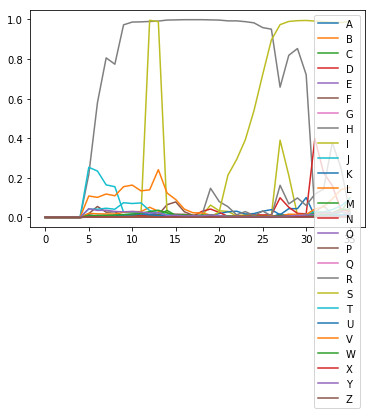

correct: 35 total: 36 accuracy: 0.972 avgEditDist 0.028
('A', 'A'): 15
('S', 'S'): 13
('E', 'E'): 12
('T', 'T'): 11
('H', 'H'): 5
('D', 'D'): 10
('K', 'K'): 5
('N', 'N'): 7
('L', 'L'): 10
('R', 'R'): 7
('O', 'O'): 10
('V', 'V'): 7
('B', 'B'): 5
('C', 'C'): 4
('G', 'G'): 6
('P', 'P'): 5
('I', 'I'): 2
('F', 'F'): 3
('W', 'W'): 1
-------('H', 'R'): 1
[[0.00146063 0.00131074 0.00249831 ... 0.00138165 0.03085335 0.00228495]
 [0.00162086 0.00151818 0.00299504 ... 0.00172283 0.03583018 0.00293915]
 [0.0017293  0.00174245 0.00354616 ... 0.00213243 0.04108235 0.00284634]
 ...
 [0.00274371 0.00204424 0.00164307 ... 0.00265602 0.03796484 0.00226542]
 [0.00302548 0.00201041 0.00179213 ... 0.00230666 0.02692395 0.00171969]
 [0.00247255 0.00193638 0.00176277 ... 0.00206836 0.02595271 0.00135262]]
--pred for 0 20 ['D 0.22 ', 'T 0.18 ', 'L 0.14 ', 'V 0.11 ', 'J 0.04 ']
--pred for 0 24 ['D 0.36 ', 'T 0.19 ', 'V 0.11 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 28 ['D 0.74 ', 'T 0.16 ', 'V 0.12 ', 'L 0.07 ', '

DGLEG DGLEG
edit distance: 0
correct: 36 total: 37 accuracy: 0.973 avgEditDist 0.027
('A', 'A'): 15
('S', 'S'): 13
('E', 'E'): 13
('T', 'T'): 11
('H', 'H'): 5
('D', 'D'): 11
('K', 'K'): 5
('N', 'N'): 7
('L', 'L'): 11
('R', 'R'): 7
('O', 'O'): 10
('V', 'V'): 7
('B', 'B'): 5
('C', 'C'): 4
('G', 'G'): 8
('P', 'P'): 5
('I', 'I'): 2
('F', 'F'): 3
('W', 'W'): 1
-------('H', 'R'): 1
[[0.00144178 0.00099063 0.00135413 ... 0.0016849  0.05306092 0.00055775]
 [0.00153062 0.00101704 0.00127962 ... 0.00260538 0.04121518 0.0006211 ]
 [0.00284717 0.00162492 0.00145472 ... 0.00232258 0.03408887 0.00111612]
 ...
 [0.00142571 0.0014043  0.00265837 ... 0.00330498 0.02768335 0.00129632]
 [0.00140719 0.00104314 0.00212578 ... 0.00440591 0.02636678 0.00090437]
 [0.00142368 0.00112725 0.00219239 ... 0.00399131 0.0206213  0.00092953]]
--pred for 0 20 ['J 0.20 ', 'F 0.18 ', 'V 0.16 ', 'T 0.06 ', 'Y 0.05 ']
--pred for 0 24 ['F 0.88 ', 'V 0.15 ', 'J 0.15 ', 'R 0.05 ', 'Y 0.04 ']
--pred for 0 28 ['R 0.87 ', 'V 0.

TROD TROD
edit distance: 0
correct: 38 total: 39 accuracy: 0.974 avgEditDist 0.026
('A', 'A'): 15
('S', 'S'): 13
('E', 'E'): 13
('T', 'T'): 13
('H', 'H'): 5
('D', 'D'): 12
('K', 'K'): 5
('N', 'N'): 7
('L', 'L'): 11
('R', 'R'): 9
('O', 'O'): 12
('V', 'V'): 7
('B', 'B'): 5
('C', 'C'): 4
('G', 'G'): 8
('P', 'P'): 5
('I', 'I'): 2
('F', 'F'): 3
('W', 'W'): 1
-------('H', 'R'): 1
[[0.00190267 0.00118881 0.0019372  ... 0.00109741 0.02433712 0.00136476]
 [0.00163967 0.00150451 0.00293345 ... 0.00171716 0.02975916 0.0027347 ]
 [0.00172502 0.00165467 0.0034663  ... 0.00209006 0.03648147 0.00303294]
 ...
 [0.00142274 0.00069775 0.00134313 ... 0.0010583  0.01659644 0.00077805]
 [0.00161214 0.00088558 0.0015675  ... 0.00118934 0.02258994 0.00094297]
 [0.00151011 0.00089388 0.00153902 ... 0.00107777 0.02733791 0.00084876]]
--pred for 0 20 ['T 0.33 ', 'V 0.11 ', 'L 0.09 ', 'J 0.04 ', 'A 0.04 ']
--pred for 0 24 ['D 0.46 ', 'T 0.21 ', 'V 0.13 ', 'L 0.09 ', 'Y 0.03 ']
--pred for 0 28 ['D 0.74 ', 'T 0.17

[[0.00286906 0.0020711  0.00267549 ... 0.00183481 0.03624231 0.00125103]
 [0.00300336 0.00205929 0.00303211 ... 0.00204547 0.03370152 0.00153387]
 [0.00311989 0.00203964 0.00305257 ... 0.0019649  0.03396632 0.0015536 ]
 ...
 [0.00148448 0.00126638 0.00256155 ... 0.00358202 0.02542923 0.0011449 ]
 [0.00150004 0.00100425 0.00200515 ... 0.00465557 0.02145706 0.00086968]
 [0.00165382 0.00096661 0.00185698 ... 0.00505716 0.01998171 0.00070831]]
--pred for 0 20 ['E 0.93 ', 'V 0.12 ', 'J 0.06 ', 'T 0.06 ', 'Y 0.04 ']
--pred for 0 24 ['E 0.98 ', 'V 0.10 ', 'T 0.09 ', 'J 0.04 ', 'A 0.04 ']
--pred for 0 28 ['E 0.97 ', 'V 0.11 ', 'T 0.09 ', 'A 0.04 ', 'Y 0.03 ']
--pred for 0 32 ['E 0.95 ', 'V 0.13 ', 'B 0.11 ', 'T 0.10 ', 'A 0.03 ']
--pred for 0 36 ['B 1.00 ', 'V 0.13 ', 'T 0.12 ', 'L 0.05 ', 'A 0.03 ']
--pred for 0 40 ['B 1.00 ', 'T 0.13 ', 'V 0.12 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 44 ['B 1.00 ', 'V 0.18 ', 'T 0.08 ', 'L 0.06 ', 'U 0.05 ']
--pred for 0 48 ['B 0.99 ', 'U 0.30 ', 'V 0.14 ', 'T

BUSAAO BUSAAO
edit distance: 0
correct: 40 total: 41 accuracy: 0.976 avgEditDist 0.024
('A', 'A'): 17
('S', 'S'): 14
('E', 'E'): 13
('T', 'T'): 13
('H', 'H'): 6
('D', 'D'): 13
('K', 'K'): 5
('N', 'N'): 8
('L', 'L'): 11
('R', 'R'): 9
('O', 'O'): 13
('V', 'V'): 8
('B', 'B'): 6
('C', 'C'): 4
('G', 'G'): 8
('P', 'P'): 5
('I', 'I'): 2
('F', 'F'): 3
('W', 'W'): 1
-------('H', 'R'): 1
('U', 'U'): 1
[[0.00252812 0.00092668 0.00212185 ... 0.00229746 0.03962387 0.0009146 ]
 [0.00367321 0.00122604 0.00311141 ... 0.00301616 0.04184806 0.00125945]
 [0.00406682 0.00125047 0.00321268 ... 0.00320052 0.04213519 0.00140708]
 ...
 [0.00139211 0.00074923 0.00115598 ... 0.00090821 0.01473095 0.00101497]
 [0.00144441 0.00097039 0.00149831 ... 0.00108445 0.01255136 0.00087427]
 [0.00126294 0.00082673 0.00126575 ... 0.00101359 0.0253244  0.00061758]]
--pred for 0 20 ['S 0.63 ', 'V 0.22 ', 'J 0.08 ', 'T 0.07 ', 'L 0.05 ']
--pred for 0 24 ['S 0.95 ', 'V 0.16 ', 'J 0.08 ', 'T 0.08 ', 'L 0.05 ']
--pred for 0 28 [

[[0.00138231 0.00082342 0.0013029  ... 0.00273875 0.0372956  0.00051568]
 [0.00144935 0.00088798 0.00134203 ... 0.00345241 0.02863529 0.00056358]
 [0.00149001 0.00093515 0.00140742 ... 0.0038412  0.02651712 0.00061384]
 ...
 [0.00349683 0.00241669 0.00343586 ... 0.00256814 0.03123808 0.00175004]
 [0.00322294 0.00192136 0.00282035 ... 0.00267368 0.02804723 0.00222988]
 [0.00313171 0.0019816  0.00299742 ... 0.00241403 0.03011141 0.00203563]]
--pred for 0 20 ['F 0.94 ', 'J 0.20 ', 'V 0.11 ', 'T 0.05 ', 'Y 0.04 ']
--pred for 0 24 ['F 0.98 ', 'J 0.17 ', 'V 0.12 ', 'T 0.04 ', 'L 0.04 ']
--pred for 0 28 ['F 0.99 ', 'J 0.17 ', 'V 0.12 ', 'T 0.05 ', 'L 0.05 ']
--pred for 0 32 ['F 0.99 ', 'V 0.14 ', 'J 0.12 ', 'T 0.06 ', 'L 0.05 ']
--pred for 0 36 ['F 0.99 ', 'V 0.15 ', 'J 0.08 ', 'T 0.07 ', 'L 0.05 ']
--pred for 0 40 ['F 0.99 ', 'V 0.14 ', 'T 0.10 ', 'L 0.06 ', 'J 0.04 ']
--pred for 0 44 ['F 0.99 ', 'I 0.54 ', 'V 0.12 ', 'J 0.05 ', 'T 0.05 ']
--pred for 0 48 ['I 1.00 ', 'F 0.99 ', 'V 0.21 ', 'L

FDNRE FDNRE
edit distance: 0
correct: 42 total: 43 accuracy: 0.977 avgEditDist 0.023
('A', 'A'): 18
('S', 'S'): 15
('E', 'E'): 14
('T', 'T'): 13
('H', 'H'): 6
('D', 'D'): 14
('K', 'K'): 5
('N', 'N'): 9
('L', 'L'): 11
('R', 'R'): 10
('O', 'O'): 13
('V', 'V'): 9
('B', 'B'): 6
('C', 'C'): 4
('G', 'G'): 8
('P', 'P'): 5
('I', 'I'): 2
('F', 'F'): 4
('W', 'W'): 2
-------('H', 'R'): 1
('U', 'U'): 1
[[1.34827616e-03 9.22631531e-04 1.52145210e-03 8.88888538e-03
  4.47367970e-03 1.25895476e-03 1.52866533e-02 7.42059993e-03
  2.72492552e-03 1.23589276e-03 7.01108435e-03 1.43101355e-02
  2.03162935e-02 1.46086852e-03 2.32884243e-01 2.78739887e-03
  6.93321927e-04 1.51151186e-03 2.35296413e-03 2.55987491e-03
  3.80923203e-03 7.91941595e-04 2.28099912e-01 3.55811068e-03
  1.72388926e-01 9.44491383e-03 8.97221384e-04 3.19562890e-02
  1.26088562e-03]
 [1.45049137e-03 1.33697246e-03 2.48323102e-03 1.08876061e-02
  4.15456062e-03 8.38481355e-03 3.16284716e-01 1.96023397e-02
  3.06087965e-03 1.59723614e-0

--pred for 28 100 ['A 0.99 ', 'N 0.46 ', 'S 0.35 ', 'I 0.01 ', 'L 0.01 ']
--pred for 32 104 ['A 0.99 ', 'S 0.45 ', 'N 0.33 ', 'I 0.01 ', 'L 0.01 ']
--pred for 36 108 ['A 0.99 ', 'S 0.53 ', 'I 0.22 ', 'N 0.18 ', 'W 0.01 ']
--pred for 40 112 ['A 0.99 ', 'S 0.67 ', 'I 0.08 ', 'N 0.03 ', 'B 0.02 ']
--pred for 44 116 ['A 0.99 ', 'S 0.72 ', 'D 0.03 ', 'O 0.02 ', 'E 0.01 ']
--pred for 48 120 ['A 0.99 ', 'S 0.83 ', 'D 0.01 ', 'C 0.00 ', 'E 0.00 ']
--pred for 52 124 ['S 0.95 ', 'A 0.91 ', 'D 0.00 ', 'H 0.00 ', 'I 0.00 ']
--pred for 56 128 ['S 0.99 ', 'A 0.84 ', 'M 0.01 ', 'E 0.00 ', 'H 0.00 ']
--pred for 60 131 ['S 0.99 ', 'A 0.76 ', 'L 0.01 ', 'M 0.01 ', 'T 0.01 ']
--pred for 64 131 ['S 1.00 ', 'A 0.72 ', 'L 0.01 ', 'T 0.01 ', 'I 0.01 ']
--pred for 68 131 ['S 1.00 ', 'A 0.56 ', 'L 0.04 ', 'M 0.02 ', 'V 0.02 ']
--pred for 72 131 ['S 0.99 ', 'A 0.54 ', 'L 0.03 ', 'H 0.03 ', 'T 0.02 ']
--pred for 76 131 ['S 0.99 ', 'A 0.43 ', 'V 0.05 ', 'L 0.04 ', 'M 0.03 ']
--pred for 80 131 ['S 0.99 ', 'A 0.17 

[[0.00315034 0.00244912 0.00297669 ... 0.00232605 0.03950077 0.00173523]
 [0.00342213 0.0023078  0.00315541 ... 0.0023618  0.03815468 0.00173213]
 [0.00359601 0.00229201 0.00324503 ... 0.00227064 0.04092144 0.0016641 ]
 ...
 [0.00308695 0.00216578 0.00149665 ... 0.00237785 0.01989643 0.00230539]
 [0.00287812 0.00202968 0.00152101 ... 0.00248613 0.02196736 0.00240076]
 [0.00268918 0.00193393 0.00147231 ... 0.0023031  0.02236023 0.00249371]]
--pred for 0 20 ['E 0.98 ', 'V 0.12 ', 'J 0.08 ', 'T 0.07 ', 'L 0.04 ']
--pred for 0 24 ['E 0.99 ', 'V 0.11 ', 'T 0.09 ', 'J 0.05 ', 'L 0.05 ']
--pred for 0 28 ['E 0.99 ', 'V 0.11 ', 'T 0.10 ', 'L 0.06 ', 'A 0.05 ']
--pred for 0 32 ['E 0.99 ', 'V 0.14 ', 'T 0.12 ', 'L 0.06 ', 'A 0.05 ']
--pred for 0 36 ['E 0.99 ', 'V 0.17 ', 'T 0.10 ', 'L 0.06 ', 'A 0.04 ']
--pred for 0 40 ['E 0.99 ', 'J 0.17 ', 'V 0.09 ', 'T 0.06 ', 'L 0.06 ']
--pred for 0 44 ['E 0.99 ', 'J 0.35 ', 'T 0.06 ', 'V 0.06 ', 'L 0.05 ']
--pred for 0 48 ['E 0.99 ', 'J 0.17 ', 'V 0.12 ', 'T

[[0.00107803 0.00076592 0.00111511 ... 0.00197945 0.03726874 0.00048455]
 [0.00108922 0.00081075 0.00109311 ... 0.00233744 0.03081133 0.00059907]
 [0.00114006 0.00095504 0.00121258 ... 0.00260927 0.02835999 0.00077318]
 ...
 [0.00150943 0.00085502 0.00127465 ... 0.00105409 0.01382287 0.00086538]
 [0.00142135 0.00084351 0.00125304 ... 0.00101883 0.01463929 0.0007096 ]
 [0.0016286  0.0007735  0.00155799 ... 0.00123859 0.02361626 0.00093982]]
--pred for 0 20 ['J 0.29 ', 'H 0.26 ', 'V 0.10 ', 'F 0.06 ', 'T 0.04 ']
--pred for 0 24 ['H 0.64 ', 'J 0.20 ', 'V 0.12 ', 'T 0.05 ', 'F 0.04 ']
--pred for 0 28 ['H 0.82 ', 'J 0.15 ', 'V 0.15 ', 'T 0.05 ', 'F 0.03 ']
--pred for 0 32 ['H 0.95 ', 'V 0.13 ', 'T 0.08 ', 'J 0.06 ', 'Y 0.03 ']
--pred for 0 36 ['H 0.99 ', 'V 0.17 ', 'T 0.08 ', 'L 0.03 ', 'Y 0.03 ']
--pred for 0 40 ['H 0.99 ', 'V 0.16 ', 'T 0.09 ', 'Y 0.03 ', 'J 0.02 ']
--pred for 0 44 ['H 0.99 ', 'I 0.94 ', 'V 0.22 ', 'T 0.05 ', 'W 0.04 ']
--pred for 0 48 ['H 0.99 ', 'I 0.99 ', 'V 0.18 ', 'L

[[2.99244886e-03 2.05992442e-03 2.66786269e-03 2.28007678e-02
  1.04342345e-02 1.46283000e-03 1.59891695e-03 9.80046749e-01
  1.21836718e-02 2.98176706e-03 1.50011443e-02 4.96168295e-03
  5.10500409e-02 2.72489688e-03 4.44295295e-02 4.88442322e-03
  2.20726593e-03 2.76666787e-03 2.51020701e-03 3.47900949e-03
  4.43141721e-03 2.93954904e-03 7.21772015e-02 9.26497485e-03
  1.15353718e-01 1.31355543e-02 2.07487680e-03 3.72527316e-02
  1.24824129e-03]
 [3.19768768e-03 2.13182648e-03 2.89322948e-03 3.38726342e-02
  1.07552698e-02 1.80640840e-03 1.81357621e-03 9.85894680e-01
  1.06269317e-02 4.12826519e-03 1.45492051e-02 4.86133294e-03
  4.68828082e-02 2.52038240e-03 4.73159403e-02 5.10181719e-03
  2.49033142e-03 3.49105662e-03 2.34841974e-03 3.76473274e-03
  2.94130179e-03 3.21416114e-03 9.17485431e-02 1.18936300e-02
  1.13780640e-01 1.46445967e-02 2.33062799e-03 3.17091607e-02
  1.38744595e-03]
 [3.36025562e-03 2.16195779e-03 3.06139048e-03 3.78098898e-02
  9.78614483e-03 1.84155023e-03 2.

[[0.00176559 0.00097843 0.00146593 ... 0.00150041 0.02809377 0.00101301]
 [0.00218195 0.00118897 0.00160195 ... 0.00176543 0.02755762 0.00131298]
 [0.0022038  0.00111289 0.0016333  ... 0.00156579 0.02619715 0.00138074]
 ...
 [0.00282156 0.00131967 0.00227696 ... 0.00151054 0.04625945 0.0011688 ]
 [0.00243487 0.00091912 0.00164816 ... 0.00222847 0.04931148 0.00097559]
 [0.00221188 0.00082924 0.00146202 ... 0.00247694 0.02769019 0.0008487 ]]
--pred for 0 20 ['T 0.82 ', 'J 0.17 ', 'V 0.05 ', 'L 0.03 ', 'Y 0.03 ']
--pred for 0 24 ['T 0.94 ', 'J 0.12 ', 'V 0.08 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 28 ['T 0.95 ', 'V 0.09 ', 'J 0.07 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 32 ['T 0.98 ', 'V 0.09 ', 'J 0.05 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 36 ['T 0.98 ', 'V 0.11 ', 'J 0.04 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 40 ['T 0.99 ', 'V 0.12 ', 'L 0.04 ', 'A 0.03 ', 'J 0.03 ']
--pred for 0 44 ['T 0.98 ', 'V 0.26 ', 'U 0.05 ', 'L 0.05 ', 'W 0.04 ']
--pred for 0 48 ['T 0.99 ', 'U 0.32 ', 'V 0.16 ', 'W

TODTA TODTA
edit distance: 0
correct: 48 total: 49 accuracy: 0.980 avgEditDist 0.020
('A', 'A'): 21
('S', 'S'): 16
('E', 'E'): 18
('T', 'T'): 17
('H', 'H'): 7
('D', 'D'): 16
('K', 'K'): 5
('N', 'N'): 11
('L', 'L'): 11
('R', 'R'): 12
('O', 'O'): 15
('V', 'V'): 9
('B', 'B'): 6
('C', 'C'): 4
('G', 'G'): 8
('P', 'P'): 5
('I', 'I'): 2
('F', 'F'): 4
('W', 'W'): 2
-------('H', 'R'): 1
('U', 'U'): 1
[[0.00169075 0.00103282 0.00163309 ... 0.00106061 0.03571059 0.00067738]
 [0.00189063 0.00116495 0.00180158 ... 0.00144147 0.03291243 0.00077741]
 [0.00232863 0.00135515 0.00210965 ... 0.00109054 0.03913231 0.00109827]
 ...
 [0.00251719 0.00132894 0.00194686 ... 0.00178961 0.02019018 0.00178659]
 [0.00241283 0.0013092  0.00189418 ... 0.00184916 0.02347993 0.00158817]
 [0.00214099 0.00130637 0.00164998 ... 0.00187829 0.02247172 0.00149937]]
--pred for 0 20 ['J 0.46 ', 'A 0.28 ', 'T 0.09 ', 'V 0.04 ', 'Y 0.04 ']
--pred for 0 24 ['A 0.76 ', 'J 0.35 ', 'T 0.07 ', 'V 0.04 ', 'Y 0.03 ']
--pred for 0 28 [

AEEB AEEB
edit distance: 0
correct: 49 total: 50 accuracy: 0.980 avgEditDist 0.020
('A', 'A'): 22
('S', 'S'): 16
('E', 'E'): 20
('T', 'T'): 17
('H', 'H'): 7
('D', 'D'): 16
('K', 'K'): 5
('N', 'N'): 11
('L', 'L'): 11
('R', 'R'): 12
('O', 'O'): 15
('V', 'V'): 9
('B', 'B'): 7
('C', 'C'): 4
('G', 'G'): 8
('P', 'P'): 5
('I', 'I'): 2
('F', 'F'): 4
('W', 'W'): 2
-------('H', 'R'): 1
('U', 'U'): 1
[[0.00171755 0.00096454 0.00139335 ... 0.00113355 0.02430181 0.00064862]
 [0.00194939 0.00124142 0.00169074 ... 0.00123859 0.02579957 0.00085494]
 [0.00254524 0.00139027 0.0020748  ... 0.00108427 0.03884415 0.0011375 ]
 ...
 [0.00278188 0.00146418 0.00241781 ... 0.00157747 0.03895569 0.00117881]
 [0.00249495 0.00105114 0.00182207 ... 0.00229421 0.04462239 0.00095396]
 [0.00238457 0.00102519 0.00169393 ... 0.00246888 0.03409256 0.0008997 ]]
--pred for 0 20 ['J 0.32 ', 'A 0.25 ', 'T 0.11 ', 'V 0.06 ', 'L 0.05 ']
--pred for 0 24 ['A 0.75 ', 'J 0.25 ', 'T 0.08 ', 'V 0.05 ', 'L 0.03 ']
--pred for 0 28 ['A

C
['A 0.012', 'B 0.002', 'C 0.973', 'D 0.003', 'E 0.005', 'F 0.009', 'G 0.007', 'H 0.023', 'I 0.945', 'J 0.015', 'K 0.002', 'L 0.018', 'M 0.023', 'N 0.007', 'O 0.013', 'P 0.003', 'Q 0.002', 'R 0.003', 'S 0.001', 'T 0.071', 'U 0.008', 'V 0.219', 'W 0.021', 'X 0.002', 'Y 0.025', 'Z 0.002']
['C 2', 'I 6']
C
['A 0.014', 'B 0.002', 'C 0.985', 'D 0.003', 'E 0.005', 'F 0.008', 'G 0.005', 'H 0.034', 'I 0.949', 'J 0.014', 'K 0.001', 'L 0.022', 'M 0.032', 'N 0.008', 'O 0.008', 'P 0.003', 'Q 0.002', 'R 0.004', 'S 0.001', 'T 0.073', 'U 0.009', 'V 0.158', 'W 0.025', 'X 0.002', 'Y 0.029', 'Z 0.002']
['C 3', 'I 7']
I
['A 0.01', 'B 0.003', 'C 0.275', 'D 0.003', 'E 0.002', 'F 0.009', 'G 0.005', 'H 0.022', 'I 0.977', 'J 0.031', 'K 0.001', 'L 0.015', 'M 0.021', 'N 0.008', 'O 0.825', 'P 0.005', 'Q 0.003', 'R 0.01', 'S 0.001', 'T 0.066', 'U 0.009', 'V 0.189', 'W 0.03', 'X 0.002', 'Y 0.038', 'Z 0.001']
['I 8', 'O 1']
O
['A 0.02', 'B 0.004', 'C 0.006', 'D 0.005', 'E 0.003', 'F 0.007', 'G 0.004', 'H 0.021', '

[[0.00147633 0.00102564 0.0017486  ... 0.00104835 0.0387333  0.00062017]
 [0.00140972 0.00100393 0.00183002 ... 0.00134668 0.03695668 0.00067182]
 [0.00133356 0.0009448  0.00172471 ... 0.00156103 0.02801006 0.0006663 ]
 ...
 [0.0027562  0.00196069 0.00147573 ... 0.00286325 0.03688744 0.00166466]
 [0.00231761 0.00179962 0.00143322 ... 0.0030255  0.03126187 0.00155054]
 [0.00208174 0.00153519 0.00153335 ... 0.00306657 0.02896771 0.00115532]]
--pred for 0 20 ['J 0.20 ', 'T 0.12 ', 'V 0.09 ', 'N 0.09 ', 'Y 0.04 ']
--pred for 0 24 ['N 0.54 ', 'J 0.17 ', 'V 0.09 ', 'T 0.07 ', 'Y 0.04 ']
--pred for 0 28 ['N 0.69 ', 'V 0.14 ', 'J 0.10 ', 'T 0.05 ', 'Y 0.03 ']
--pred for 0 32 ['N 0.92 ', 'V 0.15 ', 'J 0.09 ', 'T 0.04 ', 'L 0.03 ']
--pred for 0 36 ['N 0.95 ', 'V 0.16 ', 'J 0.08 ', 'T 0.04 ', 'L 0.02 ']
--pred for 0 40 ['N 0.99 ', 'V 0.12 ', 'J 0.08 ', 'T 0.07 ', 'L 0.04 ']
--pred for 0 44 ['N 0.99 ', 'V 0.16 ', 'T 0.06 ', 'L 0.05 ', 'J 0.03 ']
--pred for 0 48 ['N 0.99 ', 'V 0.15 ', 'T 0.08 ', 'L

NWCLBG NWCLBG
edit distance: 0
correct: 52 total: 53 accuracy: 0.981 avgEditDist 0.019
('A', 'A'): 25
('S', 'S'): 16
('E', 'E'): 21
('T', 'T'): 18
('H', 'H'): 7
('D', 'D'): 17
('K', 'K'): 5
('N', 'N'): 12
('L', 'L'): 12
('R', 'R'): 13
('O', 'O'): 17
('V', 'V'): 9
('B', 'B'): 8
('C', 'C'): 5
('G', 'G'): 9
('P', 'P'): 5
('I', 'I'): 3
('F', 'F'): 4
('W', 'W'): 3
-------('H', 'R'): 1
('U', 'U'): 1
[[0.00128292 0.00053581 0.00109553 ... 0.00108955 0.04149857 0.0007733 ]
 [0.0013472  0.00054556 0.00110034 ... 0.00134472 0.03354019 0.0008854 ]
 [0.00144401 0.00065003 0.00134571 ... 0.00185942 0.02233494 0.00104474]
 ...
 [0.00339963 0.00215685 0.00319258 ... 0.00217712 0.0263026  0.00187061]
 [0.00340505 0.00192589 0.0029866  ... 0.00229877 0.02651822 0.00193326]
 [0.00336898 0.00193381 0.00297406 ... 0.00220682 0.02644005 0.00184438]]
--pred for 0 20 ['V 0.52 ', 'T 0.11 ', 'Y 0.04 ', 'L 0.03 ', 'J 0.02 ']
--pred for 0 24 ['V 0.79 ', 'T 0.07 ', 'Y 0.03 ', 'J 0.03 ', 'L 0.03 ']
--pred for 0 28

[[1.72021461e-03 9.80449026e-04 1.49174454e-03 3.45124990e-01
  3.60109401e-03 1.25231466e-03 1.81054883e-03 1.22848223e-03
  4.69962368e-03 1.50003843e-03 1.47039369e-02 3.62914545e-03
  2.73295194e-01 1.31332420e-03 4.09176536e-02 2.19979906e-03
  2.82111391e-03 1.91903103e-03 1.92382641e-03 1.87634362e-03
  8.50928831e-04 1.00082101e-03 1.12822242e-01 9.11156647e-03
  3.70992385e-02 7.85768032e-03 9.89658991e-04 2.63186451e-02
  6.60606776e-04]
 [1.95374130e-03 1.16355659e-03 1.62270595e-03 8.41384351e-01
  3.62967676e-03 1.35743176e-03 1.78293115e-03 1.25842006e-03
  8.15333705e-03 1.83940399e-03 1.38520347e-02 3.47638153e-03
  1.98438302e-01 1.51243201e-03 3.28692906e-02 1.72434165e-03
  4.02736384e-03 1.51784450e-03 2.43010349e-03 1.98561396e-03
  1.23943877e-03 1.08168588e-03 7.62276947e-02 7.67457066e-03
  3.91482376e-02 6.18517119e-03 1.28346309e-03 2.57060546e-02
  8.73148791e-04]
 [2.37576617e-03 1.24999147e-03 1.77536195e-03 9.21148062e-01
  3.11178062e-03 1.04708585e-03 1.

AIUI AIU
edit distance: 1


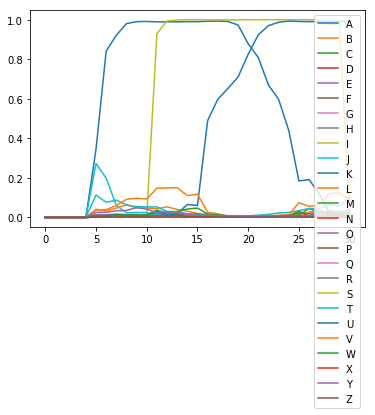

correct: 53 total: 55 accuracy: 0.964 avgEditDist 0.036
('A', 'A'): 26
('S', 'S'): 16
('E', 'E'): 22
('T', 'T'): 18
('H', 'H'): 7
('D', 'D'): 17
('K', 'K'): 5
('N', 'N'): 12
('L', 'L'): 12
('R', 'R'): 13
('O', 'O'): 18
('V', 'V'): 10
('B', 'B'): 8
('C', 'C'): 5
('G', 'G'): 9
('P', 'P'): 5
('I', 'I'): 4
('F', 'F'): 4
('W', 'W'): 3
-------('H', 'R'): 1
('U', 'U'): 2
-------('I', '%'): 1
[[0.00312911 0.00209901 0.00277564 ... 0.00225684 0.03611349 0.00134438]
 [0.00313875 0.00207353 0.0030639  ... 0.00228518 0.03397354 0.00153457]
 [0.00342901 0.00215453 0.00315745 ... 0.00231945 0.03349258 0.00161268]
 ...
 [0.00346695 0.00197872 0.0031361  ... 0.00214467 0.0292969  0.00173404]
 [0.0036233  0.00202674 0.00324033 ... 0.00231103 0.03091009 0.0016326 ]
 [0.00342116 0.0019915  0.00311816 ... 0.00228696 0.03192076 0.00167755]]
--pred for 0 20 ['E 0.96 ', 'V 0.11 ', 'T 0.08 ', 'J 0.06 ', 'Y 0.04 ']
--pred for 0 24 ['E 0.98 ', 'V 0.11 ', 'T 0.09 ', 'A 0.04 ', 'J 0.04 ']
--pred for 0 28 ['E 0.98

ETAE ETAE
edit distance: 0
correct: 54 total: 56 accuracy: 0.964 avgEditDist 0.036
('A', 'A'): 27
('S', 'S'): 16
('E', 'E'): 24
('T', 'T'): 19
('H', 'H'): 7
('D', 'D'): 17
('K', 'K'): 5
('N', 'N'): 12
('L', 'L'): 12
('R', 'R'): 13
('O', 'O'): 18
('V', 'V'): 10
('B', 'B'): 8
('C', 'C'): 5
('G', 'G'): 9
('P', 'P'): 5
('I', 'I'): 4
('F', 'F'): 4
('W', 'W'): 3
-------('H', 'R'): 1
('U', 'U'): 2
-------('I', '%'): 1
[[0.00099735 0.00088635 0.00152774 ... 0.00098998 0.02576521 0.00045575]
 [0.00105725 0.00088094 0.00155152 ... 0.00110975 0.02184544 0.00053802]
 [0.00160918 0.00111361 0.00183576 ... 0.00161479 0.02263794 0.00084224]
 ...
 [0.00342958 0.00189552 0.00309866 ... 0.00212734 0.02889708 0.00229197]
 [0.00322816 0.00187318 0.00302274 ... 0.00220077 0.02982271 0.0021465 ]
 [0.00292748 0.00179145 0.00283487 ... 0.00194952 0.02870324 0.00197699]]
--pred for 0 20 ['M 0.28 ', 'J 0.13 ', 'V 0.08 ', 'T 0.08 ', 'N 0.03 ']
--pred for 0 24 ['N 0.23 ', 'M 0.21 ', 'V 0.11 ', 'J 0.07 ', 'T 0.06 

[[0.00269902 0.00097738 0.00230638 ... 0.00300649 0.04563759 0.00085542]
 [0.00360734 0.00123664 0.00302906 ... 0.00324785 0.04210519 0.00123491]
 [0.0037312  0.00121953 0.00301469 ... 0.00317016 0.0442503  0.00130768]
 ...
 [0.00175423 0.00080164 0.00147474 ... 0.0014588  0.01982066 0.00091283]
 [0.00169123 0.00081141 0.00156688 ... 0.00133565 0.02319349 0.00101483]
 [0.00200001 0.00097356 0.0016483  ... 0.00144307 0.02542685 0.00114193]]
--pred for 0 20 ['S 0.64 ', 'V 0.17 ', 'J 0.12 ', 'T 0.06 ', 'Y 0.05 ']
--pred for 0 24 ['S 0.94 ', 'V 0.17 ', 'T 0.08 ', 'J 0.07 ', 'L 0.05 ']
--pred for 0 28 ['S 0.95 ', 'V 0.18 ', 'T 0.09 ', 'J 0.05 ', 'L 0.04 ']
--pred for 0 32 ['S 0.96 ', 'V 0.18 ', 'T 0.09 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 36 ['S 0.98 ', 'V 0.18 ', 'T 0.09 ', 'L 0.05 ', 'J 0.04 ']
--pred for 0 40 ['S 0.99 ', 'V 0.19 ', 'T 0.08 ', 'L 0.04 ', 'J 0.04 ']
--pred for 0 44 ['S 0.99 ', 'I 0.29 ', 'V 0.24 ', 'U 0.08 ', 'L 0.05 ']
--pred for 0 48 ['I 0.99 ', 'S 0.99 ', 'V 0.18 ', 'L

FAIR FAIR
edit distance: 0
correct: 57 total: 59 accuracy: 0.966 avgEditDist 0.034
('A', 'A'): 28
('S', 'S'): 17
('E', 'E'): 27
('T', 'T'): 19
('H', 'H'): 7
('D', 'D'): 18
('K', 'K'): 5
('N', 'N'): 14
('L', 'L'): 12
('R', 'R'): 15
('O', 'O'): 18
('V', 'V'): 10
('B', 'B'): 8
('C', 'C'): 5
('G', 'G'): 9
('P', 'P'): 5
('I', 'I'): 5
('F', 'F'): 5
('W', 'W'): 4
-------('H', 'R'): 1
('U', 'U'): 2
-------('I', '%'): 1
[[0.00108856 0.00077054 0.00110567 ... 0.00212314 0.04465023 0.00055853]
 [0.00108988 0.00080177 0.00110752 ... 0.0024776  0.0395839  0.0006228 ]
 [0.0010967  0.00088723 0.00115948 ... 0.00265462 0.03706807 0.00071401]
 ...
 [0.00137158 0.00112328 0.00224913 ... 0.00522229 0.02691946 0.0010909 ]
 [0.00145499 0.0009586  0.00201384 ... 0.00788588 0.02653696 0.00084973]
 [0.00162514 0.00085178 0.00174094 ... 0.01333542 0.02804199 0.00071823]]
--pred for 0 20 ['H 0.38 ', 'J 0.25 ', 'V 0.12 ', 'F 0.05 ', 'Y 0.05 ']
--pred for 0 24 ['H 0.59 ', 'J 0.24 ', 'V 0.11 ', 'F 0.05 ', 'Y 0.04 

ARL ARL
edit distance: 0
correct: 59 total: 61 accuracy: 0.967 avgEditDist 0.033
('A', 'A'): 30
('S', 'S'): 17
('E', 'E'): 27
('T', 'T'): 19
('H', 'H'): 8
('D', 'D'): 19
('K', 'K'): 5
('N', 'N'): 14
('L', 'L'): 13
('R', 'R'): 16
('O', 'O'): 18
('V', 'V'): 11
('B', 'B'): 8
('C', 'C'): 5
('G', 'G'): 9
('P', 'P'): 5
('I', 'I'): 5
('F', 'F'): 5
('W', 'W'): 4
-------('H', 'R'): 1
('U', 'U'): 2
-------('I', '%'): 1
[[0.00151151 0.00076603 0.00143498 ... 0.00119017 0.02767863 0.00100362]
 [0.00183525 0.00099918 0.00137398 ... 0.00132804 0.02716999 0.00105919]
 [0.00205042 0.00109743 0.00149464 ... 0.00136149 0.02661982 0.00120862]
 ...
 [0.00184224 0.00097375 0.00191452 ... 0.00314078 0.02250101 0.00116494]
 [0.00158812 0.00068649 0.00148572 ... 0.00324826 0.02242933 0.00084215]
 [0.00161864 0.00079338 0.0014945  ... 0.0026643  0.0271215  0.000824  ]]
--pred for 0 20 ['T 0.54 ', 'J 0.06 ', 'V 0.05 ', 'Y 0.03 ', 'L 0.03 ']
--pred for 0 24 ['T 0.91 ', 'J 0.10 ', 'V 0.07 ', 'L 0.04 ', 'Y 0.03 ']

AUOOR AUOOR
edit distance: 0
correct: 61 total: 63 accuracy: 0.968 avgEditDist 0.032
('A', 'A'): 32
('S', 'S'): 17
('E', 'E'): 27
('T', 'T'): 20
('H', 'H'): 8
('D', 'D'): 19
('K', 'K'): 6
('N', 'N'): 14
('L', 'L'): 13
('R', 'R'): 18
('O', 'O'): 21
('V', 'V'): 11
('B', 'B'): 8
('C', 'C'): 5
('G', 'G'): 9
('P', 'P'): 5
('I', 'I'): 5
('F', 'F'): 5
('W', 'W'): 4
-------('H', 'R'): 1
('U', 'U'): 3
-------('I', '%'): 1
[[0.00152744 0.00076436 0.00142622 ... 0.00118708 0.028571   0.00103558]
 [0.00175163 0.00092757 0.00127222 ... 0.00123216 0.02616605 0.00106324]
 [0.00197845 0.00114951 0.00138724 ... 0.00133967 0.02837466 0.00113549]
 ...
 [0.00277979 0.00177157 0.00255371 ... 0.00139917 0.03263509 0.00129579]
 [0.00265174 0.00173025 0.0025108  ... 0.00142995 0.03372516 0.00116478]
 [0.00245494 0.00158062 0.0021441  ... 0.00134728 0.02839408 0.00102193]]
--pred for 0 20 ['T 0.56 ', 'V 0.06 ', 'J 0.05 ', 'Y 0.03 ', 'L 0.03 ']
--pred for 0 24 ['T 0.92 ', 'V 0.08 ', 'J 0.06 ', 'L 0.05 ', 'Y 0.0

NN NN
edit distance: 0
correct: 63 total: 65 accuracy: 0.969 avgEditDist 0.031
('A', 'A'): 33
('S', 'S'): 17
('E', 'E'): 28
('T', 'T'): 21
('H', 'H'): 8
('D', 'D'): 19
('K', 'K'): 6
('N', 'N'): 16
('L', 'L'): 13
('R', 'R'): 18
('O', 'O'): 21
('V', 'V'): 11
('B', 'B'): 8
('C', 'C'): 5
('G', 'G'): 9
('P', 'P'): 5
('I', 'I'): 5
('F', 'F'): 5
('W', 'W'): 4
-------('H', 'R'): 1
('U', 'U'): 3
-------('I', '%'): 1
[[0.00235394 0.00088397 0.00207201 ... 0.00258715 0.05360582 0.00079811]
 [0.00321537 0.00115981 0.00290593 ... 0.00303676 0.04361944 0.001121  ]
 [0.00362593 0.00123899 0.0031127  ... 0.00299016 0.04540419 0.00121536]
 ...
 [0.00112249 0.00066626 0.0011392  ... 0.00089237 0.01546003 0.00118096]
 [0.0011794  0.00072715 0.00130928 ... 0.00114234 0.02289036 0.00075145]
 [0.00140532 0.00089579 0.00125841 ... 0.00120992 0.02375056 0.0006556 ]]
--pred for 0 20 ['S 0.53 ', 'V 0.23 ', 'J 0.13 ', 'T 0.06 ', 'Y 0.05 ']
--pred for 0 24 ['S 0.90 ', 'V 0.19 ', 'J 0.14 ', 'T 0.07 ', 'L 0.05 ']
-

GVCRTO GVCRTO
edit distance: 0
correct: 65 total: 67 accuracy: 0.970 avgEditDist 0.030
('A', 'A'): 33
('S', 'S'): 18
('E', 'E'): 28
('T', 'T'): 22
('H', 'H'): 8
('D', 'D'): 19
('K', 'K'): 6
('N', 'N'): 16
('L', 'L'): 13
('R', 'R'): 20
('O', 'O'): 22
('V', 'V'): 13
('B', 'B'): 8
('C', 'C'): 6
('G', 'G'): 11
('P', 'P'): 5
('I', 'I'): 5
('F', 'F'): 5
('W', 'W'): 4
-------('H', 'R'): 1
('U', 'U'): 3
-------('I', '%'): 1
[[0.00141966 0.00073854 0.00140997 ... 0.00182868 0.03828562 0.00073721]
 [0.00162231 0.0009101  0.00180283 ... 0.0021905  0.04352727 0.00090868]
 [0.00203038 0.00150154 0.00129428 ... 0.00304535 0.03960301 0.00110079]
 ...
 [0.00287567 0.00131612 0.00290887 ... 0.00364771 0.02021754 0.00182304]
 [0.00227286 0.00116732 0.00220372 ... 0.00379137 0.02346296 0.00152415]
 [0.00199616 0.00097816 0.00186986 ... 0.00439587 0.02636547 0.00123235]]
--pred for 0 20 ['V 0.11 ', 'T 0.09 ', 'C 0.04 ', 'J 0.04 ', 'Y 0.04 ']
--pred for 0 24 ['C 0.16 ', 'T 0.10 ', 'V 0.08 ', 'Y 0.04 ', 'J 

COV COV
edit distance: 0
correct: 67 total: 69 accuracy: 0.971 avgEditDist 0.029
('A', 'A'): 33
('S', 'S'): 18
('E', 'E'): 28
('T', 'T'): 23
('H', 'H'): 8
('D', 'D'): 19
('K', 'K'): 7
('N', 'N'): 16
('L', 'L'): 13
('R', 'R'): 21
('O', 'O'): 23
('V', 'V'): 14
('B', 'B'): 8
('C', 'C'): 7
('G', 'G'): 12
('P', 'P'): 5
('I', 'I'): 5
('F', 'F'): 5
('W', 'W'): 4
-------('H', 'R'): 1
('U', 'U'): 3
-------('I', '%'): 1
[[0.00141959 0.00073245 0.0013686  ... 0.00196274 0.0404245  0.0007509 ]
 [0.00153498 0.00086458 0.0017674  ... 0.00240458 0.05453081 0.00088549]
 [0.00178011 0.00111846 0.00231193 ... 0.00277275 0.05912376 0.00125013]
 ...
 [0.00219206 0.00221901 0.003967   ... 0.00379277 0.0329314  0.00166418]
 [0.00199121 0.00217009 0.00375191 ... 0.0035694  0.03692618 0.00146208]
 [0.00217873 0.00120884 0.00248139 ... 0.0028235  0.03259362 0.00110886]]
--pred for 0 20 ['V 0.12 ', 'T 0.07 ', 'J 0.07 ', 'C 0.04 ', 'Y 0.04 ']
--pred for 0 24 ['C 0.22 ', 'T 0.08 ', 'V 0.08 ', 'J 0.08 ', 'Y 0.05 '

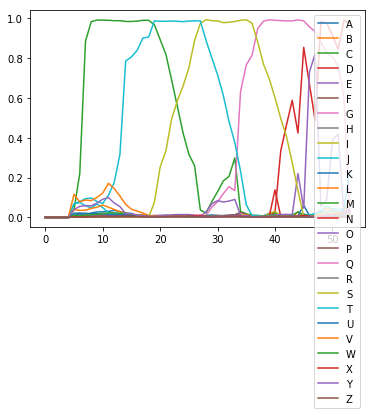

correct: 67 total: 70 accuracy: 0.957 avgEditDist 0.043
('A', 'A'): 33
('S', 'S'): 19
('E', 'E'): 28
('T', 'T'): 24
('H', 'H'): 8
('D', 'D'): 19
('K', 'K'): 7
('N', 'N'): 16
('L', 'L'): 13
('R', 'R'): 21
('O', 'O'): 23
('V', 'V'): 14
('B', 'B'): 8
('C', 'C'): 8
('G', 'G'): 13
('P', 'P'): 5
('I', 'I'): 5
('F', 'F'): 5
('W', 'W'): 4
-------('H', 'R'): 1
('U', 'U'): 3
-------('I', '%'): 1
-------('%', 'D'): 1
[[0.00134662 0.00070786 0.0012307  ... 0.00106179 0.03465109 0.00050835]
 [0.00137006 0.00072147 0.00130379 ... 0.0010755  0.04034216 0.0006777 ]
 [0.00134487 0.00072173 0.0013637  ... 0.0012323  0.03545787 0.00075852]
 ...
 [0.00205294 0.00122004 0.0027596  ... 0.00387751 0.03105067 0.00100048]
 [0.00149707 0.00116675 0.00234203 ... 0.00559974 0.02687722 0.00099903]
 [0.0014561  0.00107235 0.00209571 ... 0.00619065 0.0217055  0.00087205]]
--pred for 0 20 ['J 0.20 ', 'V 0.13 ', 'T 0.08 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 24 ['L 0.26 ', 'J 0.10 ', 'V 0.10 ', 'T 0.08 ', 'Y 0.04 ']
--

['A 0.011', 'B 0.953', 'C 0.004', 'D 0.005', 'E 0.001', 'F 0.003', 'G 0.006', 'H 0.005', 'I 0.008', 'J 0.002', 'K 0.003', 'L 0.007', 'M 0.006', 'N 0.006', 'O 0.004', 'P 0.002', 'Q 0.001', 'R 0.995', 'S 0.002', 'T 0.011', 'U 0.002', 'V 0.005', 'W 0.004', 'X 0.001', 'Y 0.006', 'Z 0.001']
['B 2', 'R -3']
B
['A 0.003', 'B 0.972', 'C 0.002', 'D 0.008', 'E 0.004', 'F 0.002', 'G 0.005', 'H 0.005', 'I 0.006', 'J 0.002', 'K 0.005', 'L 0.003', 'M 0.003', 'N 0.002', 'O 0.002', 'P 0.002', 'Q 0.001', 'R 0.963', 'S 0.159', 'T 0.005', 'U 0.003', 'V 0.01', 'W 0.004', 'X 0.002', 'Y 0.006', 'Z 0.001']
['B 3', 'R -2']
B
['A 0.004', 'B 0.981', 'C 0.002', 'D 0.008', 'E 0.008', 'F 0.003', 'G 0.006', 'H 0.005', 'I 0.005', 'J 0.002', 'K 0.004', 'L 0.003', 'M 0.003', 'N 0.003', 'O 0.002', 'P 0.004', 'Q 0.001', 'R 0.858', 'S 0.299', 'T 0.005', 'U 0.004', 'V 0.011', 'W 0.005', 'X 0.002', 'Y 0.007', 'Z 0.002']
['B 4', 'R -1']
B
['A 0.005', 'B 0.979', 'C 0.003', 'D 0.012', 'E 0.014', 'F 0.004', 'G 0.006', 'H 0.009

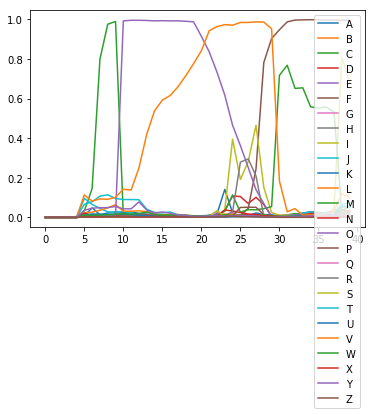

correct: 69 total: 73 accuracy: 0.945 avgEditDist 0.055
('A', 'A'): 35
('S', 'S'): 20
('E', 'E'): 28
('T', 'T'): 24
('H', 'H'): 8
('D', 'D'): 19
('K', 'K'): 7
('N', 'N'): 16
('L', 'L'): 13
('R', 'R'): 22
('O', 'O'): 26
('V', 'V'): 15
('B', 'B'): 9
('C', 'C'): 9
('G', 'G'): 13
('P', 'P'): 5
('I', 'I'): 5
('F', 'F'): 6
('W', 'W'): 4
-------('H', 'R'): 1
('U', 'U'): 4
-------('I', '%'): 1
-------('%', 'D'): 1
-------('%', 'I'): 1
[[0.00125513 0.00053633 0.00109384 ... 0.00113199 0.04236272 0.00076186]
 [0.00128057 0.00059811 0.00129636 ... 0.00177515 0.03085387 0.00090057]
 [0.00142755 0.00065948 0.00137648 ... 0.00129505 0.01987229 0.00119386]
 ...
 [0.00133594 0.00098467 0.00084261 ... 0.00205458 0.02319746 0.00043047]
 [0.00124905 0.00104094 0.00097192 ... 0.00127227 0.02304593 0.00054615]
 [0.00128705 0.00115908 0.00101001 ... 0.00109848 0.02116043 0.00056084]]
--pred for 0 20 ['V 0.65 ', 'T 0.08 ', 'Y 0.04 ', 'J 0.04 ', 'L 0.03 ']
--pred for 0 24 ['V 0.85 ', 'J 0.23 ', 'T 0.06 ', 'Y 

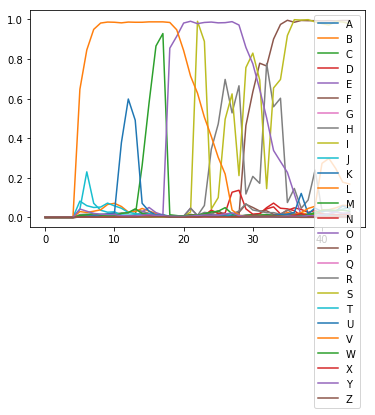

correct: 69 total: 74 accuracy: 0.932 avgEditDist 0.068
('A', 'A'): 35
('S', 'S'): 20
('E', 'E'): 28
('T', 'T'): 24
('H', 'H'): 8
('D', 'D'): 19
('K', 'K'): 7
('N', 'N'): 16
('L', 'L'): 13
('R', 'R'): 22
('O', 'O'): 27
('V', 'V'): 16
('B', 'B'): 9
('C', 'C'): 9
('G', 'G'): 13
('P', 'P'): 5
('I', 'I'): 6
('F', 'F'): 7
('W', 'W'): 4
-------('H', 'R'): 1
('U', 'U'): 4
-------('I', '%'): 1
-------('%', 'D'): 1
-------('%', 'I'): 2
[[0.00109601 0.00080498 0.00117699 ... 0.00200978 0.03596283 0.00052199]
 [0.00103939 0.00078778 0.00108997 ... 0.00243337 0.0318663  0.00056548]
 [0.00113926 0.00090964 0.00119768 ... 0.00269254 0.03261424 0.00073205]
 ...
 [0.00437086 0.00136257 0.00365709 ... 0.0038097  0.02972273 0.00153149]
 [0.00361104 0.00119686 0.00308802 ... 0.00303102 0.02717684 0.00116586]
 [0.00323015 0.0011842  0.00298027 ... 0.00270656 0.02355904 0.00107848]]
--pred for 0 20 ['J 0.25 ', 'H 0.18 ', 'F 0.11 ', 'V 0.09 ', 'T 0.04 ']
--pred for 0 24 ['H 0.48 ', 'J 0.23 ', 'V 0.11 ', 'F 

[[0.00153282 0.00117882 0.00186042 ... 0.00141335 0.02509937 0.00073879]
 [0.00166754 0.0009762  0.00151514 ... 0.0012837  0.02460036 0.00065838]
 [0.0017265  0.00111758 0.0016829  ... 0.00167622 0.02262118 0.00071328]
 ...
 [0.00170827 0.00115843 0.00184739 ... 0.00136604 0.0192105  0.00138472]
 [0.00171568 0.00112135 0.00186441 ... 0.00138771 0.02056258 0.00113661]
 [0.00167552 0.00108264 0.00191607 ... 0.00150568 0.02559392 0.00089544]]
--pred for 0 20 ['J 0.90 ', 'T 0.12 ', 'A 0.05 ', 'V 0.04 ', 'Y 0.03 ']
--pred for 0 24 ['J 0.54 ', 'A 0.19 ', 'T 0.11 ', 'V 0.05 ', 'L 0.03 ']
--pred for 0 28 ['J 0.62 ', 'A 0.47 ', 'T 0.08 ', 'V 0.04 ', 'L 0.02 ']
--pred for 0 32 ['A 0.94 ', 'T 0.08 ', 'J 0.06 ', 'V 0.06 ', 'L 0.05 ']
--pred for 0 36 ['A 0.97 ', 'T 0.07 ', 'V 0.05 ', 'L 0.05 ', 'J 0.04 ']
--pred for 0 40 ['A 0.99 ', 'V 0.07 ', 'T 0.05 ', 'L 0.04 ', 'Y 0.04 ']
--pred for 0 44 ['A 0.99 ', 'J 0.06 ', 'V 0.05 ', 'T 0.05 ', 'Y 0.04 ']
--pred for 0 48 ['A 0.99 ', 'V 0.13 ', 'T 0.07 ', 'L

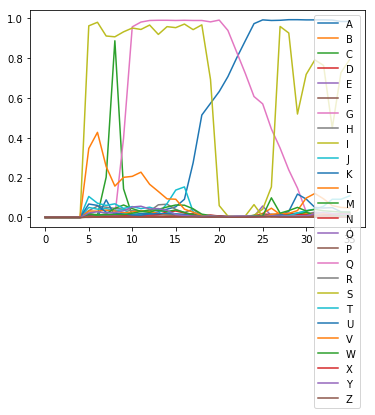

correct: 71 total: 77 accuracy: 0.922 avgEditDist 0.078
('A', 'A'): 37
('S', 'S'): 22
('E', 'E'): 30
('T', 'T'): 24
('H', 'H'): 10
('D', 'D'): 20
('K', 'K'): 7
('N', 'N'): 16
('L', 'L'): 14
('R', 'R'): 23
('O', 'O'): 28
('V', 'V'): 17
('B', 'B'): 9
('C', 'C'): 9
('G', 'G'): 14
('P', 'P'): 5
('I', 'I'): 7
('F', 'F'): 7
('W', 'W'): 4
-------('H', 'R'): 1
('U', 'U'): 4
-------('I', '%'): 1
-------('%', 'D'): 1
-------('%', 'I'): 3
[[0.0017126  0.00080995 0.00144735 ... 0.00397325 0.03508079 0.00093802]
 [0.00181234 0.00090955 0.00176895 ... 0.00332605 0.04266259 0.0010456 ]
 [0.00234511 0.00139709 0.00154818 ... 0.00421648 0.03483587 0.00115638]
 ...
 [0.00147052 0.00147683 0.00262511 ... 0.00416692 0.02057023 0.00136477]
 [0.00143584 0.00112605 0.00202042 ... 0.00521203 0.01611001 0.00107763]
 [0.00154468 0.00105901 0.0017485  ... 0.00469692 0.0151696  0.00092327]]
--pred for 0 20 ['V 0.11 ', 'T 0.08 ', 'J 0.05 ', 'K 0.05 ', 'Y 0.04 ']
--pred for 0 24 ['V 0.10 ', 'T 0.10 ', 'K 0.06 ', 'C

USFOIT USFOIT
edit distance: 0
correct: 73 total: 79 accuracy: 0.924 avgEditDist 0.076
('A', 'A'): 37
('S', 'S'): 23
('E', 'E'): 31
('T', 'T'): 25
('H', 'H'): 10
('D', 'D'): 20
('K', 'K'): 7
('N', 'N'): 16
('L', 'L'): 14
('R', 'R'): 23
('O', 'O'): 30
('V', 'V'): 17
('B', 'B'): 9
('C', 'C'): 9
('G', 'G'): 15
('P', 'P'): 6
('I', 'I'): 8
('F', 'F'): 8
('W', 'W'): 4
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 1
-------('%', 'D'): 1
-------('%', 'I'): 3
[[0.00165346 0.00119189 0.00171852 ... 0.00131249 0.01942252 0.00072952]
 [0.00186778 0.00131267 0.00171117 ... 0.00152319 0.0195039  0.00110274]
 [0.00253707 0.00145465 0.00202964 ... 0.00102504 0.02722463 0.00084723]
 ...
 [0.00322815 0.00229005 0.00140296 ... 0.00274144 0.03298282 0.00332611]
 [0.00296969 0.00211839 0.00140186 ... 0.00285115 0.03521898 0.00333499]
 [0.00253121 0.00176659 0.00134172 ... 0.00271558 0.02882877 0.00329828]]
--pred for 0 20 ['J 0.72 ', 'A 0.29 ', 'T 0.10 ', 'V 0.04 ', 'L 0.03 ']
--pred for 0 24 ['A 0

NA NA
edit distance: 0
correct: 75 total: 81 accuracy: 0.926 avgEditDist 0.074
('A', 'A'): 39
('S', 'S'): 23
('E', 'E'): 31
('T', 'T'): 25
('H', 'H'): 10
('D', 'D'): 20
('K', 'K'): 7
('N', 'N'): 17
('L', 'L'): 14
('R', 'R'): 25
('O', 'O'): 30
('V', 'V'): 17
('B', 'B'): 9
('C', 'C'): 9
('G', 'G'): 15
('P', 'P'): 6
('I', 'I'): 8
('F', 'F'): 8
('W', 'W'): 4
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 1
-------('%', 'D'): 1
-------('%', 'I'): 3
[[0.00318273 0.0020917  0.00275937 ... 0.00209486 0.04244336 0.00139243]
 [0.00332089 0.00210988 0.00296643 ... 0.00228506 0.03531244 0.00146367]
 [0.00346051 0.00211216 0.0030782  ... 0.00219075 0.03459725 0.00154308]
 ...
 [0.00116722 0.00112624 0.00092769 ... 0.00341472 0.02735935 0.00054334]
 [0.00123825 0.00133372 0.0010571  ... 0.00127577 0.02379091 0.0005886 ]
 [0.00127275 0.0012284  0.00119493 ... 0.00116704 0.02433656 0.00060775]]
--pred for 0 20 ['E 0.97 ', 'V 0.12 ', 'T 0.07 ', 'J 0.05 ', 'Y 0.04 ']
--pred for 0 24 ['E 0.99 ', '

DLATV DLATV
edit distance: 0
correct: 77 total: 83 accuracy: 0.928 avgEditDist 0.072
('A', 'A'): 40
('S', 'S'): 23
('E', 'E'): 32
('T', 'T'): 26
('H', 'H'): 10
('D', 'D'): 21
('K', 'K'): 7
('N', 'N'): 17
('L', 'L'): 15
('R', 'R'): 25
('O', 'O'): 31
('V', 'V'): 18
('B', 'B'): 9
('C', 'C'): 9
('G', 'G'): 15
('P', 'P'): 6
('I', 'I'): 9
('F', 'F'): 8
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 1
-------('%', 'D'): 1
-------('%', 'I'): 3
[[1.52527797e-03 1.28086074e-03 2.27924925e-03 1.93223376e-02
  4.46183700e-03 6.99651940e-03 8.49273503e-02 7.30211427e-03
  3.37725575e-03 1.31597230e-03 9.34140105e-03 1.21102221e-02
  4.45661955e-02 1.37064583e-03 1.41327798e-01 3.63864983e-03
  1.44336757e-03 2.92181969e-03 3.10770958e-03 2.85635050e-03
  3.78713757e-03 1.05709664e-03 1.64589897e-01 4.73923609e-03
  1.02351293e-01 8.83991458e-03 1.26756425e-03 3.26914638e-02
  1.59920927e-03]
 [1.68478221e-03 1.65008858e-03 3.29545001e-03 1.64076723e-02
  4.82001668e-03 6.458862

NGPECL NGPECL
edit distance: 0
correct: 79 total: 85 accuracy: 0.929 avgEditDist 0.071
('A', 'A'): 40
('S', 'S'): 23
('E', 'E'): 33
('T', 'T'): 26
('H', 'H'): 10
('D', 'D'): 22
('K', 'K'): 7
('N', 'N'): 18
('L', 'L'): 16
('R', 'R'): 26
('O', 'O'): 31
('V', 'V'): 18
('B', 'B'): 9
('C', 'C'): 10
('G', 'G'): 16
('P', 'P'): 7
('I', 'I'): 9
('F', 'F'): 8
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 1
-------('%', 'D'): 1
-------('%', 'I'): 3
[[0.00309754 0.00200668 0.00299965 ... 0.00218292 0.0374748  0.0014488 ]
 [0.00327233 0.00211613 0.00315787 ... 0.00236466 0.03495673 0.00152265]
 [0.00339281 0.00215568 0.00325474 ... 0.00230898 0.03324128 0.00160205]
 ...
 [0.00294379 0.00172545 0.0027632  ... 0.0018661  0.02405965 0.00274579]
 [0.00271298 0.00162729 0.00250881 ... 0.00173858 0.02510332 0.00277653]
 [0.00242004 0.00157365 0.00225039 ... 0.00166292 0.02546579 0.00254932]]
--pred for 0 20 ['E 0.98 ', 'V 0.11 ', 'T 0.08 ', 'J 0.05 ', 'L 0.05 ']
--pred for 0 24 ['E 

VM VM
edit distance: 0
correct: 81 total: 87 accuracy: 0.931 avgEditDist 0.069
('A', 'A'): 41
('S', 'S'): 23
('E', 'E'): 35
('T', 'T'): 27
('H', 'H'): 10
('D', 'D'): 22
('K', 'K'): 7
('N', 'N'): 18
('L', 'L'): 17
('R', 'R'): 27
('O', 'O'): 31
('V', 'V'): 19
('B', 'B'): 9
('C', 'C'): 10
('G', 'G'): 16
('P', 'P'): 7
('I', 'I'): 9
('F', 'F'): 8
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 1
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 1
[[2.77747703e-03 1.05006818e-03 2.46417173e-03 2.48704441e-02
  2.75084702e-03 1.61022937e-03 3.29332985e-03 2.65707355e-03
  4.45748167e-03 1.83263491e-03 2.40603145e-02 2.94475956e-03
  1.53480440e-01 2.67428649e-03 5.92528433e-02 4.89911111e-03
  1.03411207e-03 2.01194524e-03 2.70600780e-03 2.24625110e-03
  1.09397178e-03 7.62941599e-01 7.21169636e-02 7.87283946e-03
  1.79470807e-01 1.30290845e-02 2.81869387e-03 4.24976423e-02
  9.43628256e-04]
 [3.57082998e-03 1.26815832e-03 3.11333989e-03 2.81822216e-02
  3.58383218e-03

[[0.00198994 0.00072382 0.00158273 ... 0.00183466 0.06847058 0.00067445]
 [0.00276865 0.00100876 0.00240177 ... 0.00238778 0.05686776 0.00094352]
 [0.003123   0.00109669 0.0026886  ... 0.00265257 0.05288168 0.0010651 ]
 ...
 [0.00302323 0.00187811 0.00147437 ... 0.00311419 0.04600104 0.00224578]
 [0.00256147 0.00181396 0.00156003 ... 0.00290559 0.03558251 0.00193651]
 [0.0022753  0.00169001 0.00152448 ... 0.00270032 0.03534034 0.0011912 ]]
--pred for 0 20 ['V 0.26 ', 'J 0.19 ', 'S 0.15 ', 'L 0.08 ', 'Y 0.07 ']
--pred for 0 24 ['S 0.81 ', 'V 0.19 ', 'J 0.13 ', 'T 0.07 ', 'L 0.06 ']
--pred for 0 28 ['S 0.90 ', 'V 0.19 ', 'J 0.10 ', 'T 0.08 ', 'L 0.05 ']
--pred for 0 32 ['S 0.96 ', 'V 0.17 ', 'J 0.09 ', 'T 0.09 ', 'L 0.06 ']
--pred for 0 36 ['S 0.98 ', 'V 0.21 ', 'T 0.08 ', 'L 0.07 ', 'Y 0.05 ']
--pred for 0 40 ['S 0.98 ', 'V 0.19 ', 'T 0.08 ', 'L 0.06 ', 'J 0.05 ']
--pred for 0 44 ['S 0.98 ', 'V 0.25 ', 'U 0.17 ', 'L 0.08 ', 'W 0.05 ']
--pred for 0 48 ['S 0.98 ', 'U 0.37 ', 'I 0.15 ', 'V

LINIIND LININD
edit distance: 1


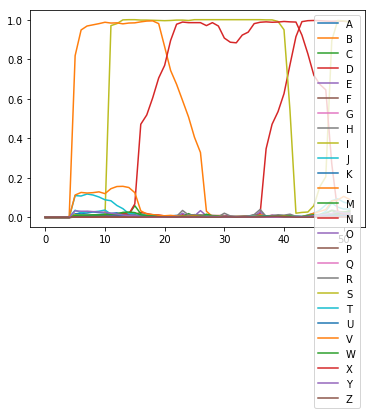

correct: 84 total: 91 accuracy: 0.923 avgEditDist 0.077
('A', 'A'): 41
('S', 'S'): 25
('E', 'E'): 36
('T', 'T'): 27
('H', 'H'): 11
('D', 'D'): 24
('K', 'K'): 7
('N', 'N'): 21
('L', 'L'): 19
('R', 'R'): 27
('O', 'O'): 32
('V', 'V'): 19
('B', 'B'): 9
('C', 'C'): 10
('G', 'G'): 17
('P', 'P'): 7
('I', 'I'): 12
('F', 'F'): 8
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 1
[[0.00293152 0.0020565  0.00288314 ... 0.00218704 0.0456023  0.00135326]
 [0.00321571 0.00207301 0.00304675 ... 0.00230782 0.03477333 0.00150111]
 [0.00349453 0.00212747 0.00313427 ... 0.00222977 0.03760782 0.00158583]
 ...
 [0.00160083 0.00095838 0.00191824 ... 0.00368491 0.0242905  0.00087997]
 [0.00151422 0.00091477 0.00179885 ... 0.00371082 0.01950646 0.00086391]
 [0.00165272 0.00095464 0.00185225 ... 0.00403406 0.02536555 0.00080915]]
--pred for 0 20 ['E 0.97 ', 'V 0.13 ', 'T 0.07 ', 'J 0.06 ', 'Y 0.05 ']
--pred for 0 24 ['E 0.99 ', 'V 0.12 

[[0.00086029 0.00083944 0.00139398 ... 0.00095277 0.02084791 0.00040674]
 [0.00088391 0.0008958  0.00141716 ... 0.00110145 0.0171218  0.00042159]
 [0.00086723 0.00088893 0.00137161 ... 0.00110444 0.01532837 0.00042333]
 ...
 [0.00390278 0.00136637 0.00340563 ... 0.00368387 0.02594946 0.00128593]
 [0.00296792 0.00122372 0.00283117 ... 0.00318584 0.02104779 0.00098478]
 [0.00246066 0.00105908 0.00254082 ... 0.00339229 0.0208193  0.00079387]]
--pred for 0 20 ['M 0.40 ', 'J 0.13 ', 'T 0.09 ', 'V 0.07 ', 'N 0.03 ']
--pred for 0 24 ['M 0.62 ', 'J 0.12 ', 'V 0.10 ', 'T 0.08 ', 'L 0.02 ']
--pred for 0 28 ['M 0.69 ', 'J 0.11 ', 'V 0.10 ', 'T 0.06 ', 'L 0.02 ']
--pred for 0 32 ['M 0.75 ', 'J 0.30 ', 'V 0.13 ', 'T 0.06 ', 'L 0.03 ']
--pred for 0 36 ['M 0.81 ', 'J 0.22 ', 'V 0.21 ', 'T 0.05 ', 'L 0.03 ']
--pred for 0 40 ['M 0.92 ', 'V 0.23 ', 'J 0.06 ', 'T 0.06 ', 'L 0.04 ']
--pred for 0 44 ['M 0.97 ', 'V 0.16 ', 'T 0.07 ', 'L 0.06 ', 'J 0.04 ']
--pred for 0 48 ['M 0.99 ', 'V 0.09 ', 'T 0.06 ', 'L

[[0.001246   0.00079836 0.00124167 ... 0.00229156 0.03618053 0.00048963]
 [0.00140893 0.00083627 0.00128869 ... 0.00314633 0.03051829 0.00053953]
 [0.00144902 0.00082368 0.00126232 ... 0.00314497 0.02762466 0.00055694]
 ...
 [0.00260139 0.00161519 0.00236809 ... 0.00147753 0.03200306 0.001112  ]
 [0.00228141 0.00107593 0.00178913 ... 0.00141608 0.03940031 0.00092013]
 [0.00185799 0.0010111  0.0015316  ... 0.00145573 0.02180223 0.00067867]]
--pred for 0 20 ['F 0.86 ', 'J 0.23 ', 'V 0.12 ', 'T 0.05 ', 'Y 0.04 ']
--pred for 0 24 ['F 0.98 ', 'J 0.16 ', 'V 0.12 ', 'T 0.05 ', 'L 0.04 ']
--pred for 0 28 ['F 0.99 ', 'V 0.13 ', 'J 0.09 ', 'T 0.05 ', 'L 0.04 ']
--pred for 0 32 ['F 0.93 ', 'V 0.15 ', 'J 0.07 ', 'T 0.06 ', 'L 0.04 ']
--pred for 0 36 ['P 0.97 ', 'V 0.14 ', 'T 0.08 ', 'J 0.03 ', 'L 0.03 ']
--pred for 0 40 ['P 0.99 ', 'V 0.12 ', 'T 0.08 ', 'J 0.03 ', 'Y 0.03 ']
--pred for 0 44 ['P 0.98 ', 'V 0.16 ', 'Y 0.06 ', 'T 0.05 ', 'H 0.04 ']
--pred for 0 48 ['P 0.99 ', 'V 0.23 ', 'Y 0.09 ', 'L

edit distance: 0
correct: 89 total: 96 accuracy: 0.927 avgEditDist 0.073
('A', 'A'): 42
('S', 'S'): 28
('E', 'E'): 39
('T', 'T'): 27
('H', 'H'): 11
('D', 'D'): 26
('K', 'K'): 7
('N', 'N'): 23
('L', 'L'): 19
('R', 'R'): 29
('O', 'O'): 33
('V', 'V'): 21
('B', 'B'): 9
('C', 'C'): 10
('G', 'G'): 17
('P', 'P'): 8
('I', 'I'): 13
('F', 'F'): 9
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 2
[[1.38412009e-03 1.02541118e-03 1.45981368e-03 3.88762006e-03
  4.09038039e-03 2.14858656e-03 1.48209347e-03 1.58921126e-02
  3.06879401e-01 1.52803189e-03 1.46907549e-02 9.05133691e-03
  2.53509521e-01 2.34352355e-03 1.89545248e-02 5.68145281e-03
  2.58078007e-03 1.92608556e-03 1.11378683e-02 2.22374755e-03
  1.67102814e-02 3.77345714e-03 5.46590090e-02 6.19849795e-03
  1.42792627e-01 9.50848218e-03 1.88389502e-03 4.74417061e-02
  6.14129181e-04]
 [1.29409682e-03 9.35142511e-04 1.33302715e-03 5.91709651e-03
  4.38856194e-03 3.07

LOO LOO
edit distance: 0
correct: 91 total: 98 accuracy: 0.929 avgEditDist 0.071
('A', 'A'): 42
('S', 'S'): 28
('E', 'E'): 39
('T', 'T'): 27
('H', 'H'): 11
('D', 'D'): 26
('K', 'K'): 7
('N', 'N'): 24
('L', 'L'): 20
('R', 'R'): 30
('O', 'O'): 35
('V', 'V'): 21
('B', 'B'): 9
('C', 'C'): 10
('G', 'G'): 17
('P', 'P'): 8
('I', 'I'): 13
('F', 'F'): 9
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 2
[[0.00127326 0.00091016 0.00139542 ... 0.00156104 0.0660423  0.00053784]
 [0.00123505 0.00092853 0.001397   ... 0.00228174 0.04732367 0.00059001]
 [0.00123068 0.00090851 0.00137761 ... 0.00235585 0.04077461 0.00059235]
 ...
 [0.001508   0.00114451 0.00135708 ... 0.00154827 0.02934829 0.00077706]
 [0.00139035 0.00101465 0.00136723 ... 0.00131945 0.02936069 0.00070698]
 [0.00148674 0.00105506 0.00149474 ... 0.00116939 0.02278652 0.00069079]]
--pred for 0 20 ['J 0.24 ', 'V 0.16 ', 'F 0.13 ', 'T 0.07 ', 'Y 0.07 ']
--pred for 

GLEPNE GLEPNE
edit distance: 0
correct: 93 total: 100 accuracy: 0.930 avgEditDist 0.070
('A', 'A'): 42
('S', 'S'): 28
('E', 'E'): 41
('T', 'T'): 28
('H', 'H'): 12
('D', 'D'): 26
('K', 'K'): 7
('N', 'N'): 25
('L', 'L'): 21
('R', 'R'): 30
('O', 'O'): 35
('V', 'V'): 21
('B', 'B'): 9
('C', 'C'): 10
('G', 'G'): 18
('P', 'P'): 10
('I', 'I'): 13
('F', 'F'): 9
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 2
[[0.00151607 0.00116444 0.00155055 ... 0.00085453 0.018225   0.00054398]
 [0.00124468 0.00090179 0.00121655 ... 0.00090742 0.01302544 0.00034066]
 [0.00159546 0.00096768 0.00130963 ... 0.00222424 0.01705318 0.00047841]
 ...
 [0.00343753 0.00213382 0.00328274 ... 0.00227709 0.03609304 0.0015657 ]
 [0.00363704 0.00202706 0.00321586 ... 0.00239139 0.03111306 0.00166706]
 [0.0032799  0.00191851 0.00297398 ... 0.00224051 0.03230461 0.00161938]]
--pred for 0 20 ['J 0.22 ', 'T 0.12 ', 'N 0.05 ', 'A 0.04 ', 'V 0.04 ']
--p

[[0.00157874 0.00073937 0.0014465  ... 0.00113506 0.03540721 0.00094754]
 [0.00195248 0.00104165 0.00142879 ... 0.00129909 0.02744205 0.0010975 ]
 [0.00211687 0.00112232 0.00157913 ... 0.00143429 0.02904816 0.00128966]
 ...
 [0.00170056 0.00083939 0.00150411 ... 0.00114298 0.01954046 0.00101686]
 [0.00192162 0.00098579 0.00151698 ... 0.00138622 0.02764344 0.00100145]
 [0.00175602 0.0010579  0.00168074 ... 0.00202021 0.02629725 0.0007609 ]]
--pred for 0 20 ['T 0.49 ', 'V 0.06 ', 'J 0.04 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 24 ['T 0.92 ', 'V 0.08 ', 'J 0.07 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 28 ['T 0.92 ', 'V 0.08 ', 'J 0.06 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 32 ['T 0.95 ', 'V 0.10 ', 'J 0.04 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 36 ['T 0.98 ', 'V 0.11 ', 'L 0.04 ', 'J 0.03 ', 'Y 0.03 ']
--pred for 0 40 ['T 0.99 ', 'V 0.12 ', 'Y 0.04 ', 'L 0.03 ', 'A 0.03 ']
--pred for 0 44 ['T 0.99 ', 'V 0.14 ', 'Y 0.04 ', 'L 0.03 ', 'A 0.03 ']
--pred for 0 48 ['T 0.99 ', 'V 0.22 ', 'I 0.17 ', 'L

[[1.22389058e-03 8.48509488e-04 1.27608981e-03 3.07053188e-03
  3.65216727e-03 1.93623954e-03 1.29926973e-03 3.85176856e-03
  2.42045224e-01 1.40535610e-03 1.42972469e-02 6.81105675e-03
  2.16137379e-01 2.29051826e-03 1.80998407e-02 5.73956687e-03
  1.91135914e-03 1.60025805e-03 2.21904255e-02 1.97013584e-03
  1.72325186e-02 4.11893660e-03 1.09747306e-01 7.80497305e-03
  1.40466496e-01 9.56031494e-03 1.75198296e-03 4.46224213e-02
  5.28204953e-04]
 [1.23036117e-03 8.19880923e-04 1.16213202e-03 7.84031302e-03
  4.14221501e-03 3.66665446e-03 1.86375645e-03 3.39365611e-03
  9.57280934e-01 2.36432697e-03 1.11698862e-02 6.30166149e-03
  1.91524819e-01 2.77535175e-03 2.79087573e-02 4.20803437e-03
  3.38408537e-03 2.31602625e-03 1.20553412e-02 2.03715288e-03
  1.34297712e-02 6.34701829e-03 3.95147838e-02 1.10752936e-02
  1.36007190e-01 1.03531079e-02 2.82922643e-03 3.87116037e-02
  5.16952074e-04]
 [1.25825766e-03 7.66595243e-04 1.16787001e-03 1.02410400e-02
  4.78656869e-03 3.45510547e-03 2.

TVM TVM
edit distance: 0
correct: 99 total: 106 accuracy: 0.934 avgEditDist 0.066
('A', 'A'): 44
('S', 'S'): 29
('E', 'E'): 45
('T', 'T'): 32
('H', 'H'): 13
('D', 'D'): 27
('K', 'K'): 7
('N', 'N'): 27
('L', 'L'): 21
('R', 'R'): 31
('O', 'O'): 37
('V', 'V'): 22
('B', 'B'): 9
('C', 'C'): 11
('G', 'G'): 18
('P', 'P'): 10
('I', 'I'): 14
('F', 'F'): 10
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 3
[[8.87079397e-04 8.29777448e-04 1.44442753e-03 4.43389779e-03
  1.81047560e-03 2.35202536e-03 1.80456508e-03 5.76587569e-04
  5.28671453e-03 1.65821053e-03 9.25844721e-03 1.00103850e-02
  7.80442953e-02 1.01905374e-03 2.44562551e-02 3.32434952e-01
  4.66296040e-02 3.22951446e-03 3.48182558e-03 1.87053252e-03
  7.19109317e-04 1.02631084e-03 8.16259086e-02 8.55893362e-03
  8.11256096e-02 1.27469283e-02 8.68004165e-04 2.37513967e-02
  4.20060329e-04]
 [9.26434295e-04 8.77630431e-04 1.44997274e-03 6.09638635e-03
  2.122298

[[0.00171699 0.00088186 0.00155375 ... 0.00101995 0.02935265 0.00046289]
 [0.00233086 0.00123544 0.0014652  ... 0.00236826 0.0393978  0.00068279]
 [0.00336366 0.00171811 0.00163947 ... 0.00308908 0.04032084 0.001128  ]
 ...
 [0.00148286 0.0010397  0.00148803 ... 0.00125426 0.06088012 0.0007837 ]
 [0.0014826  0.00102252 0.00141931 ... 0.00113542 0.05827668 0.00076888]
 [0.00144847 0.00099048 0.00143087 ... 0.00115143 0.05942982 0.00071021]]
--pred for 0 20 ['T 0.10 ', 'V 0.09 ', 'J 0.07 ', 'U 0.04 ', 'L 0.03 ']
--pred for 0 24 ['R 0.29 ', 'F 0.25 ', 'V 0.09 ', 'J 0.08 ', 'A 0.05 ']
--pred for 0 28 ['R 0.84 ', 'J 0.15 ', 'V 0.11 ', 'F 0.08 ', 'A 0.08 ']
--pred for 0 32 ['R 0.86 ', 'J 0.18 ', 'V 0.11 ', 'T 0.04 ', 'F 0.04 ']
--pred for 0 36 ['R 0.95 ', 'V 0.14 ', 'T 0.07 ', 'J 0.06 ', 'F 0.03 ']
--pred for 0 40 ['R 0.99 ', 'V 0.13 ', 'T 0.10 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 44 ['R 0.99 ', 'V 0.12 ', 'T 0.10 ', 'L 0.03 ', 'Y 0.03 ']
--pred for 0 48 ['R 0.99 ', 'T 0.17 ', 'V 0.09 ', 'L

[[0.00169147 0.00097934 0.00148046 ... 0.00108076 0.0302135  0.0006479 ]
 [0.00174561 0.00104793 0.00151758 ... 0.00120084 0.02402574 0.0007865 ]
 [0.00189505 0.00121374 0.00181684 ... 0.00123641 0.02994343 0.00093333]
 ...
 [0.00204869 0.00121275 0.00244119 ... 0.00256067 0.02877207 0.00209184]
 [0.00181451 0.00108016 0.00204221 ... 0.00246805 0.02126067 0.00159098]
 [0.0016916  0.00100106 0.00190297 ... 0.00228365 0.02161369 0.00125044]]
--pred for 0 20 ['J 0.50 ', 'T 0.12 ', 'A 0.10 ', 'V 0.05 ', 'L 0.04 ']
--pred for 0 24 ['A 0.46 ', 'J 0.34 ', 'T 0.10 ', 'V 0.05 ', 'L 0.04 ']
--pred for 0 28 ['A 0.79 ', 'J 0.27 ', 'T 0.07 ', 'V 0.05 ', 'Y 0.03 ']
--pred for 0 32 ['A 0.95 ', 'V 0.08 ', 'T 0.06 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 36 ['A 0.98 ', 'V 0.07 ', 'T 0.05 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 40 ['A 0.99 ', 'V 0.08 ', 'T 0.05 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 44 ['A 0.99 ', 'V 0.08 ', 'T 0.05 ', 'Y 0.04 ', 'L 0.04 ']
--pred for 0 48 ['A 0.99 ', 'V 0.07 ', 'T 0.05 ', 'Y

AAEKR AAEKR
edit distance: 0
correct: 105 total: 112 accuracy: 0.938 avgEditDist 0.062
('A', 'A'): 47
('S', 'S'): 29
('E', 'E'): 47
('T', 'T'): 33
('H', 'H'): 14
('D', 'D'): 28
('K', 'K'): 9
('N', 'N'): 30
('L', 'L'): 21
('R', 'R'): 34
('O', 'O'): 38
('V', 'V'): 22
('B', 'B'): 10
('C', 'C'): 12
('G', 'G'): 18
('P', 'P'): 10
('I', 'I'): 15
('F', 'F'): 10
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 3
[[1.60521222e-03 1.06439425e-03 1.41158525e-03 4.76397062e-03
  3.35308816e-03 1.33909355e-03 1.07930042e-03 9.22043622e-03
  2.38284767e-02 1.44885259e-03 1.67507324e-02 1.57118849e-02
  2.07306996e-01 1.74146867e-03 2.12715603e-02 1.04043707e-02
  3.47486231e-03 2.22578715e-03 6.04348769e-03 2.25512264e-03
  1.52130760e-02 2.46133446e-03 1.40643433e-01 5.74997626e-03
  1.45074517e-01 1.03380037e-02 1.35029689e-03 3.37920822e-02
  6.52858813e-04]
 [1.59511995e-03 1.07691612e-03 1.27641554e-03 5.83277270e-03
  3.

DINN DINN
edit distance: 0
correct: 107 total: 114 accuracy: 0.939 avgEditDist 0.061
('A', 'A'): 47
('S', 'S'): 29
('E', 'E'): 47
('T', 'T'): 33
('H', 'H'): 14
('D', 'D'): 29
('K', 'K'): 9
('N', 'N'): 32
('L', 'L'): 21
('R', 'R'): 35
('O', 'O'): 39
('V', 'V'): 22
('B', 'B'): 10
('C', 'C'): 12
('G', 'G'): 18
('P', 'P'): 10
('I', 'I'): 16
('F', 'F'): 10
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 3
[[0.0014702  0.00074892 0.00131006 ... 0.00148728 0.03401374 0.00067248]
 [0.0017811  0.00097016 0.001823   ... 0.00179259 0.04512052 0.00091404]
 [0.00200872 0.00120701 0.00243499 ... 0.00268346 0.05098358 0.00137663]
 ...
 [0.00232262 0.00181845 0.00154137 ... 0.00254218 0.04333853 0.00131287]
 [0.00206785 0.00170795 0.00148703 ... 0.0025521  0.03805887 0.00122364]
 [0.0018653  0.00151098 0.00147501 ... 0.00288176 0.04838964 0.00091417]]
--pred for 0 20 ['V 0.14 ', 'T 0.08 ', 'J 0.05 ', 'Y 0.03 ', 'L 0.03 ']
--pr

NRCE NRCE
edit distance: 0
correct: 109 total: 116 accuracy: 0.940 avgEditDist 0.060
('A', 'A'): 47
('S', 'S'): 29
('E', 'E'): 48
('T', 'T'): 34
('H', 'H'): 14
('D', 'D'): 29
('K', 'K'): 9
('N', 'N'): 34
('L', 'L'): 21
('R', 'R'): 36
('O', 'O'): 41
('V', 'V'): 22
('B', 'B'): 10
('C', 'C'): 13
('G', 'G'): 19
('P', 'P'): 10
('I', 'I'): 16
('F', 'F'): 10
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 3
[[0.00313625 0.00211737 0.00306639 ... 0.00243174 0.03433043 0.00144745]
 [0.00317238 0.00216703 0.00306264 ... 0.00244082 0.03120274 0.00145388]
 [0.003284   0.00210287 0.00304121 ... 0.00214225 0.03222004 0.0014981 ]
 ...
 [0.00192606 0.00102441 0.00142409 ... 0.00127917 0.01378448 0.00107792]
 [0.00150442 0.00084986 0.0012556  ... 0.00096004 0.0153451  0.00069984]
 [0.00154923 0.00086268 0.00127623 ... 0.00103164 0.0154892  0.00070359]]
--pred for 0 20 ['E 0.98 ', 'V 0.13 ', 'T 0.07 ', 'J 0.06 ', 'L 0.04 ']
--pr

EIRLRA EIRLRA
edit distance: 0
correct: 111 total: 118 accuracy: 0.941 avgEditDist 0.059
('A', 'A'): 48
('S', 'S'): 29
('E', 'E'): 51
('T', 'T'): 35
('H', 'H'): 14
('D', 'D'): 29
('K', 'K'): 9
('N', 'N'): 34
('L', 'L'): 22
('R', 'R'): 38
('O', 'O'): 41
('V', 'V'): 22
('B', 'B'): 10
('C', 'C'): 13
('G', 'G'): 19
('P', 'P'): 10
('I', 'I'): 17
('F', 'F'): 10
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 3
[[0.00128711 0.00059404 0.00118678 ... 0.00116669 0.04834642 0.00069311]
 [0.0014574  0.00057606 0.00112369 ... 0.00149981 0.03795983 0.00080235]
 [0.00150618 0.00069709 0.00131284 ... 0.00175406 0.03009167 0.00090739]
 ...
 [0.00257822 0.00105955 0.00181676 ... 0.00195576 0.03704967 0.00098313]
 [0.00236577 0.00090547 0.0015105  ... 0.00268043 0.03427267 0.00096041]
 [0.00217583 0.00093349 0.00154249 ... 0.0018118  0.02279631 0.00082956]]
--pred for 0 20 ['V 0.25 ', 'T 0.14 ', 'Y 0.05 ', 'J 0.04 ', 'L 0.03 ']


[[0.00289352 0.00104075 0.00272472 ... 0.00334144 0.05057117 0.00096103]
 [0.00364365 0.00117069 0.00307924 ... 0.00342755 0.04250057 0.00123866]
 [0.00420501 0.00131558 0.003465   ... 0.00378481 0.04577307 0.00142141]
 ...
 [0.00441662 0.00146879 0.00398071 ... 0.00353935 0.02767195 0.00143672]
 [0.00334241 0.0012455  0.00318879 ... 0.00268664 0.02533098 0.00114126]
 [0.0030876  0.00123657 0.00303575 ... 0.0026097  0.02337436 0.000949  ]]
--pred for 0 20 ['S 0.87 ', 'V 0.14 ', 'J 0.11 ', 'T 0.08 ', 'Y 0.05 ']
--pred for 0 24 ['S 0.95 ', 'V 0.16 ', 'T 0.09 ', 'J 0.05 ', 'L 0.05 ']
--pred for 0 28 ['S 0.97 ', 'V 0.15 ', 'T 0.08 ', 'J 0.06 ', 'L 0.05 ']
--pred for 0 32 ['S 0.98 ', 'V 0.14 ', 'T 0.09 ', 'L 0.06 ', 'J 0.04 ']
--pred for 0 36 ['S 0.99 ', 'V 0.15 ', 'T 0.07 ', 'L 0.07 ', 'Y 0.04 ']
--pred for 0 40 ['S 0.99 ', 'V 0.17 ', 'T 0.08 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 44 ['S 0.99 ', 'V 0.17 ', 'T 0.08 ', 'L 0.06 ', 'J 0.04 ']
--pred for 0 48 ['I 0.99 ', 'S 0.99 ', 'V 0.18 ', 'L

LDCEVH LDCEVH
edit distance: 0
correct: 114 total: 121 accuracy: 0.942 avgEditDist 0.058
('A', 'A'): 49
('S', 'S'): 31
('E', 'E'): 52
('T', 'T'): 36
('H', 'H'): 15
('D', 'D'): 30
('K', 'K'): 9
('N', 'N'): 34
('L', 'L'): 23
('R', 'R'): 40
('O', 'O'): 41
('V', 'V'): 24
('B', 'B'): 11
('C', 'C'): 14
('G', 'G'): 19
('P', 'P'): 10
('I', 'I'): 17
('F', 'F'): 10
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 3
[[1.58251228e-03 1.04728038e-03 1.56361307e-03 2.02526562e-02
  4.11700457e-03 1.02816487e-03 5.21228462e-03 4.38359985e-03
  3.18958005e-03 1.52725307e-03 8.35393742e-03 4.92379963e-02
  2.11288854e-02 1.34776067e-03 2.38026172e-01 3.94391548e-03
  1.25572539e-03 1.52654282e-03 2.33436073e-03 2.65893154e-03
  3.48776369e-03 8.02101218e-04 2.16372639e-01 3.65382503e-03
  1.14143483e-01 8.45651515e-03 8.09361343e-04 3.07597723e-02
  1.14744424e-03]
 [1.85321213e-03 1.46331696e-03 2.44842935e-03 1.86157655e-02
  

TDAPS TDAPS
edit distance: 0
correct: 116 total: 123 accuracy: 0.943 avgEditDist 0.057
('A', 'A'): 50
('S', 'S'): 32
('E', 'E'): 52
('T', 'T'): 37
('H', 'H'): 16
('D', 'D'): 32
('K', 'K'): 9
('N', 'N'): 34
('L', 'L'): 23
('R', 'R'): 40
('O', 'O'): 41
('V', 'V'): 24
('B', 'B'): 11
('C', 'C'): 14
('G', 'G'): 19
('P', 'P'): 11
('I', 'I'): 17
('F', 'F'): 10
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 3
[[0.00184305 0.00107383 0.00156    ... 0.00119896 0.02526854 0.00076497]
 [0.00205445 0.00112619 0.00167471 ... 0.00182038 0.03004989 0.00086954]
 [0.00260988 0.00134181 0.00213644 ... 0.00140168 0.03586927 0.00113295]
 ...
 [0.00182098 0.00090012 0.0016164  ... 0.00147994 0.02105751 0.00094402]
 [0.00190759 0.00091753 0.00162432 ... 0.00152604 0.02205519 0.00113263]
 [0.00184803 0.00096558 0.00153037 ... 0.00153069 0.02534783 0.00097386]]
--pred for 0 20 ['A 0.80 ', 'J 0.15 ', 'T 0.09 ', 'L 0.04 ', 'V 0.04 ']
--

MNH MNH
edit distance: 0
correct: 118 total: 125 accuracy: 0.944 avgEditDist 0.056
('A', 'A'): 51
('S', 'S'): 32
('E', 'E'): 53
('T', 'T'): 37
('H', 'H'): 18
('D', 'D'): 32
('K', 'K'): 9
('N', 'N'): 36
('L', 'L'): 23
('R', 'R'): 40
('O', 'O'): 41
('V', 'V'): 24
('B', 'B'): 11
('C', 'C'): 15
('G', 'G'): 19
('P', 'P'): 11
('I', 'I'): 17
('F', 'F'): 10
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 4
[[1.17000227e-03 7.98395486e-04 1.28835661e-03 2.87013338e-03
  2.61197798e-03 2.26294925e-03 1.00304896e-03 3.89331556e-03
  1.18574917e-01 1.28725218e-03 1.64492559e-02 9.19039734e-03
  1.52793959e-01 1.63503538e-03 2.14153212e-02 1.22476891e-02
  4.27323114e-03 2.85447459e-03 7.38833658e-03 2.02671601e-03
  4.92710946e-03 3.14939674e-03 4.82211001e-02 5.94126107e-03
  1.86742470e-01 1.10914437e-02 1.26370683e-03 4.85791080e-02
  4.69094288e-04]
 [1.41077954e-03 9.28905618e-04 1.26380438e-03 7.86343403e-03
  4.0265

OOHL OOHL
edit distance: 0
correct: 120 total: 127 accuracy: 0.945 avgEditDist 0.055
('A', 'A'): 51
('S', 'S'): 32
('E', 'E'): 53
('T', 'T'): 37
('H', 'H'): 19
('D', 'D'): 32
('K', 'K'): 9
('N', 'N'): 36
('L', 'L'): 24
('R', 'R'): 40
('O', 'O'): 44
('V', 'V'): 24
('B', 'B'): 11
('C', 'C'): 15
('G', 'G'): 19
('P', 'P'): 11
('I', 'I'): 17
('F', 'F'): 11
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 4
[[0.00134056 0.00067626 0.0012719  ... 0.00145538 0.03496413 0.00059851]
 [0.0017615  0.00094652 0.00176736 ... 0.00162451 0.03854631 0.00083986]
 [0.00191297 0.00112457 0.0022086  ... 0.00237474 0.04488188 0.00115021]
 ...
 [0.00159282 0.00104168 0.00227326 ... 0.00312938 0.02379311 0.0008419 ]
 [0.00146016 0.00095211 0.00203702 ... 0.00367771 0.02231388 0.00081846]
 [0.00155178 0.00091048 0.00183409 ... 0.00374069 0.02630481 0.00070481]]
--pred for 0 20 ['V 0.12 ', 'T 0.08 ', 'J 0.05 ', 'Y 0.04 ', 'L 0.03 ']
--pr

ABC ABC
edit distance: 0
correct: 122 total: 129 accuracy: 0.946 avgEditDist 0.054
('A', 'A'): 52
('S', 'S'): 32
('E', 'E'): 53
('T', 'T'): 37
('H', 'H'): 19
('D', 'D'): 33
('K', 'K'): 9
('N', 'N'): 36
('L', 'L'): 24
('R', 'R'): 40
('O', 'O'): 46
('V', 'V'): 25
('B', 'B'): 12
('C', 'C'): 16
('G', 'G'): 19
('P', 'P'): 12
('I', 'I'): 17
('F', 'F'): 11
('W', 'W'): 5
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 4
[[0.00143383 0.00106404 0.00157856 ... 0.00166211 0.04113344 0.00071125]
 [0.00116795 0.00084144 0.00124053 ... 0.00201528 0.03436913 0.00063847]
 [0.00120263 0.00090486 0.00127532 ... 0.00229871 0.03465518 0.00072903]
 ...
 [0.0024041  0.00134998 0.00223328 ... 0.00214524 0.017901   0.00178229]
 [0.00226174 0.00125425 0.00204733 ... 0.00195021 0.01936265 0.00148998]
 [0.00204768 0.00120881 0.00198547 ... 0.00187986 0.01672637 0.00134062]]
--pred for 0 20 ['J 0.18 ', 'V 0.14 ', 'E 0.08 ', 'H 0.07 ', 'Y 0.04 ']
--pred

[[0.00163884 0.0012468  0.00177793 ... 0.0013594  0.02053811 0.00075504]
 [0.00184131 0.00119241 0.00167932 ... 0.00113178 0.0188922  0.00069659]
 [0.00166567 0.00103487 0.00146959 ... 0.00152064 0.02095017 0.0006817 ]
 ...
 [0.00175307 0.00131577 0.00206129 ... 0.00182947 0.02499879 0.00212205]
 [0.00153396 0.00113081 0.00183443 ... 0.00160303 0.01665366 0.00143538]
 [0.00169068 0.00115291 0.00190926 ... 0.00141853 0.01957574 0.0011327 ]]
--pred for 0 20 ['J 0.79 ', 'T 0.15 ', 'A 0.11 ', 'V 0.03 ', 'Y 0.02 ']
--pred for 0 24 ['J 0.72 ', 'A 0.11 ', 'T 0.10 ', 'V 0.05 ', 'L 0.03 ']
--pred for 0 28 ['J 0.71 ', 'A 0.16 ', 'T 0.06 ', 'V 0.05 ', 'N 0.04 ']
--pred for 0 32 ['J 0.50 ', 'A 0.17 ', 'F 0.09 ', 'V 0.07 ', 'T 0.03 ']
--pred for 0 36 ['A 0.47 ', 'J 0.10 ', 'V 0.08 ', 'P 0.06 ', 'T 0.04 ']
--pred for 0 40 ['A 0.98 ', 'V 0.09 ', 'T 0.05 ', 'Y 0.04 ', 'L 0.04 ']
--pred for 0 44 ['A 0.99 ', 'V 0.07 ', 'Y 0.05 ', 'T 0.04 ', 'J 0.03 ']
--pred for 0 48 ['A 0.99 ', 'V 0.09 ', 'Y 0.04 ', 'L

WAECAC WAECAC
edit distance: 0
correct: 125 total: 132 accuracy: 0.947 avgEditDist 0.053
('A', 'A'): 56
('S', 'S'): 33
('E', 'E'): 55
('T', 'T'): 37
('H', 'H'): 20
('D', 'D'): 33
('K', 'K'): 9
('N', 'N'): 37
('L', 'L'): 25
('R', 'R'): 40
('O', 'O'): 46
('V', 'V'): 26
('B', 'B'): 13
('C', 'C'): 19
('G', 'G'): 19
('P', 'P'): 12
('I', 'I'): 17
('F', 'F'): 11
('W', 'W'): 6
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 4
[[0.00165531 0.00108635 0.00165255 ... 0.00086473 0.03906035 0.00067909]
 [0.00133853 0.00097378 0.00180471 ... 0.00112378 0.03640226 0.0005664 ]
 [0.00107054 0.00086572 0.00158941 ... 0.00104472 0.02311125 0.00047473]
 ...
 [0.00302044 0.00126127 0.00285184 ... 0.00490813 0.03015979 0.00189518]
 [0.00212354 0.00105901 0.00206459 ... 0.00591875 0.03406224 0.00151523]
 [0.0019002  0.00093586 0.00177014 ... 0.00494796 0.03672354 0.00115428]]
--pred for 0 20 ['T 0.19 ', 'V 0.17 ', 'I 0.12 ', 'J 0.08 ', 'L 0.05 ']


[[0.00290348 0.00197102 0.00284524 ... 0.00195806 0.04158051 0.00145278]
 [0.00311125 0.00207914 0.00309595 ... 0.00209415 0.03548305 0.00161933]
 [0.00340497 0.00218107 0.00322478 ... 0.00222284 0.03674093 0.0017327 ]
 ...
 [0.00119217 0.00059159 0.00097737 ... 0.00072896 0.01322496 0.00079082]
 [0.00118396 0.00073853 0.00127039 ... 0.00078263 0.01793504 0.00076666]
 [0.00123874 0.00083039 0.00128305 ... 0.00102855 0.01822754 0.00064425]]
--pred for 0 20 ['E 0.97 ', 'V 0.12 ', 'T 0.08 ', 'J 0.05 ', 'L 0.05 ']
--pred for 0 24 ['E 0.98 ', 'V 0.10 ', 'T 0.09 ', 'L 0.04 ', 'J 0.04 ']
--pred for 0 28 ['E 0.98 ', 'V 0.10 ', 'T 0.09 ', 'L 0.05 ', 'A 0.04 ']
--pred for 0 32 ['E 0.99 ', 'V 0.11 ', 'T 0.09 ', 'L 0.05 ', 'A 0.05 ']
--pred for 0 36 ['E 0.99 ', 'V 0.13 ', 'T 0.08 ', 'L 0.05 ', 'A 0.04 ']
--pred for 0 40 ['E 0.99 ', 'V 0.13 ', 'T 0.09 ', 'L 0.05 ', 'A 0.04 ']
--pred for 0 44 ['E 0.98 ', 'I 0.97 ', 'V 0.18 ', 'L 0.07 ', 'T 0.05 ']
--pred for 0 48 ['I 0.99 ', 'E 0.98 ', 'V 0.19 ', 'L

SMRRER SMRRER
edit distance: 0
correct: 128 total: 135 accuracy: 0.948 avgEditDist 0.052
('A', 'A'): 56
('S', 'S'): 34
('E', 'E'): 57
('T', 'T'): 37
('H', 'H'): 20
('D', 'D'): 35
('K', 'K'): 10
('N', 'N'): 40
('L', 'L'): 26
('R', 'R'): 44
('O', 'O'): 46
('V', 'V'): 27
('B', 'B'): 13
('C', 'C'): 21
('G', 'G'): 19
('P', 'P'): 12
('I', 'I'): 17
('F', 'F'): 11
('W', 'W'): 6
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 5
[[0.00288256 0.00104044 0.00260211 ... 0.00263031 0.06269796 0.00092644]
 [0.00353141 0.00120588 0.00304725 ... 0.00342457 0.04826965 0.00121911]
 [0.00388833 0.00117037 0.00303369 ... 0.00297704 0.05114146 0.0013842 ]
 ...
 [0.0016283  0.00106374 0.00178133 ... 0.00120199 0.01935952 0.00134444]
 [0.00163103 0.00105504 0.00176874 ... 0.00121901 0.01739307 0.00125654]
 [0.001641   0.0010632  0.00182784 ... 0.00124113 0.01923079 0.00121244]]
--pred for 0 20 ['S 0.77 ', 'V 0.17 ', 'J 0.09 ', 'T 0.06 ', 'Y 0.06 ']

FAAMT FAAMT
edit distance: 0
correct: 130 total: 137 accuracy: 0.949 avgEditDist 0.051
('A', 'A'): 58
('S', 'S'): 35
('E', 'E'): 57
('T', 'T'): 38
('H', 'H'): 20
('D', 'D'): 35
('K', 'K'): 10
('N', 'N'): 41
('L', 'L'): 28
('R', 'R'): 45
('O', 'O'): 46
('V', 'V'): 27
('B', 'B'): 13
('C', 'C'): 21
('G', 'G'): 19
('P', 'P'): 12
('I', 'I'): 17
('F', 'F'): 12
('W', 'W'): 6
-------('H', 'R'): 1
('U', 'U'): 5
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 6
[[0.00143098 0.00103296 0.0018602  ... 0.00108406 0.03963973 0.00130746]
 [0.00149769 0.00150949 0.00312485 ... 0.00175373 0.03647733 0.00316728]
 [0.00169365 0.00163554 0.00353041 ... 0.00211745 0.04310815 0.0025889 ]
 ...
 [0.00272347 0.00159689 0.00255176 ... 0.00159281 0.03466789 0.00124626]
 [0.00249038 0.00113722 0.00202229 ... 0.00187341 0.0417018  0.00102981]
 [0.00227686 0.00097109 0.00170591 ... 0.00239637 0.03251915 0.000929  ]]
--pred for 0 20 ['T 0.17 ', 'L 0.16 ', 'V 0.14 ', 'J 0.05 ', 'Y 0.04 ']
-

[[0.00141666 0.00094783 0.00141838 ... 0.0014584  0.03417662 0.00050952]
 [0.00132505 0.00083855 0.00121548 ... 0.00255273 0.03199651 0.00052078]
 [0.00170584 0.00110188 0.00103    ... 0.00135537 0.02613195 0.00061018]
 ...
 [0.00169078 0.00108659 0.00181116 ... 0.00124596 0.01851402 0.00123284]
 [0.00169597 0.00108412 0.00184483 ... 0.00125299 0.01841013 0.00127209]
 [0.00165782 0.00105426 0.00184827 ... 0.00129376 0.02047586 0.0011019 ]]
--pred for 0 20 ['J 0.19 ', 'F 0.17 ', 'V 0.14 ', 'T 0.09 ', 'Y 0.03 ']
--pred for 0 24 ['F 0.95 ', 'V 0.14 ', 'J 0.11 ', 'T 0.04 ', 'Y 0.03 ']
--pred for 0 28 ['R 0.50 ', 'F 0.24 ', 'V 0.17 ', 'T 0.07 ', 'L 0.05 ']
--pred for 0 32 ['R 0.97 ', 'V 0.18 ', 'T 0.09 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 36 ['R 0.99 ', 'V 0.18 ', 'T 0.08 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 40 ['R 0.99 ', 'V 0.17 ', 'T 0.07 ', 'L 0.05 ', 'A 0.03 ']
--pred for 0 44 ['R 0.99 ', 'V 0.16 ', 'T 0.07 ', 'L 0.06 ', 'W 0.03 ']
--pred for 0 48 ['R 0.99 ', 'V 0.19 ', 'U 0.12 ', 'W

[[0.00125881 0.00088148 0.0012684  ... 0.00267903 0.04133551 0.00056809]
 [0.00174504 0.00121638 0.00123342 ... 0.0029603  0.0323922  0.00071967]
 [0.00342691 0.00218784 0.00127136 ... 0.00215896 0.02902731 0.00164633]
 ...
 [0.00370344 0.00202698 0.00307886 ... 0.00256606 0.03000087 0.00222056]
 [0.00362051 0.00207352 0.00304651 ... 0.00254376 0.02981159 0.00190467]
 [0.00327491 0.00186944 0.00284247 ... 0.00225229 0.03036985 0.00166198]]
--pred for 0 20 ['F 0.87 ', 'J 0.28 ', 'V 0.14 ', 'T 0.04 ', 'Y 0.04 ']
--pred for 0 24 ['F 0.79 ', 'R 0.28 ', 'J 0.20 ', 'V 0.16 ', 'T 0.04 ']
--pred for 0 28 ['R 0.98 ', 'V 0.16 ', 'T 0.09 ', 'J 0.09 ', 'L 0.05 ']
--pred for 0 32 ['R 0.99 ', 'V 0.16 ', 'T 0.08 ', 'J 0.06 ', 'L 0.06 ']
--pred for 0 36 ['R 0.99 ', 'V 0.17 ', 'T 0.09 ', 'L 0.06 ', 'J 0.04 ']
--pred for 0 40 ['R 0.99 ', 'J 0.33 ', 'V 0.08 ', 'T 0.06 ', 'A 0.05 ']
--pred for 0 44 ['R 0.99 ', 'J 0.44 ', 'T 0.06 ', 'A 0.06 ', 'V 0.05 ']
--pred for 0 48 ['R 0.99 ', 'J 0.26 ', 'V 0.09 ', 'T

[[0.00143399 0.00109841 0.00143734 ... 0.00131301 0.03708373 0.00062017]
 [0.00132557 0.00101585 0.00122929 ... 0.00209038 0.03764467 0.00058946]
 [0.00130697 0.00092096 0.00121987 ... 0.00233871 0.03454861 0.00057245]
 ...
 [0.00345973 0.00218675 0.00322772 ... 0.00225551 0.02685343 0.00198837]
 [0.00348351 0.00207274 0.00313635 ... 0.00244244 0.02833552 0.00193147]
 [0.00322191 0.00204006 0.00302236 ... 0.00232217 0.02982954 0.00201393]]
--pred for 0 20 ['J 0.27 ', 'T 0.17 ', 'V 0.12 ', 'I 0.04 ', 'F 0.04 ']
--pred for 0 24 ['F 0.69 ', 'J 0.18 ', 'V 0.16 ', 'T 0.06 ', 'R 0.05 ']
--pred for 0 28 ['F 0.92 ', 'J 0.14 ', 'V 0.14 ', 'T 0.04 ', 'Y 0.04 ']
--pred for 0 32 ['F 0.75 ', 'V 0.20 ', 'J 0.13 ', 'P 0.06 ', 'T 0.04 ']
--pred for 0 36 ['P 0.98 ', 'V 0.13 ', 'T 0.07 ', 'Y 0.04 ', 'L 0.04 ']
--pred for 0 40 ['P 0.99 ', 'V 0.13 ', 'T 0.08 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 44 ['P 0.99 ', 'V 0.11 ', 'T 0.07 ', 'Y 0.06 ', 'J 0.03 ']
--pred for 0 48 ['P 0.99 ', 'J 0.29 ', 'V 0.04 ', 'T

[[0.00158904 0.00142598 0.00102323 ... 0.00123011 0.03354006 0.00084574]
 [0.00144741 0.00162864 0.00122988 ... 0.00111882 0.04483992 0.00089564]
 [0.00116887 0.00186244 0.00155712 ... 0.00119705 0.03651423 0.00064707]
 ...
 [0.00145294 0.00119075 0.00248068 ... 0.00310069 0.0245668  0.00109386]
 [0.00141909 0.00101108 0.00207542 ... 0.00349443 0.0190896  0.00090733]
 [0.00151801 0.00094587 0.00190258 ... 0.00360985 0.01918043 0.00073298]]
--pred for 0 20 ['I 1.00 ', 'V 0.22 ', 'T 0.20 ', 'J 0.10 ', 'L 0.06 ']
--pred for 0 24 ['I 1.00 ', 'V 0.27 ', 'T 0.16 ', 'L 0.06 ', 'J 0.06 ']
--pred for 0 28 ['I 0.99 ', 'M 0.35 ', 'V 0.19 ', 'T 0.09 ', 'J 0.07 ']
--pred for 0 32 ['I 1.00 ', 'M 0.58 ', 'V 0.19 ', 'T 0.07 ', 'L 0.04 ']
--pred for 0 36 ['I 1.00 ', 'M 0.33 ', 'V 0.22 ', 'N 0.12 ', 'T 0.05 ']
--pred for 0 40 ['I 1.00 ', 'N 0.79 ', 'V 0.18 ', 'M 0.06 ', 'T 0.05 ']
--pred for 0 44 ['I 0.99 ', 'N 0.96 ', 'V 0.16 ', 'T 0.07 ', 'A 0.03 ']
--pred for 0 48 ['I 0.99 ', 'N 0.99 ', 'V 0.17 ', 'T

[[0.00127813 0.00057988 0.00117246 ... 0.00124814 0.0494758  0.00068288]
 [0.00141321 0.00060456 0.00118847 ... 0.00158791 0.04740522 0.00077193]
 [0.00146424 0.0006452  0.00134677 ... 0.00187902 0.03994485 0.00092235]
 ...
 [0.00146987 0.00081017 0.00137904 ... 0.00113093 0.01989336 0.00083831]
 [0.00153574 0.00083394 0.00150841 ... 0.00122025 0.02618487 0.00099696]
 [0.00150945 0.00101142 0.00150393 ... 0.00120652 0.02657836 0.00091734]]
--pred for 0 20 ['V 0.31 ', 'T 0.13 ', 'J 0.05 ', 'Y 0.05 ', 'L 0.03 ']
--pred for 0 24 ['V 0.50 ', 'T 0.09 ', 'J 0.09 ', 'Y 0.05 ', 'L 0.02 ']
--pred for 0 28 ['V 0.70 ', 'J 0.14 ', 'T 0.06 ', 'Y 0.04 ', 'L 0.02 ']
--pred for 0 32 ['V 0.91 ', 'J 0.17 ', 'T 0.05 ', 'Y 0.02 ', 'L 0.02 ']
--pred for 0 36 ['V 0.97 ', 'J 0.06 ', 'T 0.05 ', 'L 0.02 ', 'Y 0.02 ']
--pred for 0 40 ['V 0.98 ', 'T 0.05 ', 'J 0.04 ', 'L 0.04 ', 'Y 0.01 ']
--pred for 0 44 ['V 0.99 ', 'T 0.05 ', 'L 0.05 ', 'J 0.03 ', 'A 0.02 ']
--pred for 0 48 ['V 0.99 ', 'I 0.86 ', 'L 0.04 ', 'T

[[3.01509118e-03 1.08426972e-03 2.77496339e-03 3.29865739e-02
  2.90678744e-03 2.19082064e-03 3.02486541e-03 2.68278248e-03
  7.75067648e-03 2.17679981e-03 2.37789340e-02 3.30137881e-03
  1.40457779e-01 5.05859917e-03 4.61083911e-02 5.30288834e-03
  1.68243144e-03 2.54043657e-03 2.56603048e-03 2.34279688e-03
  1.48485531e-03 8.46425891e-01 6.31647035e-02 9.04312078e-03
  1.31780475e-01 1.29516646e-02 3.59966559e-03 3.94394472e-02
  9.57408862e-04]
 [3.62991448e-03 1.17529288e-03 3.03887809e-03 2.94282511e-02
  3.41136963e-03 2.20842985e-03 3.04110674e-03 3.48439952e-03
  9.59552545e-03 3.12807364e-03 2.42647156e-02 4.20755288e-03
  7.26278797e-02 3.53218848e-03 5.01797386e-02 5.71905402e-03
  2.15469021e-03 2.55446485e-03 3.32508795e-03 2.56771408e-03
  2.41996162e-03 9.37756717e-01 7.60698020e-02 1.06481994e-02
  1.49283499e-01 1.54946549e-02 3.38804396e-03 3.81744541e-02
  1.20956427e-03]
 [4.26117750e-03 1.34106609e-03 3.39725614e-03 3.35179307e-02
  4.33455082e-03 2.68722489e-03 3.

OOANRC OOANRC
edit distance: 0
correct: 143 total: 150 accuracy: 0.953 avgEditDist 0.047
('A', 'A'): 64
('S', 'S'): 38
('E', 'E'): 64
('T', 'T'): 38
('H', 'H'): 21
('D', 'D'): 38
('K', 'K'): 11
('N', 'N'): 45
('L', 'L'): 31
('R', 'R'): 49
('O', 'O'): 52
('V', 'V'): 29
('B', 'B'): 14
('C', 'C'): 24
('G', 'G'): 20
('P', 'P'): 15
('I', 'I'): 21
('F', 'F'): 12
('W', 'W'): 6
-------('H', 'R'): 1
('U', 'U'): 6
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 6
[[0.00120756 0.00084786 0.00123343 ... 0.0018584  0.03917823 0.00053403]
 [0.00120254 0.00091801 0.00127029 ... 0.00225164 0.039006   0.00068488]
 [0.00124146 0.00103456 0.00135792 ... 0.00257328 0.03307341 0.00084038]
 ...
 [0.00159901 0.00103588 0.00177877 ... 0.00116262 0.01716903 0.00134365]
 [0.00161373 0.00100336 0.00179145 ... 0.00117168 0.01928104 0.00110755]
 [0.00154624 0.00098468 0.00180251 ... 0.00124086 0.0191211  0.00107849]]
--pred for 0 20 ['H 0.27 ', 'J 0.27 ', 'V 0.10 ', 'T 0.04 ', 'Y 0.04 ']

TNROGI TNROGI
edit distance: 0
correct: 145 total: 152 accuracy: 0.954 avgEditDist 0.046
('A', 'A'): 64
('S', 'S'): 38
('E', 'E'): 65
('T', 'T'): 39
('H', 'H'): 22
('D', 'D'): 38
('K', 'K'): 11
('N', 'N'): 46
('L', 'L'): 32
('R', 'R'): 51
('O', 'O'): 53
('V', 'V'): 29
('B', 'B'): 14
('C', 'C'): 24
('G', 'G'): 21
('P', 'P'): 15
('I', 'I'): 22
('F', 'F'): 12
('W', 'W'): 6
-------('H', 'R'): 1
('U', 'U'): 6
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 6
[[0.00158364 0.00077177 0.00146907 ... 0.00123563 0.02826173 0.00102585]
 [0.00193793 0.00102061 0.00136214 ... 0.00140333 0.02578856 0.00113615]
 [0.00210726 0.00105484 0.00148446 ... 0.00147258 0.02674452 0.00128718]
 ...
 [0.00153457 0.00083332 0.00133832 ... 0.00095029 0.01480464 0.00077125]
 [0.0015065  0.00084946 0.00127544 ... 0.00095557 0.01593208 0.00071554]
 [0.00168624 0.00085774 0.00151855 ... 0.00105383 0.02211964 0.00080833]]
--pred for 0 20 ['T 0.64 ', 'V 0.06 ', 'J 0.04 ', 'L 0.03 ', 'Y 0.03 ']

[[0.00174897 0.00124793 0.00153568 ... 0.00179743 0.03998299 0.00069919]
 [0.00178571 0.0012441  0.00142606 ... 0.00232024 0.03733932 0.00075918]
 [0.00192608 0.00127567 0.00142529 ... 0.0022699  0.03716372 0.00079889]
 ...
 [0.00170981 0.00180104 0.00318103 ... 0.00359944 0.03550926 0.00129218]
 [0.00153719 0.00125566 0.00239047 ... 0.0066765  0.02767089 0.00093811]
 [0.00147237 0.00135417 0.0025097  ... 0.00479684 0.02387619 0.00099436]]
--pred for 0 20 ['J 0.23 ', 'V 0.13 ', 'F 0.08 ', 'T 0.08 ', 'R 0.05 ']
--pred for 0 24 ['F 0.41 ', 'R 0.23 ', 'J 0.18 ', 'V 0.13 ', 'T 0.05 ']
--pred for 0 28 ['F 0.43 ', 'R 0.32 ', 'V 0.14 ', 'J 0.12 ', 'T 0.04 ']
--pred for 0 32 ['R 0.93 ', 'V 0.15 ', 'J 0.09 ', 'T 0.04 ', 'F 0.04 ']
--pred for 0 36 ['R 0.98 ', 'V 0.17 ', 'T 0.05 ', 'J 0.04 ', 'L 0.04 ']
--pred for 0 40 ['R 0.99 ', 'V 0.18 ', 'T 0.06 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 44 ['R 0.99 ', 'V 0.16 ', 'T 0.08 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 48 ['R 0.99 ', 'V 0.11 ', 'L 0.07 ', 'T

ENTARA ENTARA
edit distance: 0
correct: 148 total: 155 accuracy: 0.955 avgEditDist 0.045
('A', 'A'): 66
('S', 'S'): 38
('E', 'E'): 67
('T', 'T'): 43
('H', 'H'): 22
('D', 'D'): 39
('K', 'K'): 11
('N', 'N'): 47
('L', 'L'): 32
('R', 'R'): 53
('O', 'O'): 55
('V', 'V'): 29
('B', 'B'): 14
('C', 'C'): 24
('G', 'G'): 21
('P', 'P'): 16
('I', 'I'): 22
('F', 'F'): 12
('W', 'W'): 7
-------('H', 'R'): 1
('U', 'U'): 6
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 6
[[0.00303101 0.00208891 0.00289738 ... 0.00214824 0.04224733 0.00143481]
 [0.00340585 0.00220044 0.00315226 ... 0.00230311 0.04114483 0.00166193]
 [0.00346494 0.00218324 0.00314174 ... 0.0022602  0.03609424 0.00159125]
 ...
 [0.00298249 0.00203027 0.0030238  ... 0.00182622 0.02553728 0.00146575]
 [0.00310402 0.00184076 0.00289778 ... 0.00201824 0.02377244 0.00177455]
 [0.0029742  0.00163766 0.00260486 ... 0.00179768 0.02654888 0.00175077]]
--pred for 0 20 ['E 0.98 ', 'V 0.12 ', 'T 0.06 ', 'J 0.05 ', 'Y 0.04 ']

AG AG
edit distance: 0
correct: 150 total: 157 accuracy: 0.955 avgEditDist 0.045
('A', 'A'): 67
('S', 'S'): 38
('E', 'E'): 69
('T', 'T'): 43
('H', 'H'): 22
('D', 'D'): 39
('K', 'K'): 11
('N', 'N'): 47
('L', 'L'): 32
('R', 'R'): 54
('O', 'O'): 55
('V', 'V'): 29
('B', 'B'): 14
('C', 'C'): 24
('G', 'G'): 23
('P', 'P'): 16
('I', 'I'): 22
('F', 'F'): 12
('W', 'W'): 7
-------('H', 'R'): 1
('U', 'U'): 6
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 6
[[0.00191235 0.00112118 0.00156713 ... 0.0010064  0.02705497 0.0009639 ]
 [0.00157825 0.00121928 0.00195105 ... 0.00114051 0.02539871 0.00153119]
 [0.00157317 0.00121418 0.00206982 ... 0.00134158 0.02586532 0.00171497]
 ...
 [0.0027384  0.00138485 0.00232049 ... 0.00159532 0.03690766 0.00113218]
 [0.00247884 0.00096518 0.00165452 ... 0.00249727 0.04268083 0.0009393 ]
 [0.0021827  0.0009366  0.00153108 ... 0.00200395 0.02293867 0.00081044]]
--pred for 0 20 ['V 0.16 ', 'T 0.15 ', 'L 0.08 ', 'J 0.05 ', 'Y 0.03 ']
--pred 

IONA IONA
edit distance: 0
correct: 152 total: 159 accuracy: 0.956 avgEditDist 0.044
('A', 'A'): 69
('S', 'S'): 39
('E', 'E'): 71
('T', 'T'): 43
('H', 'H'): 22
('D', 'D'): 39
('K', 'K'): 11
('N', 'N'): 48
('L', 'L'): 33
('R', 'R'): 54
('O', 'O'): 56
('V', 'V'): 29
('B', 'B'): 14
('C', 'C'): 24
('G', 'G'): 23
('P', 'P'): 16
('I', 'I'): 23
('F', 'F'): 12
('W', 'W'): 7
-------('H', 'R'): 1
('U', 'U'): 6
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 6
[[1.71348709e-03 1.17334211e-03 1.22017902e-03 1.53521085e-02
  3.07330047e-03 9.93807917e-04 1.68670481e-03 2.55438569e-03
  6.16659224e-03 2.41759373e-03 1.94539912e-02 7.85075426e-01
  1.08978197e-01 1.05295621e-03 6.06087074e-02 4.35703574e-03
  1.54185703e-03 1.66032172e-03 2.41136178e-03 2.35541351e-03
  1.31655391e-03 1.74184574e-03 1.99692115e-01 7.59792328e-03
  1.80938482e-01 7.69296754e-03 1.04157848e-03 4.25326377e-02
  9.60045960e-04]
 [1.61200506e-03 1.14359509e-03 1.15181645e-03 1.43379541e-02
  2.9

[[0.00189686 0.00146776 0.00183379 ... 0.00118347 0.01646146 0.00089116]
 [0.00227763 0.00124197 0.0019286  ... 0.00249504 0.02287089 0.00096427]
 [0.00251659 0.00150582 0.00208927 ... 0.00273979 0.02322237 0.00263549]
 ...
 [0.00149084 0.00107846 0.00186202 ... 0.00373244 0.01535985 0.00144724]
 [0.00149367 0.00091704 0.00158154 ... 0.00460076 0.01515515 0.00093398]
 [0.0015173  0.00089575 0.00155661 ... 0.00397881 0.01726529 0.00082329]]
--pred for 0 20 ['J 0.62 ', 'A 0.20 ', 'T 0.14 ', 'L 0.03 ', 'V 0.03 ']
--pred for 0 24 ['J 0.66 ', 'A 0.14 ', 'L 0.11 ', 'T 0.07 ', 'V 0.07 ']
--pred for 0 28 ['A 0.24 ', 'E 0.22 ', 'L 0.14 ', 'J 0.11 ', 'V 0.08 ']
--pred for 0 32 ['E 0.72 ', 'A 0.15 ', 'L 0.13 ', 'J 0.09 ', 'V 0.09 ']
--pred for 0 36 ['E 0.98 ', 'A 0.09 ', 'J 0.07 ', 'V 0.07 ', 'L 0.06 ']
--pred for 0 40 ['E 0.98 ', 'A 0.10 ', 'L 0.07 ', 'V 0.06 ', 'J 0.06 ']
--pred for 0 44 ['E 0.99 ', 'A 0.11 ', 'L 0.07 ', 'V 0.07 ', 'T 0.06 ']
--pred for 0 48 ['E 0.99 ', 'L 0.11 ', 'V 0.10 ', 'A

['A 0.007', 'B 0.008', 'C 0.014', 'D 0.053', 'E 0.004', 'F 0.005', 'G 0.011', 'H 0.013', 'I 0.006', 'J 0.004', 'K 0.364', 'L 0.006', 'M 0.008', 'N 0.005', 'O 0.59', 'P 0.002', 'Q 0.002', 'R 0.004', 'S 0.985', 'T 0.008', 'U 0.008', 'V 0.006', 'W 0.006', 'X 0.006', 'Y 0.005', 'Z 0.004']
['S 8']
S
['A 0.009', 'B 0.011', 'C 0.017', 'D 0.083', 'E 0.005', 'F 0.005', 'G 0.015', 'H 0.011', 'I 0.006', 'J 0.005', 'K 0.434', 'L 0.007', 'M 0.007', 'N 0.006', 'O 0.446', 'P 0.003', 'Q 0.002', 'R 0.004', 'S 0.981', 'T 0.008', 'U 0.01', 'V 0.006', 'W 0.007', 'X 0.007', 'Y 0.005', 'Z 0.004']
['S 9']
S
['A 0.007', 'B 0.011', 'C 0.017', 'D 0.07', 'E 0.006', 'F 0.005', 'G 0.015', 'H 0.01', 'I 0.005', 'J 0.005', 'K 0.573', 'L 0.006', 'M 0.007', 'N 0.005', 'O 0.409', 'P 0.003', 'Q 0.002', 'R 0.005', 'S 0.98', 'T 0.006', 'U 0.01', 'V 0.006', 'W 0.007', 'X 0.007', 'Y 0.004', 'Z 0.005']
['S -5']
S
['A 0.006', 'B 0.013', 'C 0.015', 'D 0.033', 'E 0.006', 'F 0.005', 'G 0.014', 'H 0.012', 'I 0.009', 'J 0.013', 'K 

RHN RHN
edit distance: 0
correct: 159 total: 166 accuracy: 0.958 avgEditDist 0.042
('A', 'A'): 69
('S', 'S'): 41
('E', 'E'): 72
('T', 'T'): 46
('H', 'H'): 23
('D', 'D'): 40
('K', 'K'): 12
('N', 'N'): 50
('L', 'L'): 34
('R', 'R'): 57
('O', 'O'): 59
('V', 'V'): 30
('B', 'B'): 14
('C', 'C'): 25
('G', 'G'): 23
('P', 'P'): 17
('I', 'I'): 24
('F', 'F'): 12
('W', 'W'): 7
-------('H', 'R'): 1
('U', 'U'): 6
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 6
[[0.00116024 0.00089097 0.00125822 ... 0.00117324 0.0458538  0.00062991]
 [0.00109338 0.00086149 0.00123039 ... 0.00191931 0.04857704 0.00063672]
 [0.00102921 0.00081104 0.00121768 ... 0.00195163 0.04433777 0.00060334]
 ...
 [0.00323808 0.00187473 0.00301227 ... 0.00221221 0.02804831 0.00236319]
 [0.00306163 0.0018282  0.00291204 ... 0.00204709 0.02940903 0.00213794]
 [0.00255391 0.00169205 0.00242915 ... 0.00172848 0.03007376 0.00199385]]
--pred for 0 20 ['J 0.19 ', 'V 0.17 ', 'T 0.07 ', 'H 0.05 ', 'I 0.05 ']
--pre

FRAEL FRAEL
edit distance: 0
correct: 161 total: 168 accuracy: 0.958 avgEditDist 0.042
('A', 'A'): 70
('S', 'S'): 41
('E', 'E'): 74
('T', 'T'): 46
('H', 'H'): 24
('D', 'D'): 40
('K', 'K'): 12
('N', 'N'): 50
('L', 'L'): 35
('R', 'R'): 58
('O', 'O'): 60
('V', 'V'): 30
('B', 'B'): 14
('C', 'C'): 25
('G', 'G'): 23
('P', 'P'): 17
('I', 'I'): 24
('F', 'F'): 13
('W', 'W'): 7
-------('H', 'R'): 1
('U', 'U'): 6
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 6
[[0.00153077 0.00097402 0.00157451 ... 0.00085002 0.0313288  0.00121368]
 [0.00150603 0.0010266  0.00181283 ... 0.00107409 0.03122081 0.0015977 ]
 [0.001629   0.00108697 0.00195981 ... 0.00119542 0.03347085 0.0016953 ]
 ...
 [0.0044802  0.00126789 0.00337365 ... 0.00279112 0.04202462 0.00146596]
 [0.00379304 0.00129656 0.00296183 ... 0.00235779 0.03799075 0.00131416]
 [0.00278599 0.00122014 0.00219492 ... 0.00214406 0.03597239 0.00090688]]
--pred for 0 20 ['L 0.59 ', 'V 0.11 ', 'T 0.10 ', 'Y 0.03 ', 'J 0.03 ']
-

HH HH
edit distance: 0
correct: 163 total: 170 accuracy: 0.959 avgEditDist 0.041
('A', 'A'): 70
('S', 'S'): 42
('E', 'E'): 74
('T', 'T'): 46
('H', 'H'): 26
('D', 'D'): 40
('K', 'K'): 12
('N', 'N'): 50
('L', 'L'): 37
('R', 'R'): 58
('O', 'O'): 60
('V', 'V'): 30
('B', 'B'): 14
('C', 'C'): 25
('G', 'G'): 23
('P', 'P'): 17
('I', 'I'): 24
('F', 'F'): 13
('W', 'W'): 7
-------('H', 'R'): 1
('U', 'U'): 6
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 7
[[1.36018032e-03 9.42000945e-04 1.24745816e-03 9.12809931e-03
  3.02322791e-03 2.22778134e-03 1.42057484e-03 7.19183683e-03
  5.46572916e-02 1.29121332e-03 1.41602576e-01 3.78368702e-03
  2.56875455e-01 6.69410685e-03 2.16876548e-02 4.06304421e-03
  3.85375810e-03 4.19391738e-03 3.13116773e-03 1.87166547e-03
  8.51325039e-03 1.59655139e-03 3.29284854e-02 7.29726581e-03
  1.03178106e-01 7.96592049e-03 2.35755485e-03 2.91028321e-02
  5.68522490e-04]
 [1.18967076e-03 9.03059961e-04 1.14444608e-03 1.04277814e-02
  3.15305

[[0.00105673 0.00089635 0.00155744 ... 0.00101792 0.02702709 0.00049258]
 [0.00107444 0.00089281 0.00157799 ... 0.00116741 0.02354547 0.00050329]
 [0.00148961 0.00107329 0.00173134 ... 0.00144226 0.02445025 0.00070292]
 ...
 [0.00198419 0.00104276 0.00200287 ... 0.0032768  0.02066019 0.00135708]
 [0.00174769 0.00074291 0.0014578  ... 0.00490789 0.02064254 0.00098172]
 [0.00172821 0.00076433 0.00144862 ... 0.00335589 0.02218462 0.00093445]]
--pred for 0 20 ['M 0.24 ', 'J 0.11 ', 'V 0.11 ', 'T 0.08 ', 'N 0.03 ']
--pred for 0 24 ['M 0.32 ', 'V 0.11 ', 'J 0.08 ', 'T 0.06 ', 'N 0.05 ']
--pred for 0 28 ['N 0.54 ', 'V 0.12 ', 'M 0.10 ', 'J 0.08 ', 'T 0.05 ']
--pred for 0 32 ['N 0.85 ', 'V 0.14 ', 'J 0.09 ', 'T 0.04 ', 'M 0.03 ']
--pred for 0 36 ['N 0.99 ', 'V 0.14 ', 'T 0.08 ', 'J 0.05 ', 'L 0.03 ']
--pred for 0 40 ['N 0.99 ', 'V 0.16 ', 'T 0.08 ', 'J 0.04 ', 'L 0.03 ']
--pred for 0 44 ['N 0.99 ', 'V 0.15 ', 'T 0.10 ', 'L 0.04 ', 'J 0.03 ']
--pred for 0 48 ['N 0.99 ', 'J 0.20 ', 'T 0.08 ', 'V

OOTRLI OOTRLI
edit distance: 0
correct: 167 total: 174 accuracy: 0.960 avgEditDist 0.040
('A', 'A'): 71
('S', 'S'): 42
('E', 'E'): 75
('T', 'T'): 47
('H', 'H'): 27
('D', 'D'): 41
('K', 'K'): 13
('N', 'N'): 51
('L', 'L'): 38
('R', 'R'): 60
('O', 'O'): 62
('V', 'V'): 30
('B', 'B'): 14
('C', 'C'): 25
('G', 'G'): 23
('P', 'P'): 17
('I', 'I'): 25
('F', 'F'): 14
('W', 'W'): 7
-------('H', 'R'): 1
('U', 'U'): 6
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 7
[[0.00298047 0.00201321 0.00299519 ... 0.00221271 0.03729727 0.00136504]
 [0.00336329 0.00215308 0.00320721 ... 0.00233244 0.03442086 0.00160737]
 [0.0035617  0.00217946 0.00322054 ... 0.00225905 0.0346736  0.0016784 ]
 ...
 [0.00173654 0.00113874 0.0018897  ... 0.00109618 0.01716913 0.00150551]
 [0.00161522 0.00099401 0.00179649 ... 0.00127971 0.01972734 0.00096146]
 [0.00162041 0.00100786 0.00183341 ... 0.00131728 0.02323099 0.00084808]]
--pred for 0 20 ['E 0.97 ', 'V 0.11 ', 'T 0.08 ', 'J 0.05 ', 'L 0.04 ']

LVA LVA
edit distance: 0
correct: 169 total: 176 accuracy: 0.960 avgEditDist 0.040
('A', 'A'): 72
('S', 'S'): 42
('E', 'E'): 76
('T', 'T'): 48
('H', 'H'): 27
('D', 'D'): 41
('K', 'K'): 13
('N', 'N'): 51
('L', 'L'): 40
('R', 'R'): 60
('O', 'O'): 62
('V', 'V'): 31
('B', 'B'): 14
('C', 'C'): 25
('G', 'G'): 23
('P', 'P'): 17
('I', 'I'): 25
('F', 'F'): 14
('W', 'W'): 7
-------('H', 'R'): 1
('U', 'U'): 6
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 7
[[0.00153596 0.00094879 0.0013819  ... 0.00249959 0.04509059 0.00057008]
 [0.00156419 0.00096913 0.00133207 ... 0.00298567 0.03621214 0.00059133]
 [0.00153841 0.00090261 0.00137014 ... 0.00288803 0.03300902 0.00056748]
 ...
 [0.00205729 0.00122058 0.00146673 ... 0.00126064 0.01475224 0.00135771]
 [0.00180271 0.00112304 0.00144022 ... 0.00120661 0.01660638 0.00112407]
 [0.00135893 0.00106978 0.0015127  ... 0.00123046 0.01323431 0.00074264]]
--pred for 0 20 ['F 0.72 ', 'J 0.20 ', 'V 0.12 ', 'Y 0.05 ', 'T 0.04 ']
--pre

NSE NSE
edit distance: 0
correct: 171 total: 178 accuracy: 0.961 avgEditDist 0.039
('A', 'A'): 72
('S', 'S'): 43
('E', 'E'): 77
('T', 'T'): 48
('H', 'H'): 27
('D', 'D'): 41
('K', 'K'): 13
('N', 'N'): 52
('L', 'L'): 40
('R', 'R'): 60
('O', 'O'): 63
('V', 'V'): 31
('B', 'B'): 14
('C', 'C'): 25
('G', 'G'): 23
('P', 'P'): 18
('I', 'I'): 25
('F', 'F'): 14
('W', 'W'): 8
-------('H', 'R'): 1
('U', 'U'): 6
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 7
[[0.00131443 0.00086305 0.00124213 ... 0.00165232 0.03957809 0.00048715]
 [0.00240857 0.00136446 0.00129181 ... 0.00236034 0.02963994 0.00087743]
 [0.00285043 0.00160292 0.00131413 ... 0.00270542 0.02805348 0.00111966]
 ...
 [0.0019019  0.00099511 0.00137428 ... 0.00105714 0.01524631 0.00109571]
 [0.00156292 0.00093108 0.00139559 ... 0.00089158 0.01749633 0.00089463]
 [0.00126301 0.00082215 0.00148477 ... 0.0009742  0.0175059  0.00075584]]
--pred for 0 20 ['J 0.29 ', 'F 0.20 ', 'V 0.14 ', 'T 0.07 ', 'Y 0.04 ']
--pre

RDEN RDEN
edit distance: 0
correct: 173 total: 180 accuracy: 0.961 avgEditDist 0.039
('A', 'A'): 72
('S', 'S'): 43
('E', 'E'): 78
('T', 'T'): 48
('H', 'H'): 28
('D', 'D'): 42
('K', 'K'): 13
('N', 'N'): 53
('L', 'L'): 40
('R', 'R'): 62
('O', 'O'): 63
('V', 'V'): 31
('B', 'B'): 14
('C', 'C'): 25
('G', 'G'): 23
('P', 'P'): 18
('I', 'I'): 25
('F', 'F'): 14
('W', 'W'): 9
-------('H', 'R'): 1
('U', 'U'): 6
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 7
[[0.00296325 0.00209075 0.00288466 ... 0.00217727 0.03761324 0.00133741]
 [0.00310609 0.00208194 0.00298793 ... 0.00220794 0.03428629 0.00143558]
 [0.00319467 0.00219061 0.00309372 ... 0.00214016 0.03462537 0.00181042]
 ...
 [0.00321574 0.00184575 0.00292853 ... 0.00194971 0.02724787 0.00213404]
 [0.00317795 0.00183576 0.00295732 ... 0.00202048 0.02941866 0.00210341]
 [0.00306594 0.00182571 0.00286598 ... 0.0019209  0.02716364 0.00197713]]
--pred for 0 20 ['E 0.98 ', 'V 0.12 ', 'J 0.07 ', 'T 0.07 ', 'L 0.04 ']
--p

AE AE
edit distance: 0
correct: 175 total: 182 accuracy: 0.962 avgEditDist 0.038
('A', 'A'): 73
('S', 'S'): 43
('E', 'E'): 80
('T', 'T'): 48
('H', 'H'): 28
('D', 'D'): 42
('K', 'K'): 13
('N', 'N'): 54
('L', 'L'): 40
('R', 'R'): 62
('O', 'O'): 63
('V', 'V'): 31
('B', 'B'): 15
('C', 'C'): 25
('G', 'G'): 23
('P', 'P'): 18
('I', 'I'): 25
('F', 'F'): 14
('W', 'W'): 9
-------('H', 'R'): 1
('U', 'U'): 7
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 7
[[0.00170336 0.00120212 0.00159746 ... 0.00181123 0.04235668 0.00062266]
 [0.00147892 0.0009007  0.00125148 ... 0.00282693 0.03096127 0.0005093 ]
 [0.00160194 0.00098623 0.00132131 ... 0.00270676 0.03217237 0.00054182]
 ...
 [0.00255712 0.00185571 0.00122214 ... 0.00191559 0.02615326 0.00160541]
 [0.00217963 0.00156607 0.00144087 ... 0.00179077 0.02175554 0.00202781]
 [0.00180693 0.00108183 0.00132445 ... 0.00163037 0.02186255 0.00122359]]
--pred for 0 20 ['J 0.21 ', 'V 0.14 ', 'E 0.14 ', 'F 0.10 ', 'Y 0.04 ']
--pred 

IE IE
edit distance: 0
correct: 177 total: 184 accuracy: 0.962 avgEditDist 0.038
('A', 'A'): 73
('S', 'S'): 43
('E', 'E'): 82
('T', 'T'): 48
('H', 'H'): 28
('D', 'D'): 42
('K', 'K'): 13
('N', 'N'): 54
('L', 'L'): 40
('R', 'R'): 63
('O', 'O'): 63
('V', 'V'): 31
('B', 'B'): 15
('C', 'C'): 25
('G', 'G'): 23
('P', 'P'): 18
('I', 'I'): 27
('F', 'F'): 15
('W', 'W'): 9
-------('H', 'R'): 1
('U', 'U'): 7
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 7
[[1.03492418e-03 9.11671144e-04 1.46951980e-03 4.80382890e-03
  2.02585198e-03 2.79904460e-03 1.72719709e-03 6.43710140e-04
  4.33313334e-03 1.57240685e-03 7.81052886e-03 1.16995852e-02
  5.78072183e-02 1.03213813e-03 2.63635647e-02 2.62821317e-01
  2.15117689e-02 5.66242356e-03 3.37014394e-03 2.11915327e-03
  1.64161960e-03 1.09678181e-03 8.98547322e-02 8.60594120e-03
  8.56058225e-02 1.29550612e-02 9.15095734e-04 2.64891647e-02
  4.27185703e-04]
 [8.87089584e-04 8.77129321e-04 1.42440177e-03 6.22540945e-03
  1.98516

LSSDR LSSDR
edit distance: 0
correct: 179 total: 186 accuracy: 0.962 avgEditDist 0.038
('A', 'A'): 73
('S', 'S'): 46
('E', 'E'): 82
('T', 'T'): 48
('H', 'H'): 28
('D', 'D'): 43
('K', 'K'): 13
('N', 'N'): 54
('L', 'L'): 41
('R', 'R'): 64
('O', 'O'): 63
('V', 'V'): 31
('B', 'B'): 15
('C', 'C'): 25
('G', 'G'): 23
('P', 'P'): 18
('I', 'I'): 27
('F', 'F'): 15
('W', 'W'): 9
-------('H', 'R'): 1
('U', 'U'): 7
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 8
[[0.00283964 0.00217569 0.0030831  ... 0.00251578 0.03626141 0.00169281]
 [0.00278426 0.00235071 0.00294131 ... 0.00242103 0.04032408 0.00427895]
 [0.00186572 0.00190492 0.00209375 ... 0.0018805  0.03075155 0.00352244]
 ...
 [0.00152309 0.00296094 0.00108287 ... 0.0014039  0.0115766  0.00199664]
 [0.00135467 0.00159888 0.00089737 ... 0.00135221 0.02255764 0.00121231]
 [0.00134707 0.00157886 0.00104921 ... 0.00139064 0.02096067 0.00111295]]
--pred for 0 20 ['E 0.98 ', 'V 0.14 ', 'J 0.10 ', 'T 0.07 ', 'L 0.04 ']
-

IGV IGV
edit distance: 0
correct: 181 total: 188 accuracy: 0.963 avgEditDist 0.037
('A', 'A'): 73
('S', 'S'): 47
('E', 'E'): 82
('T', 'T'): 48
('H', 'H'): 29
('D', 'D'): 43
('K', 'K'): 13
('N', 'N'): 54
('L', 'L'): 41
('R', 'R'): 65
('O', 'O'): 63
('V', 'V'): 32
('B', 'B'): 16
('C', 'C'): 25
('G', 'G'): 24
('P', 'P'): 19
('I', 'I'): 29
('F', 'F'): 15
('W', 'W'): 9
-------('H', 'R'): 1
('U', 'U'): 7
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 8
[[0.00126266 0.00089553 0.00135373 ... 0.00170471 0.04176113 0.00057879]
 [0.00112756 0.00083475 0.00121604 ... 0.00204272 0.03890742 0.00055665]
 [0.00104217 0.00078937 0.00116713 ... 0.00214602 0.03965591 0.00056818]
 ...
 [0.00269273 0.00188865 0.00132826 ... 0.00229165 0.03330316 0.00293929]
 [0.00221587 0.00156481 0.00128354 ... 0.0023096  0.03413283 0.00287613]
 [0.00201859 0.00133435 0.00126443 ... 0.00225409 0.02815279 0.00176892]]
--pred for 0 20 ['J 0.26 ', 'V 0.13 ', 'H 0.07 ', 'T 0.04 ', 'Y 0.04 ']
--pre

AGO AGO
edit distance: 0
correct: 183 total: 190 accuracy: 0.963 avgEditDist 0.037
('A', 'A'): 74
('S', 'S'): 47
('E', 'E'): 84
('T', 'T'): 48
('H', 'H'): 30
('D', 'D'): 43
('K', 'K'): 13
('N', 'N'): 55
('L', 'L'): 41
('R', 'R'): 66
('O', 'O'): 64
('V', 'V'): 32
('B', 'B'): 16
('C', 'C'): 25
('G', 'G'): 25
('P', 'P'): 19
('I', 'I'): 29
('F', 'F'): 15
('W', 'W'): 9
-------('H', 'R'): 1
('U', 'U'): 7
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 8
[[2.56407843e-03 1.94134936e-03 2.54023005e-03 1.78001951e-02
  1.51339406e-02 1.30759401e-03 1.43663783e-03 9.24950361e-01
  8.19682050e-03 2.67886370e-03 2.98789963e-02 4.12725564e-03
  9.85310525e-02 3.26812337e-03 3.17155346e-02 5.96228940e-03
  1.65594625e-03 3.10857547e-03 2.48685037e-03 3.13748932e-03
  2.02881661e-03 3.94135201e-03 5.16810790e-02 5.95992757e-03
  1.15359716e-01 1.09097967e-02 2.04232940e-03 4.70561758e-02
  1.13279128e-03]
 [3.41370981e-03 2.20714742e-03 3.19759967e-03 4.24616113e-02
  1.349

LANRLO LANRLO
edit distance: 0
correct: 185 total: 192 accuracy: 0.964 avgEditDist 0.036
('A', 'A'): 75
('S', 'S'): 48
('E', 'E'): 85
('T', 'T'): 48
('H', 'H'): 30
('D', 'D'): 43
('K', 'K'): 13
('N', 'N'): 56
('L', 'L'): 43
('R', 'R'): 67
('O', 'O'): 65
('V', 'V'): 32
('B', 'B'): 16
('C', 'C'): 25
('G', 'G'): 25
('P', 'P'): 19
('I', 'I'): 29
('F', 'F'): 15
('W', 'W'): 9
-------('H', 'R'): 1
('U', 'U'): 7
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 8
[[0.00094543 0.00093274 0.00145707 ... 0.00107074 0.02177567 0.0004299 ]
 [0.0008773  0.00094676 0.00140786 ... 0.00130469 0.01903363 0.00046706]
 [0.00100124 0.00101034 0.00144962 ... 0.00136153 0.01911754 0.00047994]
 ...
 [0.00262785 0.00115411 0.00190598 ... 0.00188939 0.05204161 0.00099674]
 [0.00236621 0.00094816 0.00155829 ... 0.00259    0.02685171 0.00094204]
 [0.00205466 0.00106068 0.0016516  ... 0.00162465 0.02193012 0.00077659]]
--pred for 0 20 ['M 0.53 ', 'V 0.09 ', 'T 0.08 ', 'J 0.07 ', 'L 0.03 ']

USE USE
edit distance: 0
correct: 187 total: 194 accuracy: 0.964 avgEditDist 0.036
('A', 'A'): 76
('S', 'S'): 49
('E', 'E'): 86
('T', 'T'): 48
('H', 'H'): 30
('D', 'D'): 43
('K', 'K'): 13
('N', 'N'): 56
('L', 'L'): 44
('R', 'R'): 67
('O', 'O'): 65
('V', 'V'): 32
('B', 'B'): 16
('C', 'C'): 25
('G', 'G'): 25
('P', 'P'): 19
('I', 'I'): 29
('F', 'F'): 15
('W', 'W'): 9
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 9
[[1.40397029e-03 6.71765825e-04 1.20205386e-03 8.64225347e-03
  2.81938957e-03 1.29497210e-02 1.48803019e-03 1.59481913e-03
  4.45573265e-03 3.12405848e-03 1.28482310e-02 2.52244994e-03
  5.09297550e-02 6.69314526e-03 3.71475555e-02 3.00580170e-03
  1.45565812e-03 4.03928943e-03 1.78595062e-03 2.36329483e-03
  1.39585335e-03 8.18976318e-04 8.10000971e-02 1.12636369e-02
  1.76914096e-01 1.13959322e-02 2.15517823e-03 3.64462286e-02
  7.03183876e-04]
 [1.77404087e-03 8.60930246e-04 1.49978057e-03 1.87044796e-02
  3.194

ILRTNL ILRTNL
edit distance: 0
correct: 189 total: 196 accuracy: 0.964 avgEditDist 0.036
('A', 'A'): 76
('S', 'S'): 49
('E', 'E'): 86
('T', 'T'): 49
('H', 'H'): 30
('D', 'D'): 43
('K', 'K'): 13
('N', 'N'): 58
('L', 'L'): 46
('R', 'R'): 68
('O', 'O'): 66
('V', 'V'): 32
('B', 'B'): 16
('C', 'C'): 25
('G', 'G'): 25
('P', 'P'): 19
('I', 'I'): 30
('F', 'F'): 15
('W', 'W'): 9
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 9
[[0.00155413 0.00079936 0.00134316 ... 0.00163114 0.03320462 0.00070168]
 [0.00174947 0.00095331 0.00160109 ... 0.00254172 0.04039082 0.00088247]
 [0.00186934 0.0011417  0.00218999 ... 0.0026285  0.04639466 0.00119655]
 ...
 [0.00295378 0.00211256 0.00314171 ... 0.00198831 0.03051476 0.00187631]
 [0.00255013 0.00151604 0.00225623 ... 0.00185953 0.02436907 0.00358346]
 [0.00269028 0.00170554 0.00253384 ... 0.00181878 0.02448995 0.00327547]]
--pred for 0 20 ['V 0.15 ', 'T 0.08 ', 'J 0.07 ', 'L 0.04 ', 'Y 0.03 ']

ENODEE ENODEE
edit distance: 0
correct: 191 total: 198 accuracy: 0.965 avgEditDist 0.035
('A', 'A'): 76
('S', 'S'): 49
('E', 'E'): 90
('T', 'T'): 49
('H', 'H'): 30
('D', 'D'): 45
('K', 'K'): 13
('N', 'N'): 59
('L', 'L'): 46
('R', 'R'): 68
('O', 'O'): 67
('V', 'V'): 32
('B', 'B'): 16
('C', 'C'): 26
('G', 'G'): 25
('P', 'P'): 19
('I', 'I'): 30
('F', 'F'): 15
('W', 'W'): 9
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 9
[[1.83651887e-03 9.61222104e-04 1.71416404e-03 4.19443771e-02
  2.83612940e-03 1.16805185e-03 9.09681618e-03 1.30802311e-03
  3.71738989e-03 1.13857316e-03 1.38101522e-02 3.59677081e-03
  2.91418314e-01 1.07159966e-03 3.22191678e-02 2.70102592e-03
  4.18057851e-03 2.19577225e-03 3.20587819e-03 1.89366378e-03
  1.94648933e-03 2.39153067e-03 1.35618001e-01 2.97305044e-02
  6.02738187e-02 1.14436531e-02 1.19480339e-03 2.09345985e-02
  6.31517265e-04]
 [1.92106061e-03 9.88216023e-04 1.58463675e-03 3.96836624e-02
 

[[0.00152528 0.00128777 0.00203071 ... 0.00121505 0.03737016 0.00171989]
 [0.0014712  0.00159637 0.00293777 ... 0.00159132 0.03757613 0.00303987]
 [0.00163763 0.00181798 0.00334853 ... 0.00181156 0.03282367 0.0038027 ]
 ...
 [0.00340868 0.0020093  0.00303307 ... 0.00238374 0.02529886 0.00192259]
 [0.00344032 0.00211369 0.00312099 ... 0.00251096 0.02614356 0.00185002]
 [0.00310077 0.00199014 0.00276749 ... 0.00206169 0.02653976 0.00189799]]
--pred for 0 20 ['L 0.20 ', 'V 0.13 ', 'T 0.09 ', 'E 0.06 ', 'J 0.05 ']
--pred for 0 24 ['D 0.54 ', 'V 0.14 ', 'L 0.13 ', 'T 0.12 ', 'Y 0.04 ']
--pred for 0 28 ['D 0.75 ', 'V 0.15 ', 'T 0.12 ', 'L 0.08 ', 'Y 0.03 ']
--pred for 0 32 ['D 0.69 ', 'V 0.16 ', 'T 0.14 ', 'L 0.09 ', 'E 0.04 ']
--pred for 0 36 ['D 0.90 ', 'V 0.14 ', 'T 0.12 ', 'L 0.08 ', 'Y 0.04 ']
--pred for 0 40 ['D 0.98 ', 'V 0.12 ', 'T 0.10 ', 'L 0.07 ', 'J 0.06 ']
--pred for 0 44 ['D 0.99 ', 'V 0.13 ', 'T 0.11 ', 'L 0.05 ', 'A 0.03 ']
--pred for 0 48 ['D 0.99 ', 'V 0.13 ', 'T 0.10 ', 'L

AAESBW AAESBW
edit distance: 0
correct: 195 total: 202 accuracy: 0.965 avgEditDist 0.035
('A', 'A'): 80
('S', 'S'): 50
('E', 'E'): 92
('T', 'T'): 49
('H', 'H'): 31
('D', 'D'): 46
('K', 'K'): 13
('N', 'N'): 61
('L', 'L'): 46
('R', 'R'): 68
('O', 'O'): 67
('V', 'V'): 32
('B', 'B'): 17
('C', 'C'): 26
('G', 'G'): 25
('P', 'P'): 19
('I', 'I'): 30
('F', 'F'): 15
('W', 'W'): 10
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 9
[[0.00128037 0.0009216  0.00134836 ... 0.00100158 0.02621417 0.00057386]
 [0.00123964 0.0005366  0.0009449  ... 0.00066718 0.0215992  0.0006711 ]
 [0.0011508  0.00047986 0.00084137 ... 0.00062791 0.01837574 0.00078151]
 ...
 [0.00151216 0.00089626 0.00129567 ... 0.00097829 0.01175915 0.00074   ]
 [0.00152263 0.00088492 0.00127182 ... 0.00100383 0.01250991 0.00070343]
 [0.00167085 0.00079241 0.00147584 ... 0.00132404 0.02131018 0.00115069]]
--pred for 0 20 ['J 0.36 ', 'T 0.09 ', 'V 0.09 ', 'L 0.04 ', 'W 0.03 '

--pred for 52 124 ['N 0.99 ', 'D 0.72 ', 'I 0.04 ', 'V 0.04 ', 'O 0.02 ']
--pred for 56 124 ['N 0.99 ', 'D 0.74 ', 'I 0.03 ', 'V 0.03 ', 'O 0.02 ']
--pred for 60 124 ['N 0.99 ', 'D 0.71 ', 'V 0.03 ', 'I 0.03 ', 'O 0.02 ']
--pred for 64 124 ['N 0.99 ', 'D 0.63 ', 'I 0.02 ', 'O 0.02 ', 'V 0.02 ']
--pred for 68 124 ['N 0.99 ', 'D 0.52 ', 'V 0.04 ', 'O 0.03 ', 'I 0.03 ']
--pred for 72 124 ['N 0.99 ', 'U 0.10 ', 'M 0.08 ', 'V 0.07 ', 'J 0.05 ']
--pred for 76 124 ['N 0.99 ', 'V 0.09 ', 'H 0.07 ', 'M 0.06 ', 'T 0.05 ']
--pred for 80 124 ['N 0.99 ', 'V 0.11 ', 'T 0.10 ', 'L 0.05 ', 'J 0.03 ']
--pred for 84 124 ['N 0.99 ', 'V 0.13 ', 'T 0.10 ', 'L 0.03 ', 'Y 0.02 ']
--pred for 88 124 ['N 0.89 ', 'V 0.36 ', 'T 0.09 ', 'Y 0.03 ', 'L 0.03 ']
--pred for 92 124 ['N 0.95 ', 'V 0.15 ', 'T 0.09 ', 'L 0.04 ', 'J 0.03 ']
--pred for 96 124 ['N 0.95 ', 'V 0.11 ', 'T 0.07 ', 'J 0.05 ', 'L 0.04 ']
--pred for 100 124 ['N 0.74 ', 'J 0.39 ', 'V 0.08 ', 'T 0.08 ', 'L 0.04 ']
A
['A 0.0', 'B 0.0', 'C 0.0', 'D 0.0'

[[0.00233943 0.00137193 0.00200989 ... 0.00120101 0.03421816 0.00133722]
 [0.00186565 0.00168055 0.00319758 ... 0.00194987 0.0407749  0.00230535]
 [0.00189846 0.00188247 0.00366514 ... 0.00256884 0.04633752 0.00236286]
 ...
 [0.00128535 0.00122547 0.00100161 ... 0.00111704 0.03896671 0.00063999]
 [0.0011908  0.00121759 0.00092787 ... 0.00095732 0.03202159 0.00055399]
 [0.00129277 0.00151111 0.00098716 ... 0.00099398 0.03362557 0.00068296]]
--pred for 0 20 ['T 0.16 ', 'V 0.10 ', 'L 0.08 ', 'E 0.07 ', 'J 0.04 ']
--pred for 0 24 ['D 0.34 ', 'T 0.19 ', 'V 0.12 ', 'C 0.10 ', 'L 0.06 ']
--pred for 0 28 ['D 0.65 ', 'C 0.31 ', 'T 0.17 ', 'V 0.14 ', 'L 0.05 ']
--pred for 0 32 ['D 0.99 ', 'V 0.13 ', 'T 0.12 ', 'J 0.06 ', 'Y 0.04 ']
--pred for 0 36 ['D 0.99 ', 'V 0.14 ', 'T 0.13 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 40 ['D 0.99 ', 'V 0.16 ', 'T 0.11 ', 'J 0.04 ', 'L 0.04 ']
--pred for 0 44 ['D 0.99 ', 'V 0.17 ', 'U 0.10 ', 'T 0.08 ', 'W 0.04 ']
--pred for 0 48 ['D 0.99 ', 'U 0.45 ', 'V 0.11 ', 'T

[[2.63161538e-03 9.38747311e-04 2.19832081e-03 2.83090249e-02
  2.38002394e-03 1.67520763e-03 2.64062779e-03 2.77540833e-03
  3.94761888e-03 1.68172596e-03 2.44382415e-02 2.37434916e-03
  8.54724273e-02 3.38061852e-03 6.59875497e-02 3.44785675e-03
  6.92536705e-04 2.26220093e-03 2.32581655e-03 2.22378480e-03
  8.42601294e-04 6.29354954e-01 6.32809475e-02 7.11784884e-03
  1.54348344e-01 1.04414159e-02 2.18927534e-03 6.87787980e-02
  8.77852959e-04]
 [3.57808475e-03 1.22600060e-03 3.01408512e-03 5.09608313e-02
  3.35219293e-03 2.08852487e-03 3.25686438e-03 4.94521204e-03
  6.33205893e-03 2.43238080e-03 2.68529747e-02 3.64318700e-03
  8.35085958e-02 2.96110660e-03 5.85469902e-02 5.34609752e-03
  1.30458188e-03 2.48711859e-03 3.26843257e-03 2.34484184e-03
  1.58929382e-03 9.21476126e-01 7.54033625e-02 9.19486675e-03
  1.27749071e-01 1.43740578e-02 2.91459961e-03 4.22230065e-02
  1.23151543e-03]
 [3.98678752e-03 1.31070928e-03 3.22968513e-03 4.72759120e-02
  3.93812638e-03 2.55041011e-03 3.

[[0.0016002  0.00151722 0.00109446 ... 0.00125635 0.04146052 0.00086225]
 [0.00145849 0.00160032 0.00113063 ... 0.00147182 0.03262389 0.00081785]
 [0.00119409 0.00152118 0.00103686 ... 0.00196445 0.0276785  0.00055622]
 ...
 [0.00306665 0.00227274 0.00145946 ... 0.0026592  0.03640703 0.00318242]
 [0.00290645 0.00216839 0.00145391 ... 0.00271939 0.03516609 0.00341633]
 [0.00243188 0.00179991 0.001378   ... 0.00277835 0.03009609 0.00326855]]
--pred for 0 20 ['I 1.00 ', 'V 0.19 ', 'T 0.17 ', 'J 0.09 ', 'L 0.08 ']
--pred for 0 24 ['I 1.00 ', 'V 0.20 ', 'T 0.17 ', 'J 0.13 ', 'F 0.05 ']
--pred for 0 28 ['I 1.00 ', 'F 0.55 ', 'V 0.22 ', 'J 0.14 ', 'T 0.06 ']
--pred for 0 32 ['I 0.99 ', 'F 0.93 ', 'V 0.15 ', 'J 0.09 ', 'H 0.04 ']
--pred for 0 36 ['I 1.00 ', 'F 0.90 ', 'V 0.17 ', 'R 0.06 ', 'J 0.05 ']
--pred for 0 40 ['I 0.99 ', 'R 0.99 ', 'V 0.14 ', 'T 0.08 ', 'L 0.04 ']
--pred for 0 44 ['I 1.00 ', 'R 0.99 ', 'V 0.12 ', 'T 0.09 ', 'L 0.04 ']
--pred for 0 48 ['R 0.99 ', 'I 0.99 ', 'V 0.10 ', 'T

RANVA RANVA
edit distance: 0
correct: 203 total: 210 accuracy: 0.967 avgEditDist 0.033
('A', 'A'): 83
('S', 'S'): 51
('E', 'E'): 93
('T', 'T'): 52
('H', 'H'): 32
('D', 'D'): 48
('K', 'K'): 13
('N', 'N'): 64
('L', 'L'): 47
('R', 'R'): 72
('O', 'O'): 69
('V', 'V'): 34
('B', 'B'): 20
('C', 'C'): 26
('G', 'G'): 25
('P', 'P'): 20
('I', 'I'): 35
('F', 'F'): 15
('W', 'W'): 11
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 9
[[0.00109077 0.00093009 0.00162404 ... 0.00106847 0.02540862 0.0004956 ]
 [0.00109772 0.00091074 0.00162106 ... 0.00111959 0.02053521 0.00054877]
 [0.00131683 0.00104563 0.00174896 ... 0.00139871 0.02078411 0.00067521]
 ...
 [0.00216776 0.00115796 0.00162546 ... 0.00139422 0.0166382  0.00134488]
 [0.00190679 0.00099772 0.00152227 ... 0.00119276 0.01573836 0.00109589]
 [0.00173008 0.00096039 0.00142671 ... 0.00112563 0.01338227 0.00084563]]
--pred for 0 20 ['M 0.22 ', 'J 0.11 ', 'V 0.10 ', 'T 0.08 ', 'N 0.04 ']


SRSC SRSC
edit distance: 0
correct: 205 total: 212 accuracy: 0.967 avgEditDist 0.033
('A', 'A'): 83
('S', 'S'): 53
('E', 'E'): 93
('T', 'T'): 53
('H', 'H'): 32
('D', 'D'): 49
('K', 'K'): 13
('N', 'N'): 65
('L', 'L'): 47
('R', 'R'): 74
('O', 'O'): 70
('V', 'V'): 34
('B', 'B'): 20
('C', 'C'): 27
('G', 'G'): 25
('P', 'P'): 20
('I', 'I'): 35
('F', 'F'): 15
('W', 'W'): 11
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 9
[[0.00175588 0.00091923 0.0016575  ... 0.00169003 0.03716647 0.00073123]
 [0.00185411 0.00105641 0.0019087  ... 0.00187722 0.04354733 0.00095824]
 [0.00212271 0.00132029 0.00250975 ... 0.00273012 0.0406634  0.00155947]
 ...
 [0.00294482 0.00184581 0.00298586 ... 0.00187009 0.02504075 0.00283893]
 [0.00268022 0.00180954 0.00276845 ... 0.00184095 0.02512662 0.00340617]
 [0.00225692 0.00156722 0.00217877 ... 0.00164193 0.0248195  0.00360886]]
--pred for 0 20 ['J 0.10 ', 'V 0.10 ', 'T 0.07 ', 'Y 0.04 ', 'L 0.03 ']
--

HMO HMO
edit distance: 0
correct: 207 total: 214 accuracy: 0.967 avgEditDist 0.033
('A', 'A'): 85
('S', 'S'): 53
('E', 'E'): 94
('T', 'T'): 53
('H', 'H'): 33
('D', 'D'): 49
('K', 'K'): 13
('N', 'N'): 65
('L', 'L'): 47
('R', 'R'): 75
('O', 'O'): 72
('V', 'V'): 34
('B', 'B'): 20
('C', 'C'): 27
('G', 'G'): 25
('P', 'P'): 20
('I', 'I'): 35
('F', 'F'): 15
('W', 'W'): 11
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 10
[[0.00170892 0.00121902 0.00123221 ... 0.0010536  0.02951361 0.0008761 ]
 [0.0016323  0.00119039 0.00122051 ... 0.00102211 0.02316955 0.00090699]
 [0.00168824 0.0012672  0.00136751 ... 0.00089955 0.01821343 0.00096503]
 ...
 [0.00199869 0.00218022 0.00369132 ... 0.00343673 0.03157718 0.00142264]
 [0.00234333 0.00149715 0.00304658 ... 0.00332679 0.03661628 0.00118509]
 [0.00186938 0.0011264  0.00207389 ... 0.00260325 0.02667808 0.00088768]]
--pred for 0 20 ['I 0.70 ', 'T 0.35 ', 'V 0.12 ', 'J 0.11 ', 'L 0.04 ']
--p

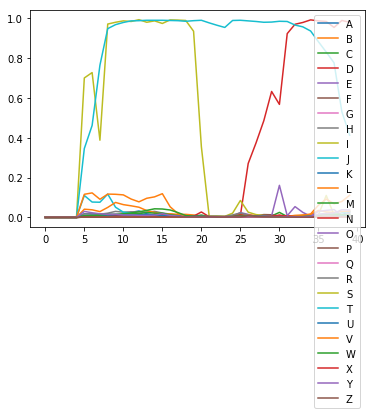

correct: 207 total: 215 accuracy: 0.963 avgEditDist 0.042
('A', 'A'): 85
('S', 'S'): 53
('E', 'E'): 94
('T', 'T'): 54
('H', 'H'): 33
('D', 'D'): 50
('K', 'K'): 13
('N', 'N'): 65
('L', 'L'): 47
('R', 'R'): 75
('O', 'O'): 72
('V', 'V'): 34
('B', 'B'): 20
('C', 'C'): 27
('G', 'G'): 25
('P', 'P'): 20
('I', 'I'): 36
('F', 'F'): 15
('W', 'W'): 11
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 10
-------('T', '%'): 1
-------('%', 'T'): 1
[[0.00178508 0.00083933 0.00140542 ... 0.0021349  0.03193538 0.00070286]
 [0.00245629 0.00145244 0.00137767 ... 0.00285075 0.0303617  0.00098113]
 [0.00298788 0.00176057 0.00161519 ... 0.00222273 0.03509154 0.00124772]
 ...
 [0.00130452 0.0016464  0.0024304  ... 0.002229   0.02118459 0.00192007]
 [0.00124705 0.00145883 0.00214218 ... 0.00207047 0.02216072 0.00174461]
 [0.00119297 0.001355   0.00197305 ... 0.00197422 0.02086902 0.00180703]]
--pred for 0 20 ['V 0.12 ', 'T 0.09 ', 'J 0.05 ', 'A 0.03 

KOA KOA
edit distance: 0
correct: 209 total: 217 accuracy: 0.963 avgEditDist 0.041
('A', 'A'): 86
('S', 'S'): 53
('E', 'E'): 94
('T', 'T'): 55
('H', 'H'): 33
('D', 'D'): 50
('K', 'K'): 14
('N', 'N'): 65
('L', 'L'): 47
('R', 'R'): 77
('O', 'O'): 73
('V', 'V'): 34
('B', 'B'): 20
('C', 'C'): 27
('G', 'G'): 26
('P', 'P'): 21
('I', 'I'): 37
('F', 'F'): 15
('W', 'W'): 11
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 10
-------('T', '%'): 1
-------('%', 'T'): 1
[[0.00192704 0.00145816 0.00139177 ... 0.00122274 0.03884973 0.00092997]
 [0.00208171 0.00150096 0.00140498 ... 0.00186113 0.03190864 0.00083502]
 [0.00256542 0.00169111 0.00131308 ... 0.00215112 0.03166197 0.00126414]
 ...
 [0.00112761 0.0007349  0.00124727 ... 0.00111357 0.02123649 0.00086167]
 [0.00135477 0.00080964 0.00135019 ... 0.00107262 0.02674061 0.00092489]
 [0.00144757 0.00086743 0.00140399 ... 0.00092921 0.06238323 0.00092833]]
--pred for 0 20 ['I 0.39 ', 'V 0.

AT AT
edit distance: 0
correct: 211 total: 219 accuracy: 0.963 avgEditDist 0.041
('A', 'A'): 87
('S', 'S'): 53
('E', 'E'): 94
('T', 'T'): 56
('H', 'H'): 33
('D', 'D'): 51
('K', 'K'): 14
('N', 'N'): 65
('L', 'L'): 47
('R', 'R'): 79
('O', 'O'): 73
('V', 'V'): 35
('B', 'B'): 20
('C', 'C'): 27
('G', 'G'): 26
('P', 'P'): 21
('I', 'I'): 38
('F', 'F'): 15
('W', 'W'): 11
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 10
-------('T', '%'): 1
-------('%', 'T'): 1
[[0.00151061 0.00076391 0.00136916 ... 0.00159745 0.03179703 0.00062161]
 [0.00173049 0.00103651 0.0018025  ... 0.00170001 0.03762927 0.00087276]
 [0.00200695 0.00128515 0.00234016 ... 0.00235517 0.04048832 0.00133225]
 ...
 [0.00317383 0.00183112 0.0026701  ... 0.00229052 0.02381542 0.00209331]
 [0.00295495 0.00180939 0.00249507 ... 0.0022711  0.02250369 0.00230482]
 [0.00246231 0.00164663 0.00225101 ... 0.00187508 0.02424691 0.00193203]]
--pred for 0 20 ['V 0.12 ', 'J 0.08

CELEAH CELEAH
edit distance: 0
correct: 213 total: 221 accuracy: 0.964 avgEditDist 0.041
('A', 'A'): 88
('S', 'S'): 53
('E', 'E'): 97
('T', 'T'): 56
('H', 'H'): 34
('D', 'D'): 51
('K', 'K'): 14
('N', 'N'): 65
('L', 'L'): 48
('R', 'R'): 79
('O', 'O'): 74
('V', 'V'): 37
('B', 'B'): 20
('C', 'C'): 28
('G', 'G'): 26
('P', 'P'): 21
('I', 'I'): 38
('F', 'F'): 15
('W', 'W'): 11
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 10
-------('T', '%'): 1
-------('%', 'T'): 1
[[0.00088126 0.00081197 0.00139966 ... 0.00099721 0.02353543 0.00042086]
 [0.00094568 0.00086565 0.00140208 ... 0.00113741 0.01964535 0.00043915]
 [0.00108419 0.00095604 0.00146306 ... 0.00130032 0.01793246 0.0004983 ]
 ...
 [0.00411534 0.00119787 0.00333812 ... 0.00288331 0.02679988 0.00137993]
 [0.00288114 0.00103523 0.00248997 ... 0.00217622 0.01955494 0.00119142]
 [0.00251501 0.00108604 0.00214927 ... 0.00187068 0.01814842 0.00094142]]
--pred for 0 20 ['M 0.49 ',

NE NE
edit distance: 0
correct: 215 total: 223 accuracy: 0.964 avgEditDist 0.040
('A', 'A'): 89
('S', 'S'): 54
('E', 'E'): 98
('T', 'T'): 56
('H', 'H'): 34
('D', 'D'): 51
('K', 'K'): 15
('N', 'N'): 67
('L', 'L'): 48
('R', 'R'): 79
('O', 'O'): 74
('V', 'V'): 37
('B', 'B'): 20
('C', 'C'): 28
('G', 'G'): 26
('P', 'P'): 21
('I', 'I'): 38
('F', 'F'): 15
('W', 'W'): 11
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 11
-------('T', '%'): 1
-------('%', 'T'): 1
[[0.00155345 0.00081718 0.00153177 ... 0.00136954 0.04234537 0.00070727]
 [0.00173507 0.00096424 0.0017583  ... 0.00148866 0.05198542 0.00100668]
 [0.00217173 0.00139561 0.00261651 ... 0.00287176 0.0479007  0.00186122]
 ...
 [0.00466439 0.0014212  0.00377451 ... 0.00371476 0.03900781 0.00154637]
 [0.0033543  0.00120113 0.00305568 ... 0.00278781 0.04101878 0.0011058 ]
 [0.00304902 0.0011963  0.00289549 ... 0.00244276 0.03967017 0.00102374]]
--pred for 0 20 ['J 0.10 ', 'V 0.08

OA OA
edit distance: 0
correct: 217 total: 225 accuracy: 0.964 avgEditDist 0.040
('A', 'A'): 90
('S', 'S'): 55
('E', 'E'): 98
('T', 'T'): 57
('H', 'H'): 34
('D', 'D'): 51
('K', 'K'): 15
('N', 'N'): 67
('L', 'L'): 48
('R', 'R'): 79
('O', 'O'): 76
('V', 'V'): 38
('B', 'B'): 20
('C', 'C'): 28
('G', 'G'): 26
('P', 'P'): 21
('I', 'I'): 38
('F', 'F'): 15
('W', 'W'): 11
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 11
-------('T', '%'): 1
-------('%', 'T'): 1
[[0.00151518 0.00103221 0.00168129 ... 0.00098116 0.02939872 0.00118324]
 [0.0015151  0.00104858 0.00190813 ... 0.00119551 0.03012402 0.00148447]
 [0.00165158 0.00113358 0.00205166 ... 0.0014532  0.02958207 0.00156596]
 ...
 [0.00183843 0.00089162 0.00161686 ... 0.0013951  0.02322537 0.00106207]
 [0.00217176 0.00104676 0.0017522  ... 0.00156359 0.02603707 0.00120642]
 [0.00187739 0.00099492 0.00159713 ... 0.00161291 0.02814277 0.00084166]]
--pred for 0 20 ['L 0.76 ', 'T 0.11

SLRNET SLRNET
edit distance: 0
correct: 219 total: 227 accuracy: 0.965 avgEditDist 0.040
('A', 'A'): 90
('S', 'S'): 56
('E', 'E'): 99
('T', 'T'): 59
('H', 'H'): 34
('D', 'D'): 51
('K', 'K'): 15
('N', 'N'): 69
('L', 'L'): 50
('R', 'R'): 80
('O', 'O'): 76
('V', 'V'): 38
('B', 'B'): 20
('C', 'C'): 28
('G', 'G'): 26
('P', 'P'): 21
('I', 'I'): 38
('F', 'F'): 15
('W', 'W'): 11
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 11
-------('T', '%'): 1
-------('%', 'T'): 1
[[0.00133886 0.00098265 0.00137954 ... 0.00153791 0.04047747 0.00064303]
 [0.00138225 0.00105518 0.00134557 ... 0.00224768 0.03767464 0.00069685]
 [0.00120443 0.00096703 0.00132261 ... 0.00228641 0.03498296 0.00068341]
 ...
 [0.00338954 0.00186649 0.00303764 ... 0.00208819 0.03159658 0.00180634]
 [0.00319381 0.00181722 0.00294799 ... 0.00206813 0.03025626 0.00197771]
 [0.0028292  0.00179879 0.00271717 ... 0.00185341 0.0306369  0.00214269]]
--pred for 0 20 ['J 0.26 ',

EVKS EVKS
edit distance: 0
correct: 221 total: 229 accuracy: 0.965 avgEditDist 0.039
('A', 'A'): 90
('S', 'S'): 58
('E', 'E'): 101
('T', 'T'): 59
('H', 'H'): 34
('D', 'D'): 51
('K', 'K'): 16
('N', 'N'): 69
('L', 'L'): 50
('R', 'R'): 80
('O', 'O'): 76
('V', 'V'): 39
('B', 'B'): 20
('C', 'C'): 28
('G', 'G'): 26
('P', 'P'): 22
('I', 'I'): 38
('F', 'F'): 16
('W', 'W'): 11
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 11
-------('T', '%'): 1
-------('%', 'T'): 1
[[0.00125173 0.00056484 0.00111678 ... 0.00122396 0.04163891 0.00071245]
 [0.00122087 0.00053782 0.00106118 ... 0.00127062 0.0325837  0.00084935]
 [0.00127687 0.00064252 0.0012983  ... 0.00174041 0.02528955 0.00089725]
 ...
 [0.00168325 0.00085493 0.00155631 ... 0.00141756 0.01807735 0.00106451]
 [0.00177861 0.00090736 0.00153282 ... 0.00131401 0.0284216  0.00110244]
 [0.00195576 0.00102501 0.00163455 ... 0.00160496 0.02480569 0.00096116]]
--pred for 0 20 ['V 0.40 ', 'T

AEREN AEREN
edit distance: 0
correct: 223 total: 231 accuracy: 0.965 avgEditDist 0.039
('A', 'A'): 91
('S', 'S'): 58
('E', 'E'): 103
('T', 'T'): 59
('H', 'H'): 34
('D', 'D'): 51
('K', 'K'): 16
('N', 'N'): 71
('L', 'L'): 50
('R', 'R'): 81
('O', 'O'): 77
('V', 'V'): 40
('B', 'B'): 20
('C', 'C'): 28
('G', 'G'): 26
('P', 'P'): 22
('I', 'I'): 38
('F', 'F'): 16
('W', 'W'): 11
-------('H', 'R'): 1
('U', 'U'): 8
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 11
-------('T', '%'): 1
-------('%', 'T'): 1
[[0.0012902  0.00062838 0.00123314 ... 0.00112175 0.04108645 0.00068498]
 [0.00137848 0.00060408 0.00111454 ... 0.00159555 0.04376951 0.0006921 ]
 [0.00151544 0.00062314 0.00121917 ... 0.00186235 0.04342262 0.00077366]
 ...
 [0.00132764 0.00273482 0.00411848 ... 0.00310022 0.03159204 0.00262954]
 [0.00128195 0.00171983 0.00250604 ... 0.0026757  0.02048673 0.00203405]
 [0.00122175 0.00158352 0.00236882 ... 0.00232117 0.02180887 0.00170837]]
--pred for 0 20 ['T 0.25 ', 

[[0.00287965 0.00204953 0.00290356 ... 0.00214073 0.04162602 0.00143256]
 [0.00334215 0.00231025 0.00329798 ... 0.00238457 0.03499923 0.00184472]
 [0.00351535 0.00228346 0.00337585 ... 0.00231095 0.03653415 0.00174249]
 ...
 [0.00316194 0.00228575 0.00339728 ... 0.00224962 0.02973324 0.00183107]
 [0.0028438  0.00174392 0.00254303 ... 0.00169626 0.02220359 0.00295669]
 [0.00283516 0.00178343 0.00266749 ... 0.00181276 0.02273126 0.00279896]]
--pred for 0 20 ['E 0.97 ', 'V 0.13 ', 'T 0.06 ', 'J 0.06 ', 'Y 0.04 ']
--pred for 0 24 ['E 0.99 ', 'V 0.12 ', 'T 0.07 ', 'J 0.05 ', 'L 0.04 ']
--pred for 0 28 ['E 0.99 ', 'V 0.12 ', 'T 0.08 ', 'L 0.04 ', 'A 0.04 ']
--pred for 0 32 ['E 0.99 ', 'V 0.14 ', 'T 0.10 ', 'A 0.04 ', 'L 0.04 ']
--pred for 0 36 ['E 0.99 ', 'V 0.15 ', 'T 0.10 ', 'A 0.04 ', 'L 0.03 ']
--pred for 0 40 ['E 0.99 ', 'V 0.12 ', 'T 0.09 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 44 ['E 0.99 ', 'I 0.98 ', 'V 0.22 ', 'L 0.06 ', 'T 0.05 ']
--pred for 0 48 ['E 0.99 ', 'I 0.98 ', 'V 0.23 ', 'L

[[0.00154464 0.00086206 0.00149075 ... 0.00156137 0.0352416  0.00078632]
 [0.00175494 0.00102719 0.00188273 ... 0.00214347 0.04085874 0.00102134]
 [0.00185383 0.00129623 0.00236475 ... 0.00242725 0.04530639 0.00127659]
 ...
 [0.00312714 0.00221691 0.00322653 ... 0.00197633 0.03790715 0.00154098]
 [0.00314842 0.00215506 0.00331767 ... 0.00214145 0.03644158 0.00158219]
 [0.0030282  0.002057   0.00327016 ... 0.00199705 0.0309068  0.00156776]]
--pred for 0 20 ['V 0.11 ', 'T 0.08 ', 'J 0.06 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 24 ['T 0.09 ', 'V 0.09 ', 'C 0.09 ', 'J 0.05 ', 'Y 0.04 ']
--pred for 0 28 ['C 0.74 ', 'T 0.11 ', 'V 0.10 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 32 ['C 0.99 ', 'T 0.11 ', 'V 0.09 ', 'L 0.06 ', 'Y 0.05 ']
--pred for 0 36 ['C 0.99 ', 'V 0.09 ', 'T 0.08 ', 'Y 0.06 ', 'L 0.06 ']
--pred for 0 40 ['O 0.99 ', 'V 0.14 ', 'T 0.10 ', 'Y 0.04 ', 'L 0.04 ']
--pred for 0 44 ['O 1.00 ', 'V 0.12 ', 'T 0.11 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 48 ['O 1.00 ', 'T 0.12 ', 'V 0.09 ', 'Y

WEB WEB
edit distance: 0
correct: 228 total: 236 accuracy: 0.966 avgEditDist 0.038
('A', 'A'): 94
('S', 'S'): 58
('E', 'E'): 108
('T', 'T'): 60
('H', 'H'): 34
('D', 'D'): 53
('K', 'K'): 16
('N', 'N'): 72
('L', 'L'): 51
('R', 'R'): 81
('O', 'O'): 78
('V', 'V'): 43
('B', 'B'): 21
('C', 'C'): 29
('G', 'G'): 26
('P', 'P'): 25
('I', 'I'): 38
('F', 'F'): 16
('W', 'W'): 13
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 11
-------('T', '%'): 1
-------('%', 'T'): 1
[[0.00157251 0.00082662 0.001409   ... 0.00183114 0.02961575 0.00074598]
 [0.00177561 0.00104746 0.0016986  ... 0.00227439 0.033031   0.00092025]
 [0.00190886 0.00121441 0.00212842 ... 0.00228178 0.03903699 0.00119432]
 ...
 [0.00167358 0.00110378 0.00184484 ... 0.00131477 0.01852026 0.00143442]
 [0.00164796 0.00108063 0.00185263 ... 0.00132919 0.01812884 0.00137126]
 [0.00165396 0.00106023 0.00187558 ... 0.00132138 0.01974597 0.00122394]]
--pred for 0 20 ['V 0.10 ', 'T 

[[0.00128087 0.00059221 0.00118223 ... 0.00121304 0.05024487 0.00067553]
 [0.0014869  0.00057189 0.00108862 ... 0.00165185 0.04845861 0.00075188]
 [0.00160936 0.00058611 0.0011064  ... 0.00191719 0.04251106 0.00084727]
 ...
 [0.00198993 0.00105963 0.00138526 ... 0.00112735 0.01739345 0.00117912]
 [0.00155857 0.00094807 0.00137372 ... 0.00094112 0.02136912 0.00095239]
 [0.00141405 0.00098854 0.0015302  ... 0.00135452 0.02197907 0.00071882]]
--pred for 0 20 ['V 0.21 ', 'T 0.14 ', 'Y 0.05 ', 'J 0.04 ', 'L 0.03 ']
--pred for 0 24 ['V 0.38 ', 'T 0.12 ', 'Y 0.05 ', 'A 0.03 ', 'J 0.03 ']
--pred for 0 28 ['V 0.56 ', 'T 0.09 ', 'Y 0.04 ', 'A 0.04 ', 'J 0.03 ']
--pred for 0 32 ['V 0.85 ', 'J 0.21 ', 'T 0.06 ', 'Y 0.03 ', 'L 0.02 ']
--pred for 0 36 ['V 0.96 ', 'J 0.09 ', 'T 0.05 ', 'L 0.02 ', 'A 0.02 ']
--pred for 0 40 ['V 0.98 ', 'T 0.04 ', 'J 0.04 ', 'L 0.03 ', 'A 0.02 ']
--pred for 0 44 ['V 0.99 ', 'T 0.05 ', 'L 0.04 ', 'J 0.03 ', 'A 0.02 ']
--pred for 0 48 ['V 0.99 ', 'L 0.05 ', 'T 0.04 ', 'A

[[0.0012228  0.00073335 0.00123377 ... 0.0018708  0.12283449 0.00040612]
 [0.00103233 0.00076191 0.00117015 ... 0.00179518 0.04369622 0.00047593]
 [0.00166554 0.00116043 0.00106716 ... 0.00150805 0.04187491 0.00056239]
 ...
 [0.00239464 0.00141527 0.00282138 ... 0.00321458 0.0426249  0.00286731]
 [0.00169416 0.0012391  0.0026189  ... 0.00234287 0.02289649 0.00313035]
 [0.00179961 0.00117674 0.00261418 ... 0.0024079  0.02719363 0.00247005]]
--pred for 0 20 ['J 0.27 ', 'V 0.20 ', 'F 0.16 ', 'Y 0.12 ', 'T 0.05 ']
--pred for 0 24 ['F 0.63 ', 'V 0.20 ', 'J 0.11 ', 'T 0.05 ', 'P 0.04 ']
--pred for 0 28 ['R 0.37 ', 'F 0.25 ', 'V 0.17 ', 'J 0.09 ', 'T 0.08 ']
--pred for 0 32 ['R 0.98 ', 'V 0.16 ', 'T 0.08 ', 'J 0.05 ', 'L 0.05 ']
--pred for 0 36 ['R 0.99 ', 'V 0.15 ', 'J 0.09 ', 'T 0.07 ', 'Y 0.05 ']
--pred for 0 40 ['R 0.99 ', 'V 0.15 ', 'T 0.07 ', 'L 0.06 ', 'J 0.05 ']
--pred for 0 44 ['R 0.98 ', 'I 0.97 ', 'V 0.17 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 48 ['I 0.99 ', 'R 0.99 ', 'V 0.17 ', 'L

VORLAN VORLAN
edit distance: 0
correct: 233 total: 241 accuracy: 0.967 avgEditDist 0.037
('A', 'A'): 96
('S', 'S'): 59
('E', 'E'): 110
('T', 'T'): 61
('H', 'H'): 34
('D', 'D'): 54
('K', 'K'): 17
('N', 'N'): 74
('L', 'L'): 56
('R', 'R'): 84
('O', 'O'): 81
('V', 'V'): 45
('B', 'B'): 21
('C', 'C'): 31
('G', 'G'): 26
('P', 'P'): 25
('I', 'I'): 38
('F', 'F'): 16
('W', 'W'): 14
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 11
-------('T', '%'): 1
-------('%', 'T'): 1
[[0.00254461 0.00198254 0.00275181 ... 0.00192112 0.04742257 0.00158802]
 [0.0030972  0.00217711 0.00322485 ... 0.00215862 0.03741794 0.00178018]
 [0.00320514 0.00222671 0.0033586  ... 0.00222058 0.03921998 0.0018852 ]
 ...
 [0.00142158 0.0020812  0.00255716 ... 0.0090124  0.04698293 0.00085921]
 [0.0014483  0.00151331 0.0018158  ... 0.02202151 0.05218523 0.00082984]
 [0.00137863 0.00121302 0.00117812 ... 0.003897   0.02283022 0.00067545]]
--pred for 0 20 ['E 0.93 

VEM VEM
edit distance: 0
correct: 235 total: 243 accuracy: 0.967 avgEditDist 0.037
('A', 'A'): 96
('S', 'S'): 59
('E', 'E'): 112
('T', 'T'): 61
('H', 'H'): 34
('D', 'D'): 55
('K', 'K'): 17
('N', 'N'): 76
('L', 'L'): 56
('R', 'R'): 85
('O', 'O'): 81
('V', 'V'): 46
('B', 'B'): 21
('C', 'C'): 31
('G', 'G'): 26
('P', 'P'): 25
('I', 'I'): 39
('F', 'F'): 16
('W', 'W'): 14
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 12
-------('T', '%'): 1
-------('%', 'T'): 1
[[0.00153597 0.00094937 0.00163559 ... 0.00097611 0.03132276 0.00092229]
 [0.00172017 0.00152842 0.00320507 ... 0.00171448 0.03850899 0.00213704]
 [0.00189162 0.00165526 0.00362741 ... 0.00216117 0.04251958 0.00250888]
 ...
 [0.00201702 0.0010871  0.00153612 ... 0.00126351 0.01455706 0.00120228]
 [0.00166688 0.00094323 0.00140421 ... 0.00104766 0.01542197 0.00085648]
 [0.00150971 0.00089257 0.00128637 ... 0.00104208 0.01601143 0.00070098]]
--pred for 0 20 ['T 0.25 ', 'V 

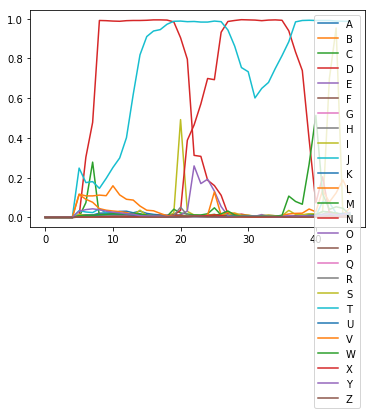

correct: 235 total: 244 accuracy: 0.963 avgEditDist 0.041
('A', 'A'): 96
('S', 'S'): 59
('E', 'E'): 112
('T', 'T'): 63
('H', 'H'): 34
('D', 'D'): 56
('K', 'K'): 17
('N', 'N'): 77
('L', 'L'): 56
('R', 'R'): 85
('O', 'O'): 81
('V', 'V'): 46
('B', 'B'): 21
('C', 'C'): 31
('G', 'G'): 26
('P', 'P'): 25
('I', 'I'): 39
('F', 'F'): 16
('W', 'W'): 14
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 12
-------('T', '%'): 2
-------('%', 'T'): 1
[[0.00108856 0.00077054 0.00110567 ... 0.00212314 0.04465023 0.00055853]
 [0.00108988 0.00080177 0.00110752 ... 0.0024776  0.0395839  0.0006228 ]
 [0.0010967  0.00088723 0.00115948 ... 0.00265462 0.03706807 0.00071401]
 ...
 [0.00188915 0.00139727 0.00302713 ... 0.00500199 0.03262855 0.00105629]
 [0.00146543 0.00133821 0.00254705 ... 0.0044928  0.02457786 0.00106581]
 [0.00149408 0.00128003 0.00239024 ... 0.00545942 0.02404613 0.00095961]]
--pred for 0 20 ['H 0.38 ', 'J 0.25 ', 'V 0.12 ', 'F 0.0

AERTC AERTC
edit distance: 0
correct: 237 total: 246 accuracy: 0.963 avgEditDist 0.041
('A', 'A'): 98
('S', 'S'): 59
('E', 'E'): 113
('T', 'T'): 65
('H', 'H'): 35
('D', 'D'): 56
('K', 'K'): 17
('N', 'N'): 77
('L', 'L'): 56
('R', 'R'): 87
('O', 'O'): 82
('V', 'V'): 46
('B', 'B'): 21
('C', 'C'): 32
('G', 'G'): 26
('P', 'P'): 25
('I', 'I'): 39
('F', 'F'): 16
('W', 'W'): 14
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 13
-------('T', '%'): 2
-------('%', 'T'): 1
[[0.00173551 0.00107219 0.00168292 ... 0.00101131 0.0214096  0.00075665]
 [0.00195127 0.00106718 0.00144183 ... 0.00150198 0.02244909 0.00080581]
 [0.00233536 0.00138945 0.00194868 ... 0.00164907 0.03075229 0.00101361]
 ...
 [0.00135884 0.00154647 0.00226238 ... 0.00214654 0.02583864 0.00151037]
 [0.00132807 0.00151141 0.00218684 ... 0.00209504 0.02717015 0.00172195]
 [0.00121385 0.00137027 0.00195508 ... 0.00217251 0.02501456 0.00178128]]
--pred for 0 20 ['A 0.52 ',

GI GI
edit distance: 0
correct: 239 total: 248 accuracy: 0.964 avgEditDist 0.040
('A', 'A'): 100
('S', 'S'): 59
('E', 'E'): 114
('T', 'T'): 65
('H', 'H'): 35
('D', 'D'): 56
('K', 'K'): 17
('N', 'N'): 77
('L', 'L'): 56
('R', 'R'): 87
('O', 'O'): 82
('V', 'V'): 46
('B', 'B'): 21
('C', 'C'): 32
('G', 'G'): 27
('P', 'P'): 26
('I', 'I'): 40
('F', 'F'): 16
('W', 'W'): 14
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 13
-------('T', '%'): 2
-------('%', 'T'): 1
[[1.66518590e-03 1.13414368e-03 1.31390151e-03 4.57241014e-03
  3.01972032e-03 2.02956400e-03 9.77780786e-04 2.10827645e-02
  2.40679234e-01 1.84194627e-03 2.09357608e-02 9.17323679e-03
  2.52930641e-01 3.24269617e-03 2.36040745e-02 8.31179228e-03
  3.98610020e-03 2.48096650e-03 6.94834441e-03 2.36532814e-03
  6.61919117e-02 2.59327260e-03 4.46539000e-02 9.51287523e-03
  1.38383672e-01 1.03316046e-02 2.03209603e-03 3.07946987e-02
  5.79867570e-04]
 [1.97106344e-03 1.21271

[[1.51722250e-03 1.31777651e-03 1.00341730e-03 9.81023908e-03
  5.10725379e-03 1.01912022e-03 1.14290020e-03 2.43484997e-03
  9.39282589e-03 2.30902596e-03 4.03890871e-02 9.98049498e-01
  5.25706448e-02 1.07129384e-03 8.59896839e-02 8.99564195e-03
  2.90890550e-03 1.67238864e-03 3.64398188e-03 2.42665317e-03
  1.54948840e-03 1.63275795e-03 1.33594766e-01 2.09560506e-02
  2.99257070e-01 9.68484022e-03 1.08890503e-03 4.27317955e-02
  8.04902753e-04]
 [1.72984495e-03 1.50101352e-03 1.19767652e-03 8.54270346e-03
  5.33972960e-03 1.20638055e-03 7.25895457e-04 3.51641253e-02
  6.40761256e-02 2.85815774e-03 8.85700360e-02 9.69586432e-01
  1.36873856e-01 2.08361330e-03 4.76454496e-02 1.22386925e-02
  2.23607244e-03 2.21960619e-03 4.02458385e-03 2.19463580e-03
  2.81702820e-03 4.23826510e-03 4.81379814e-02 1.25470245e-02
  3.01068932e-01 1.14667527e-02 1.36854453e-03 3.75863425e-02
  6.22432213e-04]
 [2.45739706e-03 3.20405304e-03 1.88209279e-03 1.66132730e-02
  6.12412719e-03 9.64858278e-04 1.

[[0.00129134 0.00089714 0.00126777 ... 0.00175055 0.04486819 0.00056147]
 [0.00196261 0.00120415 0.00125435 ... 0.00277597 0.02842942 0.00076771]
 [0.00270547 0.00162021 0.00136849 ... 0.00259022 0.02945456 0.00121984]
 ...
 [0.00327496 0.00187708 0.00298149 ... 0.00209156 0.02685692 0.00235632]
 [0.00325497 0.00183821 0.00294152 ... 0.00216501 0.03080262 0.00214554]
 [0.00318375 0.00187396 0.00300397 ... 0.00217593 0.02894092 0.0017827 ]]
--pred for 0 20 ['J 0.26 ', 'F 0.21 ', 'V 0.15 ', 'T 0.05 ', 'Y 0.05 ']
--pred for 0 24 ['F 0.54 ', 'R 0.50 ', 'J 0.18 ', 'V 0.14 ', 'T 0.03 ']
--pred for 0 28 ['R 0.90 ', 'J 0.15 ', 'V 0.14 ', 'F 0.12 ', 'L 0.04 ']
--pred for 0 32 ['R 0.98 ', 'V 0.14 ', 'T 0.06 ', 'J 0.06 ', 'L 0.05 ']
--pred for 0 36 ['R 0.99 ', 'V 0.17 ', 'T 0.07 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 40 ['R 0.99 ', 'V 0.17 ', 'L 0.06 ', 'T 0.06 ', 'Y 0.03 ']
--pred for 0 44 ['R 0.99 ', 'V 0.14 ', 'T 0.08 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 48 ['I 1.00 ', 'R 0.99 ', 'V 0.17 ', 'L

RDKVW RDKVW
edit distance: 0
correct: 245 total: 254 accuracy: 0.965 avgEditDist 0.039
('A', 'A'): 102
('S', 'S'): 60
('E', 'E'): 117
('T', 'T'): 65
('H', 'H'): 35
('D', 'D'): 58
('K', 'K'): 18
('N', 'N'): 78
('L', 'L'): 56
('R', 'R'): 90
('O', 'O'): 82
('V', 'V'): 47
('B', 'B'): 21
('C', 'C'): 32
('G', 'G'): 27
('P', 'P'): 26
('I', 'I'): 44
('F', 'F'): 16
('W', 'W'): 16
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 13
-------('T', '%'): 2
-------('%', 'T'): 1
[[1.88065122e-03 1.94002665e-03 1.62834721e-03 4.78073880e-02
  4.95442748e-03 2.38282327e-03 2.54833675e-03 4.10890672e-03
  8.66181217e-03 2.40448234e-03 2.90478356e-02 9.06129420e-01
  5.72089136e-01 1.85141340e-03 4.74269912e-02 1.21913077e-02
  7.51295546e-03 3.83232906e-03 2.29867711e-03 2.21594586e-03
  2.00092862e-03 1.91606709e-03 1.38518244e-01 8.77352152e-03
  4.32125516e-02 4.87043243e-03 2.03745929e-03 2.28216946e-02
  1.02969701e-03]
 [1.66891085e-03 1

VCMDON VCMDON
edit distance: 0
correct: 247 total: 256 accuracy: 0.965 avgEditDist 0.039
('A', 'A'): 103
('S', 'S'): 60
('E', 'E'): 117
('T', 'T'): 65
('H', 'H'): 35
('D', 'D'): 59
('K', 'K'): 18
('N', 'N'): 79
('L', 'L'): 56
('R', 'R'): 90
('O', 'O'): 83
('V', 'V'): 48
('B', 'B'): 21
('C', 'C'): 33
('G', 'G'): 27
('P', 'P'): 26
('I', 'I'): 45
('F', 'F'): 16
('W', 'W'): 16
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
[[0.00127308 0.00086568 0.00127221 ... 0.0026949  0.0388018  0.00055753]
 [0.00223757 0.00135072 0.00128465 ... 0.0027794  0.02589434 0.00091876]
 [0.00279755 0.00168881 0.00138626 ... 0.00256617 0.02589335 0.0013047 ]
 ...
 [0.00145779 0.00125248 0.0023593  ... 0.00496466 0.02442941 0.00111937]
 [0.00141195 0.00118845 0.00222618 ... 0.00475894 0.02169245 0.00095102]
 [0.00150978 0.00097134 0.00182639 ... 0.00677233 0.01989619 0.00078611]]
--pred for 0 20 ['F 0.90

SEW SEW
edit distance: 0
correct: 249 total: 258 accuracy: 0.965 avgEditDist 0.039
('A', 'A'): 103
('S', 'S'): 61
('E', 'E'): 118
('T', 'T'): 65
('H', 'H'): 35
('D', 'D'): 59
('K', 'K'): 19
('N', 'N'): 79
('L', 'L'): 56
('R', 'R'): 91
('O', 'O'): 84
('V', 'V'): 48
('B', 'B'): 21
('C', 'C'): 34
('G', 'G'): 28
('P', 'P'): 26
('I', 'I'): 46
('F', 'F'): 16
('W', 'W'): 17
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
[[1.57319149e-03 1.01838505e-03 1.73650763e-03 1.63520038e-01
  2.87260721e-03 1.68193015e-03 2.95714336e-03 1.34512992e-03
  4.42685233e-03 1.51228579e-03 1.41360639e-02 3.13082268e-03
  5.48912942e-01 1.22681889e-03 2.07897574e-02 1.81455538e-03
  1.32615550e-03 3.25779174e-03 3.23927496e-03 1.68105774e-03
  1.01433368e-03 2.03271979e-03 1.09367557e-01 7.76270311e-03
  3.70796137e-02 1.03391064e-02 1.09636446e-03 2.70187445e-02
  6.84440951e-04]
 [1.76398689e-03 1.008

KRLP KRLP
edit distance: 0
correct: 251 total: 260 accuracy: 0.965 avgEditDist 0.038
('A', 'A'): 104
('S', 'S'): 61
('E', 'E'): 118
('T', 'T'): 66
('H', 'H'): 35
('D', 'D'): 59
('K', 'K'): 20
('N', 'N'): 79
('L', 'L'): 57
('R', 'R'): 92
('O', 'O'): 84
('V', 'V'): 48
('B', 'B'): 21
('C', 'C'): 34
('G', 'G'): 28
('P', 'P'): 27
('I', 'I'): 46
('F', 'F'): 16
('W', 'W'): 17
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
[[1.44695537e-03 6.85444975e-04 1.30033493e-03 8.54717102e-03
  2.75514531e-03 1.94688831e-02 1.41491962e-03 1.24782417e-03
  3.84276873e-03 3.09585501e-03 1.06865959e-02 2.85475678e-03
  5.65243736e-02 2.43614498e-03 5.96682876e-02 2.94174673e-03
  2.17048475e-03 8.84823315e-03 2.06973124e-03 2.13227700e-03
  1.29026920e-03 1.28431967e-03 6.54901564e-02 5.19781560e-02
  1.05649322e-01 9.36752558e-03 1.49304129e-03 3.75398137e-02
  5.96615311e-04]
 [1.62847142e-03 8.6

OL OL
edit distance: 0
correct: 252 total: 261 accuracy: 0.966 avgEditDist 0.038
('A', 'A'): 104
('S', 'S'): 61
('E', 'E'): 118
('T', 'T'): 66
('H', 'H'): 35
('D', 'D'): 59
('K', 'K'): 20
('N', 'N'): 79
('L', 'L'): 58
('R', 'R'): 92
('O', 'O'): 85
('V', 'V'): 48
('B', 'B'): 21
('C', 'C'): 34
('G', 'G'): 28
('P', 'P'): 27
('I', 'I'): 46
('F', 'F'): 16
('W', 'W'): 17
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
[[0.00132614 0.00097992 0.0016845  ... 0.00110103 0.0383606  0.00061201]
 [0.00118909 0.0008947  0.0015696  ... 0.00123274 0.02664157 0.00060668]
 [0.00146765 0.00101342 0.00169975 ... 0.00144447 0.02556238 0.00074216]
 ...
 [0.00151808 0.00108175 0.00224009 ... 0.00329914 0.02460459 0.00072426]
 [0.00141883 0.00086854 0.00168115 ... 0.00362785 0.02313099 0.00077213]
 [0.00140002 0.00086945 0.00169629 ... 0.00293926 0.02104424 0.00066824]]
--pred for 0 20 ['J 0.12 ', 'V 0

SDKR SDKR
edit distance: 0
correct: 254 total: 263 accuracy: 0.966 avgEditDist 0.038
('A', 'A'): 104
('S', 'S'): 62
('E', 'E'): 118
('T', 'T'): 66
('H', 'H'): 35
('D', 'D'): 60
('K', 'K'): 21
('N', 'N'): 80
('L', 'L'): 59
('R', 'R'): 93
('O', 'O'): 86
('V', 'V'): 48
('B', 'B'): 21
('C', 'C'): 35
('G', 'G'): 28
('P', 'P'): 27
('I', 'I'): 46
('F', 'F'): 16
('W', 'W'): 17
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
[[2.65752967e-03 2.04363605e-03 2.91238306e-03 2.10216790e-02
  1.70750227e-02 1.09565770e-03 4.12653666e-03 9.58708048e-01
  7.79678673e-03 2.38045538e-03 1.25382300e-02 5.74707380e-03
  4.42255065e-02 2.46078544e-03 4.03138064e-02 4.76369960e-03
  1.93196023e-03 1.90514151e-03 3.04847676e-03 3.64249642e-03
  2.80589657e-03 2.44783307e-03 8.35790187e-02 7.62827182e-03
  1.17362529e-01 1.23038581e-02 1.77628500e-03 4.07444127e-02
  1.49142055e-03]
 [2.84303515e-03 2.0

EHHR EHHR
edit distance: 0
correct: 256 total: 265 accuracy: 0.966 avgEditDist 0.038
('A', 'A'): 104
('S', 'S'): 62
('E', 'E'): 120
('T', 'T'): 66
('H', 'H'): 37
('D', 'D'): 60
('K', 'K'): 21
('N', 'N'): 81
('L', 'L'): 59
('R', 'R'): 94
('O', 'O'): 86
('V', 'V'): 48
('B', 'B'): 21
('C', 'C'): 35
('G', 'G'): 28
('P', 'P'): 27
('I', 'I'): 46
('F', 'F'): 16
('W', 'W'): 17
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
[[0.00160682 0.00130682 0.0023723  ... 0.00129557 0.0348722  0.00266405]
 [0.00161804 0.00153479 0.00301057 ... 0.00161832 0.03087501 0.00358764]
 [0.00167835 0.00167678 0.00342748 ... 0.0018056  0.03475628 0.00341313]
 ...
 [0.00167078 0.00112743 0.00189508 ... 0.00135797 0.01892    0.00137477]
 [0.0016544  0.00110662 0.00187989 ... 0.00134578 0.0184672  0.00135792]
 [0.00165875 0.0010731  0.0018888  ... 0.00135841 0.02067913 0.00116912]]
--pred for 0 20 ['T 0.17 ', 

EP EP
edit distance: 0
correct: 258 total: 267 accuracy: 0.966 avgEditDist 0.037
('A', 'A'): 104
('S', 'S'): 63
('E', 'E'): 121
('T', 'T'): 66
('H', 'H'): 37
('D', 'D'): 61
('K', 'K'): 21
('N', 'N'): 81
('L', 'L'): 60
('R', 'R'): 96
('O', 'O'): 86
('V', 'V'): 49
('B', 'B'): 21
('C', 'C'): 35
('G', 'G'): 28
('P', 'P'): 28
('I', 'I'): 46
('F', 'F'): 16
('W', 'W'): 17
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
[[1.58039376e-03 1.03457121e-03 1.67030888e-03 9.13090482e-02
  3.12804524e-03 1.64687878e-03 2.47863797e-03 1.34636485e-03
  4.51375078e-03 1.51590910e-03 1.45811196e-02 3.65865743e-03
  5.97494721e-01 1.09861232e-03 1.88824479e-02 2.21636542e-03
  1.91866118e-03 3.46391369e-03 3.06995679e-03 1.67710125e-03
  1.34045887e-03 1.77958386e-03 1.28722340e-01 7.48403743e-03
  4.19811606e-02 1.13889826e-02 1.03408447e-03 2.48975363e-02
  7.09125132e-04]
 [1.83233595e-03 1.01275

ETA ETA
edit distance: 0
correct: 260 total: 269 accuracy: 0.967 avgEditDist 0.037
('A', 'A'): 106
('S', 'S'): 63
('E', 'E'): 122
('T', 'T'): 67
('H', 'H'): 37
('D', 'D'): 61
('K', 'K'): 21
('N', 'N'): 82
('L', 'L'): 60
('R', 'R'): 96
('O', 'O'): 86
('V', 'V'): 49
('B', 'B'): 21
('C', 'C'): 35
('G', 'G'): 28
('P', 'P'): 28
('I', 'I'): 46
('F', 'F'): 16
('W', 'W'): 17
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
[[0.0014329  0.00073198 0.00129427 ... 0.00171835 0.03432171 0.00068649]
 [0.00171725 0.00095328 0.00171621 ... 0.00220261 0.04367124 0.00092548]
 [0.00202421 0.00122884 0.00234306 ... 0.00261608 0.04942475 0.00135341]
 ...
 [0.0010816  0.00066901 0.00123145 ... 0.00127121 0.0189181  0.00082188]
 [0.00123446 0.00075408 0.0012428  ... 0.00127819 0.03859074 0.00070287]
 [0.00134081 0.00072243 0.00127845 ... 0.0011591  0.04590321 0.00069706]]
--pred for 0 20 ['V 0.13 ', 'T

AVLDN AVLDN
edit distance: 0
correct: 262 total: 271 accuracy: 0.967 avgEditDist 0.037
('A', 'A'): 107
('S', 'S'): 64
('E', 'E'): 123
('T', 'T'): 67
('H', 'H'): 37
('D', 'D'): 62
('K', 'K'): 21
('N', 'N'): 83
('L', 'L'): 61
('R', 'R'): 96
('O', 'O'): 86
('V', 'V'): 51
('B', 'B'): 21
('C', 'C'): 36
('G', 'G'): 28
('P', 'P'): 28
('I', 'I'): 47
('F', 'F'): 16
('W', 'W'): 17
-------('H', 'R'): 1
('U', 'U'): 10
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
[[0.00147568 0.0011446  0.00191275 ... 0.00111062 0.03694264 0.00192548]
 [0.00150736 0.00151243 0.00274383 ... 0.00160085 0.03594173 0.00373006]
 [0.00158469 0.00162374 0.00318846 ... 0.00178295 0.03547955 0.00342507]
 ...
 [0.00276709 0.00139276 0.00226107 ... 0.00162958 0.04444099 0.00103075]
 [0.00249384 0.00103434 0.00175548 ... 0.00203727 0.05130741 0.00092459]
 [0.00239592 0.00095091 0.00162873 ... 0.0021266  0.03297594 0.00084911]]
--pred for 0 20 ['T 0.19 '

AIUEA AIUEA
edit distance: 0
correct: 264 total: 273 accuracy: 0.967 avgEditDist 0.037
('A', 'A'): 110
('S', 'S'): 64
('E', 'E'): 125
('T', 'T'): 67
('H', 'H'): 37
('D', 'D'): 64
('K', 'K'): 21
('N', 'N'): 83
('L', 'L'): 61
('R', 'R'): 96
('O', 'O'): 86
('V', 'V'): 51
('B', 'B'): 21
('C', 'C'): 36
('G', 'G'): 28
('P', 'P'): 28
('I', 'I'): 48
('F', 'F'): 16
('W', 'W'): 17
-------('H', 'R'): 1
('U', 'U'): 11
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
[[1.66461989e-03 1.05953461e-03 1.70773081e-03 5.17548203e-01
  2.90322420e-03 1.75298494e-03 2.90974532e-03 1.26023474e-03
  4.08822112e-03 1.80077681e-03 1.13941384e-02 2.80181016e-03
  2.92622656e-01 1.15696108e-03 2.67428849e-02 1.46362977e-03
  1.05851202e-03 2.55455961e-03 2.64180219e-03 1.86174503e-03
  8.81638029e-04 1.81884586e-03 1.09653793e-01 7.88762514e-03
  3.39532308e-02 9.12105106e-03 1.06541021e-03 2.17666067e-02
  7.36447109e-04]
 [1.84107351e-03 1

HOEIRW HOEIRW
edit distance: 0
correct: 266 total: 275 accuracy: 0.967 avgEditDist 0.036
('A', 'A'): 111
('S', 'S'): 64
('E', 'E'): 126
('T', 'T'): 67
('H', 'H'): 38
('D', 'D'): 64
('K', 'K'): 21
('N', 'N'): 83
('L', 'L'): 61
('R', 'R'): 97
('O', 'O'): 87
('V', 'V'): 51
('B', 'B'): 21
('C', 'C'): 36
('G', 'G'): 28
('P', 'P'): 29
('I', 'I'): 49
('F', 'F'): 16
('W', 'W'): 18
-------('H', 'R'): 1
('U', 'U'): 11
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
[[1.22926710e-03 8.32169433e-04 1.32975436e-03 4.64844005e-03
  3.37237539e-03 2.28257501e-03 1.09545351e-03 4.52015968e-03
  4.02269512e-01 1.61388319e-03 1.95936114e-02 5.48157515e-03
  2.37504184e-01 2.57556140e-03 2.08398532e-02 5.67935174e-03
  2.75899307e-03 2.48919823e-03 1.13773169e-02 1.92907720e-03
  8.02056026e-03 5.15059941e-03 3.69384624e-02 6.43392513e-03
  1.43265501e-01 1.05810165e-02 1.92749407e-03 5.45701422e-02
  5.20858506e-04]
 [1.31507905e-03

GNEE GNEE
edit distance: 0
correct: 268 total: 277 accuracy: 0.968 avgEditDist 0.036
('A', 'A'): 112
('S', 'S'): 64
('E', 'E'): 128
('T', 'T'): 67
('H', 'H'): 38
('D', 'D'): 64
('K', 'K'): 21
('N', 'N'): 84
('L', 'L'): 61
('R', 'R'): 97
('O', 'O'): 87
('V', 'V'): 51
('B', 'B'): 21
('C', 'C'): 36
('G', 'G'): 29
('P', 'P'): 30
('I', 'I'): 49
('F', 'F'): 16
('W', 'W'): 18
-------('H', 'R'): 1
('U', 'U'): 11
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
[[0.00129557 0.00057773 0.00112583 ... 0.00128289 0.04911371 0.00073285]
 [0.0013601  0.0006859  0.00135248 ... 0.00161246 0.03301317 0.00089462]
 [0.0015855  0.00079825 0.0014105  ... 0.00107347 0.02318201 0.00114683]
 ...
 [0.00233304 0.00260374 0.00187373 ... 0.00136139 0.02928963 0.00175328]
 [0.00184285 0.00194204 0.00161837 ... 0.00112077 0.02677532 0.00122745]
 [0.00150721 0.0015294  0.00135915 ... 0.00111476 0.02987235 0.00109005]]
--pred for 0 20 ['V 0.47 ', 

DFHEDE DFHEDE
edit distance: 0
correct: 270 total: 279 accuracy: 0.968 avgEditDist 0.036
('A', 'A'): 112
('S', 'S'): 64
('E', 'E'): 131
('T', 'T'): 67
('H', 'H'): 39
('D', 'D'): 66
('K', 'K'): 21
('N', 'N'): 84
('L', 'L'): 62
('R', 'R'): 97
('O', 'O'): 87
('V', 'V'): 52
('B', 'B'): 21
('C', 'C'): 36
('G', 'G'): 29
('P', 'P'): 30
('I', 'I'): 50
('F', 'F'): 17
('W', 'W'): 18
-------('H', 'R'): 1
('U', 'U'): 11
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
[[0.00139631 0.00075504 0.00137048 ... 0.00154158 0.03635418 0.00067187]
 [0.00168308 0.00096611 0.00179342 ... 0.0019018  0.046383   0.0008753 ]
 [0.00191355 0.00116176 0.00233865 ... 0.00265249 0.04682883 0.00125184]
 ...
 [0.00166814 0.00105009 0.00215036 ... 0.00579393 0.02274964 0.00081093]
 [0.00158999 0.00095103 0.00186839 ... 0.00531876 0.0193008  0.0007889 ]
 [0.00161665 0.00093587 0.00177846 ... 0.00701037 0.01854738 0.0008318 ]]
--pred for 0 20 ['V 0.11

[[0.00131437 0.00093702 0.00142592 ... 0.00135985 0.03968863 0.00056279]
 [0.0011644  0.00082825 0.00122589 ... 0.00167578 0.04973615 0.00052561]
 [0.00112841 0.00092841 0.00127114 ... 0.00191389 0.03798728 0.00062879]
 ...
 [0.00155744 0.00117473 0.00143474 ... 0.00158497 0.02677429 0.00086736]
 [0.00150721 0.00109295 0.00140931 ... 0.00130664 0.03583422 0.00073904]
 [0.00158765 0.00105706 0.00133938 ... 0.00117126 0.03284151 0.00070494]]
--pred for 0 20 ['J 0.25 ', 'V 0.12 ', 'H 0.09 ', 'T 0.06 ', 'Y 0.04 ']
--pred for 0 24 ['H 0.49 ', 'J 0.19 ', 'V 0.11 ', 'Y 0.05 ', 'T 0.04 ']
--pred for 0 28 ['H 0.73 ', 'J 0.14 ', 'V 0.11 ', 'T 0.04 ', 'Y 0.04 ']
--pred for 0 32 ['H 0.84 ', 'V 0.12 ', 'J 0.11 ', 'T 0.05 ', 'Y 0.03 ']
--pred for 0 36 ['H 0.84 ', 'V 0.11 ', 'J 0.09 ', 'T 0.05 ', 'Y 0.03 ']
--pred for 0 40 ['H 0.98 ', 'V 0.16 ', 'T 0.06 ', 'J 0.03 ', 'Y 0.03 ']
--pred for 0 44 ['H 0.99 ', 'V 0.17 ', 'T 0.05 ', 'L 0.03 ', 'Y 0.03 ']
--pred for 0 48 ['H 0.99 ', 'V 0.16 ', 'T 0.05 ', 'L

[[1.54970144e-03 1.15585898e-03 1.82245439e-03 6.75130934e-02
  3.47376266e-03 2.23651505e-03 3.35383904e-03 1.26888021e-03
  4.40761447e-03 1.93557981e-03 1.50780017e-02 3.27283912e-03
  8.67174327e-01 1.29536993e-03 1.67190190e-02 2.30092253e-03
  1.60513585e-03 4.50973911e-03 4.05651797e-03 1.60654320e-03
  1.68945466e-03 2.26585241e-03 1.19787261e-01 8.22053198e-03
  4.40580361e-02 8.56692530e-03 1.63186423e-03 2.23657414e-02
  7.56244757e-04]
 [1.84738904e-03 1.03042030e-03 1.54239591e-03 6.82986677e-01
  3.57404631e-03 1.36388128e-03 2.32936419e-03 1.35257503e-03
  4.89805406e-03 1.93026080e-03 1.26927355e-02 2.82786274e-03
  2.13450894e-01 1.36627851e-03 4.54051942e-02 1.48462341e-03
  1.38135278e-03 2.03672145e-03 2.22989148e-03 1.95120275e-03
  8.55457911e-04 1.33859436e-03 1.01403825e-01 1.22014405e-02
  3.80642749e-02 7.72295427e-03 1.34499022e-03 2.27880944e-02
  7.19120668e-04]
 [1.85416488e-03 1.10348803e-03 1.59335602e-03 8.58536541e-01
  3.65663273e-03 1.37102185e-03 2.

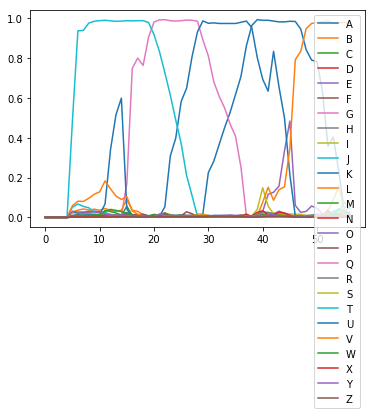

correct: 274 total: 284 accuracy: 0.965 avgEditDist 0.039
('A', 'A'): 115
('S', 'S'): 66
('E', 'E'): 132
('T', 'T'): 68
('H', 'H'): 41
('D', 'D'): 67
('K', 'K'): 22
('N', 'N'): 84
('L', 'L'): 62
('R', 'R'): 98
('O', 'O'): 89
('V', 'V'): 52
('B', 'B'): 21
('C', 'C'): 36
('G', 'G'): 32
('P', 'P'): 30
('I', 'I'): 51
('F', 'F'): 17
('W', 'W'): 19
-------('H', 'R'): 1
('U', 'U'): 11
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
-------('L', 'E'): 1
[[0.00190267 0.00118881 0.0019372  ... 0.00109741 0.02433712 0.00136476]
 [0.00163967 0.00150451 0.00293345 ... 0.00171716 0.02975916 0.0027347 ]
 [0.00172502 0.00165467 0.0034663  ... 0.00209006 0.03648147 0.00303294]
 ...
 [0.00113709 0.00073112 0.00127629 ... 0.00097073 0.01577755 0.00087232]
 [0.00139523 0.00087121 0.00144085 ... 0.00126477 0.01983013 0.00072725]
 [0.0016505  0.00100802 0.00143828 ... 0.0011369  0.0223681  0.00072768]]
--pred for 0 20 ['T 0.33 ', 'V 0.1

GHRR GHRR
edit distance: 0
correct: 276 total: 286 accuracy: 0.965 avgEditDist 0.038
('A', 'A'): 116
('S', 'S'): 66
('E', 'E'): 132
('T', 'T'): 68
('H', 'H'): 42
('D', 'D'): 68
('K', 'K'): 22
('N', 'N'): 85
('L', 'L'): 62
('R', 'R'): 100
('O', 'O'): 89
('V', 'V'): 53
('B', 'B'): 21
('C', 'C'): 36
('G', 'G'): 33
('P', 'P'): 30
('I', 'I'): 51
('F', 'F'): 17
('W', 'W'): 19
-------('H', 'R'): 1
('U', 'U'): 11
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
-------('L', 'E'): 1
[[0.00157466 0.00083369 0.00146071 ... 0.00167138 0.03576879 0.00082002]
 [0.0018186  0.00109144 0.00207951 ... 0.00194678 0.04889721 0.00102341]
 [0.00199977 0.00135947 0.0024184  ... 0.00243263 0.05043226 0.00139685]
 ...
 [0.00182698 0.0008912  0.00157149 ... 0.00149564 0.01894015 0.00097567]
 [0.00197224 0.00104124 0.00163941 ... 0.00151133 0.02915547 0.00097825]
 [0.00168359 0.00094333 0.00155029 ... 0.00169225 0.0299872  0.00069554]]
--pred

[[0.00144346 0.00105331 0.00139512 ... 0.00248783 0.04620381 0.00066475]
 [0.00146487 0.00117075 0.00142113 ... 0.00257982 0.04135133 0.00071907]
 [0.00156817 0.00122775 0.00146616 ... 0.00247839 0.03738804 0.0007568 ]
 ...
 [0.00166129 0.00081042 0.00152961 ... 0.00124024 0.02322853 0.00096243]
 [0.00207554 0.00105568 0.00175407 ... 0.00153268 0.02915663 0.00121975]
 [0.00176876 0.00097704 0.00158334 ... 0.00144392 0.02874542 0.00084591]]
--pred for 0 20 ['F 0.60 ', 'J 0.27 ', 'V 0.13 ', 'T 0.05 ', 'Y 0.05 ']
--pred for 0 24 ['F 0.71 ', 'J 0.19 ', 'V 0.16 ', 'R 0.08 ', 'P 0.07 ']
--pred for 0 28 ['F 0.69 ', 'J 0.16 ', 'V 0.15 ', 'R 0.11 ', 'P 0.08 ']
--pred for 0 32 ['P 0.62 ', 'F 0.30 ', 'V 0.16 ', 'J 0.10 ', 'T 0.05 ']
--pred for 0 36 ['P 0.98 ', 'V 0.14 ', 'T 0.07 ', 'J 0.04 ', 'Y 0.03 ']
--pred for 0 40 ['P 0.98 ', 'V 0.11 ', 'J 0.08 ', 'I 0.07 ', 'T 0.06 ']
--pred for 0 44 ['I 0.99 ', 'P 0.99 ', 'V 0.17 ', 'L 0.04 ', 'T 0.04 ']
--pred for 0 48 ['I 0.99 ', 'P 0.99 ', 'V 0.13 ', 'T

VDNROU VDNROU
edit distance: 0
correct: 279 total: 289 accuracy: 0.965 avgEditDist 0.038
('A', 'A'): 116
('S', 'S'): 66
('E', 'E'): 134
('T', 'T'): 68
('H', 'H'): 43
('D', 'D'): 70
('K', 'K'): 22
('N', 'N'): 88
('L', 'L'): 63
('R', 'R'): 102
('O', 'O'): 91
('V', 'V'): 54
('B', 'B'): 21
('C', 'C'): 37
('G', 'G'): 33
('P', 'P'): 31
('I', 'I'): 51
('F', 'F'): 17
('W', 'W'): 19
-------('H', 'R'): 1
('U', 'U'): 12
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
-------('L', 'E'): 1
[[0.0014392  0.00061725 0.00109815 ... 0.00101362 0.02981211 0.00082048]
 [0.00151198 0.00060286 0.00115206 ... 0.00124729 0.02472398 0.00101445]
 [0.00164124 0.00077512 0.00132592 ... 0.00142613 0.01773641 0.00113482]
 ...
 [0.00133161 0.00124545 0.00230977 ... 0.00336649 0.02505799 0.0011477 ]
 [0.00134354 0.00106384 0.00196386 ... 0.00346697 0.02016323 0.00086693]
 [0.00153571 0.0008771  0.00160494 ... 0.0033795  0.02269008 0.00061282]]
--

EC EC
edit distance: 0
correct: 281 total: 291 accuracy: 0.966 avgEditDist 0.038
('A', 'A'): 116
('S', 'S'): 66
('E', 'E'): 137
('T', 'T'): 68
('H', 'H'): 43
('D', 'D'): 71
('K', 'K'): 22
('N', 'N'): 88
('L', 'L'): 63
('R', 'R'): 102
('O', 'O'): 91
('V', 'V'): 54
('B', 'B'): 21
('C', 'C'): 38
('G', 'G'): 33
('P', 'P'): 31
('I', 'I'): 51
('F', 'F'): 17
('W', 'W'): 20
-------('H', 'R'): 1
('U', 'U'): 12
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
-------('L', 'E'): 1
[[0.00193838 0.0011218  0.0016763  ... 0.00109133 0.02510766 0.00084471]
 [0.00226039 0.00121935 0.00183657 ... 0.00148667 0.02735695 0.00107035]
 [0.00293627 0.00152278 0.00238065 ... 0.00117955 0.03802867 0.00137975]
 ...
 [0.0033311  0.00213737 0.00334704 ... 0.00228219 0.04243084 0.00169085]
 [0.00318403 0.00204646 0.00325461 ... 0.0023108  0.03596379 0.00174279]
 [0.00316815 0.00191791 0.00303173 ... 0.00208535 0.02970733 0.0018363 ]]
--pred for

OED OED
edit distance: 0
correct: 283 total: 293 accuracy: 0.966 avgEditDist 0.038
('A', 'A'): 117
('S', 'S'): 66
('E', 'E'): 139
('T', 'T'): 68
('H', 'H'): 43
('D', 'D'): 72
('K', 'K'): 22
('N', 'N'): 88
('L', 'L'): 63
('R', 'R'): 103
('O', 'O'): 92
('V', 'V'): 54
('B', 'B'): 21
('C', 'C'): 38
('G', 'G'): 33
('P', 'P'): 31
('I', 'I'): 52
('F', 'F'): 17
('W', 'W'): 20
-------('H', 'R'): 1
('U', 'U'): 12
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 14
-------('T', '%'): 2
-------('%', 'T'): 1
-------('L', 'E'): 1
[[0.00261299 0.00202628 0.00263027 ... 0.00176317 0.0447304  0.00155301]
 [0.00301597 0.00217143 0.00320178 ... 0.00208227 0.03566476 0.00164963]
 [0.00321451 0.00226631 0.00338373 ... 0.00224198 0.03200071 0.00194354]
 ...
 [0.00154686 0.00138718 0.00276067 ... 0.00360126 0.02931883 0.00099789]
 [0.00141328 0.00113359 0.00227459 ... 0.00403609 0.02409927 0.00087119]
 [0.00142074 0.00105786 0.00215064 ... 0.00390096 0.02114189 0.00077789]]
--pred f

[[0.0008734  0.00087155 0.00138411 ... 0.00107507 0.02075017 0.00040627]
 [0.00090619 0.00094918 0.00142787 ... 0.00121341 0.01938527 0.00043966]
 [0.00094215 0.00097616 0.0014625  ... 0.00121737 0.01715684 0.0004335 ]
 ...
 [0.00216235 0.00116285 0.0016456  ... 0.00136635 0.01418352 0.00127459]
 [0.00188159 0.00098505 0.00150052 ... 0.00116445 0.01475336 0.00099014]
 [0.00167799 0.00091412 0.00145053 ... 0.00106691 0.0139435  0.00087036]]
--pred for 0 20 ['M 0.66 ', 'V 0.11 ', 'T 0.08 ', 'J 0.08 ', 'L 0.03 ']
--pred for 0 24 ['M 0.73 ', 'V 0.13 ', 'J 0.10 ', 'T 0.07 ', 'L 0.02 ']
--pred for 0 28 ['M 0.76 ', 'V 0.13 ', 'J 0.11 ', 'T 0.06 ', 'L 0.03 ']
--pred for 0 32 ['M 0.86 ', 'J 0.17 ', 'V 0.14 ', 'T 0.06 ', 'L 0.03 ']
--pred for 0 36 ['M 0.91 ', 'J 0.20 ', 'V 0.14 ', 'T 0.06 ', 'L 0.03 ']
--pred for 0 40 ['M 0.94 ', 'V 0.20 ', 'J 0.07 ', 'T 0.06 ', 'L 0.03 ']
--pred for 0 44 ['M 0.95 ', 'V 0.16 ', 'T 0.06 ', 'J 0.05 ', 'L 0.03 ']
--pred for 0 48 ['M 0.99 ', 'V 0.12 ', 'T 0.06 ', 'L

[[0.00150197 0.00094064 0.00162293 ... 0.00100982 0.03072579 0.00123345]
 [0.00153153 0.00103963 0.0017902  ... 0.00113943 0.02939651 0.00150471]
 [0.00151375 0.00101667 0.00175946 ... 0.00127095 0.02821573 0.00150575]
 ...
 [0.00177967 0.00126151 0.00243627 ... 0.00295257 0.02568924 0.00145602]
 [0.00160619 0.00118232 0.00222073 ... 0.00242704 0.02002845 0.00132856]
 [0.00160309 0.00107483 0.00196592 ... 0.00233907 0.01898519 0.00112984]]
--pred for 0 20 ['L 0.85 ', 'V 0.13 ', 'T 0.12 ', 'Y 0.03 ', 'J 0.03 ']
--pred for 0 24 ['L 0.94 ', 'T 0.12 ', 'V 0.12 ', 'J 0.03 ', 'Y 0.03 ']
--pred for 0 28 ['L 0.97 ', 'V 0.15 ', 'T 0.13 ', 'Y 0.03 ', 'J 0.02 ']
--pred for 0 32 ['L 0.97 ', 'T 0.27 ', 'V 0.21 ', 'Y 0.02 ', 'A 0.01 ']
--pred for 0 36 ['L 0.98 ', 'T 0.25 ', 'V 0.20 ', 'Y 0.03 ', 'W 0.01 ']
--pred for 0 40 ['L 0.98 ', 'T 0.38 ', 'V 0.17 ', 'Y 0.02 ', 'W 0.01 ']
--pred for 0 44 ['L 0.98 ', 'T 0.76 ', 'V 0.13 ', 'Y 0.02 ', 'I 0.01 ']
--pred for 0 48 ['L 0.98 ', 'T 0.87 ', 'V 0.13 ', 'W

WROEW WROEW
edit distance: 0
correct: 288 total: 298 accuracy: 0.966 avgEditDist 0.037
('A', 'A'): 117
('S', 'S'): 66
('E', 'E'): 144
('T', 'T'): 70
('H', 'H'): 43
('D', 'D'): 72
('K', 'K'): 24
('N', 'N'): 88
('L', 'L'): 64
('R', 'R'): 107
('O', 'O'): 95
('V', 'V'): 54
('B', 'B'): 21
('C', 'C'): 39
('G', 'G'): 33
('P', 'P'): 31
('I', 'I'): 53
('F', 'F'): 17
('W', 'W'): 23
-------('H', 'R'): 1
('U', 'U'): 13
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 15
-------('T', '%'): 2
-------('%', 'T'): 1
-------('L', 'E'): 1
[[0.00170978 0.00100601 0.00159741 ... 0.00102643 0.02291449 0.00070974]
 [0.00191696 0.00102613 0.00147198 ... 0.00171108 0.02603208 0.00083039]
 [0.00230579 0.00120577 0.00185254 ... 0.00153362 0.03299835 0.0010113 ]
 ...
 [0.00171416 0.00085062 0.00156803 ... 0.0013527  0.01948649 0.00098012]
 [0.00176612 0.00090462 0.00148856 ... 0.00135768 0.03031066 0.00096138]
 [0.00179676 0.00095161 0.0016308  ... 0.00159823 0.02656589 0.00091604]]
--pr

SH SH
edit distance: 0
correct: 290 total: 300 accuracy: 0.967 avgEditDist 0.037
('A', 'A'): 118
('S', 'S'): 67
('E', 'E'): 144
('T', 'T'): 70
('H', 'H'): 44
('D', 'D'): 72
('K', 'K'): 24
('N', 'N'): 89
('L', 'L'): 64
('R', 'R'): 107
('O', 'O'): 95
('V', 'V'): 54
('B', 'B'): 21
('C', 'C'): 39
('G', 'G'): 33
('P', 'P'): 31
('I', 'I'): 53
('F', 'F'): 17
('W', 'W'): 23
-------('H', 'R'): 1
('U', 'U'): 13
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 2
-------('%', 'T'): 1
-------('L', 'E'): 1
[[0.00164047 0.00082573 0.00146733 ... 0.00171777 0.04388308 0.0007912 ]
 [0.00225622 0.00160835 0.0013697  ... 0.0021205  0.03859702 0.00113977]
 [0.00206036 0.00173088 0.00127779 ... 0.00173333 0.04751211 0.00114769]
 ...
 [0.00143493 0.00116692 0.00242339 ... 0.003135   0.02606996 0.00104779]
 [0.00146162 0.00090471 0.00187637 ... 0.00341453 0.02484114 0.00068383]
 [0.00155454 0.00089976 0.00183286 ... 0.0040333  0.02914404 0.00067464]]
--pred for

--pred for 84 156 ['U 0.92 ', 'T 0.90 ', 'A 0.02 ', 'K 0.01 ', 'E 0.01 ']
--pred for 88 160 ['U 0.98 ', 'T 0.76 ', 'E 0.02 ', 'N 0.01 ', 'H 0.00 ']
--pred for 92 164 ['U 0.99 ', 'T 0.70 ', 'A 0.01 ', 'D 0.01 ', 'H 0.01 ']
--pred for 96 167 ['U 1.00 ', 'T 0.60 ', 'L 0.01 ', 'N 0.01 ', 'A 0.01 ']
--pred for 100 167 ['U 1.00 ', 'T 0.58 ', 'L 0.02 ', 'N 0.01 ', 'V 0.01 ']
--pred for 104 167 ['U 1.00 ', 'T 0.42 ', 'Y 0.02 ', 'V 0.02 ', 'L 0.02 ']
--pred for 108 167 ['U 1.00 ', 'T 0.28 ', 'V 0.05 ', 'Y 0.05 ', 'L 0.02 ']
--pred for 112 167 ['U 1.00 ', 'T 0.19 ', 'V 0.06 ', 'Y 0.06 ', 'L 0.02 ']
--pred for 116 167 ['U 1.00 ', 'T 0.17 ', 'V 0.09 ', 'Y 0.05 ', 'H 0.02 ']
--pred for 120 167 ['U 1.00 ', 'T 0.09 ', 'V 0.09 ', 'H 0.02 ', 'Y 0.02 ']
--pred for 124 167 ['U 0.99 ', 'V 0.09 ', 'T 0.08 ', 'Y 0.03 ', 'H 0.03 ']
--pred for 128 167 ['U 0.89 ', 'J 0.62 ', 'V 0.08 ', 'T 0.07 ', 'H 0.03 ']
--pred for 132 167 ['J 0.98 ', 'T 0.10 ', 'V 0.08 ', 'L 0.06 ', 'U 0.03 ']
--pred for 136 167 ['J 0.95 '

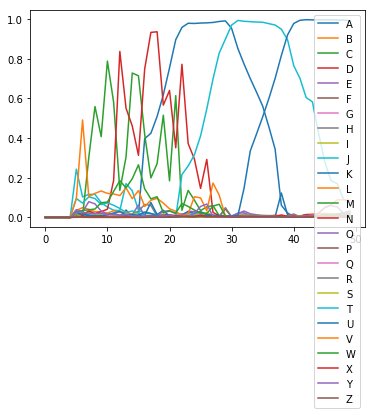

correct: 291 total: 302 accuracy: 0.964 avgEditDist 0.040
('A', 'A'): 120
('S', 'S'): 67
('E', 'E'): 144
('T', 'T'): 71
('H', 'H'): 44
('D', 'D'): 73
('K', 'K'): 24
('N', 'N'): 89
('L', 'L'): 64
('R', 'R'): 107
('O', 'O'): 96
('V', 'V'): 54
('B', 'B'): 21
('C', 'C'): 39
('G', 'G'): 35
('P', 'P'): 31
('I', 'I'): 53
('F', 'F'): 17
('W', 'W'): 23
-------('H', 'R'): 1
('U', 'U'): 14
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 2
-------('%', 'T'): 1
-------('L', 'E'): 1
-------('%', 'W'): 1
[[2.47407472e-03 1.89969200e-03 2.45966110e-03 1.50951343e-02
  1.01333437e-02 1.09717157e-03 2.72803335e-03 8.86188745e-01
  8.94600432e-03 2.30893376e-03 1.40403993e-02 5.66843525e-03
  8.77824277e-02 1.95971876e-03 2.66946480e-02 4.60173748e-03
  1.28329988e-03 2.08461680e-03 3.80345713e-03 3.16470466e-03
  3.91383655e-03 3.61431809e-03 6.58752248e-02 4.55018133e-03
  1.44262016e-01 1.28287906e-02 1.70369935e-03 4.68546897e-02
  1.30213879e-03]
 [3.

[[0.0016961  0.00117736 0.00120713 ... 0.00105703 0.03775755 0.00094472]
 [0.00159757 0.00111603 0.00120686 ... 0.00105734 0.02971268 0.00089716]
 [0.00154421 0.00108143 0.00128902 ... 0.00094577 0.02208295 0.00088881]
 ...
 [0.00201318 0.00113328 0.00164798 ... 0.00118598 0.01564752 0.00073341]
 [0.00166927 0.00088095 0.00143258 ... 0.00094731 0.02045774 0.00062321]
 [0.00148467 0.00078754 0.00140609 ... 0.00098379 0.02306494 0.00056397]]
--pred for 0 20 ['I 0.75 ', 'T 0.28 ', 'V 0.14 ', 'J 0.08 ', 'L 0.05 ']
--pred for 0 24 ['I 0.65 ', 'T 0.33 ', 'V 0.14 ', 'J 0.06 ', 'L 0.04 ']
--pred for 0 28 ['T 0.62 ', 'I 0.31 ', 'V 0.11 ', 'J 0.06 ', 'L 0.02 ']
--pred for 0 32 ['T 0.80 ', 'I 0.58 ', 'V 0.13 ', 'J 0.04 ', 'L 0.03 ']
--pred for 0 36 ['I 0.96 ', 'T 0.96 ', 'V 0.16 ', 'L 0.07 ', 'J 0.04 ']
--pred for 0 40 ['I 0.96 ', 'T 0.96 ', 'V 0.14 ', 'L 0.05 ', 'H 0.03 ']
--pred for 0 44 ['T 0.98 ', 'I 0.97 ', 'V 0.10 ', 'L 0.05 ', 'H 0.03 ']
--pred for 0 48 ['I 0.99 ', 'T 0.99 ', 'V 0.08 ', 'L

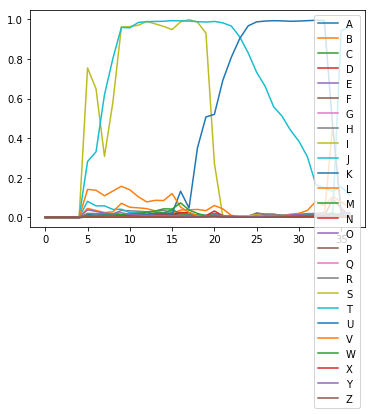

correct: 293 total: 305 accuracy: 0.961 avgEditDist 0.046
('A', 'A'): 120
('S', 'S'): 68
('E', 'E'): 146
('T', 'T'): 71
('H', 'H'): 44
('D', 'D'): 73
('K', 'K'): 24
('N', 'N'): 89
('L', 'L'): 65
('R', 'R'): 108
('O', 'O'): 96
('V', 'V'): 54
('B', 'B'): 21
('C', 'C'): 39
('G', 'G'): 35
('P', 'P'): 31
('I', 'I'): 54
('F', 'F'): 17
('W', 'W'): 23
-------('H', 'R'): 1
('U', 'U'): 15
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
[[0.00150901 0.00110065 0.00191168 ... 0.00098087 0.03661536 0.00170504]
 [0.0014796  0.00142149 0.00265921 ... 0.00130978 0.04202832 0.00246697]
 [0.0017749  0.00173026 0.00364962 ... 0.00201161 0.04763345 0.00287915]
 ...
 [0.00173997 0.00077716 0.00146018 ... 0.00145244 0.02170739 0.00082193]
 [0.00160835 0.00082683 0.00148425 ... 0.00136916 0.01980153 0.00092237]
 [0.00178594 0.00096822 0.00160074 ... 0.00141967 0.02256111 0.00103843]]
--pred for 0

OVISV OVISV
edit distance: 0
correct: 295 total: 307 accuracy: 0.961 avgEditDist 0.046
('A', 'A'): 120
('S', 'S'): 69
('E', 'E'): 146
('T', 'T'): 71
('H', 'H'): 44
('D', 'D'): 74
('K', 'K'): 24
('N', 'N'): 90
('L', 'L'): 65
('R', 'R'): 108
('O', 'O'): 97
('V', 'V'): 57
('B', 'B'): 21
('C', 'C'): 39
('G', 'G'): 36
('P', 'P'): 31
('I', 'I'): 55
('F', 'F'): 17
('W', 'W'): 23
-------('H', 'R'): 1
('U', 'U'): 15
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
[[0.00165939 0.00101431 0.00164535 ... 0.00109837 0.02467592 0.0006745 ]
 [0.00190561 0.00100786 0.00147755 ... 0.00121389 0.025184   0.00076301]
 [0.00194584 0.00105365 0.00169147 ... 0.00141678 0.02968778 0.00084603]
 ...
 [0.0030229  0.00215165 0.00146263 ... 0.00253595 0.02422794 0.00271461]
 [0.0028648  0.00197733 0.00141696 ... 0.00254154 0.02478192 0.00263467]
 [0.00257336 0.0018755  0.00140539 ... 0.00233635 0.02551

ESHEH ESHEH
edit distance: 0
correct: 297 total: 309 accuracy: 0.961 avgEditDist 0.045
('A', 'A'): 121
('S', 'S'): 70
('E', 'E'): 148
('T', 'T'): 72
('H', 'H'): 46
('D', 'D'): 74
('K', 'K'): 24
('N', 'N'): 90
('L', 'L'): 65
('R', 'R'): 109
('O', 'O'): 97
('V', 'V'): 57
('B', 'B'): 21
('C', 'C'): 39
('G', 'G'): 36
('P', 'P'): 31
('I', 'I'): 56
('F', 'F'): 17
('W', 'W'): 23
-------('H', 'R'): 1
('U', 'U'): 15
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
[[1.45966152e-03 9.46754997e-04 1.52740220e-03 1.10503221e-02
  5.63571416e-03 1.05411641e-03 2.88977055e-03 2.42501451e-03
  3.46385618e-03 1.39740668e-03 9.93878301e-03 3.99495214e-02
  2.29080897e-02 1.27457932e-03 3.80463690e-01 5.49847353e-03
  1.68850680e-03 1.78069889e-03 2.19996762e-03 2.61064549e-03
  1.97041617e-03 1.48262293e-03 1.27828971e-01 4.57695033e-03
  1.26308262e-01 9.29782074e-03 7.89133599e-04 2.870518

[[1.21990952e-03 9.83423670e-04 1.63350895e-03 6.22111838e-03
  2.15896941e-03 2.31211493e-03 1.97113072e-03 1.40243827e-03
  6.89757382e-03 1.41230877e-03 1.26569569e-02 2.04636753e-02
  1.29611179e-01 1.15705596e-03 2.73851994e-02 1.15581200e-01
  8.54915008e-02 4.32636403e-03 3.30859004e-03 2.03273539e-03
  1.07331143e-03 1.03083753e-03 7.92246014e-02 7.69182760e-03
  9.40806717e-02 9.72299278e-03 9.93436784e-04 3.10032852e-02
  5.41344576e-04]
 [1.17916672e-03 9.74415627e-04 1.74067880e-03 5.09001222e-03
  2.27179448e-03 1.98448985e-03 5.76958805e-03 1.16518582e-03
  7.05616036e-03 1.67165801e-03 9.94558912e-03 1.24329496e-02
  7.55270049e-02 1.29399018e-03 2.31798869e-02 1.08977892e-01
  4.15961027e-01 4.54684999e-03 3.45362350e-03 2.22527911e-03
  8.71343189e-04 9.52420814e-04 5.44839390e-02 5.72535582e-03
  1.18364148e-01 1.31626809e-02 1.31299079e-03 2.84520574e-02
  6.66569511e-04]
 [1.23170321e-03 9.92744230e-04 1.70493266e-03 8.67714640e-03
  2.73406296e-03 1.93153811e-03 7.

[[0.00303204 0.00216642 0.00280225 ... 0.00218245 0.05879582 0.00148626]
 [0.00349032 0.00232994 0.00311443 ... 0.00250145 0.04422786 0.00179644]
 [0.00365518 0.00228769 0.00320859 ... 0.00229148 0.04249964 0.00174256]
 ...
 [0.00256292 0.00124197 0.00201599 ... 0.00197156 0.03971427 0.00099458]
 [0.0022867  0.00094617 0.00158782 ... 0.00353538 0.04071582 0.00090426]
 [0.00189621 0.00084195 0.00145424 ... 0.00206971 0.02385919 0.00073952]]
--pred for 0 20 ['E 0.95 ', 'V 0.16 ', 'J 0.06 ', 'Y 0.06 ', 'T 0.05 ']
--pred for 0 24 ['E 0.99 ', 'V 0.15 ', 'T 0.07 ', 'J 0.05 ', 'Y 0.04 ']
--pred for 0 28 ['E 0.99 ', 'V 0.14 ', 'T 0.08 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 32 ['E 0.99 ', 'V 0.15 ', 'T 0.09 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 36 ['E 0.99 ', 'V 0.17 ', 'T 0.09 ', 'L 0.04 ', 'Y 0.04 ']
--pred for 0 40 ['E 0.99 ', 'V 0.23 ', 'T 0.06 ', 'L 0.05 ', 'U 0.04 ']
--pred for 0 44 ['E 0.99 ', 'U 0.23 ', 'V 0.20 ', 'W 0.04 ', 'T 0.04 ']
--pred for 0 48 ['E 0.99 ', 'U 0.54 ', 'V 0.13 ', 'W

[[3.10840388e-03 1.09987787e-03 2.75315950e-03 3.72758508e-02
  3.31708859e-03 1.98935741e-03 3.52891558e-03 6.19909726e-03
  4.52549011e-03 2.10382533e-03 2.17507426e-02 2.92012701e-03
  4.80106324e-02 3.56494519e-03 4.70396616e-02 5.04622562e-03
  6.84204279e-04 2.69393320e-03 2.28270097e-03 2.42971396e-03
  9.00738465e-04 8.16139162e-01 7.81426355e-02 8.12519249e-03
  1.41608760e-01 1.11656729e-02 2.42841290e-03 5.86425476e-02
  1.06716552e-03]
 [4.01215069e-03 1.31251640e-03 3.42150079e-03 4.99769710e-02
  4.28234227e-03 2.61678733e-03 4.22852067e-03 6.71791844e-03
  7.08310911e-03 2.84892716e-03 2.32674200e-02 3.99017613e-03
  5.22803329e-02 3.05915158e-03 5.14191836e-02 6.77625649e-03
  1.26425514e-03 3.02114338e-03 3.09101702e-03 2.50629382e-03
  1.89453992e-03 9.52601433e-01 7.84172863e-02 1.00185489e-02
  1.23601772e-01 1.46882357e-02 3.06108780e-03 3.91726047e-02
  1.41980872e-03]
 [4.43078997e-03 1.30131247e-03 3.44594987e-03 3.70162539e-02
  4.95836418e-03 2.48662313e-03 4.

EL EL
edit distance: 0
correct: 306 total: 318 accuracy: 0.962 avgEditDist 0.044
('A', 'A'): 125
('S', 'S'): 73
('E', 'E'): 150
('T', 'T'): 72
('H', 'H'): 46
('D', 'D'): 76
('K', 'K'): 24
('N', 'N'): 91
('L', 'L'): 68
('R', 'R'): 110
('O', 'O'): 100
('V', 'V'): 57
('B', 'B'): 21
('C', 'C'): 41
('G', 'G'): 36
('P', 'P'): 32
('I', 'I'): 56
('F', 'F'): 18
('W', 'W'): 24
-------('H', 'R'): 1
('U', 'U'): 15
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
[[0.00153213 0.00108889 0.0017498  ... 0.00104742 0.03708432 0.00064477]
 [0.00119694 0.00095363 0.00173249 ... 0.00115255 0.03142544 0.00060265]
 [0.0011976  0.0009469  0.00169124 ... 0.00117583 0.02410324 0.0005796 ]
 ...
 [0.00116729 0.00071191 0.00131573 ... 0.00120812 0.02819176 0.0007478 ]
 [0.0013192  0.00078074 0.00124617 ... 0.00135237 0.03361681 0.00071894]
 [0.00146156 0.00080581 0.00143831 ... 0.00112709 0.04615274 0

OAVIV OAVIV
edit distance: 0
correct: 308 total: 320 accuracy: 0.963 avgEditDist 0.044
('A', 'A'): 126
('S', 'S'): 73
('E', 'E'): 151
('T', 'T'): 72
('H', 'H'): 48
('D', 'D'): 76
('K', 'K'): 24
('N', 'N'): 92
('L', 'L'): 68
('R', 'R'): 110
('O', 'O'): 101
('V', 'V'): 60
('B', 'B'): 21
('C', 'C'): 41
('G', 'G'): 36
('P', 'P'): 32
('I', 'I'): 57
('F', 'F'): 18
('W', 'W'): 24
-------('H', 'R'): 1
('U', 'U'): 15
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
[[0.002679   0.00204285 0.0028395  ... 0.00204287 0.03950693 0.00143155]
 [0.0029935  0.00215799 0.00306703 ... 0.00212707 0.03483101 0.00152579]
 [0.00327016 0.00216054 0.00317317 ... 0.00222199 0.03436091 0.00159759]
 ...
 [0.00170184 0.00108006 0.00182031 ... 0.00148488 0.02048962 0.00105607]
 [0.00160112 0.00110947 0.00180358 ... 0.0015168  0.02258036 0.0008475 ]
 [0.00154576 0.00098611 0.00173361 ... 0.00132867 0.0233

HHL HHL
edit distance: 0
correct: 310 total: 322 accuracy: 0.963 avgEditDist 0.043
('A', 'A'): 126
('S', 'S'): 73
('E', 'E'): 152
('T', 'T'): 72
('H', 'H'): 50
('D', 'D'): 76
('K', 'K'): 24
('N', 'N'): 93
('L', 'L'): 71
('R', 'R'): 110
('O', 'O'): 101
('V', 'V'): 60
('B', 'B'): 21
('C', 'C'): 41
('G', 'G'): 36
('P', 'P'): 32
('I', 'I'): 57
('F', 'F'): 18
('W', 'W'): 25
-------('H', 'R'): 1
('U', 'U'): 15
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
[[0.00169328 0.00106446 0.00160089 ... 0.00124814 0.0228413  0.00064077]
 [0.00180587 0.00135531 0.00186569 ... 0.00143899 0.02206261 0.00085082]
 [0.00241851 0.00143284 0.00212457 ... 0.00114887 0.02985549 0.0008114 ]
 ...
 [0.00280192 0.0019228  0.00248266 ... 0.00253716 0.02326044 0.00253638]
 [0.00244989 0.00172553 0.00228833 ... 0.00230518 0.01978679 0.00194368]
 [0.001946   0.00117863 0.00192553 ... 0.00197149 0.02221884

ASIO ASIO
edit distance: 0
correct: 312 total: 324 accuracy: 0.963 avgEditDist 0.043
('A', 'A'): 128
('S', 'S'): 74
('E', 'E'): 155
('T', 'T'): 72
('H', 'H'): 50
('D', 'D'): 76
('K', 'K'): 24
('N', 'N'): 93
('L', 'L'): 71
('R', 'R'): 110
('O', 'O'): 103
('V', 'V'): 60
('B', 'B'): 21
('C', 'C'): 41
('G', 'G'): 36
('P', 'P'): 32
('I', 'I'): 58
('F', 'F'): 18
('W', 'W'): 25
-------('H', 'R'): 1
('U', 'U'): 15
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
[[0.00294761 0.00214677 0.00289979 ... 0.00220447 0.04128483 0.00130739]
 [0.00326674 0.00226479 0.00320189 ... 0.00234943 0.03611948 0.00153562]
 [0.003577   0.00229577 0.0033644  ... 0.00224636 0.0361576  0.00164054]
 ...
 [0.0027656  0.00178872 0.00239834 ... 0.0022559  0.02370265 0.00270691]
 [0.00245293 0.00167287 0.00225371 ... 0.00193508 0.02424275 0.00253397]
 [0.00195129 0.00134273 0.0020567  ... 0.0018242  0.025282

[[0.00140603 0.00109112 0.00148094 ... 0.00139164 0.04437881 0.00058717]
 [0.00127471 0.00097173 0.00129237 ... 0.00224539 0.04011831 0.00058592]
 [0.00124738 0.000858   0.00121991 ... 0.00237967 0.03715774 0.00055706]
 ...
 [0.00232287 0.00121264 0.00154074 ... 0.0014625  0.0207108  0.00143673]
 [0.00222952 0.00117273 0.00169867 ... 0.00152744 0.01936954 0.00141636]
 [0.00217886 0.00117054 0.00166248 ... 0.00145244 0.01706876 0.00128477]]
--pred for 0 20 ['J 0.22 ', 'V 0.14 ', 'T 0.11 ', 'F 0.07 ', 'Y 0.04 ']
--pred for 0 24 ['F 0.82 ', 'J 0.16 ', 'V 0.16 ', 'T 0.05 ', 'Y 0.04 ']
--pred for 0 28 ['F 0.95 ', 'V 0.16 ', 'J 0.12 ', 'T 0.05 ', 'Y 0.04 ']
--pred for 0 32 ['F 0.82 ', 'V 0.15 ', 'J 0.09 ', 'R 0.06 ', 'T 0.04 ']
--pred for 0 36 ['R 0.67 ', 'F 0.20 ', 'V 0.17 ', 'J 0.05 ', 'T 0.04 ']
--pred for 0 40 ['R 0.99 ', 'V 0.17 ', 'T 0.07 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 44 ['R 0.99 ', 'V 0.17 ', 'T 0.06 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 48 ['R 0.99 ', 'V 0.13 ', 'L 0.06 ', 'T

[[0.00173084 0.00119046 0.00190639 ... 0.00124916 0.02512094 0.00080511]
 [0.00212471 0.00105557 0.00165566 ... 0.00112527 0.03239338 0.00082875]
 [0.00241237 0.00122363 0.00177656 ... 0.00174633 0.03807622 0.00087741]
 ...
 [0.00102561 0.00066733 0.00121321 ... 0.00084063 0.02123832 0.0009261 ]
 [0.0011893  0.00072291 0.00124259 ... 0.0010883  0.04217675 0.00072732]
 [0.00136823 0.00071597 0.00131407 ... 0.00089362 0.13417912 0.00073342]]
--pred for 0 20 ['J 0.83 ', 'T 0.08 ', 'V 0.05 ', 'Y 0.03 ', 'L 0.02 ']
--pred for 0 24 ['J 0.19 ', 'N 0.17 ', 'T 0.07 ', 'L 0.07 ', 'V 0.06 ']
--pred for 0 28 ['J 0.24 ', 'A 0.21 ', 'N 0.09 ', 'V 0.06 ', 'T 0.04 ']
--pred for 0 32 ['A 0.87 ', 'J 0.07 ', 'V 0.06 ', 'T 0.05 ', 'Y 0.04 ']
--pred for 0 36 ['A 0.94 ', 'V 0.07 ', 'J 0.05 ', 'T 0.05 ', 'Y 0.05 ']
--pred for 0 40 ['A 0.95 ', 'V 0.10 ', 'R 0.05 ', 'T 0.04 ', 'Y 0.04 ']
--pred for 0 44 ['A 0.99 ', 'V 0.08 ', 'Y 0.05 ', 'J 0.04 ', 'T 0.04 ']
--pred for 0 48 ['A 0.98 ', 'I 0.45 ', 'V 0.17 ', 'W

SN SN
edit distance: 0
correct: 318 total: 330 accuracy: 0.964 avgEditDist 0.042
('A', 'A'): 131
('S', 'S'): 75
('E', 'E'): 161
('T', 'T'): 74
('H', 'H'): 50
('D', 'D'): 76
('K', 'K'): 25
('N', 'N'): 94
('L', 'L'): 71
('R', 'R'): 113
('O', 'O'): 103
('V', 'V'): 61
('B', 'B'): 21
('C', 'C'): 43
('G', 'G'): 37
('P', 'P'): 32
('I', 'I'): 58
('F', 'F'): 18
('W', 'W'): 25
-------('H', 'R'): 1
('U', 'U'): 15
-------('I', '%'): 2
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
[[1.45322259e-03 9.18576785e-04 1.50394661e-03 1.99420787e-02
  4.49977443e-03 1.49087817e-03 5.80900302e-03 3.05500370e-03
  3.76722962e-03 1.21623615e-03 9.44450311e-03 1.56298447e-02
  4.51474302e-02 1.22928456e-03 8.77683908e-02 4.20718966e-03
  1.30085961e-03 1.67572068e-03 2.63085938e-03 2.33087200e-03
  1.74724520e-03 1.16791273e-03 3.69708985e-01 4.45060385e-03
  1.09270751e-01 7.53854215e-03 8.99277104e-04 2.88623124e-0

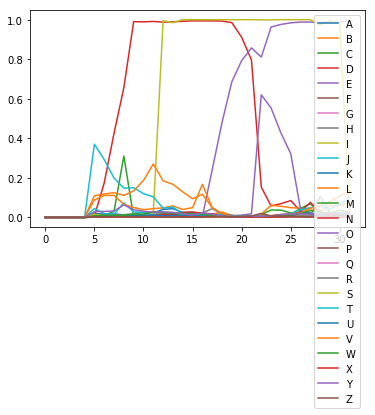

correct: 318 total: 331 accuracy: 0.961 avgEditDist 0.045
('A', 'A'): 131
('S', 'S'): 75
('E', 'E'): 162
('T', 'T'): 74
('H', 'H'): 50
('D', 'D'): 77
('K', 'K'): 25
('N', 'N'): 94
('L', 'L'): 71
('R', 'R'): 113
('O', 'O'): 103
('V', 'V'): 61
('B', 'B'): 21
('C', 'C'): 43
('G', 'G'): 37
('P', 'P'): 32
('I', 'I'): 59
('F', 'F'): 18
('W', 'W'): 25
-------('H', 'R'): 1
('U', 'U'): 15
-------('I', '%'): 3
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
[[0.00142986 0.00076402 0.00143099 ... 0.00151389 0.03275779 0.00061699]
 [0.00168078 0.00101484 0.0017612  ... 0.00178811 0.03371501 0.00082072]
 [0.00184378 0.00118065 0.00207709 ... 0.00230859 0.0346276  0.00111494]
 ...
 [0.00318414 0.00185427 0.00299391 ... 0.00180322 0.0251347  0.00203178]
 [0.00317106 0.00186288 0.00301886 ... 0.0018736  0.0291607  0.00192423]
 [0.0030606  0.00184687 0.00292076 ... 0.00187097 0.02842381 0.00184504]]
--pred for 

AWISAR AWISAR
edit distance: 0
correct: 320 total: 333 accuracy: 0.961 avgEditDist 0.045
('A', 'A'): 133
('S', 'S'): 76
('E', 'E'): 163
('T', 'T'): 74
('H', 'H'): 50
('D', 'D'): 77
('K', 'K'): 25
('N', 'N'): 94
('L', 'L'): 72
('R', 'R'): 115
('O', 'O'): 103
('V', 'V'): 61
('B', 'B'): 21
('C', 'C'): 44
('G', 'G'): 37
('P', 'P'): 32
('I', 'I'): 61
('F', 'F'): 18
('W', 'W'): 26
-------('H', 'R'): 1
('U', 'U'): 15
-------('I', '%'): 3
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
[[0.00164604 0.00157266 0.00113867 ... 0.00125858 0.05176969 0.00098757]
 [0.00139967 0.00141823 0.00107827 ... 0.00123164 0.04670735 0.00090729]
 [0.00119143 0.00138027 0.0010382  ... 0.00175064 0.03161436 0.00059229]
 ...
 [0.00186764 0.00106234 0.0018747  ... 0.00141535 0.02027057 0.00055903]
 [0.00186408 0.00103378 0.0018326  ... 0.00131432 0.01918976 0.00057549]
 [0.00206642 0.0011215  0.00188532 ... 0.00134445 0.02

LOAN LOAN
edit distance: 0
correct: 322 total: 335 accuracy: 0.961 avgEditDist 0.045
('A', 'A'): 134
('S', 'S'): 78
('E', 'E'): 163
('T', 'T'): 74
('H', 'H'): 50
('D', 'D'): 77
('K', 'K'): 25
('N', 'N'): 95
('L', 'L'): 73
('R', 'R'): 115
('O', 'O'): 104
('V', 'V'): 61
('B', 'B'): 21
('C', 'C'): 44
('G', 'G'): 37
('P', 'P'): 33
('I', 'I'): 62
('F', 'F'): 18
('W', 'W'): 26
-------('H', 'R'): 1
('U', 'U'): 16
-------('I', '%'): 3
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
[[0.00298597 0.00207015 0.00298618 ... 0.0022291  0.03942758 0.00149403]
 [0.0031067  0.00201975 0.00303869 ... 0.00218626 0.03081829 0.00153311]
 [0.00339783 0.00215405 0.00320184 ... 0.00221078 0.03305547 0.00162093]
 ...
 [0.00143672 0.00098112 0.0013584  ... 0.00121748 0.04493791 0.00066838]
 [0.00161509 0.00108727 0.00142984 ... 0.00122231 0.03746968 0.00074408]
 [0.00140305 0.00097136 0.0013631  ... 0.00116827 0.036391

SA SA
edit distance: 0
correct: 324 total: 337 accuracy: 0.961 avgEditDist 0.045
('A', 'A'): 135
('S', 'S'): 79
('E', 'E'): 165
('T', 'T'): 74
('H', 'H'): 52
('D', 'D'): 77
('K', 'K'): 25
('N', 'N'): 95
('L', 'L'): 74
('R', 'R'): 115
('O', 'O'): 104
('V', 'V'): 61
('B', 'B'): 22
('C', 'C'): 44
('G', 'G'): 37
('P', 'P'): 33
('I', 'I'): 62
('F', 'F'): 18
('W', 'W'): 26
-------('H', 'R'): 1
('U', 'U'): 16
-------('I', '%'): 3
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
[[0.00129774 0.00087576 0.00127488 ... 0.00189238 0.04302105 0.00052222]
 [0.00159603 0.00098588 0.00127149 ... 0.00231173 0.03234766 0.00060244]
 [0.00167562 0.00102802 0.00111392 ... 0.00198706 0.02511772 0.00056504]
 ...
 [0.00246922 0.00154816 0.00241378 ... 0.00162198 0.02498461 0.00532661]
 [0.00231495 0.00160029 0.00236797 ... 0.0016844  0.02460796 0.00587232]
 [0.00205488 0.00133896 0.00194882 ... 0.00164689 0.02484038 0

[[0.00141925 0.0010016  0.00135032 ... 0.00219491 0.03632203 0.00061978]
 [0.00144856 0.00101029 0.00129633 ... 0.00258567 0.03038935 0.00059824]
 [0.00171763 0.00117206 0.00129854 ... 0.0025311  0.02842762 0.00071644]
 ...
 [0.00162229 0.00108855 0.00175035 ... 0.00173225 0.02622939 0.00062866]
 [0.00163228 0.00103499 0.00170337 ... 0.00158846 0.02638507 0.00057139]
 [0.00177251 0.00110653 0.00179066 ... 0.00175023 0.03068738 0.00062575]]
--pred for 0 20 ['F 0.34 ', 'J 0.27 ', 'V 0.13 ', 'R 0.05 ', 'T 0.04 ']
--pred for 0 24 ['F 0.84 ', 'J 0.19 ', 'V 0.15 ', 'R 0.05 ', 'T 0.03 ']
--pred for 0 28 ['F 0.77 ', 'R 0.21 ', 'V 0.15 ', 'J 0.13 ', 'T 0.04 ']
--pred for 0 32 ['R 0.95 ', 'V 0.16 ', 'J 0.07 ', 'T 0.06 ', 'F 0.04 ']
--pred for 0 36 ['R 0.99 ', 'V 0.17 ', 'L 0.06 ', 'T 0.06 ', 'Y 0.03 ']
--pred for 0 40 ['R 0.99 ', 'V 0.17 ', 'L 0.06 ', 'T 0.06 ', 'A 0.03 ']
--pred for 0 44 ['R 0.99 ', 'V 0.17 ', 'L 0.07 ', 'T 0.05 ', 'W 0.03 ']
--pred for 0 48 ['R 0.99 ', 'I 0.20 ', 'V 0.16 ', 'U

KRADV KRRADV
edit distance: 1


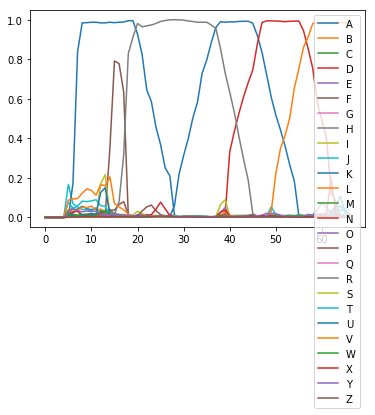

correct: 326 total: 340 accuracy: 0.959 avgEditDist 0.047
('A', 'A'): 137
('S', 'S'): 79
('E', 'E'): 166
('T', 'T'): 74
('H', 'H'): 53
('D', 'D'): 80
('K', 'K'): 26
('N', 'N'): 95
('L', 'L'): 76
('R', 'R'): 118
('O', 'O'): 104
('V', 'V'): 62
('B', 'B'): 22
('C', 'C'): 44
('G', 'G'): 37
('P', 'P'): 34
('I', 'I'): 62
('F', 'F'): 18
('W', 'W'): 26
-------('H', 'R'): 1
('U', 'U'): 18
-------('I', '%'): 3
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
[[0.00172345 0.0013339  0.00163198 ... 0.00098219 0.03184051 0.00073198]
 [0.00307983 0.0023539  0.00278595 ... 0.00167618 0.03590887 0.00151988]
 [0.0032502  0.00219152 0.00316186 ... 0.00207145 0.03694989 0.00164781]
 ...
 [0.00285644 0.00145338 0.00238397 ... 0.00151697 0.05067272 0.00108024]
 [0.00242108 0.00117143 0.0019372  ... 0.00153921 0.05185531 0.00090774]
 [0.00207302 0.00086545 0.0014662  ... 0.00179939 0.03644999 0.0

HADLW HADLW
edit distance: 0
correct: 328 total: 342 accuracy: 0.959 avgEditDist 0.047
('A', 'A'): 140
('S', 'S'): 79
('E', 'E'): 167
('T', 'T'): 74
('H', 'H'): 54
('D', 'D'): 81
('K', 'K'): 26
('N', 'N'): 95
('L', 'L'): 77
('R', 'R'): 119
('O', 'O'): 104
('V', 'V'): 62
('B', 'B'): 22
('C', 'C'): 44
('G', 'G'): 37
('P', 'P'): 34
('I', 'I'): 62
('F', 'F'): 18
('W', 'W'): 27
-------('H', 'R'): 1
('U', 'U'): 18
-------('I', '%'): 3
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
[[0.00168713 0.00110881 0.00164554 ... 0.00102363 0.02311159 0.00070374]
 [0.00187329 0.0010045  0.00140221 ... 0.0011283  0.0272775  0.00076658]
 [0.00197989 0.00109125 0.00165792 ... 0.00141148 0.03187265 0.0008586 ]
 ...
 [0.00132134 0.00065528 0.00115962 ... 0.00232087 0.02152411 0.00059567]
 [0.00140195 0.0007164  0.00135108 ... 0.00165936 0.02983473 0.00062523]
 [0.00128927 0.00069127 0.00127752 

[[0.0015501  0.00081075 0.0014913  ... 0.00234199 0.03557954 0.00079209]
 [0.00178769 0.00100453 0.00185467 ... 0.0021379  0.03793515 0.00093389]
 [0.00200736 0.00138802 0.00155364 ... 0.0033025  0.03910894 0.00104565]
 ...
 [0.00174552 0.00128452 0.00200171 ... 0.00228121 0.02647906 0.0006553 ]
 [0.00160066 0.00093377 0.00168525 ... 0.00133596 0.02404279 0.00050665]
 [0.00170584 0.00105351 0.00184965 ... 0.0016279  0.02331598 0.00057946]]
--pred for 0 20 ['V 0.09 ', 'T 0.08 ', 'J 0.06 ', 'C 0.04 ', 'Y 0.04 ']
--pred for 0 24 ['C 0.12 ', 'T 0.09 ', 'V 0.07 ', 'J 0.05 ', 'Y 0.04 ']
--pred for 0 28 ['V 0.13 ', 'T 0.10 ', 'J 0.09 ', 'G 0.06 ', 'Y 0.04 ']
--pred for 0 32 ['G 0.94 ', 'V 0.17 ', 'T 0.09 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 36 ['G 0.99 ', 'V 0.18 ', 'T 0.09 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 40 ['G 0.99 ', 'V 0.19 ', 'T 0.09 ', 'L 0.04 ', 'Y 0.04 ']
--pred for 0 44 ['G 0.99 ', 'V 0.16 ', 'T 0.09 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 48 ['G 0.99 ', 'I 0.97 ', 'V 0.18 ', 'L

ELHVAL ELHVAL
edit distance: 0
correct: 332 total: 346 accuracy: 0.960 avgEditDist 0.046
('A', 'A'): 142
('S', 'S'): 79
('E', 'E'): 169
('T', 'T'): 75
('H', 'H'): 55
('D', 'D'): 81
('K', 'K'): 27
('N', 'N'): 95
('L', 'L'): 80
('R', 'R'): 120
('O', 'O'): 104
('V', 'V'): 64
('B', 'B'): 22
('C', 'C'): 44
('G', 'G'): 38
('P', 'P'): 34
('I', 'I'): 63
('F', 'F'): 19
('W', 'W'): 27
-------('H', 'R'): 1
('U', 'U'): 19
-------('I', '%'): 3
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
[[0.00322967 0.00228406 0.00277047 ... 0.00204022 0.03955724 0.00151759]
 [0.00345615 0.00221652 0.00310766 ... 0.00227442 0.03629932 0.00166388]
 [0.00359135 0.00217539 0.00313814 ... 0.00214082 0.0341397  0.00169702]
 ...
 [0.0037096  0.0019729  0.00307635 ... 0.00233596 0.03033684 0.00164744]
 [0.0035062  0.00199984 0.00296095 ... 0.00235454 0.0290535  0.00179285]
 [0.00346888 0.00201571 0.0029575

OESLA OESLA
edit distance: 0
correct: 334 total: 348 accuracy: 0.960 avgEditDist 0.046
('A', 'A'): 143
('S', 'S'): 80
('E', 'E'): 173
('T', 'T'): 75
('H', 'H'): 56
('D', 'D'): 81
('K', 'K'): 27
('N', 'N'): 95
('L', 'L'): 81
('R', 'R'): 120
('O', 'O'): 105
('V', 'V'): 64
('B', 'B'): 22
('C', 'C'): 44
('G', 'G'): 38
('P', 'P'): 34
('I', 'I'): 63
('F', 'F'): 19
('W', 'W'): 27
-------('H', 'R'): 1
('U', 'U'): 19
-------('I', '%'): 3
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
[[0.00159459 0.00097907 0.00160985 ... 0.00094365 0.02583372 0.00067783]
 [0.00183899 0.00095332 0.00136482 ... 0.00130693 0.02579714 0.00077482]
 [0.00204584 0.00103218 0.00154684 ... 0.00141742 0.03063473 0.00088058]
 ...
 [0.00311712 0.00231137 0.00147243 ... 0.00251856 0.0235529  0.00243907]
 [0.00293187 0.00213218 0.00140252 ... 0.00246673 0.02496967 0.00236449]
 [0.00266955 0.00199469 0.00141851 

['A 0.993', 'B 0.004', 'C 0.002', 'D 0.002', 'E 0.003', 'F 0.01', 'G 0.003', 'H 0.015', 'I 0.006', 'J 0.022', 'K 0.003', 'L 0.025', 'M 0.003', 'N 0.003', 'O 0.003', 'P 0.004', 'Q 0.003', 'R 0.003', 'S 0.005', 'T 0.05', 'U 0.007', 'V 0.061', 'W 0.01', 'X 0.001', 'Y 0.038', 'Z 0.002']
['A -2']
A
['A 0.993', 'B 0.003', 'C 0.002', 'D 0.003', 'E 0.003', 'F 0.01', 'G 0.003', 'H 0.016', 'I 0.006', 'J 0.028', 'K 0.003', 'L 0.019', 'M 0.003', 'N 0.004', 'O 0.003', 'P 0.004', 'Q 0.003', 'R 0.003', 'S 0.004', 'T 0.056', 'U 0.007', 'V 0.038', 'W 0.009', 'X 0.002', 'Y 0.041', 'Z 0.001']
['A -1']
A
['A 0.989', 'B 0.003', 'C 0.002', 'D 0.003', 'E 0.002', 'F 0.007', 'G 0.003', 'H 0.014', 'I 0.005', 'J 0.035', 'K 0.003', 'L 0.016', 'M 0.003', 'N 0.003', 'O 0.004', 'P 0.003', 'Q 0.003', 'R 0.002', 'S 0.005', 'T 0.062', 'U 0.008', 'V 0.03', 'W 0.009', 'X 0.002', 'Y 0.035', 'Z 0.001']
['A 0']
A
['A 0.987', 'B 0.003', 'C 0.002', 'D 0.003', 'E 0.002', 'F 0.007', 'G 0.003', 'H 0.014', 'I 0.005', 'J 0.043', '

[[3.03021260e-03 1.99058303e-03 2.79031624e-03 2.93832440e-02
  1.26741594e-02 1.38904573e-03 1.73141842e-03 9.75414097e-01
  8.04389920e-03 2.98616756e-03 1.55915348e-02 4.93498240e-03
  5.19151427e-02 2.28663487e-03 4.13114019e-02 5.13893366e-03
  1.87865715e-03 2.58239452e-03 2.32632458e-03 3.47539410e-03
  2.80018407e-03 3.44609888e-03 6.77080452e-02 7.02621927e-03
  1.16988227e-01 1.15768556e-02 1.95820024e-03 4.06068191e-02
  1.29922444e-03]
 [3.17357248e-03 2.03818758e-03 2.95485253e-03 3.88792902e-02
  1.25992075e-02 1.58000703e-03 2.09008181e-03 9.86445248e-01
  7.43565010e-03 4.11832053e-03 1.44030005e-02 5.25090238e-03
  3.85415182e-02 2.35604891e-03 4.52168360e-02 4.73267958e-03
  1.97639014e-03 2.61295680e-03 2.57233344e-03 3.70444148e-03
  2.32864846e-03 3.28806718e-03 8.72837901e-02 9.14145820e-03
  1.16745010e-01 1.24426261e-02 2.13447260e-03 3.68678160e-02
  1.45789923e-03]
 [3.22060077e-03 2.02320819e-03 2.87840259e-03 3.60412858e-02
  1.55675560e-02 1.35966099e-03 2.

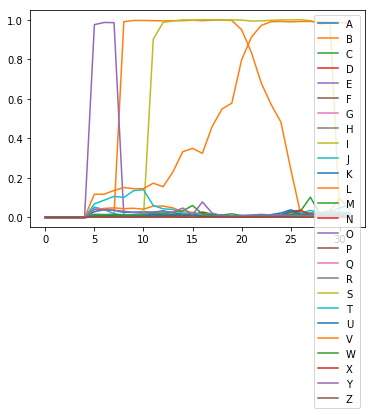

correct: 337 total: 352 accuracy: 0.957 avgEditDist 0.048
('A', 'A'): 147
('S', 'S'): 81
('E', 'E'): 174
('T', 'T'): 75
('H', 'H'): 58
('D', 'D'): 81
('K', 'K'): 28
('N', 'N'): 96
('L', 'L'): 82
('R', 'R'): 121
('O', 'O'): 107
('V', 'V'): 65
('B', 'B'): 23
('C', 'C'): 44
('G', 'G'): 38
('P', 'P'): 34
('I', 'I'): 65
('F', 'F'): 19
('W', 'W'): 27
-------('H', 'R'): 1
('U', 'U'): 20
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 16
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
[[1.35279202e-03 9.11285984e-04 1.58260285e-03 1.17356926e-02
  5.62022254e-03 1.12676597e-03 4.71376767e-03 2.35479046e-03
  3.30827385e-03 1.50435336e-03 9.46981646e-03 1.36191780e-02
  4.34380807e-02 1.44631893e-03 7.96491444e-01 4.20977734e-03
  1.89310056e-03 1.66712026e-03 2.18636077e-03 2.62522232e-03
  1.55149179e-03 1.29232812e-03 1.22659817e-01 4.83930437e-03
  1.16483934e-01 9.78855230e-03 1.00482220e-03 2.58252956e-02


DMKAEW DMKAEW
edit distance: 0
correct: 339 total: 354 accuracy: 0.958 avgEditDist 0.048
('A', 'A'): 148
('S', 'S'): 81
('E', 'E'): 175
('T', 'T'): 75
('H', 'H'): 58
('D', 'D'): 82
('K', 'K'): 29
('N', 'N'): 97
('L', 'L'): 83
('R', 'R'): 121
('O', 'O'): 107
('V', 'V'): 65
('B', 'B'): 23
('C', 'C'): 44
('G', 'G'): 38
('P', 'P'): 34
('I', 'I'): 65
('F', 'F'): 19
('W', 'W'): 28
-------('H', 'R'): 1
('U', 'U'): 20
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 17
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
[[0.00160401 0.00108216 0.00173394 ... 0.00124965 0.02387264 0.0007373 ]
 [0.00205589 0.00119444 0.00173555 ... 0.00125055 0.0292773  0.00094579]
 [0.0022917  0.00128297 0.00202443 ... 0.00103205 0.03180723 0.00101945]
 ...
 [0.00279232 0.00145689 0.00242588 ... 0.00146908 0.04041271 0.00119858]
 [0.00246078 0.00093018 0.00162705 ... 0.00234719 0.044998   0.00095857]
 [0.0021331  0.00085644 0.0014826

EI EI
edit distance: 0
correct: 341 total: 356 accuracy: 0.958 avgEditDist 0.048
('A', 'A'): 151
('S', 'S'): 81
('E', 'E'): 176
('T', 'T'): 75
('H', 'H'): 58
('D', 'D'): 82
('K', 'K'): 29
('N', 'N'): 97
('L', 'L'): 83
('R', 'R'): 122
('O', 'O'): 107
('V', 'V'): 65
('B', 'B'): 23
('C', 'C'): 44
('G', 'G'): 39
('P', 'P'): 34
('I', 'I'): 66
('F', 'F'): 19
('W', 'W'): 28
-------('H', 'R'): 1
('U', 'U'): 20
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 17
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
[[0.00197795 0.00126293 0.00202979 ... 0.00121064 0.04495025 0.00086055]
 [0.00170276 0.00123245 0.00214824 ... 0.00157008 0.03787303 0.00080249]
 [0.00163292 0.00118897 0.00205706 ... 0.00162503 0.03239069 0.00073278]
 ...
 [0.00160402 0.00133619 0.00273876 ... 0.00395066 0.03157837 0.00097454]
 [0.00148196 0.00122003 0.00241781 ... 0.00502611 0.02717903 0.00092455]
 [0.00146382 0.00098769 0.00204537 ... 0.

[[0.0012552  0.00055967 0.0011526  ... 0.00113873 0.04647971 0.00066766]
 [0.00143714 0.00058231 0.00116313 ... 0.00145035 0.04702958 0.00074303]
 [0.00153227 0.00063195 0.00130356 ... 0.00203732 0.03183602 0.00090877]
 ...
 [0.00108354 0.00059192 0.00106808 ... 0.0007381  0.01741312 0.00103046]
 [0.00105465 0.00068307 0.00125153 ... 0.00093897 0.01765835 0.00084076]
 [0.00124473 0.00086617 0.00144151 ... 0.00131858 0.02408383 0.00063612]]
--pred for 0 20 ['V 0.31 ', 'T 0.16 ', 'Y 0.05 ', 'J 0.03 ', 'L 0.02 ']
--pred for 0 24 ['V 0.45 ', 'T 0.11 ', 'J 0.05 ', 'Y 0.05 ', 'A 0.02 ']
--pred for 0 28 ['V 0.72 ', 'J 0.11 ', 'T 0.08 ', 'Y 0.03 ', 'L 0.02 ']
--pred for 0 32 ['V 0.91 ', 'J 0.10 ', 'T 0.05 ', 'W 0.02 ', 'Y 0.02 ']
--pred for 0 36 ['V 0.97 ', 'T 0.05 ', 'J 0.04 ', 'L 0.02 ', 'A 0.02 ']
--pred for 0 40 ['V 0.99 ', 'T 0.05 ', 'L 0.05 ', 'J 0.03 ', 'U 0.02 ']
--pred for 0 44 ['V 0.99 ', 'T 0.06 ', 'L 0.05 ', 'J 0.02 ', 'A 0.02 ']
--pred for 0 48 ['V 0.99 ', 'L 0.04 ', 'J 0.04 ', 'T

[[0.00198744 0.00141305 0.00163991 ... 0.00180544 0.03967258 0.00091805]
 [0.00205722 0.00142136 0.00133031 ... 0.00217695 0.03429173 0.00085759]
 [0.00218213 0.00151345 0.00134284 ... 0.00202116 0.0308613  0.00115296]
 ...
 [0.00134097 0.00115711 0.00161686 ... 0.00167062 0.02028597 0.00069461]
 [0.00130855 0.00099713 0.00144548 ... 0.0014311  0.03026924 0.00064137]
 [0.00124602 0.00093243 0.00137854 ... 0.00133499 0.02630274 0.00055083]]
--pred for 0 20 ['J 0.32 ', 'V 0.14 ', 'R 0.08 ', 'E 0.04 ', 'T 0.04 ']
--pred for 0 24 ['R 0.49 ', 'F 0.26 ', 'J 0.17 ', 'V 0.15 ', 'Y 0.03 ']
--pred for 0 28 ['R 0.73 ', 'V 0.15 ', 'J 0.14 ', 'F 0.13 ', 'T 0.04 ']
--pred for 0 32 ['R 0.99 ', 'V 0.13 ', 'T 0.08 ', 'L 0.07 ', 'Y 0.04 ']
--pred for 0 36 ['R 0.99 ', 'V 0.14 ', 'T 0.08 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 40 ['R 0.99 ', 'V 0.15 ', 'T 0.08 ', 'L 0.04 ', 'A 0.04 ']
--pred for 0 44 ['R 0.99 ', 'V 0.13 ', 'T 0.07 ', 'L 0.04 ', 'A 0.04 ']
--pred for 0 48 ['R 0.98 ', 'V 0.18 ', 'W 0.09 ', 'T

TRAC TRAC
edit distance: 0
correct: 346 total: 361 accuracy: 0.958 avgEditDist 0.047
('A', 'A'): 152
('S', 'S'): 82
('E', 'E'): 179
('T', 'T'): 76
('H', 'H'): 59
('D', 'D'): 83
('K', 'K'): 29
('N', 'N'): 99
('L', 'L'): 83
('R', 'R'): 125
('O', 'O'): 110
('V', 'V'): 67
('B', 'B'): 24
('C', 'C'): 46
('G', 'G'): 39
('P', 'P'): 36
('I', 'I'): 66
('F', 'F'): 19
('W', 'W'): 28
-------('H', 'R'): 1
('U', 'U'): 20
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 18
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
[[0.00149412 0.00075925 0.00135499 ... 0.00217989 0.03252075 0.0007328 ]
 [0.0018367  0.00105491 0.00182825 ... 0.00231557 0.03432014 0.00093972]
 [0.00206753 0.00125886 0.00234125 ... 0.00263934 0.03861949 0.00129695]
 ...
 [0.00158293 0.00104073 0.00177724 ... 0.00197701 0.03201704 0.00060624]
 [0.0016579  0.00106348 0.00178473 ... 0.00177422 0.02897935 0.00058346]
 [0.00169846 0.001077   0.00174643 ..

EEA EEA
edit distance: 0
correct: 348 total: 363 accuracy: 0.959 avgEditDist 0.047
('A', 'A'): 153
('S', 'S'): 82
('E', 'E'): 181
('T', 'T'): 77
('H', 'H'): 59
('D', 'D'): 83
('K', 'K'): 29
('N', 'N'): 100
('L', 'L'): 84
('R', 'R'): 125
('O', 'O'): 110
('V', 'V'): 67
('B', 'B'): 24
('C', 'C'): 47
('G', 'G'): 39
('P', 'P'): 36
('I', 'I'): 66
('F', 'F'): 19
('W', 'W'): 28
-------('H', 'R'): 1
('U', 'U'): 21
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 18
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
[[0.00151908 0.00106281 0.00170693 ... 0.00131471 0.0225744  0.0007101 ]
 [0.00172994 0.0009919  0.00144846 ... 0.00115192 0.0232311  0.0006968 ]
 [0.00189143 0.00109793 0.00159517 ... 0.00138571 0.02642446 0.00084646]
 ...
 [0.00148065 0.00083778 0.00146083 ... 0.00118893 0.0283624  0.00092318]
 [0.00156651 0.00091457 0.00152238 ... 0.00130142 0.03326661 0.00092491]
 [0.00164704 0.00101822 0.00170029 ...

RI RI
edit distance: 0
correct: 350 total: 365 accuracy: 0.959 avgEditDist 0.047
('A', 'A'): 154
('S', 'S'): 83
('E', 'E'): 182
('T', 'T'): 77
('H', 'H'): 59
('D', 'D'): 83
('K', 'K'): 29
('N', 'N'): 102
('L', 'L'): 84
('R', 'R'): 126
('O', 'O'): 110
('V', 'V'): 67
('B', 'B'): 24
('C', 'C'): 47
('G', 'G'): 39
('P', 'P'): 36
('I', 'I'): 67
('F', 'F'): 19
('W', 'W'): 28
-------('H', 'R'): 1
('U', 'U'): 21
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 18
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
[[0.00154227 0.00079914 0.00142693 ... 0.0013441  0.03419386 0.00061471]
 [0.00188228 0.00099962 0.0017852  ... 0.00143493 0.04083285 0.00080807]
 [0.00199546 0.00122224 0.00223915 ... 0.00207934 0.04719963 0.00132011]
 ...
 [0.0017433  0.00171035 0.00153612 ... 0.00273369 0.03612017 0.0014474 ]
 [0.00134954 0.00087877 0.00114071 ... 0.00117986 0.06618325 0.00066067]
 [0.00137004 0.0009198  0.00133977 ... 0

KR FKR
edit distance: 1


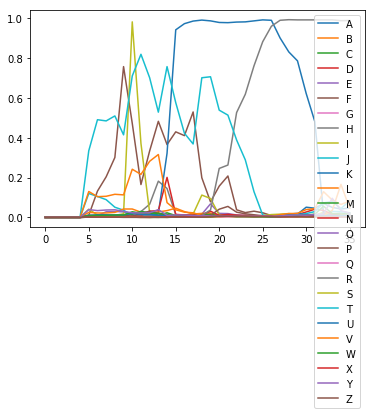

correct: 351 total: 367 accuracy: 0.956 avgEditDist 0.049
('A', 'A'): 154
('S', 'S'): 83
('E', 'E'): 183
('T', 'T'): 78
('H', 'H'): 60
('D', 'D'): 83
('K', 'K'): 30
('N', 'N'): 102
('L', 'L'): 84
('R', 'R'): 127
('O', 'O'): 111
('V', 'V'): 67
('B', 'B'): 24
('C', 'C'): 47
('G', 'G'): 39
('P', 'P'): 36
('I', 'I'): 68
('F', 'F'): 19
('W', 'W'): 28
-------('H', 'R'): 1
('U', 'U'): 21
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 18
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 1
[[0.00116299 0.00079714 0.00124722 ... 0.00148316 0.04560402 0.00056357]
 [0.00113593 0.00081151 0.00116605 ... 0.00205348 0.03868259 0.00060466]
 [0.00110194 0.00082522 0.00114614 ... 0.00231284 0.03497946 0.00065656]
 ...
 [0.00133099 0.00080437 0.00119148 ... 0.0008799  0.02027151 0.00065044]
 [0.00166031 0.00083874 0.00159327 ... 0.00106752 0.03353369 0.00096831]
 [0.00162668 0.0007599  0.0014787  ... 0.0

TKA TKA
edit distance: 0
correct: 353 total: 369 accuracy: 0.957 avgEditDist 0.049
('A', 'A'): 155
('S', 'S'): 83
('E', 'E'): 183
('T', 'T'): 80
('H', 'H'): 61
('D', 'D'): 83
('K', 'K'): 31
('N', 'N'): 102
('L', 'L'): 84
('R', 'R'): 127
('O', 'O'): 111
('V', 'V'): 68
('B', 'B'): 24
('C', 'C'): 47
('G', 'G'): 39
('P', 'P'): 36
('I', 'I'): 68
('F', 'F'): 19
('W', 'W'): 28
-------('H', 'R'): 1
('U', 'U'): 21
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 18
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 1
[[0.00260176 0.00191773 0.00266121 ... 0.00183788 0.039381   0.00126886]
 [0.00314433 0.00214391 0.00314537 ... 0.0021475  0.03730535 0.00153083]
 [0.00323842 0.002204   0.00316607 ... 0.00213448 0.03484285 0.00166037]
 ...
 [0.00147925 0.00105766 0.0014818  ... 0.00138066 0.03292853 0.00073064]
 [0.00141113 0.00094224 0.00140516 ... 0.00120691 0.03565603 0.00064309]
 [0.00134693 0.00

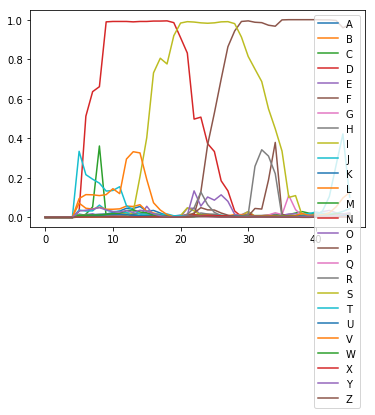

correct: 354 total: 371 accuracy: 0.954 avgEditDist 0.051
('A', 'A'): 155
('S', 'S'): 84
('E', 'E'): 184
('T', 'T'): 80
('H', 'H'): 62
('D', 'D'): 84
('K', 'K'): 31
('N', 'N'): 102
('L', 'L'): 84
('R', 'R'): 127
('O', 'O'): 111
('V', 'V'): 68
('B', 'B'): 24
('C', 'C'): 47
('G', 'G'): 39
('P', 'P'): 36
('I', 'I'): 68
('F', 'F'): 20
('W', 'W'): 28
-------('H', 'R'): 1
('U', 'U'): 22
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 18
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
[[1.93823164e-03 1.08899118e-03 1.52285665e-03 8.22838582e-03
  1.12508610e-02 9.73513117e-04 1.23785785e-03 1.33124902e-03
  1.42373275e-02 1.12413988e-03 1.08600436e-02 1.37605509e-02
  5.86256236e-02 1.81725458e-03 2.11201943e-02 1.38571244e-02
  3.21261887e-03 6.49301102e-03 1.70959551e-02 2.49887467e-03
  7.35629722e-02 2.86611472e-03 1.22551158e-01 5.53393923e-03
  1.92420051e-01 1.06562600e-02 1.422803

AORVUH AORVUH
edit distance: 0
correct: 356 total: 373 accuracy: 0.954 avgEditDist 0.051
('A', 'A'): 156
('S', 'S'): 84
('E', 'E'): 184
('T', 'T'): 80
('H', 'H'): 63
('D', 'D'): 84
('K', 'K'): 31
('N', 'N'): 103
('L', 'L'): 84
('R', 'R'): 128
('O', 'O'): 112
('V', 'V'): 69
('B', 'B'): 24
('C', 'C'): 47
('G', 'G'): 39
('P', 'P'): 36
('I', 'I'): 69
('F', 'F'): 20
('W', 'W'): 28
-------('H', 'R'): 1
('U', 'U'): 23
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 18
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
[[0.00157993 0.00110454 0.00152306 ... 0.00090261 0.03020908 0.00097832]
 [0.00147108 0.00104424 0.00174163 ... 0.00112215 0.02965495 0.00147913]
 [0.00154888 0.00107627 0.00186591 ... 0.00125945 0.03193501 0.0016749 ]
 ...
 [0.00131491 0.00167015 0.00245732 ... 0.002465   0.03139997 0.00183634]
 [0.00123441 0.00154999 0.002288   ... 0.0024531  0.03245701 0.00181308]
 [0.0011181

BVLEER BVLEER
edit distance: 0
correct: 358 total: 375 accuracy: 0.955 avgEditDist 0.051
('A', 'A'): 156
('S', 'S'): 84
('E', 'E'): 186
('T', 'T'): 80
('H', 'H'): 63
('D', 'D'): 84
('K', 'K'): 31
('N', 'N'): 103
('L', 'L'): 86
('R', 'R'): 129
('O', 'O'): 113
('V', 'V'): 70
('B', 'B'): 25
('C', 'C'): 47
('G', 'G'): 39
('P', 'P'): 37
('I', 'I'): 69
('F', 'F'): 20
('W', 'W'): 28
-------('H', 'R'): 1
('U', 'U'): 23
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 18
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
[[0.00314631 0.00215801 0.00294606 ... 0.00234131 0.04152906 0.00152594]
 [0.00330797 0.00228304 0.00318589 ... 0.00256381 0.03581954 0.00181198]
 [0.00354463 0.00231718 0.0033362  ... 0.00237651 0.03810283 0.00181138]
 ...
 [0.00458959 0.00140311 0.00387319 ... 0.00329102 0.03945588 0.00144058]
 [0.00307947 0.00111441 0.00273903 ... 0.00200191 0.04345643 0.00103763]
 [0.0028172

WV WV
edit distance: 0
correct: 360 total: 377 accuracy: 0.955 avgEditDist 0.050
('A', 'A'): 156
('S', 'S'): 85
('E', 'E'): 187
('T', 'T'): 80
('H', 'H'): 63
('D', 'D'): 84
('K', 'K'): 31
('N', 'N'): 103
('L', 'L'): 86
('R', 'R'): 129
('O', 'O'): 114
('V', 'V'): 71
('B', 'B'): 26
('C', 'C'): 48
('G', 'G'): 39
('P', 'P'): 37
('I', 'I'): 69
('F', 'F'): 20
('W', 'W'): 29
-------('H', 'R'): 1
('U', 'U'): 24
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 18
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
[[0.0008444  0.00079049 0.00136632 ... 0.00099093 0.02213367 0.00041512]
 [0.00131033 0.00101233 0.00166198 ... 0.00147036 0.02200901 0.00069914]
 [0.00201224 0.00121482 0.00188108 ... 0.00207058 0.02220589 0.00101798]
 ...
 [0.00165582 0.00133127 0.00157282 ... 0.0018012  0.03635828 0.00093744]
 [0.00155645 0.00112989 0.00144103 ... 0.00127485 0.04600245 0.00076311]
 [0.00147403 0.0010

ATAC ATAC
edit distance: 0
correct: 362 total: 379 accuracy: 0.955 avgEditDist 0.050
('A', 'A'): 158
('S', 'S'): 85
('E', 'E'): 187
('T', 'T'): 82
('H', 'H'): 64
('D', 'D'): 84
('K', 'K'): 31
('N', 'N'): 104
('L', 'L'): 87
('R', 'R'): 129
('O', 'O'): 114
('V', 'V'): 71
('B', 'B'): 26
('C', 'C'): 49
('G', 'G'): 39
('P', 'P'): 37
('I', 'I'): 69
('F', 'F'): 20
('W', 'W'): 29
-------('H', 'R'): 1
('U', 'U'): 24
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 18
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
[[0.00105362 0.00076181 0.00108313 ... 0.00211783 0.04325685 0.00050604]
 [0.00105981 0.00079546 0.00103648 ... 0.00252864 0.03840524 0.00058354]
 [0.00107121 0.00085215 0.00107188 ... 0.00255289 0.03438585 0.00069164]
 ...
 [0.00261476 0.00187693 0.00133172 ... 0.00265912 0.01838845 0.0019406 ]
 [0.00263215 0.00189685 0.00145329 ... 0.00261724 0.02095135 0.00193625]
 [0.00221825 0.

VI VI
edit distance: 0
correct: 364 total: 381 accuracy: 0.955 avgEditDist 0.050
('A', 'A'): 158
('S', 'S'): 85
('E', 'E'): 187
('T', 'T'): 82
('H', 'H'): 65
('D', 'D'): 84
('K', 'K'): 31
('N', 'N'): 105
('L', 'L'): 87
('R', 'R'): 131
('O', 'O'): 114
('V', 'V'): 72
('B', 'B'): 26
('C', 'C'): 49
('G', 'G'): 39
('P', 'P'): 38
('I', 'I'): 70
('F', 'F'): 20
('W', 'W'): 29
-------('H', 'R'): 1
('U', 'U'): 24
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 18
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
[[0.00172783 0.00140557 0.00242615 ... 0.00123347 0.0357835  0.00236437]
 [0.00163422 0.0016764  0.00323563 ... 0.0017798  0.03793453 0.00337285]
 [0.00174178 0.00181154 0.00370639 ... 0.00232044 0.04440016 0.00315475]
 ...
 [0.00328055 0.00115345 0.00299947 ... 0.00269334 0.02055069 0.00121934]
 [0.00298152 0.00115024 0.00269634 ... 0.00251889 0.01897054 0.0010579 ]
 [0.00263602 0.0010

[[0.00165312 0.00079282 0.00129547 ... 0.00209687 0.0299613  0.00066857]
 [0.00155318 0.00086702 0.00165526 ... 0.00242321 0.045593   0.00083374]
 [0.00195182 0.00114738 0.00230579 ... 0.00274676 0.05616315 0.0013155 ]
 ...
 [0.00154059 0.00094119 0.00135766 ... 0.00099817 0.0414979  0.00067518]
 [0.0015362  0.00097568 0.0013287  ... 0.00109396 0.0354668  0.00071109]
 [0.00132542 0.00081165 0.00129016 ... 0.00101944 0.03107529 0.00073318]]
--pred for 0 20 ['V 0.13 ', 'T 0.08 ', 'J 0.05 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 24 ['C 0.20 ', 'V 0.11 ', 'T 0.08 ', 'J 0.05 ', 'Y 0.05 ']
--pred for 0 28 ['C 0.92 ', 'V 0.12 ', 'T 0.10 ', 'Y 0.06 ', 'L 0.04 ']
--pred for 0 32 ['C 0.98 ', 'J 0.33 ', 'V 0.11 ', 'T 0.06 ', 'Y 0.05 ']
--pred for 0 36 ['C 0.90 ', 'J 0.29 ', 'V 0.15 ', 'G 0.07 ', 'Y 0.05 ']
--pred for 0 40 ['G 0.98 ', 'V 0.21 ', 'J 0.08 ', 'Y 0.06 ', 'T 0.05 ']
--pred for 0 44 ['G 0.99 ', 'V 0.20 ', 'T 0.08 ', 'Y 0.05 ', 'J 0.04 ']
--pred for 0 48 ['G 0.99 ', 'I 0.58 ', 'V 0.23 ', 'U

[[0.00132885 0.00100048 0.00176509 ... 0.00107099 0.03663483 0.00058069]
 [0.00103858 0.00086203 0.00158285 ... 0.00107987 0.02467351 0.00050339]
 [0.00137857 0.00101944 0.00175078 ... 0.00127008 0.02627537 0.00064768]
 ...
 [0.001367   0.00264444 0.00404794 ... 0.00265292 0.03913081 0.0026009 ]
 [0.00135977 0.00181303 0.00267129 ... 0.00257929 0.02389526 0.00189376]
 [0.00129515 0.00180247 0.00270628 ... 0.00240491 0.02195453 0.00184472]]
--pred for 0 20 ['J 0.20 ', 'N 0.11 ', 'V 0.09 ', 'M 0.08 ', 'T 0.07 ']
--pred for 0 24 ['M 0.25 ', 'V 0.13 ', 'N 0.08 ', 'J 0.08 ', 'T 0.06 ']
--pred for 0 28 ['N 0.58 ', 'V 0.12 ', 'M 0.11 ', 'J 0.06 ', 'T 0.05 ']
--pred for 0 32 ['N 0.96 ', 'V 0.13 ', 'J 0.07 ', 'T 0.05 ', 'A 0.04 ']
--pred for 0 36 ['N 0.96 ', 'V 0.15 ', 'J 0.07 ', 'T 0.04 ', 'A 0.03 ']
--pred for 0 40 ['N 0.99 ', 'V 0.20 ', 'T 0.06 ', 'J 0.03 ', 'L 0.03 ']
--pred for 0 44 ['N 0.99 ', 'V 0.18 ', 'T 0.07 ', 'L 0.03 ', 'J 0.03 ']
--pred for 0 48 ['N 0.99 ', 'I 0.34 ', 'V 0.12 ', 'T

[[0.00128221 0.00093607 0.00129517 ... 0.00220654 0.0427562  0.00054488]
 [0.00234891 0.00134453 0.00130784 ... 0.00259512 0.0321658  0.00087047]
 [0.00311275 0.00191306 0.00132036 ... 0.00263492 0.03232841 0.00131769]
 ...
 [0.00324319 0.00227164 0.00143682 ... 0.00240741 0.03319017 0.0024164 ]
 [0.0030714  0.0020601  0.00137329 ... 0.00267027 0.03155511 0.00239697]
 [0.00291151 0.002139   0.00145703 ... 0.00232766 0.02898499 0.00236662]]
--pred for 0 20 ['F 0.65 ', 'J 0.29 ', 'V 0.13 ', 'T 0.07 ', 'Y 0.04 ']
--pred for 0 24 ['R 0.69 ', 'F 0.44 ', 'V 0.15 ', 'J 0.11 ', 'T 0.05 ']
--pred for 0 28 ['R 0.95 ', 'V 0.16 ', 'J 0.15 ', 'F 0.07 ', 'T 0.06 ']
--pred for 0 32 ['R 0.99 ', 'V 0.17 ', 'T 0.09 ', 'L 0.06 ', 'J 0.04 ']
--pred for 0 36 ['R 0.99 ', 'V 0.16 ', 'T 0.09 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 40 ['I 0.98 ', 'R 0.98 ', 'V 0.21 ', 'L 0.07 ', 'Y 0.05 ']
--pred for 0 44 ['I 0.99 ', 'R 0.99 ', 'V 0.25 ', 'L 0.08 ', 'Y 0.03 ']
--pred for 0 48 ['R 0.99 ', 'L 0.63 ', 'V 0.14 ', 'I

UT UT
edit distance: 0
correct: 372 total: 389 accuracy: 0.956 avgEditDist 0.049
('A', 'A'): 164
('S', 'S'): 86
('E', 'E'): 189
('T', 'T'): 85
('H', 'H'): 66
('D', 'D'): 85
('K', 'K'): 31
('N', 'N'): 107
('L', 'L'): 88
('R', 'R'): 136
('O', 'O'): 115
('V', 'V'): 72
('B', 'B'): 26
('C', 'C'): 49
('G', 'G'): 40
('P', 'P'): 39
('I', 'I'): 71
('F', 'F'): 20
('W', 'W'): 29
-------('H', 'R'): 1
('U', 'U'): 27
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 19
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
[[1.80066272e-03 1.07458723e-03 1.66264793e-03 6.08784139e-01
  2.96883960e-03 1.69489847e-03 2.65150541e-03 1.53731753e-03
  4.19302331e-03 1.71683449e-03 1.09187681e-02 2.93057784e-03
  1.87474221e-01 1.28429406e-03 3.44707705e-02 1.53455860e-03
  1.19637616e-03 2.48829369e-03 1.93440355e-03 2.01018923e-03
  1.05881016e-03 1.47505919e-03 1.23173676e-01 7.28925643e-03
  3.21253985e-02 

AEIABK AEIABK
edit distance: 0
correct: 374 total: 391 accuracy: 0.957 avgEditDist 0.049
('A', 'A'): 167
('S', 'S'): 86
('E', 'E'): 191
('T', 'T'): 85
('H', 'H'): 66
('D', 'D'): 85
('K', 'K'): 32
('N', 'N'): 107
('L', 'L'): 88
('R', 'R'): 136
('O', 'O'): 115
('V', 'V'): 72
('B', 'B'): 27
('C', 'C'): 49
('G', 'G'): 40
('P', 'P'): 39
('I', 'I'): 72
('F', 'F'): 20
('W', 'W'): 29
-------('H', 'R'): 1
('U', 'U'): 27
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 19
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
[[0.00113893 0.00065993 0.00132198 ... 0.00099256 0.11255443 0.00057282]
 [0.00131731 0.0006468  0.0013943  ... 0.00170896 0.10300103 0.0006973 ]
 [0.00152938 0.00072454 0.00144945 ... 0.00192483 0.0369141  0.0008333 ]
 ...
 [0.00162365 0.00088465 0.00129529 ... 0.00100112 0.01374595 0.00086656]
 [0.00141089 0.00084201 0.0011909  ... 0.00093796 0.01485778 0.00065309]
 [0.0016720

[[0.00301509 0.00108427 0.00277496 ... 0.00359967 0.03943947 0.00095741]
 [0.00362991 0.00117529 0.00303888 ... 0.00338804 0.03817444 0.00120956]
 [0.00426118 0.00134107 0.00339726 ... 0.00325587 0.04034599 0.00145352]
 ...
 [0.00125523 0.00160872 0.00242992 ... 0.0022488  0.026064   0.00231688]
 [0.00127347 0.00147903 0.00220844 ... 0.00225389 0.02658172 0.00252726]
 [0.0012239  0.00130617 0.00190252 ... 0.00218812 0.02041507 0.00278132]]
--pred for 0 20 ['S 0.85 ', 'J 0.14 ', 'V 0.13 ', 'T 0.06 ', 'L 0.05 ']
--pred for 0 24 ['S 0.94 ', 'V 0.15 ', 'T 0.08 ', 'J 0.07 ', 'L 0.05 ']
--pred for 0 28 ['S 0.95 ', 'V 0.13 ', 'T 0.08 ', 'J 0.06 ', 'L 0.05 ']
--pred for 0 32 ['S 0.96 ', 'V 0.13 ', 'T 0.09 ', 'L 0.05 ', 'A 0.04 ']
--pred for 0 36 ['S 0.98 ', 'V 0.14 ', 'T 0.08 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 40 ['S 0.99 ', 'V 0.17 ', 'T 0.07 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 44 ['S 0.99 ', 'V 0.14 ', 'T 0.10 ', 'L 0.05 ', 'A 0.03 ']
--pred for 0 48 ['S 0.99 ', 'I 0.47 ', 'V 0.17 ', 'U

[[1.21659134e-03 5.65469149e-04 1.08665484e-03 7.98691437e-03
  3.48164537e-03 9.21862142e-04 1.38906296e-03 1.35524466e-03
  3.45979631e-03 1.28786219e-03 1.49204582e-02 2.41377624e-03
  8.16443935e-02 1.34288799e-03 2.59065069e-02 2.56303255e-03
  7.65359437e-04 1.35159958e-03 2.12716660e-03 1.95299671e-03
  1.35579088e-03 3.26661230e-03 8.97483081e-02 3.58831999e-03
  5.21677196e-01 1.17799016e-02 1.26719486e-03 3.45485657e-02
  7.24042475e-04]
 [1.27016695e-03 7.65590288e-04 1.33731379e-03 4.79838159e-03
  2.39494373e-03 1.58799603e-03 1.92642934e-03 1.62930810e-03
  5.10124350e-03 1.38311076e-03 1.03879170e-02 3.92771559e-03
  1.62019804e-01 1.55597890e-03 2.78108418e-02 4.78935428e-03
  2.39405176e-03 5.08129038e-03 3.08463350e-03 1.86133909e-03
  1.71640294e-03 1.83447369e-03 6.45593032e-02 5.80136571e-03
  2.35394642e-01 1.44986242e-01 1.24566059e-03 2.97090020e-02
  8.07254342e-04]
 [1.89360429e-03 9.91357607e-04 1.44697935e-03 7.38904625e-03
  2.38040881e-03 1.44683605e-03 3.

[[0.00152975 0.00075141 0.00140703 ... 0.00126433 0.02620235 0.00103319]
 [0.00176134 0.00087794 0.00140428 ... 0.00135304 0.02708612 0.00123329]
 [0.00212109 0.0010641  0.00141298 ... 0.00146091 0.02508151 0.00129526]
 ...
 [0.00116437 0.00061376 0.0011288  ... 0.00086765 0.01568936 0.00135902]
 [0.00094657 0.00065911 0.0011461  ... 0.00090303 0.0172975  0.00108666]
 [0.00131928 0.0007798  0.00127943 ... 0.00116597 0.0344182  0.00083062]]
--pred for 0 20 ['T 0.65 ', 'V 0.06 ', 'J 0.04 ', 'L 0.03 ', 'Y 0.03 ']
--pred for 0 24 ['T 0.91 ', 'V 0.07 ', 'J 0.06 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 28 ['T 0.97 ', 'V 0.09 ', 'L 0.06 ', 'J 0.03 ', 'Y 0.03 ']
--pred for 0 32 ['T 0.98 ', 'V 0.09 ', 'L 0.05 ', 'J 0.04 ', 'A 0.03 ']
--pred for 0 36 ['T 0.99 ', 'V 0.11 ', 'L 0.05 ', 'A 0.03 ', 'J 0.03 ']
--pred for 0 40 ['T 0.99 ', 'V 0.13 ', 'L 0.05 ', 'A 0.03 ', 'Y 0.02 ']
--pred for 0 44 ['T 0.99 ', 'V 0.25 ', 'L 0.10 ', 'Y 0.03 ', 'H 0.02 ']
--pred for 0 48 ['T 0.99 ', 'V 0.45 ', 'L 0.06 ', 'W

[[0.00273883 0.00204824 0.00268085 ... 0.00210105 0.03883169 0.00120555]
 [0.00307822 0.0021261  0.00301402 ... 0.00221911 0.0325775  0.00148846]
 [0.00330829 0.00220991 0.00312906 ... 0.0022316  0.03094373 0.00167244]
 ...
 [0.00347991 0.00191602 0.00312042 ... 0.00226498 0.03040479 0.00187005]
 [0.00341977 0.00198167 0.00317982 ... 0.00237483 0.02948732 0.00186773]
 [0.00329573 0.00188018 0.00302224 ... 0.00220815 0.03035168 0.00171114]]
--pred for 0 20 ['E 0.95 ', 'J 0.13 ', 'V 0.10 ', 'T 0.07 ', 'Y 0.04 ']
--pred for 0 24 ['E 0.98 ', 'V 0.12 ', 'T 0.09 ', 'J 0.07 ', 'L 0.04 ']
--pred for 0 28 ['E 0.98 ', 'V 0.12 ', 'T 0.09 ', 'J 0.05 ', 'L 0.04 ']
--pred for 0 32 ['E 0.99 ', 'V 0.13 ', 'T 0.08 ', 'A 0.04 ', 'L 0.04 ']
--pred for 0 36 ['E 0.99 ', 'V 0.12 ', 'T 0.10 ', 'A 0.05 ', 'L 0.04 ']
--pred for 0 40 ['E 0.99 ', 'V 0.12 ', 'T 0.08 ', 'J 0.05 ', 'L 0.03 ']
--pred for 0 44 ['E 0.99 ', 'V 0.16 ', 'J 0.13 ', 'T 0.05 ', 'L 0.04 ']
--pred for 0 48 ['E 0.99 ', 'V 0.46 ', 'L 0.04 ', 'W

[[0.00243127 0.00117463 0.00176396 ... 0.00179299 0.02557683 0.00158192]
 [0.0024263  0.00117341 0.00130001 ... 0.00245418 0.02760655 0.00227789]
 [0.00217064 0.00110263 0.00126277 ... 0.00178211 0.02106432 0.00098884]
 ...
 [0.00196984 0.00136384 0.00131019 ... 0.00215233 0.05931129 0.00057668]
 [0.00143061 0.00126738 0.00100424 ... 0.00128405 0.05803371 0.00066685]
 [0.00134905 0.00114557 0.00094944 ... 0.00117545 0.0602489  0.00071158]]
--pred for 0 20 ['V 0.15 ', 'N 0.14 ', 'T 0.10 ', 'J 0.09 ', 'L 0.07 ']
--pred for 0 24 ['R 0.28 ', 'V 0.19 ', 'T 0.15 ', 'J 0.06 ', 'L 0.06 ']
--pred for 0 28 ['R 0.29 ', 'T 0.22 ', 'V 0.20 ', 'J 0.05 ', 'L 0.05 ']
--pred for 0 32 ['T 0.37 ', 'V 0.20 ', 'R 0.17 ', 'J 0.04 ', 'L 0.03 ']
--pred for 0 36 ['R 0.68 ', 'V 0.18 ', 'T 0.16 ', 'L 0.03 ', 'Y 0.02 ']
--pred for 0 40 ['R 0.34 ', 'V 0.17 ', 'P 0.09 ', 'T 0.07 ', 'J 0.03 ']
--pred for 0 44 ['V 0.23 ', 'P 0.23 ', 'T 0.06 ', 'J 0.05 ', 'W 0.03 ']
--pred for 0 48 ['P 0.27 ', 'V 0.23 ', 'T 0.10 ', 'W

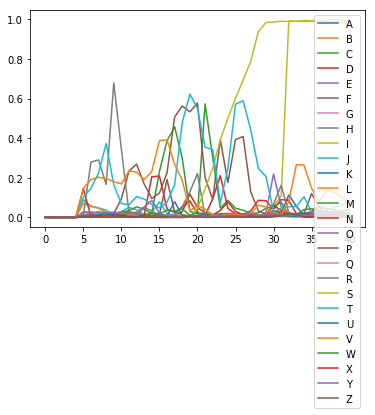

correct: 383 total: 401 accuracy: 0.955 avgEditDist 0.050
('A', 'A'): 171
('S', 'S'): 89
('E', 'E'): 196
('T', 'T'): 88
('H', 'H'): 68
('D', 'D'): 87
('K', 'K'): 33
('N', 'N'): 109
('L', 'L'): 89
('R', 'R'): 136
('O', 'O'): 117
('V', 'V'): 76
('B', 'B'): 27
('C', 'C'): 49
('G', 'G'): 40
('P', 'P'): 40
('I', 'I'): 76
('F', 'F'): 20
('W', 'W'): 30
-------('H', 'R'): 1
('U', 'U'): 27
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 19
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.0015364  0.00075355 0.00141772 ... 0.00133941 0.02924606 0.00103401]
 [0.00186538 0.00098526 0.00132875 ... 0.00148279 0.02650869 0.00118955]
 [0.00217837 0.00110302 0.00147424 ... 0.00158002 0.0250582  0.0013012 ]
 ...
 [0.00312515 0.00191934 0.0029421  ... 0.00220582 0.03207522 0.00281409]
 [0.00299844 0.00196088 0.00294091 ... 0.0021971  0.03056903 0.00292062]
 [0.00278286 0.001837

[[0.00264378 0.00095959 0.00222306 ... 0.00250096 0.059288   0.00085461]
 [0.0032008  0.00111004 0.00272726 ... 0.00267249 0.04612429 0.0011233 ]
 [0.00391313 0.00121156 0.00316065 ... 0.00290209 0.04334505 0.00138733]
 ...
 [0.00327246 0.00225275 0.0011775  ... 0.00185305 0.02586235 0.00193915]
 [0.003149   0.00212969 0.0013811  ... 0.00254547 0.02668131 0.00244639]
 [0.00294328 0.00203144 0.0013158  ... 0.0022646  0.0266808  0.00236663]]
--pred for 0 20 ['S 0.68 ', 'V 0.23 ', 'J 0.16 ', 'L 0.07 ', 'T 0.06 ']
--pred for 0 24 ['S 0.91 ', 'V 0.21 ', 'J 0.10 ', 'T 0.07 ', 'L 0.06 ']
--pred for 0 28 ['S 0.96 ', 'V 0.19 ', 'T 0.07 ', 'L 0.06 ', 'J 0.05 ']
--pred for 0 32 ['S 0.98 ', 'V 0.17 ', 'T 0.08 ', 'L 0.06 ', 'Y 0.05 ']
--pred for 0 36 ['S 0.99 ', 'V 0.23 ', 'T 0.07 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 40 ['S 0.99 ', 'V 0.15 ', 'J 0.12 ', 'T 0.06 ', 'L 0.05 ']
--pred for 0 44 ['S 0.99 ', 'J 0.30 ', 'V 0.09 ', 'T 0.05 ', 'H 0.04 ']
--pred for 0 48 ['S 0.99 ', 'J 0.15 ', 'V 0.11 ', 'I

WTVE WTVE
edit distance: 0
correct: 386 total: 404 accuracy: 0.955 avgEditDist 0.050
('A', 'A'): 173
('S', 'S'): 91
('E', 'E'): 199
('T', 'T'): 91
('H', 'H'): 68
('D', 'D'): 87
('K', 'K'): 33
('N', 'N'): 111
('L', 'L'): 89
('R', 'R'): 137
('O', 'O'): 117
('V', 'V'): 77
('B', 'B'): 27
('C', 'C'): 49
('G', 'G'): 40
('P', 'P'): 40
('I', 'I'): 76
('F', 'F'): 21
('W', 'W'): 31
-------('H', 'R'): 1
('U', 'U'): 27
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 19
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00225583 0.00173978 0.00210685 ... 0.0016548  0.04142351 0.00086958]
 [0.00296459 0.0020994  0.00297296 ... 0.00205657 0.03504211 0.00155888]
 [0.00337741 0.00216332 0.00318413 ... 0.00210345 0.03580451 0.00156578]
 ...
 [0.00289303 0.00206754 0.00128882 ... 0.00224336 0.02432935 0.00273623]
 [0.0026682  0.00186    0.00131997 ... 0.00207076 0.02473043 0.0022

RSA RSA
edit distance: 0
correct: 388 total: 406 accuracy: 0.956 avgEditDist 0.049
('A', 'A'): 174
('S', 'S'): 92
('E', 'E'): 200
('T', 'T'): 92
('H', 'H'): 69
('D', 'D'): 87
('K', 'K'): 33
('N', 'N'): 111
('L', 'L'): 89
('R', 'R'): 139
('O', 'O'): 117
('V', 'V'): 77
('B', 'B'): 27
('C', 'C'): 49
('G', 'G'): 40
('P', 'P'): 40
('I', 'I'): 77
('F', 'F'): 21
('W', 'W'): 31
-------('H', 'R'): 1
('U', 'U'): 27
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 19
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00314631 0.00215801 0.00294606 ... 0.00234131 0.04152906 0.00152594]
 [0.00330797 0.00228304 0.00318589 ... 0.00256381 0.03581954 0.00181198]
 [0.00354463 0.00231718 0.0033362  ... 0.00237651 0.03810283 0.00181138]
 ...
 [0.00244815 0.00184396 0.00144971 ... 0.00292351 0.039433   0.00129527]
 [0.00197962 0.00166751 0.00140522 ... 0.00265521 0.03479826 0.001184

GHEVLU GHEVLU
edit distance: 0
correct: 390 total: 408 accuracy: 0.956 avgEditDist 0.049
('A', 'A'): 174
('S', 'S'): 92
('E', 'E'): 202
('T', 'T'): 92
('H', 'H'): 70
('D', 'D'): 87
('K', 'K'): 33
('N', 'N'): 112
('L', 'L'): 90
('R', 'R'): 139
('O', 'O'): 117
('V', 'V'): 78
('B', 'B'): 27
('C', 'C'): 50
('G', 'G'): 42
('P', 'P'): 40
('I', 'I'): 77
('F', 'F'): 21
('W', 'W'): 31
-------('H', 'R'): 1
('U', 'U'): 28
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 19
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00285828 0.00099952 0.00235137 ... 0.00283432 0.04896924 0.00087833]
 [0.00400156 0.00125415 0.00321618 ... 0.00277031 0.04466882 0.00124899]
 [0.00444963 0.00132248 0.00334138 ... 0.00266595 0.04947867 0.00134411]
 ...
 [0.00129585 0.0017142  0.00242395 ... 0.00242787 0.02290522 0.00205415]
 [0.0012765  0.0016948  0.00248957 ... 0.00254127 0.02049963 0.

CTH CTH
edit distance: 0
correct: 392 total: 410 accuracy: 0.956 avgEditDist 0.049
('A', 'A'): 174
('S', 'S'): 93
('E', 'E'): 202
('T', 'T'): 93
('H', 'H'): 71
('D', 'D'): 87
('K', 'K'): 34
('N', 'N'): 112
('L', 'L'): 90
('R', 'R'): 139
('O', 'O'): 117
('V', 'V'): 78
('B', 'B'): 27
('C', 'C'): 51
('G', 'G'): 42
('P', 'P'): 41
('I', 'I'): 77
('F', 'F'): 21
('W', 'W'): 32
-------('H', 'R'): 1
('U', 'U'): 28
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 19
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[1.90080807e-03 1.14834029e-03 1.49321544e-03 1.65598858e-02
  3.52309039e-03 2.21381406e-03 2.95172143e-03 1.50606118e-03
  8.04910157e-03 2.09756801e-03 1.55362384e-02 6.94012688e-03
  3.53729397e-01 1.37653586e-03 3.00080311e-02 6.24032505e-03
  3.09304823e-03 3.15933744e-03 3.64712346e-03 2.33357796e-03
  4.64334432e-03 2.01910222e-03 9.10751641e-01 9.5069464

ERIPCF ERIPCF
edit distance: 0
correct: 394 total: 412 accuracy: 0.956 avgEditDist 0.049
('A', 'A'): 174
('S', 'S'): 93
('E', 'E'): 203
('T', 'T'): 94
('H', 'H'): 71
('D', 'D'): 87
('K', 'K'): 34
('N', 'N'): 112
('L', 'L'): 90
('R', 'R'): 141
('O', 'O'): 117
('V', 'V'): 78
('B', 'B'): 27
('C', 'C'): 52
('G', 'G'): 42
('P', 'P'): 42
('I', 'I'): 78
('F', 'F'): 22
('W', 'W'): 32
-------('H', 'R'): 1
('U', 'U'): 28
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 19
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00121993 0.00092765 0.00127205 ... 0.00158379 0.04209686 0.00056519]
 [0.00146633 0.00107852 0.00144584 ... 0.00220571 0.04149923 0.00064081]
 [0.00142572 0.00109253 0.00145846 ... 0.0023636  0.03866722 0.00069915]
 ...
 [0.00101098 0.00067463 0.001306   ... 0.00112205 0.01870741 0.00069099]
 [0.00137262 0.00094865 0.00160967 ... 0.00130031 0.02637024 0.

[[0.00206082 0.00141474 0.00213584 ... 0.00103183 0.0323363  0.00117844]
 [0.00181985 0.001678   0.00291149 ... 0.00151963 0.03740053 0.00276177]
 [0.00189751 0.00180662 0.00311946 ... 0.00163109 0.04105766 0.00300202]
 ...
 [0.00297429 0.00195173 0.00313302 ... 0.00200999 0.03322076 0.00153565]
 [0.00296106 0.00198993 0.00317531 ... 0.00199342 0.03263314 0.00159022]
 [0.00270194 0.00148534 0.00244895 ... 0.00160463 0.02835104 0.00175539]]
--pred for 0 20 ['T 0.24 ', 'V 0.09 ', 'L 0.08 ', 'J 0.05 ', 'I 0.04 ']
--pred for 0 24 ['T 0.18 ', 'D 0.15 ', 'V 0.11 ', 'E 0.09 ', 'L 0.07 ']
--pred for 0 28 ['D 0.22 ', 'E 0.20 ', 'T 0.15 ', 'V 0.13 ', 'L 0.09 ']
--pred for 0 32 ['C 0.70 ', 'D 0.15 ', 'V 0.14 ', 'T 0.13 ', 'L 0.11 ']
--pred for 0 36 ['D 0.94 ', 'V 0.13 ', 'T 0.12 ', 'L 0.06 ', 'C 0.06 ']
--pred for 0 40 ['D 0.99 ', 'T 0.12 ', 'V 0.12 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 44 ['D 0.99 ', 'T 0.12 ', 'V 0.11 ', 'L 0.05 ', 'A 0.04 ']
--pred for 0 48 ['D 0.99 ', 'I 0.96 ', 'V 0.16 ', 'T

AOONST AOONST
edit distance: 0
correct: 397 total: 415 accuracy: 0.957 avgEditDist 0.048
('A', 'A'): 175
('S', 'S'): 94
('E', 'E'): 205
('T', 'T'): 95
('H', 'H'): 71
('D', 'D'): 88
('K', 'K'): 34
('N', 'N'): 114
('L', 'L'): 90
('R', 'R'): 142
('O', 'O'): 120
('V', 'V'): 80
('B', 'B'): 27
('C', 'C'): 52
('G', 'G'): 43
('P', 'P'): 42
('I', 'I'): 79
('F', 'F'): 23
('W', 'W'): 32
-------('H', 'R'): 1
('U', 'U'): 28
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 19
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.0008439  0.00084014 0.00139596 ... 0.00092701 0.02191413 0.00037684]
 [0.00091567 0.00096273 0.00144632 ... 0.00115207 0.01916044 0.00042858]
 [0.0008868  0.00093627 0.00146037 ... 0.00130154 0.0184858  0.00045745]
 ...
 [0.0012896  0.00166035 0.00260557 ... 0.0023151  0.03133077 0.00196905]
 [0.00121416 0.0015668  0.00238936 ... 0.00244989 0.0300359  0.

NEAAN NEAAN
edit distance: 0
correct: 399 total: 417 accuracy: 0.957 avgEditDist 0.048
('A', 'A'): 177
('S', 'S'): 94
('E', 'E'): 206
('T', 'T'): 95
('H', 'H'): 71
('D', 'D'): 88
('K', 'K'): 34
('N', 'N'): 116
('L', 'L'): 90
('R', 'R'): 143
('O', 'O'): 120
('V', 'V'): 81
('B', 'B'): 27
('C', 'C'): 52
('G', 'G'): 43
('P', 'P'): 43
('I', 'I'): 79
('F', 'F'): 23
('W', 'W'): 32
-------('H', 'R'): 1
('U', 'U'): 28
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 20
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00111466 0.00094029 0.001548   ... 0.00098538 0.02819085 0.00052585]
 [0.00098118 0.00094105 0.00150279 ... 0.001051   0.01878378 0.00043561]
 [0.00105928 0.00099591 0.00153515 ... 0.00103898 0.01847881 0.00044456]
 ...
 [0.00186301 0.00094616 0.00144733 ... 0.00124907 0.01610825 0.00109581]
 [0.00149466 0.00084437 0.0013855  ... 0.00102234 0.01746193 0.00

PUA PUA
edit distance: 0
correct: 401 total: 419 accuracy: 0.957 avgEditDist 0.048
('A', 'A'): 179
('S', 'S'): 94
('E', 'E'): 206
('T', 'T'): 96
('H', 'H'): 71
('D', 'D'): 88
('K', 'K'): 34
('N', 'N'): 116
('L', 'L'): 90
('R', 'R'): 143
('O', 'O'): 120
('V', 'V'): 81
('B', 'B'): 27
('C', 'C'): 52
('G', 'G'): 43
('P', 'P'): 44
('I', 'I'): 79
('F', 'F'): 23
('W', 'W'): 32
-------('H', 'R'): 1
('U', 'U'): 29
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 21
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.0016804  0.00105766 0.00168129 ... 0.00106584 0.0223683  0.00069769]
 [0.00189496 0.00109016 0.00155756 ... 0.00136711 0.02497618 0.0008111 ]
 [0.00192398 0.00110704 0.00168089 ... 0.00170681 0.02806882 0.00083917]
 ...
 [0.0034351  0.00189821 0.00307873 ... 0.00207056 0.03202127 0.00204358]
 [0.003278   0.00185959 0.00303363 ... 0.00203842 0.03333214 0.001922

DC DC
edit distance: 0
correct: 403 total: 421 accuracy: 0.957 avgEditDist 0.048
('A', 'A'): 181
('S', 'S'): 94
('E', 'E'): 207
('T', 'T'): 96
('H', 'H'): 71
('D', 'D'): 89
('K', 'K'): 35
('N', 'N'): 116
('L', 'L'): 90
('R', 'R'): 143
('O', 'O'): 120
('V', 'V'): 81
('B', 'B'): 27
('C', 'C'): 54
('G', 'G'): 43
('P', 'P'): 44
('I', 'I'): 79
('F', 'F'): 23
('W', 'W'): 33
-------('H', 'R'): 1
('U', 'U'): 29
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 21
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00123969 0.00056354 0.00112461 ... 0.00107762 0.04550833 0.00070065]
 [0.0013521  0.00056316 0.00109735 ... 0.00148516 0.0474751  0.00074766]
 [0.00147303 0.00059427 0.00116072 ... 0.00169715 0.03560349 0.00085293]
 ...
 [0.00318706 0.00173581 0.0028641  ... 0.0021777  0.02723647 0.00254325]
 [0.00278375 0.00164803 0.00258213 ... 0.00202011 0.02519513 0.00351765

PESEAD PESEAD
edit distance: 0
correct: 405 total: 423 accuracy: 0.957 avgEditDist 0.047
('A', 'A'): 183
('S', 'S'): 95
('E', 'E'): 210
('T', 'T'): 96
('H', 'H'): 71
('D', 'D'): 90
('K', 'K'): 35
('N', 'N'): 116
('L', 'L'): 90
('R', 'R'): 143
('O', 'O'): 120
('V', 'V'): 82
('B', 'B'): 27
('C', 'C'): 54
('G', 'G'): 43
('P', 'P'): 45
('I', 'I'): 79
('F', 'F'): 23
('W', 'W'): 33
-------('H', 'R'): 1
('U', 'U'): 29
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 21
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.0015908  0.00091107 0.00148925 ... 0.00087619 0.0303775  0.00061307]
 [0.00171837 0.0009341  0.00139892 ... 0.00147801 0.0302722  0.00068838]
 [0.00206157 0.00115704 0.00185064 ... 0.00149393 0.03770724 0.00092266]
 ...
 [0.00188241 0.00088798 0.00160524 ... 0.00155368 0.02207897 0.00091712]
 [0.00191181 0.00089677 0.00164584 ... 0.00152013 0.0239763  0.

VAOGO VAOGO
edit distance: 0
correct: 407 total: 425 accuracy: 0.958 avgEditDist 0.047
('A', 'A'): 185
('S', 'S'): 95
('E', 'E'): 210
('T', 'T'): 96
('H', 'H'): 71
('D', 'D'): 90
('K', 'K'): 35
('N', 'N'): 117
('L', 'L'): 90
('R', 'R'): 145
('O', 'O'): 122
('V', 'V'): 83
('B', 'B'): 27
('C', 'C'): 54
('G', 'G'): 44
('P', 'P'): 45
('I', 'I'): 79
('F', 'F'): 23
('W', 'W'): 33
-------('H', 'R'): 1
('U', 'U'): 29
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 21
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00125544 0.00096577 0.00155993 ... 0.00096903 0.03018599 0.00051618]
 [0.00100917 0.00090132 0.00161288 ... 0.00114958 0.02441771 0.0005297 ]
 [0.00109771 0.00091584 0.00160722 ... 0.00122491 0.02161336 0.00054767]
 ...
 [0.00150603 0.00136057 0.00263778 ... 0.00388838 0.02451581 0.00119593]
 [0.00143833 0.00118767 0.00240378 ... 0.0040603  0.02400686 0.00

[[0.00223954 0.00082131 0.00174249 ... 0.00179582 0.07599336 0.00081246]
 [0.00275293 0.00094472 0.0021633  ... 0.00234117 0.07030584 0.0009358 ]
 [0.00333333 0.00109977 0.0026458  ... 0.0030177  0.05661778 0.00123096]
 ...
 [0.00175882 0.0012259  0.00224896 ... 0.00296669 0.02482981 0.0014942 ]
 [0.00150816 0.00110953 0.00207887 ... 0.00270032 0.0205663  0.00150766]
 [0.00171326 0.00110154 0.00200473 ... 0.00273911 0.01813251 0.00101155]]
--pred for 0 20 ['V 0.23 ', 'S 0.21 ', 'Y 0.08 ', 'L 0.08 ', 'T 0.06 ']
--pred for 0 24 ['S 0.70 ', 'V 0.24 ', 'Y 0.07 ', 'L 0.06 ', 'T 0.06 ']
--pred for 0 28 ['S 0.89 ', 'V 0.19 ', 'T 0.09 ', 'Y 0.06 ', 'L 0.05 ']
--pred for 0 32 ['S 0.98 ', 'V 0.15 ', 'T 0.10 ', 'J 0.07 ', 'L 0.05 ']
--pred for 0 36 ['S 0.98 ', 'V 0.19 ', 'T 0.09 ', 'L 0.05 ', 'J 0.04 ']
--pred for 0 40 ['S 0.99 ', 'V 0.19 ', 'T 0.14 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 44 ['S 0.99 ', 'V 0.22 ', 'T 0.21 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 48 ['S 0.99 ', 'T 0.27 ', 'V 0.16 ', 'Y

[[0.00240502 0.00185906 0.00215829 ... 0.00204002 0.04057793 0.00100724]
 [0.00330553 0.0021761  0.00310532 ... 0.00225078 0.03603281 0.001564  ]
 [0.003486   0.00218315 0.00316319 ... 0.00222819 0.03360007 0.00162342]
 ...
 [0.00341832 0.00192455 0.00292034 ... 0.00248424 0.02809265 0.00225639]
 [0.00339459 0.00200411 0.00294202 ... 0.00241165 0.027582   0.00196347]
 [0.00305017 0.00180974 0.00262959 ... 0.00205477 0.02874638 0.00172769]]
--pred for 0 20 ['E 0.78 ', 'V 0.17 ', 'J 0.13 ', 'T 0.04 ', 'Y 0.04 ']
--pred for 0 24 ['E 0.99 ', 'V 0.13 ', 'T 0.07 ', 'J 0.05 ', 'L 0.04 ']
--pred for 0 28 ['E 0.99 ', 'V 0.12 ', 'T 0.08 ', 'L 0.04 ', 'J 0.04 ']
--pred for 0 32 ['E 0.99 ', 'V 0.11 ', 'T 0.08 ', 'L 0.04 ', 'A 0.04 ']
--pred for 0 36 ['E 0.99 ', 'V 0.13 ', 'T 0.10 ', 'L 0.04 ', 'Y 0.04 ']
--pred for 0 40 ['E 0.99 ', 'V 0.16 ', 'T 0.10 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 44 ['E 0.99 ', 'V 0.19 ', 'T 0.10 ', 'L 0.08 ', 'Y 0.04 ']
--pred for 0 48 ['E 0.99 ', 'V 0.20 ', 'L 0.09 ', 'T

ELAOSR ELAOSR
edit distance: 0
correct: 411 total: 429 accuracy: 0.958 avgEditDist 0.047
('A', 'A'): 188
('S', 'S'): 97
('E', 'E'): 214
('T', 'T'): 98
('H', 'H'): 72
('D', 'D'): 91
('K', 'K'): 35
('N', 'N'): 119
('L', 'L'): 91
('R', 'R'): 146
('O', 'O'): 126
('V', 'V'): 83
('B', 'B'): 27
('C', 'C'): 55
('G', 'G'): 44
('P', 'P'): 45
('I', 'I'): 80
('F', 'F'): 23
('W', 'W'): 33
-------('H', 'R'): 1
('U', 'U'): 29
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 21
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00159595 0.00081844 0.00148889 ... 0.00120532 0.02623221 0.00106971]
 [0.00203288 0.00106326 0.00148978 ... 0.00139215 0.02463614 0.00121633]
 [0.00237631 0.00121679 0.00164774 ... 0.00157538 0.02230151 0.00135955]
 ...
 [0.00287034 0.00194012 0.00295846 ... 0.00188791 0.02660397 0.00161874]
 [0.00296384 0.00195772 0.0030484  ... 0.00203623 0.02631107 0.

CE CE
edit distance: 0
correct: 413 total: 431 accuracy: 0.958 avgEditDist 0.046
('A', 'A'): 188
('S', 'S'): 97
('E', 'E'): 217
('T', 'T'): 99
('H', 'H'): 73
('D', 'D'): 91
('K', 'K'): 35
('N', 'N'): 119
('L', 'L'): 91
('R', 'R'): 147
('O', 'O'): 126
('V', 'V'): 83
('B', 'B'): 27
('C', 'C'): 56
('G', 'G'): 45
('P', 'P'): 45
('I', 'I'): 80
('F', 'F'): 23
('W', 'W'): 33
-------('H', 'R'): 1
('U', 'U'): 29
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 21
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[1.38849288e-03 9.56142205e-04 1.37183350e-03 6.99393591e-03
  4.22318745e-03 2.15151720e-03 1.37337088e-03 1.73091851e-02
  8.01525358e-03 1.60403817e-03 2.00598016e-01 3.81570635e-03
  1.67246923e-01 3.77985300e-03 2.44861525e-02 4.52672085e-03
  2.12448905e-03 4.84736450e-03 1.60785078e-03 1.98718323e-03
  1.62015564e-03 1.41693756e-03 4.85619418e-02 9.32678860e

TOFRC TOFRC
edit distance: 0
correct: 415 total: 433 accuracy: 0.958 avgEditDist 0.046
('A', 'A'): 188
('S', 'S'): 97
('E', 'E'): 218
('T', 'T'): 100
('H', 'H'): 74
('D', 'D'): 91
('K', 'K'): 35
('N', 'N'): 119
('L', 'L'): 91
('R', 'R'): 148
('O', 'O'): 127
('V', 'V'): 83
('B', 'B'): 27
('C', 'C'): 57
('G', 'G'): 45
('P', 'P'): 45
('I', 'I'): 80
('F', 'F'): 24
('W', 'W'): 33
-------('H', 'R'): 1
('U', 'U'): 29
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 21
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00288766 0.00199469 0.0028716  ... 0.00199628 0.04408241 0.00141934]
 [0.00318978 0.00209535 0.00310388 ... 0.00219144 0.03498935 0.00155545]
 [0.00345234 0.00221564 0.00317464 ... 0.00227811 0.03715356 0.00166708]
 ...
 [0.00144447 0.00176146 0.00131782 ... 0.00781938 0.01735535 0.00102402]
 [0.00157962 0.00160419 0.00123719 ... 0.00738299 0.01976798 0.0

HG HG
edit distance: 0
correct: 417 total: 435 accuracy: 0.959 avgEditDist 0.046
('A', 'A'): 188
('S', 'S'): 97
('E', 'E'): 219
('T', 'T'): 100
('H', 'H'): 75
('D', 'D'): 92
('K', 'K'): 35
('N', 'N'): 119
('L', 'L'): 91
('R', 'R'): 148
('O', 'O'): 127
('V', 'V'): 84
('B', 'B'): 27
('C', 'C'): 57
('G', 'G'): 46
('P', 'P'): 45
('I', 'I'): 81
('F', 'F'): 24
('W', 'W'): 33
-------('H', 'R'): 1
('U', 'U'): 29
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 21
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00124397 0.00083071 0.00125784 ... 0.00246401 0.04313742 0.0005234 ]
 [0.00136598 0.0008261  0.00126353 ... 0.00304593 0.03201829 0.00054329]
 [0.00140939 0.00085364 0.00128822 ... 0.00351887 0.0270353  0.00056592]
 ...
 [0.00303923 0.00168983 0.00282856 ... 0.00181618 0.02884299 0.00211762]
 [0.00268421 0.00164937 0.0025553  ... 0.00183158 0.02557371 0.0025648

TNES TNES
edit distance: 0
correct: 419 total: 437 accuracy: 0.959 avgEditDist 0.046
('A', 'A'): 188
('S', 'S'): 98
('E', 'E'): 221
('T', 'T'): 101
('H', 'H'): 75
('D', 'D'): 92
('K', 'K'): 35
('N', 'N'): 121
('L', 'L'): 92
('R', 'R'): 148
('O', 'O'): 127
('V', 'V'): 84
('B', 'B'): 27
('C', 'C'): 57
('G', 'G'): 46
('P', 'P'): 45
('I', 'I'): 81
('F', 'F'): 25
('W', 'W'): 33
-------('H', 'R'): 1
('U', 'U'): 29
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 21
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00130985 0.00103016 0.00147386 ... 0.00191031 0.04885105 0.00066833]
 [0.00123569 0.00100901 0.00139536 ... 0.00223586 0.04122351 0.00065962]
 [0.00131971 0.00100199 0.00141695 ... 0.00237816 0.03983682 0.00067643]
 ...
 [0.00172085 0.00094156 0.00138043 ... 0.00112671 0.01345197 0.00093748]
 [0.00154368 0.00093243 0.00133524 ... 0.00105236 0.0146869  0.000

PTDAD PTDAD
edit distance: 0
correct: 421 total: 439 accuracy: 0.959 avgEditDist 0.046
('A', 'A'): 189
('S', 'S'): 98
('E', 'E'): 221
('T', 'T'): 103
('H', 'H'): 75
('D', 'D'): 94
('K', 'K'): 35
('N', 'N'): 121
('L', 'L'): 92
('R', 'R'): 150
('O', 'O'): 127
('V', 'V'): 84
('B', 'B'): 27
('C', 'C'): 57
('G', 'G'): 46
('P', 'P'): 47
('I', 'I'): 81
('F', 'F'): 25
('W', 'W'): 33
-------('H', 'R'): 1
('U', 'U'): 29
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 21
-------('T', '%'): 3
-------('%', 'T'): 2
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00152462 0.0011023  0.00177654 ... 0.00130035 0.02313861 0.00068982]
 [0.00164602 0.0009415  0.0013981  ... 0.00120834 0.02295213 0.00063066]
 [0.00189618 0.0010727  0.00161653 ... 0.00110273 0.02662982 0.00066335]
 ...
 [0.00148098 0.00125094 0.00191635 ... 0.00141007 0.01495442 0.00140872]
 [0.00168213 0.00116505 0.00189038 ... 0.00142297 0.01785564 0.0

[[0.00134528 0.0010396  0.00171142 ... 0.00101152 0.03027496 0.000535  ]
 [0.00125393 0.00100262 0.00176432 ... 0.00129752 0.02633608 0.00060093]
 [0.00131995 0.0010288  0.00175474 ... 0.00131466 0.02318328 0.00060246]
 ...
 [0.00168594 0.00092989 0.0013415  ... 0.00106646 0.01485631 0.0008981 ]
 [0.00148697 0.0009351  0.00122713 ... 0.00094355 0.0153412  0.00071212]
 [0.00170247 0.00086474 0.00148063 ... 0.0011102  0.02156429 0.00083159]]
--pred for 0 20 ['M 0.12 ', 'T 0.09 ', 'V 0.09 ', 'J 0.08 ', 'Y 0.03 ']
--pred for 0 24 ['N 0.17 ', 'M 0.13 ', 'V 0.11 ', 'J 0.08 ', 'T 0.06 ']
--pred for 0 28 ['N 0.30 ', 'V 0.14 ', 'M 0.13 ', 'T 0.05 ', 'J 0.05 ']
--pred for 0 32 ['N 0.90 ', 'V 0.14 ', 'J 0.07 ', 'T 0.04 ', 'A 0.03 ']
--pred for 0 36 ['N 0.93 ', 'V 0.14 ', 'J 0.06 ', 'T 0.04 ', 'A 0.04 ']
--pred for 0 40 ['N 0.98 ', 'V 0.16 ', 'T 0.07 ', 'J 0.06 ', 'A 0.02 ']
--pred for 0 44 ['N 0.99 ', 'V 0.19 ', 'T 0.06 ', 'J 0.03 ', 'L 0.03 ']
--pred for 0 48 ['N 0.99 ', 'V 0.18 ', 'T 0.06 ', 'L

[[0.00133473 0.00099649 0.00158447 ... 0.00095049 0.02853777 0.00052322]
 [0.00096619 0.0009098  0.00150775 ... 0.00101753 0.01866347 0.00041353]
 [0.00105557 0.00095049 0.00153122 ... 0.00110192 0.01756111 0.00045392]
 ...
 [0.00117861 0.00077371 0.0013879  ... 0.00123768 0.03066149 0.00068286]
 [0.00135126 0.00078384 0.00127975 ... 0.00131358 0.02919542 0.00071936]
 [0.00149698 0.00085214 0.0015125  ... 0.00120111 0.03601404 0.0007438 ]]
--pred for 0 20 ['V 0.14 ', 'J 0.12 ', 'M 0.10 ', 'T 0.10 ', 'L 0.04 ']
--pred for 0 24 ['M 0.57 ', 'V 0.10 ', 'T 0.08 ', 'J 0.06 ', 'L 0.02 ']
--pred for 0 28 ['M 0.41 ', 'V 0.12 ', 'J 0.10 ', 'T 0.06 ', 'N 0.03 ']
--pred for 0 32 ['M 0.69 ', 'V 0.16 ', 'J 0.09 ', 'T 0.05 ', 'W 0.03 ']
--pred for 0 36 ['M 0.82 ', 'V 0.17 ', 'J 0.06 ', 'T 0.06 ', 'L 0.03 ']
--pred for 0 40 ['M 0.98 ', 'V 0.15 ', 'T 0.08 ', 'Y 0.03 ', 'L 0.03 ']
--pred for 0 44 ['M 0.98 ', 'V 0.13 ', 'T 0.08 ', 'L 0.03 ', 'Y 0.02 ']
--pred for 0 48 ['M 0.98 ', 'V 0.14 ', 'T 0.09 ', 'L

[[0.00147983 0.00096445 0.00136218 ... 0.00259525 0.04072644 0.00062151]
 [0.00203511 0.00132721 0.00150011 ... 0.00268851 0.03410674 0.00091658]
 [0.00253257 0.00160062 0.00143132 ... 0.00247125 0.0291841  0.00116475]
 ...
 [0.00438765 0.00129369 0.00365193 ... 0.00345613 0.02765795 0.00145614]
 [0.00381314 0.00126829 0.00331501 ... 0.0031394  0.02536386 0.00125331]
 [0.00305883 0.00120854 0.00265322 ... 0.00215656 0.02151932 0.00099911]]
--pred for 0 20 ['F 0.57 ', 'J 0.20 ', 'V 0.13 ', 'T 0.05 ', 'Y 0.04 ']
--pred for 0 24 ['R 0.48 ', 'F 0.32 ', 'V 0.15 ', 'J 0.14 ', 'T 0.04 ']
--pred for 0 28 ['R 0.86 ', 'F 0.19 ', 'V 0.17 ', 'J 0.09 ', 'T 0.04 ']
--pred for 0 32 ['R 0.99 ', 'V 0.17 ', 'T 0.08 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 36 ['R 0.99 ', 'V 0.16 ', 'T 0.08 ', 'L 0.05 ', 'A 0.03 ']
--pred for 0 40 ['R 0.99 ', 'V 0.18 ', 'T 0.07 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 44 ['R 0.99 ', 'J 0.32 ', 'V 0.09 ', 'T 0.05 ', 'L 0.04 ']
--pred for 0 48 ['R 0.99 ', 'J 0.26 ', 'V 0.10 ', 'S

[[0.00219752 0.00082443 0.00171269 ... 0.00153514 0.05753207 0.00079525]
 [0.00286877 0.0009844  0.00240789 ... 0.00203782 0.05022746 0.00101573]
 [0.0035281  0.00113745 0.00291848 ... 0.0025849  0.04923271 0.00119742]
 ...
 [0.00339279 0.00224504 0.00129857 ... 0.00227741 0.02449314 0.00202471]
 [0.00309608 0.00213668 0.00151835 ... 0.00234899 0.02528906 0.00232553]
 [0.00277629 0.00191882 0.00149468 ... 0.00221576 0.02388533 0.00225477]]
--pred for 0 20 ['V 0.26 ', 'S 0.11 ', 'J 0.09 ', 'T 0.07 ', 'L 0.07 ']
--pred for 0 24 ['S 0.82 ', 'V 0.24 ', 'T 0.07 ', 'J 0.06 ', 'L 0.05 ']
--pred for 0 28 ['S 0.93 ', 'V 0.22 ', 'T 0.07 ', 'J 0.06 ', 'L 0.05 ']
--pred for 0 32 ['S 0.98 ', 'V 0.21 ', 'T 0.09 ', 'L 0.06 ', 'Y 0.05 ']
--pred for 0 36 ['S 0.98 ', 'V 0.23 ', 'T 0.09 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 40 ['S 0.99 ', 'V 0.22 ', 'T 0.08 ', 'L 0.06 ', 'U 0.04 ']
--pred for 0 44 ['S 0.98 ', 'I 0.97 ', 'V 0.19 ', 'L 0.04 ', 'T 0.04 ']
--pred for 0 48 ['S 0.99 ', 'I 0.96 ', 'V 0.18 ', 'L

[[0.00169212 0.00079106 0.00150564 ... 0.00127049 0.03704718 0.00097438]
 [0.00212231 0.00109617 0.00155517 ... 0.00163671 0.02818298 0.00129897]
 [0.0021421  0.00105424 0.00160836 ... 0.00146738 0.02815647 0.00133086]
 ...
 [0.0044326  0.00127407 0.00353675 ... 0.0037775  0.03347344 0.00151485]
 [0.00389596 0.00125509 0.00336703 ... 0.00342281 0.03064622 0.00131524]
 [0.00278989 0.00109073 0.00239812 ... 0.00235981 0.02645864 0.00083035]]
--pred for 0 20 ['T 0.62 ', 'V 0.06 ', 'J 0.05 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 24 ['T 0.94 ', 'J 0.09 ', 'V 0.09 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 28 ['T 0.94 ', 'V 0.10 ', 'J 0.05 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 32 ['T 0.97 ', 'V 0.10 ', 'J 0.05 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 36 ['T 0.98 ', 'V 0.11 ', 'L 0.04 ', 'J 0.03 ', 'A 0.03 ']
--pred for 0 40 ['T 0.98 ', 'V 0.12 ', 'L 0.04 ', 'Y 0.03 ', 'A 0.03 ']
--pred for 0 44 ['T 0.99 ', 'V 0.19 ', 'J 0.05 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 48 ['T 0.98 ', 'U 0.20 ', 'V 0.16 ', 'W

TIWKVT ITWKVT
edit distance: 2


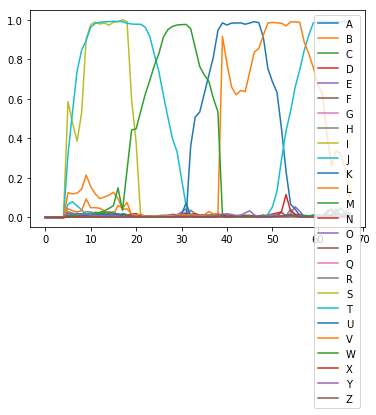

correct: 432 total: 451 accuracy: 0.958 avgEditDist 0.049
('A', 'A'): 193
('S', 'S'): 103
('E', 'E'): 223
('T', 'T'): 107
('H', 'H'): 75
('D', 'D'): 96
('K', 'K'): 37
('N', 'N'): 125
('L', 'L'): 95
('R', 'R'): 155
('O', 'O'): 129
('V', 'V'): 87
('B', 'B'): 28
('C', 'C'): 58
('G', 'G'): 46
('P', 'P'): 48
('I', 'I'): 82
('F', 'F'): 25
('W', 'W'): 36
-------('H', 'R'): 1
('U', 'U'): 29
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 22
-------('T', '%'): 4
-------('%', 'T'): 3
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00316161 0.00211098 0.00314675 ... 0.00237485 0.03487129 0.00164455]
 [0.00335966 0.00226201 0.00331184 ... 0.00241892 0.0354465  0.00176462]
 [0.00352588 0.00223389 0.0034131  ... 0.00241568 0.03186367 0.00177489]
 ...
 [0.00167431 0.00109094 0.00174781 ... 0.00168784 0.0259083  0.00060363]
 [0.00160956 0.0010034  0.00165124 ... 0.00158055 0.02636585 0.00053827]
 [0.00174329 0.0011

EALC EALC
edit distance: 0
correct: 434 total: 453 accuracy: 0.958 avgEditDist 0.049
('A', 'A'): 194
('S', 'S'): 103
('E', 'E'): 225
('T', 'T'): 107
('H', 'H'): 75
('D', 'D'): 96
('K', 'K'): 37
('N', 'N'): 125
('L', 'L'): 96
('R', 'R'): 155
('O', 'O'): 130
('V', 'V'): 87
('B', 'B'): 28
('C', 'C'): 59
('G', 'G'): 47
('P', 'P'): 48
('I', 'I'): 82
('F', 'F'): 25
('W', 'W'): 36
-------('H', 'R'): 1
('U', 'U'): 30
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 22
-------('T', '%'): 4
-------('%', 'T'): 3
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[2.03048764e-03 1.87237025e-03 1.33082736e-03 3.33688259e-02
  4.03478602e-03 1.60389068e-03 1.67410844e-03 2.35446147e-03
  7.57922465e-03 2.36886297e-03 3.97841111e-02 9.87737298e-01
  5.16505599e-01 1.55782315e-03 6.65182620e-02 8.85145366e-03
  7.09906593e-03 3.88918445e-03 2.53630290e-03 2.15117540e-03
  1.92240882e-03 1.65206217e-03 2.00794488e-01 1.175

IL IL
edit distance: 0
correct: 435 total: 454 accuracy: 0.958 avgEditDist 0.048
('A', 'A'): 194
('S', 'S'): 103
('E', 'E'): 225
('T', 'T'): 107
('H', 'H'): 75
('D', 'D'): 96
('K', 'K'): 37
('N', 'N'): 125
('L', 'L'): 97
('R', 'R'): 155
('O', 'O'): 130
('V', 'V'): 87
('B', 'B'): 28
('C', 'C'): 59
('G', 'G'): 47
('P', 'P'): 48
('I', 'I'): 83
('F', 'F'): 25
('W', 'W'): 36
-------('H', 'R'): 1
('U', 'U'): 30
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 22
-------('T', '%'): 4
-------('%', 'T'): 3
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00155265 0.00077783 0.00128077 ... 0.0010069  0.02989605 0.00103116]
 [0.00196624 0.0010021  0.00142983 ... 0.00148691 0.02636251 0.00112914]
 [0.00197654 0.00096443 0.0014542  ... 0.00135294 0.02690607 0.00115174]
 ...
 [0.00314986 0.00197463 0.00306884 ... 0.00186773 0.02972102 0.00163146]
 [0.00255878 0.00151326 0.00240483 ... 0.00144192 0.02178055 0.002349

TRTTRGE TRTRGE
edit distance: 1


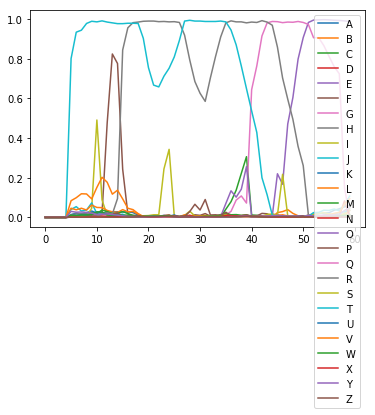

correct: 435 total: 455 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 194
('S', 'S'): 103
('E', 'E'): 226
('T', 'T'): 109
('H', 'H'): 75
('D', 'D'): 96
('K', 'K'): 37
('N', 'N'): 125
('L', 'L'): 97
('R', 'R'): 157
('O', 'O'): 130
('V', 'V'): 87
('B', 'B'): 28
('C', 'C'): 59
('G', 'G'): 48
('P', 'P'): 48
('I', 'I'): 83
('F', 'F'): 25
('W', 'W'): 36
-------('H', 'R'): 1
('U', 'U'): 30
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 22
-------('T', '%'): 5
-------('%', 'T'): 3
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00190081 0.00114834 0.00149322 ... 0.00162069 0.02214628 0.00112686]
 [0.00215026 0.00116615 0.00151099 ... 0.00158552 0.02479303 0.00172544]
 [0.00236308 0.00122509 0.00163477 ... 0.00149311 0.02455683 0.00184936]
 ...
 [0.00236534 0.00152516 0.00275913 ... 0.00328273 0.03701362 0.00192237]
 [0.00203203 0.00125079 0.00240563 ... 0.00305614 0.03022115 0.00163147]
 [0.00181148 0.0011

TIPWN ITPWN
edit distance: 2


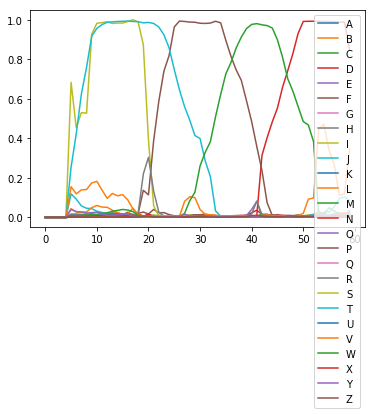

correct: 436 total: 457 accuracy: 0.954 avgEditDist 0.055
('A', 'A'): 194
('S', 'S'): 103
('E', 'E'): 226
('T', 'T'): 111
('H', 'H'): 75
('D', 'D'): 96
('K', 'K'): 37
('N', 'N'): 126
('L', 'L'): 97
('R', 'R'): 157
('O', 'O'): 130
('V', 'V'): 87
('B', 'B'): 28
('C', 'C'): 60
('G', 'G'): 48
('P', 'P'): 49
('I', 'I'): 84
('F', 'F'): 25
('W', 'W'): 37
-------('H', 'R'): 1
('U', 'U'): 30
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 22
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.0012195  0.00056516 0.00112224 ... 0.00110686 0.04413953 0.0007057 ]
 [0.00139562 0.00057721 0.00111648 ... 0.00152543 0.04249267 0.0007879 ]
 [0.00148891 0.00062632 0.00129679 ... 0.00179017 0.03713263 0.00091523]
 ...
 [0.00124503 0.00076414 0.00140388 ... 0.00104225 0.04503064 0.00072942]
 [0.00130896 0.00073787 0.0013421  ... 0.00090779 0.08129285 0.00079379]
 [0.0014473  0.0006

DASIK DASIK
edit distance: 0
correct: 438 total: 459 accuracy: 0.954 avgEditDist 0.054
('A', 'A'): 196
('S', 'S'): 105
('E', 'E'): 226
('T', 'T'): 111
('H', 'H'): 75
('D', 'D'): 97
('K', 'K'): 38
('N', 'N'): 126
('L', 'L'): 97
('R', 'R'): 158
('O', 'O'): 130
('V', 'V'): 89
('B', 'B'): 28
('C', 'C'): 60
('G', 'G'): 48
('P', 'P'): 49
('I', 'I'): 85
('F', 'F'): 25
('W', 'W'): 37
-------('H', 'R'): 1
('U', 'U'): 30
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 22
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00166003 0.00105737 0.0018099  ... 0.00105912 0.0232192  0.00148291]
 [0.00162593 0.00107465 0.00189472 ... 0.00118178 0.02447771 0.0017452 ]
 [0.00179333 0.00113916 0.0019678  ... 0.00139469 0.0282446  0.00180637]
 ...
 [0.00319997 0.00213824 0.00136964 ... 0.00224628 0.02930043 0.0023535 ]
 [0.00291612 0.00182465 0.00134607 ... 0.00237779 0.02836884 0.

WK WK
edit distance: 0
correct: 440 total: 461 accuracy: 0.954 avgEditDist 0.054
('A', 'A'): 196
('S', 'S'): 105
('E', 'E'): 227
('T', 'T'): 111
('H', 'H'): 75
('D', 'D'): 98
('K', 'K'): 39
('N', 'N'): 127
('L', 'L'): 98
('R', 'R'): 159
('O', 'O'): 130
('V', 'V'): 89
('B', 'B'): 28
('C', 'C'): 60
('G', 'G'): 48
('P', 'P'): 49
('I', 'I'): 85
('F', 'F'): 25
('W', 'W'): 38
-------('H', 'R'): 1
('U', 'U'): 30
-------('I', '%'): 4
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 22
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00134913 0.0008637  0.00134509 ... 0.00097092 0.0319437  0.00068288]
 [0.00165778 0.0013859  0.00181624 ... 0.00141903 0.02731761 0.00097584]
 [0.00167931 0.00146428 0.00181294 ... 0.00149087 0.03153146 0.00099929]
 ...
 [0.0014834  0.00172233 0.00159887 ... 0.00104425 0.01642134 0.00135753]
 [0.00150581 0.00150248 0.00145843 ... 0.00101345 0.01926097 0.001093

VICIV VICV
edit distance: 1


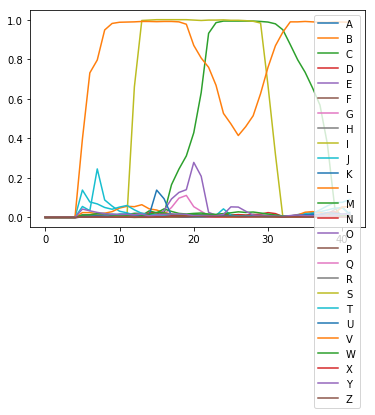

correct: 441 total: 463 accuracy: 0.952 avgEditDist 0.056
('A', 'A'): 196
('S', 'S'): 106
('E', 'E'): 227
('T', 'T'): 111
('H', 'H'): 76
('D', 'D'): 98
('K', 'K'): 39
('N', 'N'): 128
('L', 'L'): 99
('R', 'R'): 159
('O', 'O'): 130
('V', 'V'): 91
('B', 'B'): 28
('C', 'C'): 61
('G', 'G'): 48
('P', 'P'): 49
('I', 'I'): 87
('F', 'F'): 26
('W', 'W'): 38
-------('H', 'R'): 1
('U', 'U'): 30
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 22
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00139815 0.00058478 0.0011742  ... 0.00130806 0.06771134 0.00075368]
 [0.00135255 0.00056037 0.0011407  ... 0.00136363 0.04302995 0.00085628]
 [0.00145428 0.00068112 0.00140096 ... 0.00182748 0.0252639  0.00104702]
 ...
 [0.00169629 0.00214189 0.0030363  ... 0.00328841 0.02711757 0.0012058 ]
 [0.00168142 0.00165255 0.00297613 ... 0.00401358 0.02820836 0.0011337 ]
 [0.00168004 0.0015

NOHAA NOHAA
edit distance: 0
correct: 443 total: 465 accuracy: 0.953 avgEditDist 0.056
('A', 'A'): 199
('S', 'S'): 106
('E', 'E'): 227
('T', 'T'): 111
('H', 'H'): 77
('D', 'D'): 99
('K', 'K'): 39
('N', 'N'): 129
('L', 'L'): 99
('R', 'R'): 159
('O', 'O'): 131
('V', 'V'): 92
('B', 'B'): 28
('C', 'C'): 61
('G', 'G'): 48
('P', 'P'): 49
('I', 'I'): 87
('F', 'F'): 26
('W', 'W'): 38
-------('H', 'R'): 1
('U', 'U'): 30
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 22
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[1.64506957e-03 9.81772202e-04 1.43030030e-03 3.73365823e-03
  7.48449098e-03 1.01372611e-03 1.22008484e-03 4.45041386e-03
  8.24239850e-03 1.20163604e-03 1.17903976e-02 9.22512542e-03
  9.96782854e-02 1.28277694e-03 2.51896977e-02 6.12055603e-03
  6.72539696e-03 2.46332213e-03 3.96096846e-03 2.23926525e-03
  1.40748257e-02 1.88250502e-03 1.42372370e-01 5.2

SWS SWS
edit distance: 0
correct: 445 total: 467 accuracy: 0.953 avgEditDist 0.056
('A', 'A'): 199
('S', 'S'): 108
('E', 'E'): 227
('T', 'T'): 111
('H', 'H'): 78
('D', 'D'): 99
('K', 'K'): 39
('N', 'N'): 129
('L', 'L'): 99
('R', 'R'): 159
('O', 'O'): 132
('V', 'V'): 92
('B', 'B'): 28
('C', 'C'): 61
('G', 'G'): 48
('P', 'P'): 49
('I', 'I'): 88
('F', 'F'): 26
('W', 'W'): 39
-------('H', 'R'): 1
('U', 'U'): 30
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 22
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[9.17283236e-04 8.66872608e-04 1.41904829e-03 6.36040512e-03
  2.03870563e-03 3.14095733e-03 1.49060995e-03 4.98333538e-04
  4.76851920e-03 2.31459760e-03 8.95785354e-03 6.03791606e-03
  7.39204586e-02 1.11281837e-03 2.05834210e-02 5.58171988e-01
  8.66023079e-03 3.48875485e-03 3.28766089e-03 2.06240197e-03
  1.25328300e-03 1.59228535e-03 8.35546255e-02 9.24917

CKTERA CKTERA
edit distance: 0
correct: 447 total: 469 accuracy: 0.953 avgEditDist 0.055
('A', 'A'): 200
('S', 'S'): 108
('E', 'E'): 228
('T', 'T'): 112
('H', 'H'): 78
('D', 'D'): 99
('K', 'K'): 40
('N', 'N'): 129
('L', 'L'): 99
('R', 'R'): 160
('O', 'O'): 132
('V', 'V'): 93
('B', 'B'): 28
('C', 'C'): 62
('G', 'G'): 48
('P', 'P'): 49
('I', 'I'): 88
('F', 'F'): 26
('W', 'W'): 39
-------('H', 'R'): 1
('U', 'U'): 30
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[2.01269216e-03 8.09497898e-04 1.94929249e-03 9.75659303e-03
  2.44705193e-03 1.40869664e-03 2.03619828e-03 5.01838978e-03
  6.27683802e-03 1.18978077e-03 1.78570338e-02 2.64045084e-03
  1.10759228e-01 1.84043485e-03 2.30623037e-02 3.72640369e-03
  4.48673847e-04 1.83788559e-03 4.38479241e-03 1.97721412e-03
  1.40645879e-03 2.67724276e-01 6.92510903e-02 6

DURE DURE
edit distance: 0
correct: 449 total: 471 accuracy: 0.953 avgEditDist 0.055
('A', 'A'): 200
('S', 'S'): 109
('E', 'E'): 230
('T', 'T'): 112
('H', 'H'): 78
('D', 'D'): 100
('K', 'K'): 40
('N', 'N'): 129
('L', 'L'): 99
('R', 'R'): 161
('O', 'O'): 132
('V', 'V'): 93
('B', 'B'): 28
('C', 'C'): 62
('G', 'G'): 48
('P', 'P'): 49
('I', 'I'): 88
('F', 'F'): 26
('W', 'W'): 39
-------('H', 'R'): 1
('U', 'U'): 31
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00108832 0.00088421 0.0015601  ... 0.0010898  0.02467266 0.00051034]
 [0.00130086 0.00100082 0.00167894 ... 0.00137114 0.02190513 0.00066518]
 [0.00207282 0.00122961 0.00192348 ... 0.00196057 0.02407781 0.00101295]
 ...
 [0.00116451 0.00071509 0.00128233 ... 0.00104545 0.01861565 0.00111024]
 [0.00128197 0.00073911 0.00134785 ... 0.00102064 0.03538305 0.0

CFIONV CFIONV
edit distance: 0
correct: 451 total: 473 accuracy: 0.953 avgEditDist 0.055
('A', 'A'): 201
('S', 'S'): 110
('E', 'E'): 230
('T', 'T'): 112
('H', 'H'): 78
('D', 'D'): 100
('K', 'K'): 40
('N', 'N'): 131
('L', 'L'): 99
('R', 'R'): 161
('O', 'O'): 133
('V', 'V'): 95
('B', 'B'): 28
('C', 'C'): 63
('G', 'G'): 48
('P', 'P'): 49
('I', 'I'): 89
('F', 'F'): 27
('W', 'W'): 39
-------('H', 'R'): 1
('U', 'U'): 31
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00136239 0.00067409 0.00117944 ... 0.00134812 0.03532945 0.00068902]
 [0.00130625 0.00059066 0.00114372 ... 0.00131281 0.02980777 0.00085065]
 [0.00132225 0.00067367 0.00134815 ... 0.00169977 0.02600014 0.00092833]
 ...
 [0.00173569 0.00086345 0.00152241 ... 0.00128365 0.01718034 0.00094644]
 [0.00196144 0.00093748 0.00167031 ... 0.00145455 0.02014719

['A 7']
A
['A 0.988', 'B 0.007', 'C 0.486', 'D 0.007', 'E 0.012', 'F 0.005', 'G 0.01', 'H 0.003', 'I 0.008', 'J 0.004', 'K 0.005', 'L 0.007', 'M 0.006', 'N 0.005', 'O 0.014', 'P 0.008', 'Q 0.003', 'R 0.006', 'S 0.004', 'T 0.498', 'U 0.006', 'V 0.006', 'W 0.005', 'X 0.004', 'Y 0.005', 'Z 0.004']
['A 8']
A
['A 0.988', 'B 0.007', 'C 0.376', 'D 0.008', 'E 0.037', 'F 0.006', 'G 0.009', 'H 0.003', 'I 0.011', 'J 0.004', 'K 0.005', 'L 0.012', 'M 0.006', 'N 0.007', 'O 0.015', 'P 0.01', 'Q 0.003', 'R 0.009', 'S 0.005', 'T 0.592', 'U 0.006', 'V 0.008', 'W 0.006', 'X 0.005', 'Y 0.007', 'Z 0.005']
['A 9']
A
['A 0.99', 'B 0.006', 'C 0.288', 'D 0.005', 'E 0.017', 'F 0.005', 'G 0.01', 'H 0.003', 'I 0.005', 'J 0.003', 'K 0.004', 'L 0.004', 'M 0.006', 'N 0.007', 'O 0.016', 'P 0.009', 'Q 0.002', 'R 0.008', 'S 0.006', 'T 0.697', 'U 0.005', 'V 0.004', 'W 0.004', 'X 0.005', 'Y 0.005', 'Z 0.004']
['A -5', 'T 1']
A
['A 0.994', 'B 0.006', 'C 0.101', 'D 0.003', 'E 0.066', 'F 0.004', 'G 0.008', 'H 0.003', 'I 0.0

[[1.31966232e-03 8.68656090e-04 1.34291931e-03 9.71341133e-03
  3.99932638e-03 2.92349840e-03 1.53437071e-03 2.49655102e-03
  7.95555890e-01 2.03870167e-03 1.72469802e-02 5.31471288e-03
  2.43970767e-01 3.10623716e-03 2.33290028e-02 5.51880198e-03
  3.33583052e-03 3.01524019e-03 1.23531464e-02 2.01830128e-03
  8.81795026e-03 6.31873403e-03 3.93639803e-02 8.09118524e-03
  1.17284186e-01 9.93669126e-03 2.53160973e-03 4.51148078e-02
  5.52983664e-04]
 [1.43539615e-03 8.97664286e-04 1.33630913e-03 1.56471673e-02
  5.32219978e-03 3.63752455e-03 2.28134170e-03 3.46957589e-03
  9.66170609e-01 2.89106788e-03 1.29678836e-02 5.98375220e-03
  1.77774489e-01 3.23052192e-03 2.75987796e-02 5.55948913e-03
  3.92639916e-03 2.94380472e-03 7.38820760e-03 2.32167449e-03
  8.90323427e-03 8.34957417e-03 4.09214236e-02 1.12001356e-02
  1.29442558e-01 1.14368964e-02 3.15555558e-03 3.39736715e-02
  5.83306013e-04]
 [2.35434156e-03 1.41980930e-03 1.43377576e-03 2.49841474e-02
  3.22643085e-03 2.97690462e-03 2.

RIDAR RIDAR
edit distance: 0
correct: 455 total: 477 accuracy: 0.954 avgEditDist 0.055
('A', 'A'): 203
('S', 'S'): 110
('E', 'E'): 233
('T', 'T'): 113
('H', 'H'): 78
('D', 'D'): 101
('K', 'K'): 40
('N', 'N'): 133
('L', 'L'): 99
('R', 'R'): 165
('O', 'O'): 133
('V', 'V'): 97
('B', 'B'): 28
('C', 'C'): 64
('G', 'G'): 48
('P', 'P'): 49
('I', 'I'): 90
('F', 'F'): 27
('W', 'W'): 39
-------('H', 'R'): 1
('U', 'U'): 31
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00343836 0.00129065 0.00324094 ... 0.00362099 0.03623543 0.00118997]
 [0.00403565 0.00134221 0.0034606  ... 0.0035786  0.03819941 0.00140983]
 [0.00437111 0.00134217 0.00349701 ... 0.00339964 0.0368017  0.00143961]
 ...
 [0.00160494 0.00097597 0.00169268 ... 0.00128001 0.01726161 0.00184466]
 [0.00157678 0.0010503  0.00181088 ... 0.00119752 0.01729089 0

RTW RTW
edit distance: 0
correct: 457 total: 479 accuracy: 0.954 avgEditDist 0.054
('A', 'A'): 203
('S', 'S'): 111
('E', 'E'): 233
('T', 'T'): 114
('H', 'H'): 78
('D', 'D'): 101
('K', 'K'): 40
('N', 'N'): 133
('L', 'L'): 100
('R', 'R'): 166
('O', 'O'): 134
('V', 'V'): 97
('B', 'B'): 28
('C', 'C'): 64
('G', 'G'): 48
('P', 'P'): 49
('I', 'I'): 90
('F', 'F'): 27
('W', 'W'): 40
-------('H', 'R'): 1
('U', 'U'): 31
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[2.44660955e-03 1.04998471e-03 1.70400774e-03 7.21720606e-02
  3.25459288e-03 1.84294430e-03 2.58363574e-03 1.88667839e-03
  4.42926493e-03 1.90718356e-03 1.01575218e-02 5.18807629e-03
  4.61935215e-02 6.49111951e-03 2.92516742e-02 3.79258511e-03
  3.50906700e-01 1.74101512e-03 1.95486122e-03 2.45562312e-03
  2.20980053e-03 4.43939818e-04 8.90308395e-02 1.252

AERNW AERNW
edit distance: 0
correct: 459 total: 481 accuracy: 0.954 avgEditDist 0.054
('A', 'A'): 204
('S', 'S'): 111
('E', 'E'): 234
('T', 'T'): 114
('H', 'H'): 78
('D', 'D'): 101
('K', 'K'): 40
('N', 'N'): 134
('L', 'L'): 100
('R', 'R'): 167
('O', 'O'): 134
('V', 'V'): 97
('B', 'B'): 28
('C', 'C'): 65
('G', 'G'): 49
('P', 'P'): 49
('I', 'I'): 90
('F', 'F'): 27
('W', 'W'): 41
-------('H', 'R'): 1
('U', 'U'): 31
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00165471 0.00096153 0.00140301 ... 0.00086383 0.02875407 0.00060621]
 [0.00177991 0.00108391 0.00164211 ... 0.00132777 0.03000238 0.00073529]
 [0.002197   0.0012007  0.00174121 ... 0.0010544  0.04010036 0.00093429]
 ...
 [0.0033125  0.00183578 0.00296864 ... 0.00200407 0.0286708  0.00270549]
 [0.00314247 0.00178614 0.00287619 ... 0.00215178 0.02949419 

AANKE AANKE
edit distance: 0
correct: 460 total: 482 accuracy: 0.954 avgEditDist 0.054
('A', 'A'): 206
('S', 'S'): 111
('E', 'E'): 235
('T', 'T'): 114
('H', 'H'): 78
('D', 'D'): 101
('K', 'K'): 41
('N', 'N'): 135
('L', 'L'): 100
('R', 'R'): 167
('O', 'O'): 134
('V', 'V'): 97
('B', 'B'): 28
('C', 'C'): 65
('G', 'G'): 49
('P', 'P'): 49
('I', 'I'): 90
('F', 'F'): 27
('W', 'W'): 41
-------('H', 'R'): 1
('U', 'U'): 31
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[1.52292755e-03 9.44778847e-04 1.46848743e-03 2.58708857e-02
  5.06461412e-03 9.49529116e-04 2.07100809e-03 1.98836462e-03
  3.36327800e-03 1.59687048e-03 9.65857040e-03 2.04095021e-02
  2.54861712e-02 1.19073025e-03 6.19334102e-01 4.71662078e-03
  1.35340355e-03 1.72029482e-03 2.02298211e-03 2.69487919e-03
  1.92223396e-03 1.38332543e-03 1.11126252e-01 3

['A -1']
A
['A 0.993', 'B 0.004', 'C 0.003', 'D 0.003', 'E 0.003', 'F 0.009', 'G 0.004', 'H 0.015', 'I 0.006', 'J 0.04', 'K 0.003', 'L 0.021', 'M 0.003', 'N 0.005', 'O 0.004', 'P 0.003', 'Q 0.003', 'R 0.002', 'S 0.005', 'T 0.054', 'U 0.008', 'V 0.042', 'W 0.01', 'X 0.002', 'Y 0.042', 'Z 0.002']
['A 0']
A
['A 0.991', 'B 0.003', 'C 0.003', 'D 0.003', 'E 0.003', 'F 0.007', 'G 0.003', 'H 0.015', 'I 0.006', 'J 0.045', 'K 0.003', 'L 0.019', 'M 0.003', 'N 0.005', 'O 0.005', 'P 0.003', 'Q 0.003', 'R 0.002', 'S 0.005', 'T 0.059', 'U 0.007', 'V 0.023', 'W 0.009', 'X 0.002', 'Y 0.042', 'Z 0.001']
['A 1']
A
['A 0.986', 'B 0.003', 'C 0.003', 'D 0.003', 'E 0.002', 'F 0.006', 'G 0.003', 'H 0.013', 'I 0.006', 'J 0.061', 'K 0.003', 'L 0.016', 'M 0.003', 'N 0.004', 'O 0.005', 'P 0.003', 'Q 0.002', 'R 0.002', 'S 0.004', 'T 0.067', 'U 0.007', 'V 0.025', 'W 0.013', 'X 0.002', 'Y 0.031', 'Z 0.001']
['A 2']
A
['A 0.967', 'B 0.003', 'C 0.002', 'D 0.003', 'E 0.003', 'F 0.006', 'G 0.003', 'H 0.011', 'I 0.005', 

[[0.00281326 0.00194673 0.00268548 ... 0.001929   0.04628006 0.00138238]
 [0.00320012 0.00212648 0.00307127 ... 0.00218293 0.03393609 0.00156685]
 [0.00343681 0.00217029 0.003149   ... 0.00224311 0.03563109 0.00156499]
 ...
 [0.00321253 0.00208344 0.00331858 ... 0.00215108 0.03050651 0.00156284]
 [0.0030945  0.00200232 0.00317999 ... 0.00207573 0.03010833 0.00168472]
 [0.00263251 0.00161609 0.00247051 ... 0.00164028 0.02678324 0.00206468]]
--pred for 0 20 ['E 0.97 ', 'V 0.12 ', 'T 0.07 ', 'Y 0.05 ', 'J 0.04 ']
--pred for 0 24 ['E 0.99 ', 'V 0.12 ', 'T 0.09 ', 'A 0.04 ', 'L 0.04 ']
--pred for 0 28 ['E 0.99 ', 'V 0.13 ', 'T 0.11 ', 'L 0.04 ', 'A 0.04 ']
--pred for 0 32 ['E 0.99 ', 'V 0.14 ', 'T 0.13 ', 'A 0.05 ', 'L 0.05 ']
--pred for 0 36 ['E 0.99 ', 'V 0.14 ', 'T 0.12 ', 'A 0.05 ', 'L 0.05 ']
--pred for 0 40 ['E 0.99 ', 'V 0.28 ', 'I 0.15 ', 'T 0.09 ', 'L 0.07 ']
--pred for 0 44 ['I 0.99 ', 'E 0.99 ', 'V 0.30 ', 'L 0.06 ', 'T 0.06 ']
--pred for 0 48 ['E 0.99 ', 'I 0.64 ', 'L 0.38 ', 'V

ELAE ELAE
edit distance: 0
correct: 463 total: 485 accuracy: 0.955 avgEditDist 0.054
('A', 'A'): 210
('S', 'S'): 111
('E', 'E'): 237
('T', 'T'): 114
('H', 'H'): 78
('D', 'D'): 101
('K', 'K'): 41
('N', 'N'): 135
('L', 'L'): 102
('R', 'R'): 167
('O', 'O'): 134
('V', 'V'): 97
('B', 'B'): 29
('C', 'C'): 65
('G', 'G'): 49
('P', 'P'): 49
('I', 'I'): 90
('F', 'F'): 27
('W', 'W'): 41
-------('H', 'R'): 1
('U', 'U'): 31
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00157142 0.0007584  0.00139587 ... 0.00194832 0.03663488 0.00067638]
 [0.0017194  0.00095647 0.00189018 ... 0.00218303 0.04686072 0.00092583]
 [0.0018808  0.00107376 0.00234378 ... 0.00253509 0.05161558 0.0012262 ]
 ...
 [0.00099618 0.00063361 0.00121173 ... 0.00180848 0.02390741 0.00078736]
 [0.00121772 0.00067495 0.00119783 ... 0.00141629 0.03101367 0.

[[0.00164233 0.00116375 0.00142026 ... 0.00233541 0.03882397 0.00076996]
 [0.00294493 0.00175554 0.00146539 ... 0.00269428 0.03040741 0.00141924]
 [0.00318526 0.00208532 0.00145819 ... 0.00252517 0.03194719 0.00179528]
 ...
 [0.00157603 0.00166712 0.00105566 ... 0.0015149  0.02887229 0.00091557]
 [0.00154569 0.00160202 0.00105534 ... 0.00128559 0.02937983 0.00085834]
 [0.00145979 0.00179735 0.00111003 ... 0.00099067 0.03479239 0.00108119]]
--pred for 0 20 ['J 0.25 ', 'F 0.22 ', 'R 0.14 ', 'V 0.12 ', 'T 0.07 ']
--pred for 0 24 ['R 0.92 ', 'J 0.17 ', 'V 0.13 ', 'T 0.05 ', 'F 0.05 ']
--pred for 0 28 ['R 0.96 ', 'V 0.14 ', 'J 0.13 ', 'T 0.06 ', 'L 0.04 ']
--pred for 0 32 ['R 0.99 ', 'V 0.15 ', 'T 0.08 ', 'L 0.05 ', 'J 0.04 ']
--pred for 0 36 ['R 0.99 ', 'V 0.16 ', 'T 0.08 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 40 ['R 0.99 ', 'V 0.14 ', 'T 0.09 ', 'L 0.06 ', 'A 0.04 ']
--pred for 0 44 ['R 0.99 ', 'I 0.98 ', 'V 0.20 ', 'L 0.06 ', 'W 0.03 ']
--pred for 0 48 ['R 0.99 ', 'I 0.96 ', 'V 0.13 ', 'L

REHI REHI
edit distance: 0
correct: 465 total: 487 accuracy: 0.955 avgEditDist 0.053
('A', 'A'): 210
('S', 'S'): 112
('E', 'E'): 238
('T', 'T'): 114
('H', 'H'): 79
('D', 'D'): 101
('K', 'K'): 41
('N', 'N'): 135
('L', 'L'): 103
('R', 'R'): 168
('O', 'O'): 134
('V', 'V'): 98
('B', 'B'): 29
('C', 'C'): 66
('G', 'G'): 50
('P', 'P'): 49
('I', 'I'): 91
('F', 'F'): 27
('W', 'W'): 41
-------('H', 'R'): 1
('U', 'U'): 31
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[1.62726711e-03 1.09411241e-03 1.42277079e-03 9.15658753e-03
  2.98831332e-03 2.34635384e-03 1.30041677e-03 5.45500964e-03
  1.60143703e-01 1.42364914e-03 3.59943248e-02 3.58352414e-03
  2.47848943e-01 4.05621342e-03 2.10954007e-02 5.48205059e-03
  2.28427537e-03 3.41525790e-03 1.15917437e-02 2.11162725e-03
  6.66760802e-02 4.64416435e-03 3.22551690e-02 5.7

[[0.00144977 0.00071409 0.0013034  ... 0.00239222 0.03809525 0.00070892]
 [0.00167717 0.00089397 0.00173273 ... 0.0023786  0.04355624 0.00085565]
 [0.00185639 0.00106048 0.00228263 ... 0.00286236 0.04905771 0.00117166]
 ...
 [0.00319377 0.00225279 0.0033144  ... 0.00219497 0.0306518  0.00203922]
 [0.0029966  0.00192216 0.00303659 ... 0.00228609 0.02893005 0.00296401]
 [0.00321372 0.00199091 0.00309873 ... 0.002346   0.02794946 0.00219899]]
--pred for 0 20 ['V 0.12 ', 'T 0.08 ', 'J 0.05 ', 'Y 0.04 ', 'C 0.04 ']
--pred for 0 24 ['C 0.22 ', 'V 0.09 ', 'T 0.08 ', 'J 0.05 ', 'Y 0.04 ']
--pred for 0 28 ['C 0.88 ', 'T 0.10 ', 'V 0.09 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 32 ['C 0.98 ', 'T 0.11 ', 'V 0.10 ', 'Y 0.05 ', 'L 0.05 ']
--pred for 0 36 ['C 0.99 ', 'V 0.12 ', 'T 0.08 ', 'Y 0.08 ', 'L 0.07 ']
--pred for 0 40 ['C 0.99 ', 'V 0.11 ', 'T 0.06 ', 'J 0.06 ', 'Y 0.06 ']
--pred for 0 44 ['O 0.99 ', 'V 0.16 ', 'T 0.08 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 48 ['O 0.99 ', 'V 0.15 ', 'T 0.08 ', 'Y

OAEDLE OAEDLE
edit distance: 0
correct: 467 total: 489 accuracy: 0.955 avgEditDist 0.053
('A', 'A'): 211
('S', 'S'): 112
('E', 'E'): 241
('T', 'T'): 114
('H', 'H'): 79
('D', 'D'): 102
('K', 'K'): 41
('N', 'N'): 135
('L', 'L'): 104
('R', 'R'): 169
('O', 'O'): 135
('V', 'V'): 98
('B', 'B'): 29
('C', 'C'): 66
('G', 'G'): 50
('P', 'P'): 49
('I', 'I'): 91
('F', 'F'): 27
('W', 'W'): 41
-------('H', 'R'): 1
('U', 'U'): 31
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00137203 0.00088818 0.00132791 ... 0.00244187 0.04040687 0.00055171]
 [0.00143357 0.00091089 0.00129771 ... 0.00304943 0.03162909 0.00056804]
 [0.00284303 0.00167541 0.00144327 ... 0.00226681 0.02953776 0.00120355]
 ...
 [0.00159146 0.00086536 0.00128788 ... 0.00100262 0.01299996 0.00101621]
 [0.00135616 0.0008014  0.00124404 ... 0.00095125 0.0149158

[[0.00149837 0.0012755  0.00230294 ... 0.00117878 0.03004201 0.00218211]
 [0.00154329 0.00154633 0.00293272 ... 0.00177707 0.03039158 0.00356166]
 [0.00168146 0.00182105 0.00346728 ... 0.00226706 0.03757939 0.00311528]
 ...
 [0.00329219 0.00189473 0.00279509 ... 0.00267116 0.02654126 0.00190007]
 [0.00309896 0.00195099 0.00279865 ... 0.00238733 0.02715524 0.00194848]
 [0.00257609 0.00166026 0.00240804 ... 0.00227294 0.03015809 0.00148938]]
--pred for 0 20 ['L 0.21 ', 'T 0.17 ', 'D 0.13 ', 'V 0.12 ', 'Y 0.03 ']
--pred for 0 24 ['D 0.55 ', 'T 0.19 ', 'V 0.09 ', 'L 0.09 ', 'J 0.03 ']
--pred for 0 28 ['D 0.87 ', 'T 0.18 ', 'V 0.11 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 32 ['D 0.94 ', 'T 0.16 ', 'V 0.10 ', 'J 0.06 ', 'L 0.05 ']
--pred for 0 36 ['D 0.99 ', 'T 0.12 ', 'V 0.12 ', 'J 0.04 ', 'L 0.04 ']
--pred for 0 40 ['D 0.99 ', 'T 0.12 ', 'V 0.10 ', 'L 0.05 ', 'J 0.05 ']
--pred for 0 44 ['D 0.99 ', 'J 0.17 ', 'T 0.10 ', 'V 0.09 ', 'L 0.05 ']
--pred for 0 48 ['D 0.99 ', 'V 0.27 ', 'W 0.06 ', 'J

AER AER
edit distance: 0
correct: 471 total: 493 accuracy: 0.955 avgEditDist 0.053
('A', 'A'): 213
('S', 'S'): 113
('E', 'E'): 243
('T', 'T'): 115
('H', 'H'): 79
('D', 'D'): 104
('K', 'K'): 42
('N', 'N'): 136
('L', 'L'): 105
('R', 'R'): 172
('O', 'O'): 135
('V', 'V'): 98
('B', 'B'): 29
('C', 'C'): 66
('G', 'G'): 50
('P', 'P'): 49
('I', 'I'): 92
('F', 'F'): 27
('W', 'W'): 41
-------('H', 'R'): 1
('U', 'U'): 31
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[8.16000625e-04 7.78277346e-04 1.38656364e-03 2.80452939e-03
  1.91336684e-03 2.80324253e-03 1.65273470e-03 5.08971629e-04
  6.07902836e-03 1.68696174e-03 9.35382675e-03 8.43491219e-03
  7.11398795e-02 9.69285553e-04 2.18024887e-02 4.34510797e-01
  1.79524254e-02 3.14857345e-03 4.15341277e-03 1.85091735e-03
  7.65888370e-04 1.46152242e-03 8.25393572e-02 9.504

OHC OHC
edit distance: 0
correct: 473 total: 495 accuracy: 0.956 avgEditDist 0.053
('A', 'A'): 213
('S', 'S'): 113
('E', 'E'): 243
('T', 'T'): 115
('H', 'H'): 80
('D', 'D'): 104
('K', 'K'): 42
('N', 'N'): 137
('L', 'L'): 106
('R', 'R'): 172
('O', 'O'): 136
('V', 'V'): 98
('B', 'B'): 29
('C', 'C'): 67
('G', 'G'): 50
('P', 'P'): 49
('I', 'I'): 92
('F', 'F'): 27
('W', 'W'): 41
-------('H', 'R'): 1
('U', 'U'): 31
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00115384 0.00092302 0.00157599 ... 0.00098923 0.0286835  0.00050596]
 [0.00091803 0.00081674 0.00150539 ... 0.00106419 0.02127754 0.00045682]
 [0.00102445 0.00085285 0.00152918 ... 0.00113493 0.02071111 0.00050289]
 ...
 [0.00127162 0.00166042 0.0025676  ... 0.0024301  0.0262983  0.00177903]
 [0.00134728 0.00156259 0.00246161 ... 0.00235168 0.03169576 0.00

[[0.00167991 0.00107072 0.00166758 ... 0.00094807 0.02914449 0.00115723]
 [0.00158972 0.00107781 0.00181052 ... 0.00110907 0.0291939  0.00158063]
 [0.00174791 0.0011742  0.0020368  ... 0.00130791 0.03283397 0.00174032]
 ...
 [0.0032262  0.00207531 0.00321045 ... 0.0022924  0.03438745 0.00146483]
 [0.0033343  0.00209399 0.00328746 ... 0.00235661 0.03369786 0.00152458]
 [0.00324828 0.00170001 0.00268275 ... 0.00208446 0.02658864 0.00140774]]
--pred for 0 20 ['L 0.71 ', 'T 0.11 ', 'V 0.10 ', 'J 0.04 ', 'Y 0.03 ']
--pred for 0 24 ['L 0.93 ', 'T 0.12 ', 'V 0.10 ', 'Y 0.03 ', 'J 0.02 ']
--pred for 0 28 ['L 0.97 ', 'T 0.11 ', 'V 0.10 ', 'Y 0.03 ', 'J 0.03 ']
--pred for 0 32 ['L 0.98 ', 'V 0.12 ', 'T 0.10 ', 'Y 0.03 ', 'J 0.03 ']
--pred for 0 36 ['L 0.99 ', 'V 0.12 ', 'T 0.09 ', 'Y 0.03 ', 'A 0.02 ']
--pred for 0 40 ['L 0.99 ', 'V 0.09 ', 'T 0.08 ', 'J 0.05 ', 'Y 0.03 ']
--pred for 0 44 ['L 0.99 ', 'J 0.30 ', 'T 0.05 ', 'I 0.04 ', 'V 0.03 ']
--pred for 0 48 ['L 0.98 ', 'J 0.21 ', 'I 0.08 ', 'T

LAVLE LAVLE
edit distance: 0
correct: 475 total: 497 accuracy: 0.956 avgEditDist 0.052
('A', 'A'): 214
('S', 'S'): 113
('E', 'E'): 244
('T', 'T'): 115
('H', 'H'): 80
('D', 'D'): 105
('K', 'K'): 42
('N', 'N'): 139
('L', 'L'): 108
('R', 'R'): 172
('O', 'O'): 137
('V', 'V'): 99
('B', 'B'): 29
('C', 'C'): 67
('G', 'G'): 50
('P', 'P'): 50
('I', 'I'): 92
('F', 'F'): 27
('W', 'W'): 42
-------('H', 'R'): 1
('U', 'U'): 31
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.0018419  0.00134445 0.00229586 ... 0.00148304 0.03637424 0.00173879]
 [0.00158189 0.00160524 0.00299031 ... 0.00197493 0.03740992 0.00370851]
 [0.00181866 0.00190214 0.003574   ... 0.00244707 0.0439296  0.00366315]
 ...
 [0.00169628 0.00105169 0.00169591 ... 0.0015773  0.02586228 0.00057265]
 [0.00162799 0.00093979 0.00148611 ... 0.00123788 0.02102787 

[[0.00183236 0.00112274 0.00143454 ... 0.00274294 0.03805427 0.00063563]
 [0.00169672 0.0010616  0.00134144 ... 0.00338474 0.02935285 0.00061169]
 [0.00257893 0.0014524  0.00132362 ... 0.0025618  0.0253345  0.00089504]
 ...
 [0.0019044  0.00088889 0.00159792 ... 0.00133836 0.02070001 0.00103482]
 [0.0020883  0.00103468 0.0016529  ... 0.0015907  0.0282036  0.0009677 ]
 [0.00184619 0.00105154 0.00171977 ... 0.00199139 0.02520835 0.00075827]]
--pred for 0 20 ['F 0.57 ', 'J 0.25 ', 'V 0.14 ', 'R 0.11 ', 'Y 0.04 ']
--pred for 0 24 ['F 0.94 ', 'J 0.22 ', 'V 0.13 ', 'R 0.05 ', 'T 0.04 ']
--pred for 0 28 ['R 0.79 ', 'F 0.43 ', 'V 0.14 ', 'J 0.11 ', 'T 0.05 ']
--pred for 0 32 ['R 0.98 ', 'V 0.16 ', 'J 0.08 ', 'T 0.06 ', 'L 0.05 ']
--pred for 0 36 ['R 0.99 ', 'V 0.17 ', 'T 0.08 ', 'L 0.05 ', 'A 0.03 ']
--pred for 0 40 ['R 0.99 ', 'V 0.22 ', 'T 0.06 ', 'L 0.05 ', 'W 0.03 ']
--pred for 0 44 ['R 0.99 ', 'U 0.34 ', 'V 0.13 ', 'L 0.04 ', 'T 0.04 ']
--pred for 0 48 ['R 0.99 ', 'U 0.55 ', 'V 0.06 ', 'L

ROATEN ROATEN
edit distance: 0
correct: 477 total: 499 accuracy: 0.956 avgEditDist 0.052
('A', 'A'): 215
('S', 'S'): 113
('E', 'E'): 245
('T', 'T'): 116
('H', 'H'): 80
('D', 'D'): 106
('K', 'K'): 42
('N', 'N'): 140
('L', 'L'): 108
('R', 'R'): 173
('O', 'O'): 138
('V', 'V'): 99
('B', 'B'): 29
('C', 'C'): 67
('G', 'G'): 50
('P', 'P'): 50
('I', 'I'): 92
('F', 'F'): 28
('W', 'W'): 42
-------('H', 'R'): 1
('U', 'U'): 32
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00158235 0.00079822 0.00145532 ... 0.00242204 0.03556107 0.00084715]
 [0.00178581 0.00091846 0.00180851 ... 0.00295367 0.03868967 0.00106755]
 [0.00193135 0.00113447 0.00217916 ... 0.00287649 0.04009215 0.00125645]
 ...
 [0.00447939 0.0013475  0.00366871 ... 0.00307619 0.04006748 0.00149176]
 [0.00300602 0.00110793 0.00272202 ... 0.00204205 0.0486372

[[1.53921661e-03 8.04990646e-04 1.46211963e-03 5.23526967e-03
  2.97100004e-03 2.92845685e-02 1.57243677e-03 2.25423649e-03
  4.96160518e-03 3.53026716e-03 1.14259683e-02 3.32614849e-03
  5.78757711e-02 2.48808204e-03 2.94881407e-02 3.08209471e-03
  2.46452796e-03 8.08028877e-03 2.70906580e-03 2.34152447e-03
  2.79197260e-03 1.11681828e-03 7.51036480e-02 2.70164963e-02
  1.23424701e-01 1.03998892e-02 1.34761364e-03 3.63558456e-02
  6.73816307e-04]
 [1.83938991e-03 1.01804745e-03 1.87896460e-03 9.33842361e-03
  3.18438094e-03 2.17510268e-01 2.15142104e-03 4.21546213e-03
  5.02368994e-03 4.22646711e-03 9.42950416e-03 3.04893660e-03
  4.35382240e-02 2.65625468e-03 2.76247375e-02 3.44428676e-03
  3.04843485e-03 1.14305262e-02 3.18725803e-03 2.78540072e-03
  4.58862074e-03 1.11145910e-03 9.44199115e-02 2.50454824e-02
  8.97471458e-02 9.45223216e-03 1.71201373e-03 3.91120389e-02
  9.36642406e-04]
 [2.06909725e-03 1.25268754e-03 2.49158381e-03 2.13749018e-02
  3.77096492e-03 9.44112957e-01 3.

OI OI
edit distance: 0
correct: 479 total: 501 accuracy: 0.956 avgEditDist 0.052
('A', 'A'): 215
('S', 'S'): 114
('E', 'E'): 245
('T', 'T'): 116
('H', 'H'): 80
('D', 'D'): 107
('K', 'K'): 42
('N', 'N'): 140
('L', 'L'): 108
('R', 'R'): 173
('O', 'O'): 140
('V', 'V'): 99
('B', 'B'): 29
('C', 'C'): 67
('G', 'G'): 50
('P', 'P'): 50
('I', 'I'): 94
('F', 'F'): 28
('W', 'W'): 42
-------('H', 'R'): 1
('U', 'U'): 32
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00113159 0.00090294 0.00156589 ... 0.00109951 0.02594026 0.00050216]
 [0.00120025 0.00094795 0.00159932 ... 0.00126712 0.02296542 0.00060775]
 [0.00191023 0.00114006 0.00185432 ... 0.00186514 0.02171697 0.00099824]
 ...
 [0.0018228  0.00096098 0.00150171 ... 0.00136813 0.01777537 0.00105186]
 [0.0020887  0.00109772 0.00169969 ... 0.00146613 0.0192076  0.0012

[[0.00117673 0.00093968 0.00152049 ... 0.00084252 0.02641528 0.00045788]
 [0.00090986 0.00082638 0.00144785 ... 0.00094143 0.02105229 0.00042901]
 [0.00126233 0.00098766 0.00160739 ... 0.00125866 0.02091775 0.00062863]
 ...
 [0.00306024 0.00225698 0.00151089 ... 0.00244327 0.02842913 0.00255945]
 [0.00284426 0.00209715 0.0014211  ... 0.00229244 0.02787888 0.00240609]
 [0.00232531 0.00163493 0.0012961  ... 0.00217213 0.02672178 0.00220941]]
--pred for 0 20 ['M 0.14 ', 'V 0.13 ', 'T 0.10 ', 'J 0.08 ', 'N 0.05 ']
--pred for 0 24 ['M 0.43 ', 'V 0.12 ', 'T 0.07 ', 'N 0.04 ', 'J 0.04 ']
--pred for 0 28 ['N 0.41 ', 'M 0.16 ', 'V 0.15 ', 'J 0.05 ', 'T 0.05 ']
--pred for 0 32 ['N 0.84 ', 'V 0.17 ', 'J 0.10 ', 'T 0.03 ', 'M 0.03 ']
--pred for 0 36 ['N 0.99 ', 'V 0.16 ', 'T 0.07 ', 'L 0.04 ', 'J 0.04 ']
--pred for 0 40 ['N 0.99 ', 'V 0.20 ', 'T 0.06 ', 'L 0.03 ', 'J 0.03 ']
--pred for 0 44 ['N 0.99 ', 'V 0.19 ', 'I 0.12 ', 'T 0.06 ', 'L 0.03 ']
--pred for 0 48 ['I 1.00 ', 'N 0.98 ', 'V 0.22 ', 'T

NKSER NKSER
edit distance: 0
correct: 481 total: 503 accuracy: 0.956 avgEditDist 0.052
('A', 'A'): 216
('S', 'S'): 115
('E', 'E'): 246
('T', 'T'): 116
('H', 'H'): 80
('D', 'D'): 107
('K', 'K'): 43
('N', 'N'): 143
('L', 'L'): 108
('R', 'R'): 174
('O', 'O'): 140
('V', 'V'): 99
('B', 'B'): 29
('C', 'C'): 67
('G', 'G'): 50
('P', 'P'): 50
('I', 'I'): 94
('F', 'F'): 28
('W', 'W'): 42
-------('H', 'R'): 1
('U', 'U'): 32
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00228177 0.00178097 0.00223154 ... 0.0017778  0.04470057 0.00105974]
 [0.00314162 0.00231725 0.00304839 ... 0.00222949 0.03555372 0.00176852]
 [0.00330079 0.00230172 0.00319368 ... 0.00228336 0.03088023 0.00177801]
 ...
 [0.00130105 0.00072607 0.00126764 ... 0.00105968 0.06639293 0.00080709]
 [0.00148019 0.00081195 0.00152065 ... 0.00111896 0.03794236 

[[1.78092439e-03 2.04760372e-03 1.66650629e-03 3.16170864e-02
  4.26745648e-03 2.92529492e-03 2.74816179e-03 2.73553538e-03
  9.08909924e-03 2.72210082e-03 3.15743312e-02 9.69174564e-01
  6.74578249e-01 1.57030462e-03 4.44405638e-02 2.07511932e-02
  8.76127183e-03 6.37786323e-03 2.64959689e-03 2.13566842e-03
  1.86927686e-03 2.13900697e-03 1.28009394e-01 1.14053041e-02
  4.08009589e-02 5.37478551e-03 2.24487297e-03 2.36483812e-02
  9.70649475e-04]
 [1.72864471e-03 2.03211140e-03 1.56743429e-03 2.65073329e-02
  4.09322930e-03 2.98598013e-03 2.46652868e-03 3.04261898e-03
  1.09726461e-02 2.95547908e-03 3.27080116e-02 9.85624790e-01
  5.62265575e-01 1.50543731e-03 4.36606668e-02 2.08570156e-02
  9.67849419e-03 6.54166937e-03 2.95924465e-03 2.19504931e-03
  2.38247169e-03 1.53301924e-03 1.51692495e-01 1.22892810e-02
  6.91833049e-02 6.19875081e-03 2.16421601e-03 2.08156053e-02
  1.01238012e-03]
 [1.69426610e-03 1.54690258e-03 1.20468566e-03 8.45266208e-02
  4.14016843e-03 1.49547937e-03 2.

IAI IAI
edit distance: 0
correct: 483 total: 505 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 217
('S', 'S'): 115
('E', 'E'): 247
('T', 'T'): 117
('H', 'H'): 80
('D', 'D'): 107
('K', 'K'): 43
('N', 'N'): 143
('L', 'L'): 108
('R', 'R'): 174
('O', 'O'): 141
('V', 'V'): 100
('B', 'B'): 29
('C', 'C'): 67
('G', 'G'): 50
('P', 'P'): 51
('I', 'I'): 96
('F', 'F'): 28
('W', 'W'): 42
-------('H', 'R'): 1
('U', 'U'): 32
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[1.45410025e-03 1.06914109e-03 9.35810909e-04 1.07000908e-02
  2.90767779e-03 1.31223758e-03 1.48316158e-03 1.56067440e-03
  7.18437042e-03 2.73597240e-03 3.66492942e-02 9.75612164e-01
  9.60353017e-02 7.95128813e-04 5.84497750e-02 9.05621517e-03
  2.57594371e-03 1.47704245e-03 2.79971538e-03 2.22155428e-03
  1.25224923e-03 1.42678560e-03 1.27720207e-01 4.96

[[0.00123319 0.00059773 0.00108904 ... 0.00091991 0.03545586 0.00044591]
 [0.00144374 0.00067479 0.00127597 ... 0.00106041 0.03761996 0.0005164 ]
 [0.00136086 0.00065855 0.00121263 ... 0.00113128 0.03350605 0.00064878]
 ...
 [0.00193864 0.00100705 0.00158792 ... 0.00157197 0.0163905  0.00102141]
 [0.00189764 0.0010051  0.00161408 ... 0.0012554  0.02321051 0.00093221]
 [0.00203457 0.00103697 0.00176119 ... 0.00141867 0.02426154 0.00097013]]
--pred for 0 20 ['V 0.16 ', 'J 0.08 ', 'T 0.08 ', 'U 0.05 ', 'L 0.04 ']
--pred for 0 24 ['U 0.14 ', 'J 0.09 ', 'V 0.09 ', 'T 0.07 ', 'L 0.07 ']
--pred for 0 28 ['L 0.23 ', 'V 0.09 ', 'T 0.09 ', 'U 0.08 ', 'J 0.05 ']
--pred for 0 32 ['L 0.57 ', 'V 0.08 ', 'T 0.08 ', 'U 0.07 ', 'J 0.06 ']
--pred for 0 36 ['U 0.80 ', 'T 0.09 ', 'J 0.09 ', 'L 0.09 ', 'V 0.08 ']
--pred for 0 40 ['U 0.99 ', 'V 0.13 ', 'T 0.07 ', 'Y 0.04 ', 'L 0.04 ']
--pred for 0 44 ['U 0.99 ', 'V 0.13 ', 'T 0.07 ', 'Y 0.03 ', 'L 0.03 ']
--pred for 0 48 ['U 0.99 ', 'I 0.78 ', 'V 0.14 ', 'T

UNASPN UNASPN
edit distance: 0
correct: 485 total: 507 accuracy: 0.957 avgEditDist 0.051
('A', 'A'): 218
('S', 'S'): 116
('E', 'E'): 248
('T', 'T'): 117
('H', 'H'): 80
('D', 'D'): 107
('K', 'K'): 43
('N', 'N'): 145
('L', 'L'): 108
('R', 'R'): 174
('O', 'O'): 141
('V', 'V'): 100
('B', 'B'): 29
('C', 'C'): 67
('G', 'G'): 50
('P', 'P'): 52
('I', 'I'): 98
('F', 'F'): 28
('W', 'W'): 42
-------('H', 'R'): 1
('U', 'U'): 34
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 23
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00153969 0.00081164 0.00147196 ... 0.00203389 0.03954943 0.00070215]
 [0.00155818 0.00087073 0.001767   ... 0.00236001 0.04767831 0.00088628]
 [0.00186506 0.00110458 0.00234827 ... 0.00278575 0.04764803 0.00127549]
 ...
 [0.00143729 0.00110633 0.00150641 ... 0.00158203 0.02151696 0.00074097]
 [0.00137794 0.00107226 0.00144769 ... 0.00150612 0.029109

[[0.00167562 0.00162357 0.0011135  ... 0.00132737 0.05287646 0.00093083]
 [0.00140692 0.00131281 0.00095933 ... 0.00112082 0.04776326 0.00090523]
 [0.0025684  0.00310231 0.00195142 ... 0.00088546 0.03905075 0.00165064]
 ...
 [0.00151116 0.00102552 0.00178142 ... 0.00113585 0.01521899 0.00140583]
 [0.00155855 0.0010173  0.00178923 ... 0.00116659 0.01613148 0.00123907]
 [0.0015515  0.00101232 0.00185048 ... 0.00120405 0.01714074 0.00121609]]
--pred for 0 20 ['I 1.00 ', 'V 0.22 ', 'J 0.15 ', 'T 0.13 ', 'L 0.09 ']
--pred for 0 24 ['I 1.00 ', 'V 0.40 ', 'L 0.12 ', 'T 0.10 ', 'J 0.06 ']
--pred for 0 28 ['I 0.99 ', 'E 0.85 ', 'V 0.23 ', 'L 0.13 ', 'T 0.07 ']
--pred for 0 32 ['I 0.99 ', 'E 0.99 ', 'V 0.18 ', 'L 0.09 ', 'T 0.08 ']
--pred for 0 36 ['I 1.00 ', 'E 0.99 ', 'V 0.19 ', 'L 0.08 ', 'T 0.07 ']
--pred for 0 40 ['I 1.00 ', 'E 0.99 ', 'V 0.18 ', 'T 0.09 ', 'L 0.06 ']
--pred for 0 44 ['I 1.00 ', 'E 0.99 ', 'V 0.13 ', 'T 0.10 ', 'L 0.05 ']
--pred for 0 48 ['I 1.00 ', 'E 0.99 ', 'V 0.18 ', 'T

IEML IEML
edit distance: 0
correct: 487 total: 509 accuracy: 0.957 avgEditDist 0.051
('A', 'A'): 219
('S', 'S'): 116
('E', 'E'): 249
('T', 'T'): 118
('H', 'H'): 82
('D', 'D'): 107
('K', 'K'): 43
('N', 'N'): 145
('L', 'L'): 109
('R', 'R'): 174
('O', 'O'): 141
('V', 'V'): 100
('B', 'B'): 29
('C', 'C'): 68
('G', 'G'): 50
('P', 'P'): 52
('I', 'I'): 99
('F', 'F'): 28
('W', 'W'): 42
-------('H', 'R'): 1
('U', 'U'): 34
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 24
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
[[0.00154031 0.00077644 0.0014484  ... 0.0012103  0.027629   0.00101159]
 [0.00188339 0.00104075 0.00138908 ... 0.00146165 0.02392725 0.00114673]
 [0.00213114 0.00115    0.0015888  ... 0.00157481 0.0250859  0.0013028 ]
 ...
 [0.00171993 0.00114625 0.00187537 ... 0.00145    0.02008053 0.00128292]
 [0.0016659  0.00108135 0.0018353  ... 0.00128766 0.01889763 0

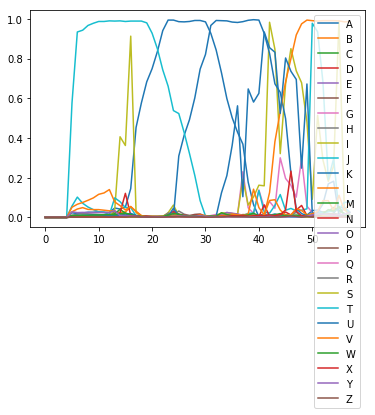

correct: 487 total: 510 accuracy: 0.955 avgEditDist 0.053
('A', 'A'): 220
('S', 'S'): 116
('E', 'E'): 249
('T', 'T'): 119
('H', 'H'): 82
('D', 'D'): 107
('K', 'K'): 44
('N', 'N'): 145
('L', 'L'): 110
('R', 'R'): 174
('O', 'O'): 141
('V', 'V'): 100
('B', 'B'): 29
('C', 'C'): 68
('G', 'G'): 50
('P', 'P'): 52
('I', 'I'): 99
('F', 'F'): 28
('W', 'W'): 42
-------('H', 'R'): 1
('U', 'U'): 34
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 24
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00144091 0.00099908 0.00149313 ... 0.00090323 0.03834236 0.00096427]
 [0.00149293 0.00104386 0.00182206 ... 0.00114193 0.03119888 0.00154956]
 [0.00160027 0.00108615 0.00193262 ... 0.00126193 0.03046113 0.00169774]
 ...
 [0.00309694 0.00218726 0.00147939 ... 0.00209265 0.02469697 0.00267506]
 [0.00288576 0.00197383 0.00143754 ... 0.00228198 0.02386884 0.00258

AOEAW AOEAW
edit distance: 0
correct: 489 total: 512 accuracy: 0.955 avgEditDist 0.053
('A', 'A'): 222
('S', 'S'): 116
('E', 'E'): 250
('T', 'T'): 120
('H', 'H'): 82
('D', 'D'): 107
('K', 'K'): 44
('N', 'N'): 145
('L', 'L'): 111
('R', 'R'): 176
('O', 'O'): 142
('V', 'V'): 100
('B', 'B'): 29
('C', 'C'): 68
('G', 'G'): 50
('P', 'P'): 52
('I', 'I'): 100
('F', 'F'): 28
('W', 'W'): 43
-------('H', 'R'): 1
('U', 'U'): 34
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 24
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.0011625  0.00090119 0.00158519 ... 0.00115793 0.03197088 0.00051301]
 [0.00103951 0.00084296 0.00151419 ... 0.00125276 0.02503398 0.00051661]
 [0.00136808 0.00097025 0.00167899 ... 0.00152122 0.02284744 0.00069278]
 ...
 [0.00324641 0.00190279 0.00306051 ... 0.0020433  0.02946323 0.00231567]
 [0.00304968 0.00180121 0.00285888 ...

VPA VPA
edit distance: 0
correct: 491 total: 514 accuracy: 0.955 avgEditDist 0.053
('A', 'A'): 223
('S', 'S'): 116
('E', 'E'): 252
('T', 'T'): 120
('H', 'H'): 82
('D', 'D'): 107
('K', 'K'): 44
('N', 'N'): 146
('L', 'L'): 111
('R', 'R'): 177
('O', 'O'): 142
('V', 'V'): 101
('B', 'B'): 30
('C', 'C'): 68
('G', 'G'): 50
('P', 'P'): 53
('I', 'I'): 100
('F', 'F'): 28
('W', 'W'): 43
-------('H', 'R'): 1
('U', 'U'): 34
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 24
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00160682 0.00083576 0.00143076 ... 0.00127517 0.02506484 0.00114452]
 [0.00224104 0.00117561 0.00156066 ... 0.00155681 0.02295571 0.00135796]
 [0.00235389 0.0011838  0.00165369 ... 0.00157785 0.02215536 0.00150001]
 ...
 [0.00144506 0.00106122 0.00144027 ... 0.0013715  0.0230004  0.00071786]
 [0.00150748 0.00107223 0.00143024 ... 0.0

EL EL
edit distance: 0
correct: 493 total: 516 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 223
('S', 'S'): 116
('E', 'E'): 253
('T', 'T'): 121
('H', 'H'): 83
('D', 'D'): 107
('K', 'K'): 44
('N', 'N'): 146
('L', 'L'): 112
('R', 'R'): 177
('O', 'O'): 144
('V', 'V'): 101
('B', 'B'): 30
('C', 'C'): 69
('G', 'G'): 50
('P', 'P'): 53
('I', 'I'): 100
('F', 'F'): 28
('W', 'W'): 43
-------('H', 'R'): 1
('U', 'U'): 34
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 24
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.0031505  0.00209407 0.0029612  ... 0.00218743 0.04232146 0.00141852]
 [0.00345988 0.00237154 0.00315479 ... 0.00232346 0.04349216 0.00186766]
 [0.00356558 0.0022318  0.00327591 ... 0.00223681 0.03857755 0.0017203 ]
 ...
 [0.0027439  0.0015107  0.00238677 ... 0.00142459 0.04042723 0.00115035]
 [0.00218525 0.00095286 0.00166234 ... 0.001

LSNVF LSNVF
edit distance: 0
correct: 495 total: 518 accuracy: 0.956 avgEditDist 0.052
('A', 'A'): 224
('S', 'S'): 117
('E', 'E'): 254
('T', 'T'): 122
('H', 'H'): 83
('D', 'D'): 107
('K', 'K'): 44
('N', 'N'): 147
('L', 'L'): 113
('R', 'R'): 177
('O', 'O'): 144
('V', 'V'): 102
('B', 'B'): 30
('C', 'C'): 69
('G', 'G'): 50
('P', 'P'): 53
('I', 'I'): 100
('F', 'F'): 29
('W', 'W'): 43
-------('H', 'R'): 1
('U', 'U'): 34
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 24
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00171246 0.00092149 0.0017194  ... 0.00244702 0.04199154 0.00096259]
 [0.00173142 0.0009344  0.00183049 ... 0.00254471 0.04706134 0.00104246]
 [0.00182947 0.00115125 0.00230744 ... 0.00273874 0.05125636 0.00127512]
 ...
 [0.00124766 0.00160965 0.00245239 ... 0.00234445 0.02455178 0.00211608]
 [0.00125182 0.00157845 0.00237082 ...

NRTB NRTB
edit distance: 0
correct: 497 total: 520 accuracy: 0.956 avgEditDist 0.052
('A', 'A'): 226
('S', 'S'): 117
('E', 'E'): 254
('T', 'T'): 123
('H', 'H'): 83
('D', 'D'): 107
('K', 'K'): 44
('N', 'N'): 148
('L', 'L'): 113
('R', 'R'): 179
('O', 'O'): 145
('V', 'V'): 102
('B', 'B'): 31
('C', 'C'): 69
('G', 'G'): 50
('P', 'P'): 54
('I', 'I'): 100
('F', 'F'): 30
('W', 'W'): 43
-------('H', 'R'): 1
('U', 'U'): 34
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 24
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00149117 0.00132761 0.00243547 ... 0.00126146 0.03278793 0.00248231]
 [0.00151106 0.0015484  0.00306591 ... 0.00175833 0.03745969 0.00303872]
 [0.00168394 0.00175683 0.00354097 ... 0.00207152 0.0393137  0.00370678]
 ...
 [0.00140881 0.00126098 0.00242579 ... 0.00460207 0.02691128 0.00104155]
 [0.00142176 0.00107616 0.00212025 ... 0

RC RC
edit distance: 0
correct: 499 total: 522 accuracy: 0.956 avgEditDist 0.052
('A', 'A'): 226
('S', 'S'): 117
('E', 'E'): 254
('T', 'T'): 123
('H', 'H'): 83
('D', 'D'): 109
('K', 'K'): 44
('N', 'N'): 148
('L', 'L'): 113
('R', 'R'): 180
('O', 'O'): 145
('V', 'V'): 102
('B', 'B'): 31
('C', 'C'): 71
('G', 'G'): 50
('P', 'P'): 54
('I', 'I'): 100
('F', 'F'): 30
('W', 'W'): 43
-------('H', 'R'): 1
('U', 'U'): 34
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 24
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00286321 0.00199111 0.00271187 ... 0.00177953 0.03689549 0.00132194]
 [0.00298509 0.00199884 0.00295841 ... 0.0019766  0.0323855  0.00149766]
 [0.00320163 0.00207572 0.00308627 ... 0.0020882  0.03072192 0.00157747]
 ...
 [0.00109262 0.00079703 0.00145516 ... 0.00147779 0.0218219  0.00063708]
 [0.00125308 0.00078514 0.00139135 ... 0.001

[[0.00098995 0.00084516 0.00148481 ... 0.0009897  0.02711682 0.00043284]
 [0.00087813 0.00077501 0.00144339 ... 0.0009821  0.02381632 0.00041897]
 [0.00099265 0.0008326  0.00149704 ... 0.00106354 0.02359884 0.00048746]
 ...
 [0.0016907  0.00081593 0.00146501 ... 0.0013052  0.02084788 0.0008821 ]
 [0.00176427 0.0008888  0.00156397 ... 0.00141165 0.02183661 0.00106896]
 [0.00176008 0.00105916 0.00151436 ... 0.00136711 0.02551338 0.00100413]]
--pred for 0 20 ['M 0.20 ', 'J 0.17 ', 'V 0.09 ', 'T 0.09 ', 'Y 0.03 ']
--pred for 0 24 ['M 0.35 ', 'V 0.10 ', 'J 0.07 ', 'T 0.07 ', 'N 0.04 ']
--pred for 0 28 ['M 0.21 ', 'N 0.18 ', 'V 0.12 ', 'J 0.06 ', 'T 0.06 ']
--pred for 0 32 ['N 0.90 ', 'V 0.12 ', 'J 0.08 ', 'T 0.04 ', 'M 0.04 ']
--pred for 0 36 ['N 0.99 ', 'V 0.13 ', 'T 0.07 ', 'J 0.05 ', 'L 0.03 ']
--pred for 0 40 ['N 0.99 ', 'V 0.14 ', 'T 0.08 ', 'L 0.04 ', 'J 0.03 ']
--pred for 0 44 ['N 0.99 ', 'V 0.14 ', 'T 0.07 ', 'J 0.05 ', 'L 0.03 ']
--pred for 0 48 ['I 0.99 ', 'N 0.99 ', 'V 0.15 ', 'T

KHGSV KHGSV
edit distance: 0
correct: 502 total: 525 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 227
('S', 'S'): 118
('E', 'E'): 257
('T', 'T'): 123
('H', 'H'): 84
('D', 'D'): 109
('K', 'K'): 45
('N', 'N'): 151
('L', 'L'): 113
('R', 'R'): 182
('O', 'O'): 146
('V', 'V'): 104
('B', 'B'): 32
('C', 'C'): 71
('G', 'G'): 51
('P', 'P'): 54
('I', 'I'): 100
('F', 'F'): 30
('W', 'W'): 43
-------('H', 'R'): 1
('U', 'U'): 34
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 24
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00178213 0.00130202 0.00169727 ... 0.00102903 0.01892312 0.00098671]
 [0.00161004 0.00119373 0.0019023  ... 0.0012048  0.0197096  0.00174642]
 [0.0016074  0.00118964 0.00199643 ... 0.00143068 0.02127902 0.00175816]
 ...
 [0.00153398 0.00131204 0.00267284 ... 0.00373893 0.02567211 0.00114775]
 [0.00159277 0.00100428 0.00213649 ...

[[0.00168432 0.0016091  0.0011428  ... 0.00130301 0.05100947 0.00094046]
 [0.00144001 0.001386   0.00100729 ... 0.00126071 0.0569165  0.00089735]
 [0.00116106 0.00137053 0.00093624 ... 0.00178927 0.03952795 0.00065311]
 ...
 [0.00175348 0.00093056 0.00138625 ... 0.00110057 0.0156863  0.00103192]
 [0.00148997 0.00093076 0.00134738 ... 0.00098094 0.01728583 0.00075098]
 [0.00162609 0.00090697 0.001366   ... 0.00113072 0.01995257 0.00071197]]
--pred for 0 20 ['I 1.00 ', 'V 0.17 ', 'T 0.16 ', 'J 0.12 ', 'L 0.09 ']
--pred for 0 24 ['I 1.00 ', 'V 0.29 ', 'T 0.14 ', 'J 0.08 ', 'H 0.07 ']
--pred for 0 28 ['I 1.00 ', 'F 0.38 ', 'V 0.28 ', 'J 0.11 ', 'H 0.09 ']
--pred for 0 32 ['I 1.00 ', 'F 0.93 ', 'V 0.21 ', 'J 0.15 ', 'H 0.05 ']
--pred for 0 36 ['I 1.00 ', 'F 0.64 ', 'R 0.22 ', 'V 0.19 ', 'H 0.07 ']
--pred for 0 40 ['I 1.00 ', 'R 0.99 ', 'V 0.14 ', 'T 0.10 ', 'L 0.05 ']
--pred for 0 44 ['I 1.00 ', 'R 0.99 ', 'V 0.12 ', 'T 0.08 ', 'L 0.04 ']
--pred for 0 48 ['I 1.00 ', 'R 0.99 ', 'V 0.12 ', 'T

[[0.00162886 0.00105452 0.00175801 ... 0.00100487 0.03426765 0.00121887]
 [0.00158196 0.00150089 0.00295414 ... 0.00148564 0.03660101 0.00262081]
 [0.00169567 0.0015881  0.00339714 ... 0.00172958 0.03592768 0.00305033]
 ...
 [0.00165291 0.00155293 0.00307463 ... 0.00412552 0.03104375 0.00141983]
 [0.00140945 0.00128427 0.00245006 ... 0.00566545 0.02359018 0.00119553]
 [0.00148364 0.00123786 0.00236202 ... 0.00612603 0.02220946 0.00097136]]
--pred for 0 20 ['T 0.19 ', 'L 0.12 ', 'V 0.10 ', 'Y 0.03 ', 'J 0.03 ']
--pred for 0 24 ['D 0.36 ', 'T 0.14 ', 'V 0.12 ', 'L 0.12 ', 'Y 0.04 ']
--pred for 0 28 ['D 0.51 ', 'T 0.15 ', 'V 0.11 ', 'L 0.08 ', 'C 0.04 ']
--pred for 0 32 ['D 0.41 ', 'T 0.15 ', 'C 0.14 ', 'V 0.14 ', 'L 0.11 ']
--pred for 0 36 ['C 0.60 ', 'D 0.28 ', 'V 0.12 ', 'T 0.11 ', 'L 0.11 ']
--pred for 0 40 ['D 0.99 ', 'V 0.14 ', 'T 0.13 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 44 ['D 0.99 ', 'V 0.12 ', 'T 0.12 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 48 ['D 0.99 ', 'V 0.12 ', 'T 0.11 ', 'L

[[0.00127922 0.00058434 0.00118354 ... 0.00120112 0.05028188 0.00067257]
 [0.0015241  0.00062483 0.00121386 ... 0.00185659 0.08132052 0.00070058]
 [0.00156012 0.00064108 0.00128307 ... 0.00183857 0.04762992 0.00083158]
 ...
 [0.00338314 0.00226473 0.00130521 ... 0.00185862 0.03032134 0.00225673]
 [0.00309664 0.00218516 0.00140943 ... 0.00241512 0.02995991 0.00305056]
 [0.00307134 0.00214575 0.00135434 ... 0.00236727 0.03057349 0.00293421]]
--pred for 0 20 ['V 0.24 ', 'T 0.16 ', 'Y 0.05 ', 'J 0.04 ', 'L 0.02 ']
--pred for 0 24 ['V 0.31 ', 'T 0.11 ', 'J 0.09 ', 'Y 0.08 ', 'A 0.03 ']
--pred for 0 28 ['V 0.54 ', 'J 0.08 ', 'T 0.08 ', 'Y 0.05 ', 'A 0.02 ']
--pred for 0 32 ['V 0.79 ', 'J 0.24 ', 'T 0.06 ', 'Y 0.03 ', 'L 0.02 ']
--pred for 0 36 ['V 0.95 ', 'J 0.07 ', 'T 0.05 ', 'L 0.02 ', 'Y 0.02 ']
--pred for 0 40 ['V 0.98 ', 'T 0.05 ', 'L 0.04 ', 'J 0.03 ', 'A 0.02 ']
--pred for 0 44 ['V 0.99 ', 'L 0.05 ', 'T 0.05 ', 'J 0.02 ', 'A 0.02 ']
--pred for 0 48 ['V 0.99 ', 'T 0.07 ', 'L 0.05 ', 'J

[[0.00154041 0.00088324 0.00136402 ... 0.00092797 0.02909194 0.00059201]
 [0.00172012 0.00109893 0.00173013 ... 0.00111624 0.03077675 0.00068597]
 [0.00195098 0.00113489 0.00180603 ... 0.00104886 0.04788475 0.00089843]
 ...
 [0.0015741  0.0013127  0.00268316 ... 0.00420886 0.02152766 0.00155523]
 [0.00166678 0.00107481 0.00232125 ... 0.00702207 0.02113158 0.00100552]
 [0.00166909 0.00102885 0.00212008 ... 0.00634977 0.0277296  0.00077442]]
--pred for 0 20 ['J 0.38 ', 'A 0.17 ', 'T 0.12 ', 'V 0.06 ', 'L 0.04 ']
--pred for 0 24 ['A 0.58 ', 'J 0.48 ', 'T 0.07 ', 'V 0.05 ', 'Y 0.03 ']
--pred for 0 28 ['A 0.86 ', 'J 0.10 ', 'V 0.09 ', 'T 0.06 ', 'Y 0.05 ']
--pred for 0 32 ['A 0.96 ', 'V 0.07 ', 'T 0.06 ', 'Y 0.05 ', 'J 0.04 ']
--pred for 0 36 ['A 0.98 ', 'V 0.08 ', 'T 0.05 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 40 ['A 0.99 ', 'V 0.10 ', 'T 0.05 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 44 ['A 0.99 ', 'V 0.10 ', 'Y 0.05 ', 'T 0.05 ', 'L 0.04 ']
--pred for 0 48 ['A 0.99 ', 'V 0.14 ', 'T 0.06 ', 'Y

RIARRV RIARRV
edit distance: 0
correct: 511 total: 534 accuracy: 0.957 avgEditDist 0.051
('A', 'A'): 233
('S', 'S'): 119
('E', 'E'): 260
('T', 'T'): 126
('H', 'H'): 85
('D', 'D'): 113
('K', 'K'): 45
('N', 'N'): 155
('L', 'L'): 116
('R', 'R'): 189
('O', 'O'): 148
('V', 'V'): 107
('B', 'B'): 34
('C', 'C'): 73
('G', 'G'): 51
('P', 'P'): 54
('I', 'I'): 102
('F', 'F'): 31
('W', 'W'): 43
-------('H', 'R'): 1
('U', 'U'): 35
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 24
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[1.21990952e-03 9.83424485e-04 1.63350895e-03 6.22111838e-03
  2.15896941e-03 2.31211586e-03 1.97112910e-03 1.40243745e-03
  6.89757382e-03 1.41230994e-03 1.26569616e-02 2.04636753e-02
  1.29611149e-01 1.15705701e-03 2.73851994e-02 1.15581200e-01
  8.54915679e-02 4.32636403e-03 3.30859283e-03 2.03273539e-03
  1.07331236e-03 1.0308

RTASON RTASON
edit distance: 0
correct: 513 total: 536 accuracy: 0.957 avgEditDist 0.050
('A', 'A'): 234
('S', 'S'): 120
('E', 'E'): 260
('T', 'T'): 127
('H', 'H'): 85
('D', 'D'): 113
('K', 'K'): 45
('N', 'N'): 157
('L', 'L'): 116
('R', 'R'): 190
('O', 'O'): 149
('V', 'V'): 107
('B', 'B'): 34
('C', 'C'): 73
('G', 'G'): 51
('P', 'P'): 55
('I', 'I'): 102
('F', 'F'): 31
('W', 'W'): 43
-------('H', 'R'): 1
('U', 'U'): 35
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 24
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.0012694  0.00089605 0.00130543 ... 0.00190629 0.04968488 0.00057646]
 [0.00122724 0.00088899 0.00124434 ... 0.0027438  0.03820535 0.00059587]
 [0.00150796 0.00107651 0.00121793 ... 0.00253871 0.03224787 0.00066845]
 ...
 [0.00174092 0.00119551 0.00197079 ... 0.00136216 0.01818546 0.00144463]
 [0.00172736 0.00118595 0.0019686  .

[[1.89223303e-03 1.01722917e-03 1.53021177e-03 7.24103570e-01
  3.27087101e-03 1.42284401e-03 2.19474640e-03 1.30964245e-03
  4.66065481e-03 1.62510551e-03 1.18306503e-02 2.88798078e-03
  8.97007585e-02 1.30377815e-03 5.53718247e-02 1.56243937e-03
  1.86256028e-03 1.65880006e-03 1.68902380e-03 2.06894847e-03
  9.74523195e-04 1.19925651e-03 1.04935072e-01 9.40840226e-03
  3.71910073e-02 7.74074811e-03 1.12650578e-03 2.41481643e-02
  8.28367192e-04]
 [2.14102538e-03 1.20758370e-03 1.71799294e-03 9.09098744e-01
  3.39327729e-03 1.51173724e-03 2.07840046e-03 1.59819622e-03
  8.47197883e-03 2.15830910e-03 1.42263835e-02 3.44488095e-03
  1.70789853e-01 2.09402782e-03 3.05236205e-02 2.14949436e-03
  2.34211725e-03 1.79492519e-03 2.21809139e-03 2.19615153e-03
  1.51099393e-03 1.88218313e-03 6.55073896e-02 8.31888616e-03
  4.25661094e-02 5.96217392e-03 1.87485991e-03 2.77622901e-02
  9.15190671e-04]
 [2.82010157e-03 1.52205699e-03 2.18914822e-03 9.53583717e-01
  3.47481575e-03 1.80233573e-03 2.

[[0.00299128 0.00214996 0.0030527  ... 0.00228698 0.03572782 0.00135998]
 [0.0032321  0.00214244 0.00316229 ... 0.00230892 0.03246583 0.00153571]
 [0.00352576 0.00221244 0.00328493 ... 0.00228433 0.03398452 0.0016825 ]
 ...
 [0.00455917 0.00130736 0.00352081 ... 0.00397805 0.02844444 0.00170402]
 [0.00349435 0.00118517 0.00303512 ... 0.00276092 0.02231834 0.00136346]
 [0.00287638 0.001053   0.00264242 ... 0.00244741 0.03081571 0.00105155]]
--pred for 0 20 ['E 0.98 ', 'V 0.11 ', 'T 0.07 ', 'J 0.06 ', 'L 0.04 ']
--pred for 0 24 ['E 0.98 ', 'V 0.11 ', 'T 0.09 ', 'A 0.04 ', 'J 0.04 ']
--pred for 0 28 ['E 0.98 ', 'V 0.11 ', 'T 0.10 ', 'L 0.04 ', 'A 0.04 ']
--pred for 0 32 ['E 0.98 ', 'V 0.12 ', 'T 0.10 ', 'L 0.04 ', 'Y 0.04 ']
--pred for 0 36 ['E 0.99 ', 'V 0.13 ', 'T 0.09 ', 'L 0.04 ', 'Y 0.04 ']
--pred for 0 40 ['E 0.99 ', 'V 0.11 ', 'T 0.09 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 44 ['E 0.99 ', 'V 0.10 ', 'T 0.09 ', 'L 0.06 ', 'Y 0.03 ']
--pred for 0 48 ['E 0.99 ', 'J 0.11 ', 'T 0.07 ', 'L

[[0.00088708 0.00082978 0.00144443 ... 0.000868   0.02375139 0.00042006]
 [0.00092643 0.00087763 0.00144997 ... 0.00095143 0.01922036 0.00042612]
 [0.00141644 0.00105744 0.00157171 ... 0.0013426  0.01949879 0.00069353]
 ...
 [0.0030537  0.0022854  0.00294677 ... 0.002753   0.03123432 0.00246854]
 [0.00236711 0.00180178 0.0021836  ... 0.00267561 0.02706467 0.00365461]
 [0.00218737 0.00160398 0.00227218 ... 0.00219262 0.02831634 0.00240552]]
--pred for 0 20 ['M 0.33 ', 'T 0.08 ', 'V 0.08 ', 'J 0.08 ', 'N 0.05 ']
--pred for 0 24 ['M 0.47 ', 'V 0.10 ', 'T 0.07 ', 'J 0.06 ', 'N 0.04 ']
--pred for 0 28 ['N 0.62 ', 'M 0.12 ', 'V 0.11 ', 'J 0.08 ', 'T 0.05 ']
--pred for 0 32 ['N 0.99 ', 'V 0.16 ', 'T 0.09 ', 'L 0.05 ', 'J 0.04 ']
--pred for 0 36 ['N 0.99 ', 'V 0.20 ', 'T 0.09 ', 'L 0.04 ', 'J 0.03 ']
--pred for 0 40 ['N 0.99 ', 'V 0.15 ', 'J 0.10 ', 'T 0.08 ', 'L 0.04 ']
--pred for 0 44 ['N 0.99 ', 'V 0.33 ', 'L 0.06 ', 'T 0.04 ', 'W 0.03 ']
--pred for 0 48 ['N 0.99 ', 'V 0.31 ', 'S 0.26 ', 'L

[[0.00181243 0.00168972 0.00120762 ... 0.00137643 0.04826001 0.00092009]
 [0.00165867 0.00163288 0.00121435 ... 0.00216404 0.03577278 0.00067361]
 [0.0015174  0.00137315 0.00109651 ... 0.00244624 0.02902175 0.00048296]
 ...
 [0.00450776 0.00137553 0.00372287 ... 0.00391149 0.02941357 0.00160434]
 [0.00367352 0.00133084 0.00335316 ... 0.00286551 0.03290441 0.00113713]
 [0.00241147 0.00121051 0.00250379 ... 0.00205142 0.02345956 0.00085225]]
--pred for 0 20 ['I 1.00 ', 'T 0.16 ', 'V 0.14 ', 'J 0.13 ', 'L 0.08 ']
--pred for 0 24 ['I 0.96 ', 'F 0.23 ', 'J 0.20 ', 'V 0.15 ', 'T 0.11 ']
--pred for 0 28 ['I 0.93 ', 'F 0.92 ', 'J 0.13 ', 'V 0.13 ', 'H 0.04 ']
--pred for 0 32 ['F 0.98 ', 'I 0.88 ', 'V 0.13 ', 'J 0.12 ', 'L 0.03 ']
--pred for 0 36 ['I 0.97 ', 'F 0.95 ', 'V 0.12 ', 'R 0.09 ', 'J 0.05 ']
--pred for 0 40 ['R 0.99 ', 'I 0.97 ', 'V 0.14 ', 'T 0.07 ', 'L 0.04 ']
--pred for 0 44 ['R 0.99 ', 'I 0.96 ', 'V 0.14 ', 'T 0.07 ', 'L 0.05 ']
--pred for 0 48 ['R 1.00 ', 'I 0.87 ', 'V 0.25 ', 'W

[[1.37322571e-03 9.31608432e-04 1.36900588e-03 7.58797722e-03
  3.57608125e-03 2.85173510e-03 1.85278081e-03 2.71115731e-03
  7.58819759e-01 2.02127011e-03 1.47581063e-02 5.43698249e-03
  3.04058641e-01 3.21641541e-03 2.27086656e-02 4.37432574e-03
  4.20940574e-03 2.97242263e-03 1.78373158e-02 2.02458166e-03
  2.37226933e-02 5.03165927e-03 3.20894569e-02 8.60563200e-03
  1.18743941e-01 1.00832591e-02 2.70043756e-03 3.88264060e-02
  6.23151602e-04]
 [1.37154153e-03 9.00916057e-04 1.28465553e-03 1.36746457e-02
  4.72958572e-03 4.00776090e-03 2.34780856e-03 3.62825254e-03
  9.69449997e-01 2.65746145e-03 1.11157065e-02 6.47150492e-03
  2.02959999e-01 3.10396845e-03 2.44198572e-02 4.57958225e-03
  5.28424280e-03 3.25711537e-03 1.09009752e-02 2.13083276e-03
  1.38678206e-02 7.12892413e-03 3.29945646e-02 1.16611812e-02
  1.21442705e-01 1.11403251e-02 3.20281065e-03 3.11525241e-02
  5.69241762e-04]
 [1.44501159e-03 9.12204734e-04 1.29511533e-03 1.39041832e-02
  4.99067549e-03 4.32406832e-03 2.

[[0.00098104 0.00091065 0.00149295 ... 0.00095589 0.02082963 0.0004046 ]
 [0.00092926 0.00091217 0.00146059 ... 0.00112437 0.01626245 0.000405  ]
 [0.00093562 0.00093331 0.00144627 ... 0.0011735  0.01653132 0.00043144]
 ...
 [0.00171342 0.00084139 0.00168206 ... 0.00130767 0.0216632  0.00083324]
 [0.00186107 0.00088555 0.00171954 ... 0.00140493 0.02528336 0.00106194]
 [0.00170971 0.00086845 0.00155525 ... 0.0012764  0.02814409 0.00095809]]
--pred for 0 20 ['M 0.34 ', 'J 0.15 ', 'T 0.09 ', 'V 0.07 ', 'N 0.03 ']
--pred for 0 24 ['M 0.59 ', 'J 0.11 ', 'V 0.09 ', 'T 0.07 ', 'L 0.02 ']
--pred for 0 28 ['M 0.66 ', 'J 0.11 ', 'V 0.09 ', 'T 0.07 ', 'L 0.02 ']
--pred for 0 32 ['M 0.59 ', 'J 0.19 ', 'V 0.12 ', 'T 0.05 ', 'L 0.02 ']
--pred for 0 36 ['M 0.74 ', 'J 0.26 ', 'V 0.15 ', 'T 0.05 ', 'L 0.02 ']
--pred for 0 40 ['M 0.83 ', 'V 0.28 ', 'J 0.07 ', 'T 0.05 ', 'W 0.02 ']
--pred for 0 44 ['M 0.86 ', 'V 0.30 ', 'J 0.06 ', 'T 0.05 ', 'W 0.03 ']
--pred for 0 48 ['M 0.95 ', 'V 0.29 ', 'T 0.05 ', 'J

EVETIR EVETIR
edit distance: 0
correct: 526 total: 549 accuracy: 0.958 avgEditDist 0.049
('A', 'A'): 241
('S', 'S'): 123
('E', 'E'): 267
('T', 'T'): 131
('H', 'H'): 85
('D', 'D'): 114
('K', 'K'): 45
('N', 'N'): 164
('L', 'L'): 118
('R', 'R'): 194
('O', 'O'): 149
('V', 'V'): 111
('B', 'B'): 35
('C', 'C'): 75
('G', 'G'): 51
('P', 'P'): 55
('I', 'I'): 105
('F', 'F'): 32
('W', 'W'): 44
-------('H', 'R'): 1
('U', 'U'): 35
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 25
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00224696 0.00079971 0.00180175 ... 0.00196504 0.06142625 0.0007517 ]
 [0.00293922 0.00103477 0.00253233 ... 0.00258024 0.05014271 0.00101768]
 [0.00360079 0.00116117 0.00294592 ... 0.00282704 0.04632679 0.00122775]
 ...
 [0.00335832 0.00131965 0.00321778 ... 0.00293304 0.02888335 0.00111119]
 [0.0028003  0.00130284 0.00295422 .

[[0.00151057 0.00113728 0.00159216 ... 0.00090228 0.03277206 0.00099975]
 [0.00149335 0.00105973 0.0018688  ... 0.00109436 0.03123736 0.00167268]
 [0.00161641 0.00112252 0.00199441 ... 0.0012524  0.03353494 0.00177539]
 ...
 [0.00216165 0.00110563 0.00166065 ... 0.00136465 0.01834621 0.00126886]
 [0.00199789 0.00099413 0.00156796 ... 0.00123073 0.01982396 0.00107105]
 [0.00171578 0.00099993 0.0015655  ... 0.00112081 0.01892051 0.00082958]]
--pred for 0 20 ['L 0.42 ', 'V 0.10 ', 'T 0.09 ', 'J 0.09 ', 'I 0.06 ']
--pred for 0 24 ['L 0.95 ', 'V 0.12 ', 'T 0.10 ', 'Y 0.03 ', 'J 0.02 ']
--pred for 0 28 ['L 0.96 ', 'V 0.12 ', 'T 0.10 ', 'Y 0.03 ', 'J 0.02 ']
--pred for 0 32 ['L 0.97 ', 'V 0.11 ', 'T 0.10 ', 'Y 0.03 ', 'J 0.02 ']
--pred for 0 36 ['L 0.98 ', 'V 0.14 ', 'T 0.09 ', 'Y 0.03 ', 'A 0.02 ']
--pred for 0 40 ['L 0.99 ', 'V 0.14 ', 'T 0.08 ', 'Y 0.04 ', 'A 0.02 ']
--pred for 0 44 ['L 0.99 ', 'V 0.21 ', 'T 0.08 ', 'Y 0.03 ', 'W 0.02 ']
--pred for 0 48 ['L 0.98 ', 'I 0.98 ', 'V 0.22 ', 'T

BLRPR BLRPR
edit distance: 0
correct: 529 total: 552 accuracy: 0.958 avgEditDist 0.049
('A', 'A'): 241
('S', 'S'): 125
('E', 'E'): 267
('T', 'T'): 132
('H', 'H'): 85
('D', 'D'): 115
('K', 'K'): 45
('N', 'N'): 165
('L', 'L'): 120
('R', 'R'): 197
('O', 'O'): 149
('V', 'V'): 113
('B', 'B'): 36
('C', 'C'): 75
('G', 'G'): 51
('P', 'P'): 56
('I', 'I'): 105
('F', 'F'): 32
('W', 'W'): 45
-------('H', 'R'): 1
('U', 'U'): 35
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 26
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[1.40100392e-03 9.62785271e-04 1.35991676e-03 8.37989151e-03
  3.17015499e-03 2.58524809e-03 1.92122976e-03 2.74765980e-03
  6.55604899e-01 1.73687970e-03 1.54457986e-02 5.36581501e-03
  3.11070025e-01 2.88409600e-03 2.20394731e-02 4.60596150e-03
  3.38305160e-03 2.73430650e-03 2.23338045e-02 2.05784664e-03
  3.49088758e-02 4.741373

TAEE TAEE
edit distance: 0
correct: 531 total: 554 accuracy: 0.958 avgEditDist 0.049
('A', 'A'): 242
('S', 'S'): 125
('E', 'E'): 270
('T', 'T'): 133
('H', 'H'): 85
('D', 'D'): 115
('K', 'K'): 45
('N', 'N'): 165
('L', 'L'): 120
('R', 'R'): 198
('O', 'O'): 149
('V', 'V'): 113
('B', 'B'): 36
('C', 'C'): 75
('G', 'G'): 51
('P', 'P'): 56
('I', 'I'): 105
('F', 'F'): 32
('W', 'W'): 45
-------('H', 'R'): 1
('U', 'U'): 35
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 26
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00213741 0.00164793 0.00209511 ... 0.00143999 0.03944222 0.00109292]
 [0.0029018  0.00203074 0.00294285 ... 0.00200972 0.03777403 0.00150896]
 [0.00319372 0.00211752 0.00306263 ... 0.00207115 0.03533986 0.00159827]
 ...
 [0.00205979 0.00090411 0.00156553 ... 0.00210011 0.03134114 0.00083116]
 [0.00198657 0.00098079 0.00153067 ... 0

[[0.00155466 0.00076697 0.00131875 ... 0.00275664 0.03312634 0.00090342]
 [0.00165981 0.00090647 0.00166651 ... 0.00255776 0.04277143 0.00096232]
 [0.00191883 0.00120287 0.00236746 ... 0.00316827 0.05038819 0.00127425]
 ...
 [0.00116705 0.00073617 0.00127634 ... 0.00096834 0.01470612 0.00098267]
 [0.00129566 0.00080743 0.00137243 ... 0.00122226 0.01961836 0.00069174]
 [0.00157558 0.00095188 0.00146043 ... 0.00120368 0.02082883 0.00074258]]
--pred for 0 20 ['V 0.11 ', 'J 0.07 ', 'T 0.07 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 24 ['C 0.15 ', 'V 0.10 ', 'T 0.08 ', 'J 0.06 ', 'L 0.05 ']
--pred for 0 28 ['C 0.82 ', 'T 0.10 ', 'V 0.08 ', 'J 0.06 ', 'Y 0.05 ']
--pred for 0 32 ['C 0.97 ', 'T 0.11 ', 'V 0.08 ', 'L 0.06 ', 'Y 0.06 ']
--pred for 0 36 ['C 0.99 ', 'V 0.09 ', 'T 0.08 ', 'Y 0.08 ', 'L 0.06 ']
--pred for 0 40 ['O 0.99 ', 'V 0.13 ', 'T 0.08 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 44 ['O 0.99 ', 'V 0.12 ', 'T 0.09 ', 'Y 0.04 ', 'A 0.03 ']
--pred for 0 48 ['O 0.99 ', 'J 0.14 ', 'T 0.06 ', 'A

[[1.65825081e-03 8.50426266e-04 1.57470070e-03 1.47096040e-02
  3.09285871e-03 2.25708224e-02 1.85071828e-03 1.30877830e-03
  5.16905263e-03 4.88819787e-03 1.26183350e-02 2.58101569e-03
  6.22479543e-02 3.60115580e-02 2.58923229e-02 3.88638116e-03
  5.95026510e-03 5.05720265e-03 2.18380522e-03 2.69074785e-03
  1.33955339e-03 7.79844879e-04 8.29727724e-02 1.04710758e-02
  1.09649114e-01 1.03182634e-02 2.84162327e-03 4.30266298e-02
  9.25733184e-04]
 [2.01832992e-03 1.07117346e-03 1.79894501e-03 2.92664059e-02
  2.96521164e-03 1.04573295e-01 2.25836178e-03 3.56344180e-03
  5.46366489e-03 5.25419181e-03 1.20332530e-02 2.96986173e-03
  6.94794804e-02 8.08334351e-03 2.16419566e-02 3.11105303e-03
  3.34776379e-03 8.03854316e-03 2.59128748e-03 2.98802904e-03
  2.79666041e-03 1.05699792e-03 8.73181596e-02 9.53752827e-03
  1.11254409e-01 1.04532810e-02 3.04974383e-03 4.12319303e-02
  1.01882417e-03]
 [2.10466539e-03 1.35580893e-03 1.41778658e-03 2.15963926e-02
  2.96198111e-03 1.39094470e-02 2.

EE EE
edit distance: 0
correct: 537 total: 560 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 244
('S', 'S'): 125
('E', 'E'): 274
('T', 'T'): 134
('H', 'H'): 85
('D', 'D'): 115
('K', 'K'): 45
('N', 'N'): 169
('L', 'L'): 121
('R', 'R'): 201
('O', 'O'): 151
('V', 'V'): 114
('B', 'B'): 36
('C', 'C'): 75
('G', 'G'): 52
('P', 'P'): 57
('I', 'I'): 105
('F', 'F'): 33
('W', 'W'): 45
-------('H', 'R'): 1
('U', 'U'): 35
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 26
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00199178 0.00130591 0.00144689 ... 0.0021088  0.04179169 0.00088198]
 [0.00228578 0.00149142 0.00145166 ... 0.00243122 0.03611093 0.00099219]
 [0.00264867 0.0017113  0.00133456 ... 0.00209672 0.03303131 0.00123804]
 ...
 [0.00170766 0.00111872 0.00183943 ... 0.00128351 0.02006479 0.00136222]
 [0.00168143 0.00110517 0.00185384 ... 0.001

OS OS
edit distance: 0
correct: 539 total: 562 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 245
('S', 'S'): 126
('E', 'E'): 275
('T', 'T'): 134
('H', 'H'): 85
('D', 'D'): 115
('K', 'K'): 45
('N', 'N'): 169
('L', 'L'): 122
('R', 'R'): 202
('O', 'O'): 153
('V', 'V'): 114
('B', 'B'): 37
('C', 'C'): 75
('G', 'G'): 52
('P', 'P'): 57
('I', 'I'): 105
('F', 'F'): 33
('W', 'W'): 45
-------('H', 'R'): 1
('U', 'U'): 35
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 26
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00147021 0.00078717 0.0014246  ... 0.00203085 0.04014079 0.00078561]
 [0.00170761 0.00090903 0.00156579 ... 0.0022689  0.04038262 0.00086884]
 [0.00193536 0.00121319 0.00223959 ... 0.0030161  0.04556634 0.00125542]
 ...
 [0.00159804 0.00154955 0.00285572 ... 0.00515269 0.02997095 0.00139453]
 [0.00164849 0.0010743  0.00199031 ... 0.022

ODAL ODAL
edit distance: 0
correct: 541 total: 564 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 246
('S', 'S'): 126
('E', 'E'): 275
('T', 'T'): 134
('H', 'H'): 85
('D', 'D'): 118
('K', 'K'): 45
('N', 'N'): 169
('L', 'L'): 123
('R', 'R'): 202
('O', 'O'): 155
('V', 'V'): 114
('B', 'B'): 37
('C', 'C'): 75
('G', 'G'): 52
('P', 'P'): 57
('I', 'I'): 105
('F', 'F'): 33
('W', 'W'): 45
-------('H', 'R'): 1
('U', 'U'): 35
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 26
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00268963 0.00193046 0.00265281 ... 0.00207006 0.04342193 0.00120966]
 [0.0029954  0.00221328 0.0030442  ... 0.00209614 0.04258876 0.00170754]
 [0.00188538 0.00177227 0.00212453 ... 0.00167129 0.03498577 0.00220178]
 ...
 [0.00113976 0.00067478 0.00115302 ... 0.00097473 0.01186266 0.00125317]
 [0.00115107 0.00068769 0.00122159 ... 0

SDT SDT
edit distance: 0
correct: 543 total: 566 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 246
('S', 'S'): 127
('E', 'E'): 275
('T', 'T'): 135
('H', 'H'): 85
('D', 'D'): 120
('K', 'K'): 45
('N', 'N'): 169
('L', 'L'): 123
('R', 'R'): 202
('O', 'O'): 155
('V', 'V'): 115
('B', 'B'): 38
('C', 'C'): 75
('G', 'G'): 52
('P', 'P'): 57
('I', 'I'): 105
('F', 'F'): 33
('W', 'W'): 45
-------('H', 'R'): 1
('U', 'U'): 35
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 26
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00152541 0.00096361 0.0016504  ... 0.00098926 0.02798148 0.00133137]
 [0.00159463 0.00104434 0.00185088 ... 0.00118592 0.02877669 0.00159016]
 [0.00175148 0.00111653 0.00197656 ... 0.00131972 0.03311586 0.0016484 ]
 ...
 [0.00145195 0.00104248 0.00132311 ... 0.00152223 0.02628551 0.00077693]
 [0.00149778 0.00105838 0.00145776 ... 0.0

TTUL TTUL
edit distance: 0
correct: 545 total: 568 accuracy: 0.960 avgEditDist 0.048
('A', 'A'): 247
('S', 'S'): 127
('E', 'E'): 275
('T', 'T'): 137
('H', 'H'): 86
('D', 'D'): 120
('K', 'K'): 45
('N', 'N'): 169
('L', 'L'): 126
('R', 'R'): 202
('O', 'O'): 155
('V', 'V'): 115
('B', 'B'): 38
('C', 'C'): 75
('G', 'G'): 52
('P', 'P'): 57
('I', 'I'): 105
('F', 'F'): 33
('W', 'W'): 45
-------('H', 'R'): 1
('U', 'U'): 36
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 26
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[1.70593779e-03 1.13395462e-03 1.84001157e-03 7.16638714e-02
  3.43923480e-03 1.91243086e-03 3.33243166e-03 1.63984403e-03
  4.01468994e-03 1.61991501e-03 1.53026534e-02 3.60802654e-03
  7.17741609e-01 1.28130242e-03 2.00991314e-02 2.17951904e-03
  2.22903863e-03 4.38313372e-03 3.10922577e-03 1.64586154e-03
  1.50530122e-03 2.26215785

CODENA CODENA
edit distance: 0
correct: 547 total: 570 accuracy: 0.960 avgEditDist 0.047
('A', 'A'): 249
('S', 'S'): 127
('E', 'E'): 276
('T', 'T'): 137
('H', 'H'): 86
('D', 'D'): 121
('K', 'K'): 45
('N', 'N'): 170
('L', 'L'): 126
('R', 'R'): 202
('O', 'O'): 157
('V', 'V'): 115
('B', 'B'): 38
('C', 'C'): 76
('G', 'G'): 52
('P', 'P'): 57
('I', 'I'): 105
('F', 'F'): 33
('W', 'W'): 45
-------('H', 'R'): 1
('U', 'U'): 36
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 26
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00219752 0.00082443 0.00171269 ... 0.00153514 0.05753207 0.00079525]
 [0.00286877 0.0009844  0.00240789 ... 0.00203782 0.05022746 0.00101573]
 [0.0035281  0.00113745 0.00291848 ... 0.0025849  0.04923271 0.00119742]
 ...
 [0.00330531 0.00227003 0.00151629 ... 0.00238276 0.02584139 0.00236706]
 [0.00312333 0.00224918 0.00154649 .

OUH OUH
edit distance: 0
correct: 549 total: 572 accuracy: 0.960 avgEditDist 0.047
('A', 'A'): 249
('S', 'S'): 128
('E', 'E'): 277
('T', 'T'): 137
('H', 'H'): 87
('D', 'D'): 121
('K', 'K'): 45
('N', 'N'): 170
('L', 'L'): 126
('R', 'R'): 204
('O', 'O'): 158
('V', 'V'): 115
('B', 'B'): 39
('C', 'C'): 76
('G', 'G'): 52
('P', 'P'): 57
('I', 'I'): 106
('F', 'F'): 33
('W', 'W'): 45
-------('H', 'R'): 1
('U', 'U'): 37
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 26
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00137823 0.00060863 0.00118346 ... 0.00131996 0.06629337 0.00077938]
 [0.00134203 0.0006024  0.00126508 ... 0.00156639 0.04059525 0.00085249]
 [0.00141509 0.00073745 0.00137245 ... 0.00134992 0.02862941 0.00101011]
 ...
 [0.00185163 0.00115177 0.00239444 ... 0.00254151 0.02856719 0.00192229]
 [0.00172424 0.00104146 0.0022415  ... 0.0

RTIOT RTIOT
edit distance: 0
correct: 551 total: 574 accuracy: 0.960 avgEditDist 0.047
('A', 'A'): 250
('S', 'S'): 128
('E', 'E'): 277
('T', 'T'): 139
('H', 'H'): 87
('D', 'D'): 121
('K', 'K'): 45
('N', 'N'): 170
('L', 'L'): 126
('R', 'R'): 205
('O', 'O'): 160
('V', 'V'): 116
('B', 'B'): 39
('C', 'C'): 77
('G', 'G'): 52
('P', 'P'): 57
('I', 'I'): 108
('F', 'F'): 33
('W', 'W'): 45
-------('H', 'R'): 1
('U', 'U'): 37
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 26
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[0.00133893 0.00080594 0.00127254 ... 0.00250013 0.04412275 0.00049361]
 [0.00140808 0.00085631 0.00133316 ... 0.0032375  0.02974228 0.00053839]
 [0.00147607 0.00085596 0.00133094 ... 0.003353   0.0278997  0.00055853]
 ...
 [0.00201282 0.00122995 0.00164939 ... 0.0014092  0.01355867 0.00143793]
 [0.00181179 0.00104098 0.001369   ...

AKMIAL AKMIAL
edit distance: 0
correct: 553 total: 576 accuracy: 0.960 avgEditDist 0.047
('A', 'A'): 253
('S', 'S'): 128
('E', 'E'): 277
('T', 'T'): 139
('H', 'H'): 87
('D', 'D'): 121
('K', 'K'): 46
('N', 'N'): 170
('L', 'L'): 127
('R', 'R'): 205
('O', 'O'): 160
('V', 'V'): 116
('B', 'B'): 39
('C', 'C'): 77
('G', 'G'): 52
('P', 'P'): 57
('I', 'I'): 109
('F', 'F'): 34
('W', 'W'): 46
-------('H', 'R'): 1
('U', 'U'): 37
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 27
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
[[1.69239275e-03 8.65804323e-04 1.45882845e-03 1.48824565e-02
  3.02744796e-03 1.78806223e-02 1.71060441e-03 1.66850886e-03
  5.19671151e-03 4.96890815e-03 1.07833212e-02 3.31685878e-03
  5.39130531e-02 1.62924863e-02 3.14907990e-02 3.98837822e-03
  5.48115373e-03 4.68502147e-03 2.20134249e-03 2.77443160e-03
  2.18112697e-03 5.6989

[[0.00154215 0.00108549 0.0018206  ... 0.00095756 0.03571095 0.00064748]
 [0.00149012 0.00105381 0.00188995 ... 0.00135718 0.03247977 0.00070655]
 [0.00153317 0.00107409 0.0019174  ... 0.00147439 0.02586568 0.00072243]
 ...
 [0.00283828 0.00165312 0.00259905 ... 0.00156414 0.03379738 0.0012045 ]
 [0.0026068  0.00159994 0.00237989 ... 0.00153314 0.03853474 0.00109758]
 [0.00225979 0.00110941 0.00173216 ... 0.00180406 0.03135571 0.00084671]]
--pred for 0 20 ['J 0.18 ', 'T 0.10 ', 'V 0.09 ', 'N 0.06 ', 'Y 0.04 ']
--pred for 0 24 ['N 0.30 ', 'V 0.12 ', 'J 0.11 ', 'T 0.06 ', 'M 0.05 ']
--pred for 0 28 ['N 0.54 ', 'V 0.12 ', 'J 0.10 ', 'M 0.06 ', 'T 0.05 ']
--pred for 0 32 ['N 0.90 ', 'V 0.15 ', 'J 0.08 ', 'T 0.05 ', 'Y 0.03 ']
--pred for 0 36 ['N 0.95 ', 'V 0.14 ', 'J 0.06 ', 'T 0.05 ', 'A 0.04 ']
--pred for 0 40 ['N 0.99 ', 'V 0.16 ', 'T 0.08 ', 'J 0.04 ', 'L 0.02 ']
--pred for 0 44 ['N 0.99 ', 'V 0.19 ', 'T 0.07 ', 'L 0.03 ', 'Y 0.02 ']
--pred for 0 48 ['N 0.99 ', 'V 0.28 ', 'T 0.05 ', 'U

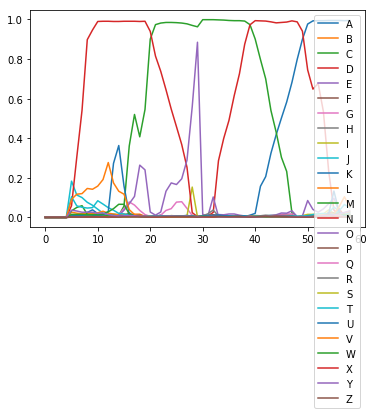

correct: 555 total: 579 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 254
('S', 'S'): 128
('E', 'E'): 277
('T', 'T'): 140
('H', 'H'): 87
('D', 'D'): 122
('K', 'K'): 46
('N', 'N'): 171
('L', 'L'): 127
('R', 'R'): 206
('O', 'O'): 160
('V', 'V'): 116
('B', 'B'): 39
('C', 'C'): 78
('G', 'G'): 53
('P', 'P'): 58
('I', 'I'): 110
('F', 'F'): 34
('W', 'W'): 46
-------('H', 'R'): 1
('U', 'U'): 37
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 27
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
[[1.62200315e-03 9.32762225e-04 1.45042979e-03 1.55384904e-02
  2.65878369e-03 2.42775120e-03 3.09388665e-03 1.41885842e-03
  5.28010633e-03 1.50126091e-03 1.23352986e-02 3.33948643e-03
  3.45946759e-01 1.32081599e-03 2.55292933e-02 4.26314864e-03
  1.39307894e-03 3.43316514e-03 2.63665104e-03 1.98299810e-03
  2.38987594e-03 3.15863336e-03 6

[[0.00133821 0.00068527 0.00120459 ... 0.0012402  0.03907253 0.00071541]
 [0.0012943  0.0007332  0.00131963 ... 0.00162052 0.03917239 0.00075943]
 [0.00133274 0.00070698 0.00133967 ... 0.00154334 0.02157361 0.00100606]
 ...
 [0.00190714 0.00091172 0.00125661 ... 0.00087538 0.01516876 0.00099868]
 [0.00182877 0.00091011 0.00123746 ... 0.00098882 0.01849089 0.00098564]
 [0.00136397 0.00091537 0.00139477 ... 0.00095178 0.01511517 0.00081562]]
--pred for 0 20 ['V 0.37 ', 'J 0.15 ', 'T 0.11 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 24 ['V 0.49 ', 'J 0.37 ', 'T 0.11 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 28 ['V 0.86 ', 'J 0.24 ', 'T 0.06 ', 'Y 0.02 ', 'L 0.02 ']
--pred for 0 32 ['V 0.96 ', 'J 0.06 ', 'T 0.05 ', 'L 0.03 ', 'W 0.02 ']
--pred for 0 36 ['V 0.98 ', 'T 0.06 ', 'L 0.05 ', 'J 0.04 ', 'A 0.01 ']
--pred for 0 40 ['V 0.99 ', 'T 0.06 ', 'L 0.06 ', 'J 0.02 ', 'Y 0.02 ']
--pred for 0 44 ['V 0.99 ', 'L 0.06 ', 'T 0.06 ', 'J 0.02 ', 'A 0.02 ']
--pred for 0 48 ['I 1.00 ', 'V 0.99 ', 'L 0.05 ', 'T

VVLASR VVLASR
edit distance: 0
correct: 559 total: 583 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 255
('S', 'S'): 129
('E', 'E'): 277
('T', 'T'): 141
('H', 'H'): 87
('D', 'D'): 122
('K', 'K'): 46
('N', 'N'): 171
('L', 'L'): 129
('R', 'R'): 208
('O', 'O'): 161
('V', 'V'): 119
('B', 'B'): 39
('C', 'C'): 78
('G', 'G'): 53
('P', 'P'): 59
('I', 'I'): 111
('F', 'F'): 34
('W', 'W'): 47
-------('H', 'R'): 1
('U', 'U'): 38
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 27
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
[[0.00130756 0.00097557 0.00151384 ... 0.00096439 0.02520626 0.00053339]
 [0.00105146 0.00084857 0.0015091  ... 0.00099024 0.0263002  0.00047852]
 [0.00091843 0.00078704 0.00143095 ... 0.00091411 0.0198709  0.00040151]
 ...
 [0.00159304 0.00082792 0.00141269 ... 0.00112316 0.01736826 0.00084769]
 [0.00170865 0.

WND WND
edit distance: 0
correct: 561 total: 585 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 255
('S', 'S'): 129
('E', 'E'): 277
('T', 'T'): 142
('H', 'H'): 87
('D', 'D'): 123
('K', 'K'): 46
('N', 'N'): 174
('L', 'L'): 129
('R', 'R'): 208
('O', 'O'): 161
('V', 'V'): 119
('B', 'B'): 39
('C', 'C'): 78
('G', 'G'): 53
('P', 'P'): 59
('I', 'I'): 111
('F', 'F'): 34
('W', 'W'): 48
-------('H', 'R'): 1
('U', 'U'): 38
-------('I', '%'): 5
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 27
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
[[0.00139486 0.00066927 0.00126647 ... 0.00144996 0.03766305 0.00059865]
 [0.00167662 0.00089706 0.0016722  ... 0.00165464 0.04719976 0.00080013]
 [0.00183685 0.00104377 0.00218742 ... 0.00244363 0.05172887 0.00108682]
 ...
 [0.00265078 0.00111785 0.00178908 ... 0.00226423 0.05177304 0.00100307]
 [0.00239637 0.000910

--pred for 216 250 ['A 0.99 ', 'T 0.07 ', 'J 0.04 ', 'Y 0.03 ', 'V 0.03 ']
--pred for 220 250 ['A 0.92 ', 'V 0.06 ', 'T 0.06 ', 'J 0.05 ', 'Y 0.04 ']
--pred for 224 250 ['A 0.86 ', 'V 0.13 ', 'T 0.06 ', 'J 0.05 ', 'Y 0.04 ']
--pred for 228 250 ['A 0.85 ', 'V 0.09 ', 'T 0.06 ', 'J 0.05 ', 'Y 0.03 ']
A
['A 0.0', 'B 0.0', 'C 0.0', 'D 0.0', 'E 0.0', 'F 0.0', 'G 0.0', 'H 0.0', 'I 0.0', 'J 0.0', 'K 0.0', 'L 0.0', 'M 0.0', 'N 0.0', 'O 0.0', 'P 0.0', 'Q 0.0', 'R 0.0', 'S 0.0', 'T 0.0', 'U 0.0', 'V 0.0', 'W 0.0', 'X 0.0', 'Y 0.0', 'Z 0.0']
[]
A
['A 0.0', 'B 0.0', 'C 0.0', 'D 0.0', 'E 0.0', 'F 0.0', 'G 0.0', 'H 0.0', 'I 0.0', 'J 0.0', 'K 0.0', 'L 0.0', 'M 0.0', 'N 0.0', 'O 0.0', 'P 0.0', 'Q 0.0', 'R 0.0', 'S 0.0', 'T 0.0', 'U 0.0', 'V 0.0', 'W 0.0', 'X 0.0', 'Y 0.0', 'Z 0.0']
[]
A
['A 0.0', 'B 0.0', 'C 0.0', 'D 0.0', 'E 0.0', 'F 0.0', 'G 0.0', 'H 0.0', 'I 0.0', 'J 0.0', 'K 0.0', 'L 0.0', 'M 0.0', 'N 0.0', 'O 0.0', 'P 0.0', 'Q 0.0', 'R 0.0', 'S 0.0', 'T 0.0', 'U 0.0', 'V 0.0', 'W 0.0', 'X 0.0', '

[[0.00297294 0.00202917 0.00285566 ... 0.00204385 0.03961974 0.0014262 ]
 [0.00330957 0.00217282 0.00318315 ... 0.00239179 0.03501392 0.0016092 ]
 [0.00347106 0.00221795 0.00318129 ... 0.00230314 0.0374913  0.00162694]
 ...
 [0.00165917 0.00126657 0.00202075 ... 0.00179274 0.01981593 0.00189702]
 [0.0016094  0.00110888 0.00185447 ... 0.00156514 0.01432662 0.00145261]
 [0.00166379 0.00117963 0.00193156 ... 0.00141375 0.01794847 0.00120495]]
--pred for 0 20 ['E 0.97 ', 'V 0.11 ', 'T 0.08 ', 'L 0.05 ', 'J 0.05 ']
--pred for 0 24 ['E 0.98 ', 'V 0.11 ', 'T 0.09 ', 'L 0.05 ', 'J 0.04 ']
--pred for 0 28 ['E 0.98 ', 'V 0.11 ', 'T 0.09 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 32 ['E 0.98 ', 'V 0.11 ', 'T 0.09 ', 'L 0.06 ', 'A 0.04 ']
--pred for 0 36 ['E 0.99 ', 'V 0.14 ', 'T 0.09 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 40 ['E 0.99 ', 'V 0.16 ', 'T 0.09 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 44 ['E 0.99 ', 'V 0.22 ', 'T 0.11 ', 'L 0.07 ', 'Y 0.04 ']
--pred for 0 48 ['E 0.99 ', 'V 0.36 ', 'L 0.06 ', 'T

[[0.00158066 0.00130248 0.00113774 ... 0.00112734 0.02458833 0.00059537]
 [0.00129916 0.00091057 0.00082887 ... 0.00105422 0.02139002 0.00051978]
 [0.00122473 0.00085525 0.00080782 ... 0.0011951  0.0202347  0.00050066]
 ...
 [0.00184366 0.00246159 0.00157421 ... 0.00140891 0.0154577  0.00306801]
 [0.0017111  0.00226203 0.00151756 ... 0.00117078 0.01728516 0.00160308]
 [0.00145663 0.00153268 0.00122503 ... 0.0010272  0.02049498 0.00078144]]
--pred for 0 20 ['I 0.91 ', 'J 0.18 ', 'T 0.16 ', 'V 0.14 ', 'L 0.04 ']
--pred for 0 24 ['I 0.96 ', 'V 0.28 ', 'U 0.13 ', 'T 0.12 ', 'J 0.04 ']
--pred for 0 28 ['I 0.95 ', 'V 0.29 ', 'U 0.25 ', 'T 0.10 ', 'H 0.04 ']
--pred for 0 32 ['I 0.93 ', 'V 0.36 ', 'U 0.11 ', 'C 0.10 ', 'T 0.06 ']
--pred for 0 36 ['I 0.98 ', 'G 0.86 ', 'V 0.20 ', 'T 0.05 ', 'J 0.04 ']
--pred for 0 40 ['I 0.98 ', 'G 0.96 ', 'V 0.18 ', 'T 0.06 ', 'L 0.05 ']
--pred for 0 44 ['G 0.97 ', 'I 0.97 ', 'V 0.14 ', 'T 0.06 ', 'M 0.06 ']
--pred for 0 48 ['I 0.99 ', 'G 0.98 ', 'V 0.16 ', 'Y

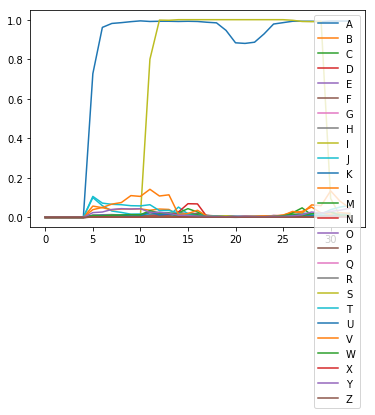

correct: 567 total: 592 accuracy: 0.958 avgEditDist 0.049
('A', 'A'): 261
('S', 'S'): 130
('E', 'E'): 280
('T', 'T'): 144
('H', 'H'): 87
('D', 'D'): 125
('K', 'K'): 46
('N', 'N'): 175
('L', 'L'): 131
('R', 'R'): 209
('O', 'O'): 164
('V', 'V'): 122
('B', 'B'): 40
('C', 'C'): 78
('G', 'G'): 54
('P', 'P'): 59
('I', 'I'): 114
('F', 'F'): 34
('W', 'W'): 48
-------('H', 'R'): 1
('U', 'U'): 38
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 27
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
[[0.00120365 0.00087958 0.00131993 ... 0.0009     0.02785821 0.00056055]
 [0.00115223 0.00072045 0.00117804 ... 0.00095677 0.03550424 0.00048613]
 [0.0020784  0.00075149 0.00160313 ... 0.00239425 0.02721354 0.00105837]
 ...
 [0.00151639 0.00119218 0.00151677 ... 0.00165476 0.0315155  0.00085566]
 [0.00147163 0.00110707 0.00142067 ... 0.00132

[[0.00138524 0.00096823 0.0013868  ... 0.00165695 0.05502062 0.00053949]
 [0.00136714 0.0009051  0.00127626 ... 0.0025673  0.04358841 0.00055235]
 [0.00131913 0.0008035  0.0011855  ... 0.00287935 0.03342998 0.00052831]
 ...
 [0.00151799 0.00065022 0.00131142 ... 0.00095719 0.019812   0.0007484 ]
 [0.00150434 0.00074706 0.00149189 ... 0.00107124 0.0255811  0.00089964]
 [0.00176353 0.00094499 0.00163734 ... 0.00120976 0.0308414  0.00104195]]
--pred for 0 20 ['J 0.20 ', 'V 0.14 ', 'F 0.13 ', 'T 0.08 ', 'Y 0.05 ']
--pred for 0 24 ['F 0.87 ', 'J 0.16 ', 'V 0.15 ', 'T 0.05 ', 'Y 0.04 ']
--pred for 0 28 ['F 0.96 ', 'V 0.14 ', 'J 0.10 ', 'T 0.05 ', 'Y 0.03 ']
--pred for 0 32 ['F 0.98 ', 'V 0.14 ', 'J 0.09 ', 'T 0.05 ', 'Y 0.03 ']
--pred for 0 36 ['F 0.98 ', 'V 0.15 ', 'J 0.07 ', 'T 0.06 ', 'Y 0.03 ']
--pred for 0 40 ['F 0.99 ', 'V 0.16 ', 'T 0.07 ', 'J 0.05 ', 'L 0.03 ']
--pred for 0 44 ['F 0.99 ', 'I 0.50 ', 'V 0.25 ', 'U 0.06 ', 'T 0.05 ']
--pred for 0 48 ['F 0.99 ', 'I 0.98 ', 'V 0.28 ', 'T

[[0.00295709 0.00252787 0.00321757 ... 0.00236079 0.03466999 0.0017831 ]
 [0.00307452 0.00235755 0.00332615 ... 0.00232574 0.03354786 0.00228151]
 [0.00339065 0.00232407 0.00339293 ... 0.00233961 0.03509594 0.00219411]
 ...
 [0.00168847 0.00116017 0.00187701 ... 0.00138385 0.01944876 0.00142202]
 [0.00165107 0.00110417 0.00182389 ... 0.00130017 0.01999933 0.00125209]
 [0.00161698 0.00108361 0.00182116 ... 0.00133958 0.02013952 0.00114941]]
--pred for 0 20 ['E 0.96 ', 'V 0.12 ', 'J 0.12 ', 'T 0.06 ', 'Y 0.04 ']
--pred for 0 24 ['E 0.98 ', 'V 0.13 ', 'T 0.08 ', 'J 0.05 ', 'L 0.04 ']
--pred for 0 28 ['E 0.99 ', 'V 0.12 ', 'T 0.09 ', 'L 0.04 ', 'Y 0.04 ']
--pred for 0 32 ['E 0.99 ', 'V 0.13 ', 'T 0.10 ', 'L 0.04 ', 'A 0.04 ']
--pred for 0 36 ['E 0.99 ', 'V 0.14 ', 'T 0.11 ', 'A 0.04 ', 'L 0.04 ']
--pred for 0 40 ['E 0.99 ', 'V 0.15 ', 'T 0.11 ', 'L 0.04 ', 'A 0.04 ']
--pred for 0 44 ['E 0.99 ', 'V 0.30 ', 'L 0.11 ', 'T 0.06 ', 'W 0.04 ']
--pred for 0 48 ['E 0.99 ', 'I 0.99 ', 'V 0.24 ', 'L

[[0.00128292 0.00053581 0.00109553 ... 0.00108955 0.04149857 0.0007733 ]
 [0.0013472  0.00054556 0.00110034 ... 0.00134472 0.03354019 0.0008854 ]
 [0.00144401 0.00065003 0.00134571 ... 0.00185942 0.02233494 0.00104474]
 ...
 [0.00197813 0.00095422 0.00169569 ... 0.00148565 0.02026027 0.00118146]
 [0.00187313 0.00095062 0.00156544 ... 0.0013397  0.02534046 0.00102407]
 [0.00164139 0.00093962 0.00151421 ... 0.00179021 0.0284906  0.00071226]]
--pred for 0 20 ['V 0.52 ', 'T 0.11 ', 'Y 0.04 ', 'L 0.03 ', 'J 0.02 ']
--pred for 0 24 ['V 0.79 ', 'T 0.07 ', 'Y 0.03 ', 'J 0.03 ', 'L 0.03 ']
--pred for 0 28 ['V 0.88 ', 'J 0.17 ', 'T 0.05 ', 'L 0.02 ', 'Y 0.02 ']
--pred for 0 32 ['V 0.96 ', 'T 0.06 ', 'J 0.04 ', 'L 0.03 ', 'W 0.02 ']
--pred for 0 36 ['V 0.98 ', 'T 0.06 ', 'L 0.05 ', 'J 0.03 ', 'H 0.01 ']
--pred for 0 40 ['V 0.99 ', 'L 0.08 ', 'T 0.07 ', 'A 0.02 ', 'H 0.02 ']
--pred for 0 44 ['V 0.99 ', 'T 0.11 ', 'L 0.09 ', 'A 0.02 ', 'H 0.02 ']
--pred for 0 48 ['V 0.99 ', 'T 0.15 ', 'L 0.07 ', 'Y

[[0.00118402 0.00080004 0.00119968 ... 0.00109837 0.02590207 0.00049219]
 [0.0010811  0.00064764 0.00121909 ... 0.00122833 0.05358912 0.00048783]
 [0.00114075 0.00066365 0.0011864  ... 0.0013394  0.03372889 0.00051209]
 ...
 [0.00261389 0.00122417 0.00190347 ... 0.00159761 0.04370167 0.00103568]
 [0.00197597 0.00080753 0.0014716  ... 0.00207526 0.03593263 0.00086119]
 [0.00184003 0.00086343 0.00139499 ... 0.00183961 0.02069464 0.00067206]]
--pred for 0 20 ['J 0.26 ', 'V 0.17 ', 'T 0.06 ', 'L 0.04 ', 'I 0.04 ']
--pred for 0 24 ['J 0.23 ', 'V 0.17 ', 'Y 0.05 ', 'K 0.04 ', 'H 0.04 ']
--pred for 0 28 ['K 0.22 ', 'N 0.14 ', 'V 0.12 ', 'J 0.09 ', 'H 0.06 ']
--pred for 0 32 ['K 0.97 ', 'V 0.12 ', 'T 0.06 ', 'J 0.05 ', 'A 0.05 ']
--pred for 0 36 ['K 0.98 ', 'V 0.12 ', 'J 0.07 ', 'T 0.06 ', 'A 0.05 ']
--pred for 0 40 ['K 0.99 ', 'V 0.11 ', 'J 0.08 ', 'T 0.07 ', 'A 0.05 ']
--pred for 0 44 ['K 0.99 ', 'V 0.10 ', 'T 0.07 ', 'J 0.07 ', 'L 0.06 ']
--pred for 0 48 ['I 0.98 ', 'K 0.98 ', 'V 0.21 ', 'T

OTVNAE OTVNAE
edit distance: 0
correct: 576 total: 601 accuracy: 0.958 avgEditDist 0.048
('A', 'A'): 265
('S', 'S'): 133
('E', 'E'): 287
('T', 'T'): 146
('H', 'H'): 89
('D', 'D'): 125
('K', 'K'): 49
('N', 'N'): 179
('L', 'L'): 135
('R', 'R'): 211
('O', 'O'): 166
('V', 'V'): 125
('B', 'B'): 40
('C', 'C'): 79
('G', 'G'): 54
('P', 'P'): 59
('I', 'I'): 115
('F', 'F'): 36
('W', 'W'): 48
-------('H', 'R'): 1
('U', 'U'): 39
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 27
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
[[0.001269   0.00089814 0.00132465 ... 0.00167887 0.0317542  0.00049682]
 [0.00142535 0.0008931  0.00119553 ... 0.00246106 0.03140895 0.0005384 ]
 [0.00344858 0.00203875 0.00121476 ... 0.00168573 0.0299816  0.00143595]
 ...
 [0.00156038 0.00095147 0.00153866 ... 0.00133536 0.02275888 0.00054315]
 [0.00167931 0.

WFNUS WFNUS
edit distance: 0
correct: 578 total: 603 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 266
('S', 'S'): 134
('E', 'E'): 287
('T', 'T'): 146
('H', 'H'): 89
('D', 'D'): 126
('K', 'K'): 49
('N', 'N'): 180
('L', 'L'): 135
('R', 'R'): 212
('O', 'O'): 166
('V', 'V'): 125
('B', 'B'): 40
('C', 'C'): 79
('G', 'G'): 54
('P', 'P'): 59
('I', 'I'): 115
('F', 'F'): 37
('W', 'W'): 49
-------('H', 'R'): 1
('U', 'U'): 41
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 28
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
[[0.00159972 0.0010341  0.00168884 ... 0.00099694 0.02347161 0.00113919]
 [0.00160743 0.00105737 0.00181911 ... 0.00112401 0.02343214 0.00142004]
 [0.00169859 0.00110128 0.00191586 ... 0.0012002  0.02399749 0.00147873]
 ...
 [0.00328297 0.00182782 0.00300073 ... 0.00204493 0.02844341 0.00213716]
 [0.00317609 0.00

RLNFOG RLNFOG
edit distance: 0
correct: 580 total: 605 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 267
('S', 'S'): 134
('E', 'E'): 288
('T', 'T'): 146
('H', 'H'): 89
('D', 'D'): 126
('K', 'K'): 49
('N', 'N'): 181
('L', 'L'): 137
('R', 'R'): 213
('O', 'O'): 167
('V', 'V'): 125
('B', 'B'): 40
('C', 'C'): 79
('G', 'G'): 55
('P', 'P'): 59
('I', 'I'): 115
('F', 'F'): 38
('W', 'W'): 49
-------('H', 'R'): 1
('U', 'U'): 41
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 28
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
[[0.00152353 0.00101131 0.00147003 ... 0.00085353 0.0401128  0.00068   ]
 [0.00139696 0.00097145 0.00167905 ... 0.0010897  0.02972131 0.00071045]
 [0.00145211 0.00100817 0.0015707  ... 0.00100408 0.0237333  0.00066945]
 ...
 [0.00304888 0.00224802 0.00153551 ... 0.00248172 0.02485636 0.00259961]
 [0.0028386  0.

OITTV OITTV
edit distance: 0
correct: 582 total: 607 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 267
('S', 'S'): 134
('E', 'E'): 288
('T', 'T'): 148
('H', 'H'): 89
('D', 'D'): 127
('K', 'K'): 49
('N', 'N'): 182
('L', 'L'): 137
('R', 'R'): 214
('O', 'O'): 168
('V', 'V'): 126
('B', 'B'): 40
('C', 'C'): 79
('G', 'G'): 55
('P', 'P'): 59
('I', 'I'): 116
('F', 'F'): 38
('W', 'W'): 49
-------('H', 'R'): 1
('U', 'U'): 41
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 28
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
[[0.00303299 0.00215923 0.00312911 ... 0.00220775 0.04078131 0.00176184]
 [0.00338901 0.00224637 0.00330878 ... 0.00244834 0.03711916 0.00174037]
 [0.0034661  0.00227504 0.00320995 ... 0.00225351 0.03666471 0.00191781]
 ...
 [0.00277047 0.00198748 0.00131835 ... 0.00232428 0.02281629 0.00272836]
 [0.00243416 0.00

SNDEU SNDEU
edit distance: 0
correct: 584 total: 609 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 267
('S', 'S'): 135
('E', 'E'): 292
('T', 'T'): 148
('H', 'H'): 89
('D', 'D'): 128
('K', 'K'): 49
('N', 'N'): 183
('L', 'L'): 137
('R', 'R'): 216
('O', 'O'): 168
('V', 'V'): 126
('B', 'B'): 40
('C', 'C'): 79
('G', 'G'): 55
('P', 'P'): 59
('I', 'I'): 116
('F', 'F'): 38
('W', 'W'): 49
-------('H', 'R'): 1
('U', 'U'): 42
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 28
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
[[0.00142541 0.00068801 0.00126009 ... 0.00140311 0.05267058 0.00074684]
 [0.00133778 0.00072201 0.00130323 ... 0.00083816 0.02738229 0.00072747]
 [0.00121417 0.00046366 0.00084336 ... 0.00080723 0.02143355 0.00077272]
 ...
 [0.00190768 0.00121491 0.00267753 ... 0.00324204 0.03408823 0.00089425]
 [0.00150038 0.00

HVACV HVACV
edit distance: 0
correct: 586 total: 611 accuracy: 0.959 avgEditDist 0.047
('A', 'A'): 268
('S', 'S'): 135
('E', 'E'): 293
('T', 'T'): 148
('H', 'H'): 90
('D', 'D'): 129
('K', 'K'): 49
('N', 'N'): 183
('L', 'L'): 137
('R', 'R'): 217
('O', 'O'): 169
('V', 'V'): 128
('B', 'B'): 40
('C', 'C'): 80
('G', 'G'): 55
('P', 'P'): 59
('I', 'I'): 116
('F', 'F'): 38
('W', 'W'): 50
-------('H', 'R'): 1
('U', 'U'): 42
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 28
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
[[1.43411919e-03 6.40891143e-04 1.19621784e-03 1.62398536e-02
  2.98644579e-03 9.51795373e-04 1.40921050e-03 1.65736908e-03
  3.68337915e-03 1.27720973e-03 1.78486966e-02 2.95944861e-03
  8.86795744e-02 1.45416998e-03 2.64647864e-02 2.31976318e-03
  6.87371066e-04 1.40224257e-03 2.18987116e-03 2.06840108e-03
  1.

EIOSDN EIOSDN
edit distance: 0
correct: 588 total: 613 accuracy: 0.959 avgEditDist 0.047
('A', 'A'): 268
('S', 'S'): 136
('E', 'E'): 295
('T', 'T'): 148
('H', 'H'): 90
('D', 'D'): 130
('K', 'K'): 49
('N', 'N'): 184
('L', 'L'): 137
('R', 'R'): 217
('O', 'O'): 170
('V', 'V'): 128
('B', 'B'): 40
('C', 'C'): 80
('G', 'G'): 55
('P', 'P'): 59
('I', 'I'): 117
('F', 'F'): 38
('W', 'W'): 51
-------('H', 'R'): 1
('U', 'U'): 42
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 28
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
[[0.00143412 0.00064089 0.00119622 ... 0.00141006 0.05832892 0.00080455]
 [0.00142226 0.0006707  0.00134734 ... 0.00184    0.03052034 0.00094363]
 [0.00153855 0.00073949 0.00129826 ... 0.00105592 0.02196723 0.00112861]
 ...
 [0.00217526 0.00122555 0.00218017 ... 0.00277487 0.02738655 0.00269409]
 [0.00192752 0.

VL VL
edit distance: 0
correct: 590 total: 615 accuracy: 0.959 avgEditDist 0.047
('A', 'A'): 268
('S', 'S'): 136
('E', 'E'): 295
('T', 'T'): 149
('H', 'H'): 90
('D', 'D'): 130
('K', 'K'): 49
('N', 'N'): 185
('L', 'L'): 138
('R', 'R'): 218
('O', 'O'): 170
('V', 'V'): 129
('B', 'B'): 40
('C', 'C'): 81
('G', 'G'): 55
('P', 'P'): 59
('I', 'I'): 117
('F', 'F'): 38
('W', 'W'): 52
-------('H', 'R'): 1
('U', 'U'): 42
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 28
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
[[0.00154709 0.00109711 0.00175562 ... 0.00129033 0.02276748 0.00075935]
 [0.00182278 0.00102561 0.00152755 ... 0.00122299 0.02258106 0.00080202]
 [0.00190924 0.00112451 0.00163732 ... 0.00150882 0.02469004 0.00085171]
 ...
 [0.00182042 0.00086085 0.00157269 ... 0.00146663 0.018968   0.00100964]
 [0.00178169 0.00088103

[[0.00255983 0.00100781 0.00237383 ... 0.00315327 0.04537245 0.00083822]
 [0.00313435 0.0010328  0.00257413 ... 0.00324247 0.04964402 0.00112299]
 [0.00459015 0.00137458 0.00355836 ... 0.00377972 0.05201869 0.00163597]
 ...
 [0.00197099 0.00095065 0.00165841 ... 0.0015554  0.02117714 0.00108123]
 [0.00201154 0.00094391 0.0016601  ... 0.00153756 0.02445983 0.00111276]
 [0.00199597 0.00098851 0.00159951 ... 0.00158451 0.02669126 0.0010097 ]]
--pred for 0 20 ['S 0.54 ', 'J 0.31 ', 'V 0.18 ', 'T 0.06 ', 'L 0.05 ']
--pred for 0 24 ['S 0.90 ', 'V 0.24 ', 'J 0.10 ', 'T 0.10 ', 'L 0.06 ']
--pred for 0 28 ['S 0.98 ', 'V 0.18 ', 'T 0.09 ', 'J 0.08 ', 'L 0.06 ']
--pred for 0 32 ['S 0.98 ', 'V 0.19 ', 'J 0.08 ', 'T 0.07 ', 'L 0.06 ']
--pred for 0 36 ['S 0.99 ', 'V 0.19 ', 'T 0.09 ', 'L 0.08 ', 'J 0.04 ']
--pred for 0 40 ['S 0.99 ', 'I 0.98 ', 'V 0.20 ', 'L 0.05 ', 'U 0.05 ']
--pred for 0 44 ['S 0.99 ', 'I 0.96 ', 'V 0.25 ', 'L 0.05 ', 'Y 0.05 ']
--pred for 0 48 ['S 0.99 ', 'E 0.90 ', 'V 0.14 ', 'Y

[[0.00151484 0.00092094 0.00157059 ... 0.0010135  0.02647828 0.0010873 ]
 [0.00160995 0.00103738 0.00178054 ... 0.00117035 0.02712885 0.00152224]
 [0.0016663  0.00105827 0.00180121 ... 0.0011799  0.02711469 0.00147756]
 ...
 [0.00264363 0.00189116 0.00135074 ... 0.00241131 0.02327894 0.00244354]
 [0.00242062 0.00170845 0.00133965 ... 0.00234841 0.02684381 0.00229486]
 [0.00199744 0.00150361 0.00130319 ... 0.00214422 0.02095357 0.0017419 ]]
--pred for 0 20 ['L 0.81 ', 'T 0.12 ', 'V 0.12 ', 'J 0.03 ', 'Y 0.03 ']
--pred for 0 24 ['L 0.95 ', 'T 0.13 ', 'V 0.13 ', 'Y 0.03 ', 'A 0.02 ']
--pred for 0 28 ['L 0.97 ', 'V 0.14 ', 'T 0.13 ', 'A 0.03 ', 'Y 0.03 ']
--pred for 0 32 ['L 0.98 ', 'V 0.16 ', 'T 0.14 ', 'A 0.03 ', 'Y 0.02 ']
--pred for 0 36 ['L 0.99 ', 'V 0.16 ', 'T 0.12 ', 'A 0.03 ', 'Y 0.03 ']
--pred for 0 40 ['L 0.99 ', 'V 0.24 ', 'T 0.12 ', 'W 0.02 ', 'Y 0.02 ']
--pred for 0 44 ['L 0.99 ', 'I 0.93 ', 'V 0.26 ', 'T 0.07 ', 'W 0.03 ']
--pred for 0 48 ['L 0.99 ', 'I 0.95 ', 'V 0.26 ', 'T

HWMRC HWMRC
edit distance: 0
correct: 595 total: 620 accuracy: 0.960 avgEditDist 0.047
('A', 'A'): 270
('S', 'S'): 137
('E', 'E'): 300
('T', 'T'): 149
('H', 'H'): 91
('D', 'D'): 130
('K', 'K'): 49
('N', 'N'): 188
('L', 'L'): 140
('R', 'R'): 220
('O', 'O'): 170
('V', 'V'): 129
('B', 'B'): 40
('C', 'C'): 82
('G', 'G'): 55
('P', 'P'): 59
('I', 'I'): 119
('F', 'F'): 38
('W', 'W'): 53
-------('H', 'R'): 1
('U', 'U'): 43
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 29
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
[[0.00156547 0.00077362 0.00148136 ... 0.00125136 0.03170339 0.00098925]
 [0.0019894  0.00107979 0.00145658 ... 0.00152204 0.02660166 0.00111954]
 [0.00203183 0.00107808 0.00155919 ... 0.00146605 0.02784187 0.00114643]
 ...
 [0.0015774  0.0008461  0.00152196 ... 0.00118059 0.02694977 0.00092408]
 [0.00177757 0.00

AELE AELE
edit distance: 0
correct: 597 total: 622 accuracy: 0.960 avgEditDist 0.047
('A', 'A'): 272
('S', 'S'): 137
('E', 'E'): 302
('T', 'T'): 150
('H', 'H'): 91
('D', 'D'): 130
('K', 'K'): 49
('N', 'N'): 189
('L', 'L'): 141
('R', 'R'): 220
('O', 'O'): 171
('V', 'V'): 130
('B', 'B'): 40
('C', 'C'): 82
('G', 'G'): 55
('P', 'P'): 59
('I', 'I'): 119
('F', 'F'): 38
('W', 'W'): 53
-------('H', 'R'): 1
('U', 'U'): 43
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 29
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
[[2.19827145e-03 2.10284861e-03 2.02358677e-03 1.41802374e-02
  7.33750360e-03 1.06973760e-03 1.19981752e-03 6.44269407e-01
  2.84413546e-02 2.21357495e-03 1.98679473e-02 1.27453625e-01
  1.21920839e-01 1.75172696e-03 4.02556285e-02 3.01944930e-02
  7.42421485e-03 2.06654682e-03 3.63094988e-03 3.13062337e-03
  4.23

[[1.71390793e-03 1.63172605e-03 1.12594035e-03 2.41846442e-02
  4.45927680e-03 1.22079055e-03 1.77908666e-03 2.47218926e-03
  9.00216121e-03 2.75797374e-03 4.07852903e-02 9.99107659e-01
  1.32676125e-01 1.15198432e-03 8.31808299e-02 9.36226081e-03
  3.25176329e-03 1.73854397e-03 3.19515960e-03 2.46846071e-03
  1.80459849e-03 1.55241310e-03 1.62982538e-01 1.65925864e-02
  1.97818980e-01 8.54882784e-03 1.38556235e-03 4.25826497e-02
  9.33386676e-04]
 [1.58820848e-03 1.59758376e-03 1.22157112e-03 2.08437275e-02
  5.99621097e-03 1.28687825e-03 2.67980387e-03 2.64058006e-03
  8.44193436e-03 3.89573304e-03 2.78086588e-02 9.95849967e-01
  8.14851150e-02 9.43954219e-04 1.52848735e-01 7.05700601e-03
  2.98293377e-03 2.52895011e-03 3.71440640e-03 2.67168810e-03
  1.53492531e-03 1.16168708e-03 1.86482981e-01 9.46794823e-03
  2.74955451e-01 9.01106466e-03 1.13954919e-03 4.15743776e-02
  1.17922120e-03]
 [1.57826871e-03 2.15134118e-03 1.87429250e-03 3.67670506e-02
  6.77707186e-03 3.02037923e-03 2.

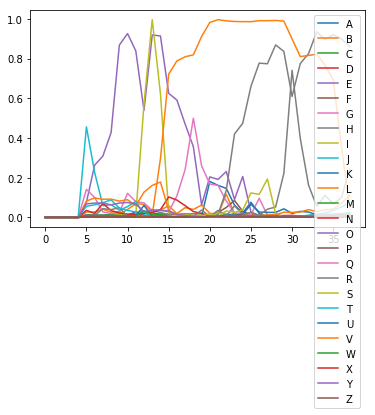

correct: 600 total: 626 accuracy: 0.958 avgEditDist 0.050
('A', 'A'): 272
('S', 'S'): 137
('E', 'E'): 304
('T', 'T'): 150
('H', 'H'): 91
('D', 'D'): 131
('K', 'K'): 49
('N', 'N'): 189
('L', 'L'): 143
('R', 'R'): 220
('O', 'O'): 171
('V', 'V'): 130
('B', 'B'): 40
('C', 'C'): 83
('G', 'G'): 55
('P', 'P'): 59
('I', 'I'): 120
('F', 'F'): 38
('W', 'W'): 53
-------('H', 'R'): 2
('U', 'U'): 43
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 29
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.00171911 0.00123953 0.00175597 ... 0.00117519 0.0361375  0.00080155]
 [0.00239635 0.00201876 0.00256861 ... 0.0017432  0.04042553 0.00149791]
 [0.0024053  0.00213861 0.00272528 ... 0.00164401 0.03740218 0.00202109]
 ...
 [0.00176474 0.0009922  0.00142804 ... 0.00115722 0.01541314 0.00099396]
 [0.00149135 0.0009034  0

[]
A
['A 0.0', 'B 0.0', 'C 0.0', 'D 0.0', 'E 0.0', 'F 0.0', 'G 0.0', 'H 0.0', 'I 0.0', 'J 0.0', 'K 0.0', 'L 0.0', 'M 0.0', 'N 0.0', 'O 0.0', 'P 0.0', 'Q 0.0', 'R 0.0', 'S 0.0', 'T 0.0', 'U 0.0', 'V 0.0', 'W 0.0', 'X 0.0', 'Y 0.0', 'Z 0.0']
[]
A
['A 0.0', 'B 0.0', 'C 0.0', 'D 0.0', 'E 0.0', 'F 0.0', 'G 0.0', 'H 0.0', 'I 0.0', 'J 0.0', 'K 0.0', 'L 0.0', 'M 0.0', 'N 0.0', 'O 0.0', 'P 0.0', 'Q 0.0', 'R 0.0', 'S 0.0', 'T 0.0', 'U 0.0', 'V 0.0', 'W 0.0', 'X 0.0', 'Y 0.0', 'Z 0.0']
[]
GCIEM GCIEM
edit distance: 0
correct: 602 total: 628 accuracy: 0.959 avgEditDist 0.049
('A', 'A'): 272
('S', 'S'): 138
('E', 'E'): 305
('T', 'T'): 151
('H', 'H'): 91
('D', 'D'): 131
('K', 'K'): 49
('N', 'N'): 189
('L', 'L'): 143
('R', 'R'): 221
('O', 'O'): 172
('V', 'V'): 130
('B', 'B'): 41
('C', 'C'): 84
('G', 'G'): 57
('P', 'P'): 59
('I', 'I'): 121
('F', 'F'): 38
('W', 'W'): 53
-------('H', 'R'): 2
('U', 'U'): 43
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 30
-------('T', '%'): 6

[[1.47963571e-03 9.80043318e-04 1.32564281e-03 3.92126245e-03
  2.77868588e-03 1.78124977e-03 9.46080487e-04 3.93755361e-03
  4.99401875e-02 1.36631436e-03 2.97414139e-02 1.09118242e-02
  1.62536114e-01 4.73555084e-03 2.25905515e-02 1.68419853e-02
  4.71406523e-03 2.85031321e-03 8.41127522e-03 2.24156748e-03
  2.90689543e-02 1.96849112e-03 4.94464338e-02 6.31866278e-03
  1.38424560e-01 8.12793802e-03 1.53132831e-03 3.96055505e-02
  5.77939965e-04]
 [3.13418498e-03 1.80578604e-03 1.41798519e-03 2.30024178e-02
  2.78885709e-03 2.10211007e-03 2.92259222e-03 2.68863072e-03
  9.19528753e-02 2.27814005e-03 1.44072184e-02 6.06259704e-03
  1.34134322e-01 5.43613173e-03 3.83117981e-02 5.65333245e-03
  7.96248112e-03 1.74166076e-03 9.79446992e-03 2.61563645e-03
  9.43598092e-01 3.90086602e-03 4.85335775e-02 9.32008959e-03
  1.23572089e-01 1.04060359e-02 2.70236447e-03 3.17589305e-02
  1.34516007e-03]
 [3.35498317e-03 2.11831857e-03 1.37828838e-03 2.38104425e-02
  3.01144831e-03 1.80585217e-03 3.

[[0.00153942 0.00074222 0.0013109  ... 0.00234804 0.03533676 0.00072853]
 [0.00178362 0.00087651 0.00154758 ... 0.00277225 0.04310193 0.0009058 ]
 [0.00189309 0.00112057 0.0022857  ... 0.0028454  0.05256402 0.00120421]
 ...
 [0.00353172 0.00191523 0.00312408 ... 0.00205892 0.03144133 0.00212516]
 [0.00337801 0.00191929 0.00310679 ... 0.00225804 0.02958451 0.00210645]
 [0.0031396  0.00188299 0.00302101 ... 0.00205693 0.0288382  0.00188556]]
--pred for 0 20 ['V 0.16 ', 'T 0.09 ', 'J 0.05 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 24 ['V 0.14 ', 'T 0.08 ', 'J 0.05 ', 'Y 0.04 ', 'C 0.04 ']
--pred for 0 28 ['C 0.85 ', 'T 0.11 ', 'V 0.10 ', 'Y 0.05 ', 'J 0.04 ']
--pred for 0 32 ['C 0.23 ', 'V 0.19 ', 'G 0.09 ', 'T 0.07 ', 'Y 0.05 ']
--pred for 0 36 ['G 0.49 ', 'V 0.19 ', 'C 0.14 ', 'T 0.08 ', 'J 0.05 ']
--pred for 0 40 ['G 0.98 ', 'V 0.18 ', 'T 0.07 ', 'Y 0.06 ', 'L 0.02 ']
--pred for 0 44 ['G 0.99 ', 'V 0.13 ', 'T 0.06 ', 'Y 0.05 ', 'A 0.03 ']
--pred for 0 48 ['G 0.99 ', 'V 0.13 ', 'T 0.12 ', 'Y

[[0.0016525  0.00084133 0.00146275 ... 0.00137576 0.03160554 0.00105541]
 [0.00217571 0.00113734 0.00154504 ... 0.00169042 0.02772707 0.0012996 ]
 [0.00220365 0.00110466 0.00163113 ... 0.00162155 0.02625995 0.0013532 ]
 ...
 [0.00304408 0.00160803 0.00262142 ... 0.00185167 0.02517152 0.002578  ]
 [0.00285222 0.00170292 0.00263926 ... 0.00188439 0.02799907 0.00338404]
 [0.00240919 0.00138782 0.00212549 ... 0.00198669 0.03293946 0.00205756]]
--pred for 0 20 ['T 0.73 ', 'J 0.11 ', 'V 0.06 ', 'Y 0.03 ', 'L 0.03 ']
--pred for 0 24 ['T 0.95 ', 'V 0.09 ', 'J 0.08 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 28 ['T 0.95 ', 'V 0.10 ', 'J 0.05 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 32 ['T 0.98 ', 'V 0.11 ', 'J 0.04 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 36 ['T 0.98 ', 'V 0.12 ', 'L 0.04 ', 'J 0.03 ', 'A 0.03 ']
--pred for 0 40 ['T 0.99 ', 'V 0.13 ', 'L 0.04 ', 'A 0.03 ', 'Y 0.03 ']
--pred for 0 44 ['T 0.99 ', 'V 0.14 ', 'L 0.04 ', 'J 0.03 ', 'A 0.03 ']
--pred for 0 48 ['T 0.99 ', 'I 0.95 ', 'V 0.17 ', 'L

[[0.00113726 0.00089724 0.00158369 ... 0.00097572 0.03408279 0.00053623]
 [0.00094454 0.00083014 0.00147143 ... 0.00093688 0.02463562 0.00047614]
 [0.00151231 0.00107612 0.00175755 ... 0.00140225 0.02407238 0.00083044]
 ...
 [0.00191935 0.00163538 0.00290172 ... 0.00358661 0.0345795  0.00230643]
 [0.00182792 0.00153244 0.00267883 ... 0.00326102 0.03042303 0.00218561]
 [0.00168756 0.00153558 0.00264864 ... 0.00317861 0.02621284 0.0016858 ]]
--pred for 0 20 ['N 0.14 ', 'J 0.13 ', 'V 0.11 ', 'M 0.11 ', 'T 0.06 ']
--pred for 0 24 ['M 0.26 ', 'V 0.13 ', 'N 0.08 ', 'J 0.06 ', 'T 0.06 ']
--pred for 0 28 ['N 0.77 ', 'V 0.14 ', 'J 0.06 ', 'M 0.06 ', 'T 0.05 ']
--pred for 0 32 ['N 0.98 ', 'V 0.15 ', 'J 0.07 ', 'T 0.05 ', 'L 0.03 ']
--pred for 0 36 ['N 0.99 ', 'V 0.16 ', 'T 0.09 ', 'J 0.04 ', 'L 0.04 ']
--pred for 0 40 ['N 0.99 ', 'V 0.15 ', 'T 0.07 ', 'J 0.05 ', 'L 0.04 ']
--pred for 0 44 ['N 0.99 ', 'I 0.95 ', 'V 0.24 ', 'T 0.04 ', 'L 0.03 ']
--pred for 0 48 ['I 0.99 ', 'N 0.99 ', 'V 0.24 ', 'W

[[0.00106999 0.00091509 0.00158976 ... 0.00097393 0.028923   0.00048668]
 [0.00109339 0.00088219 0.00163104 ... 0.00124593 0.0243207  0.0005748 ]
 [0.00114158 0.00090122 0.00160578 ... 0.00131748 0.0226746  0.00059505]
 ...
 [0.00256647 0.00208378 0.00133012 ... 0.00289448 0.03781404 0.00190984]
 [0.00213224 0.00180522 0.00128413 ... 0.00280767 0.03175135 0.00166992]
 [0.00185621 0.00154963 0.00135834 ... 0.00278131 0.03364695 0.00127068]]
--pred for 0 20 ['M 0.20 ', 'J 0.10 ', 'V 0.09 ', 'T 0.09 ', 'N 0.04 ']
--pred for 0 24 ['N 0.28 ', 'M 0.14 ', 'V 0.12 ', 'J 0.08 ', 'T 0.06 ']
--pred for 0 28 ['N 0.46 ', 'M 0.15 ', 'V 0.14 ', 'J 0.06 ', 'T 0.05 ']
--pred for 0 32 ['N 0.95 ', 'V 0.14 ', 'J 0.07 ', 'T 0.04 ', 'Y 0.02 ']
--pred for 0 36 ['N 0.96 ', 'V 0.17 ', 'J 0.06 ', 'T 0.04 ', 'A 0.02 ']
--pred for 0 40 ['N 0.99 ', 'V 0.16 ', 'T 0.12 ', 'J 0.03 ', 'A 0.02 ']
--pred for 0 44 ['N 0.99 ', 'V 0.17 ', 'T 0.06 ', 'L 0.03 ', 'J 0.03 ']
--pred for 0 48 ['N 0.99 ', 'V 0.16 ', 'T 0.07 ', 'J

[[2.71638529e-03 1.97367277e-03 2.77794339e-03 2.18967535e-02
  1.32839400e-02 1.16467651e-03 2.30750628e-03 9.64237750e-01
  9.44539998e-03 2.83330563e-03 1.49383610e-02 5.72976563e-03
  7.26866499e-02 2.26571760e-03 3.85342836e-02 4.61175200e-03
  1.76456466e-03 1.94969261e-03 3.01457080e-03 3.36246169e-03
  2.38848175e-03 2.83788959e-03 7.10444450e-02 7.38936849e-03
  1.36719331e-01 1.18059693e-02 1.87842478e-03 4.22751866e-02
  1.40449987e-03]
 [2.91076652e-03 2.04344653e-03 2.96556274e-03 3.13490331e-02
  1.22660920e-02 1.44586840e-03 2.64045200e-03 9.83682334e-01
  9.24365781e-03 3.57931270e-03 1.38228592e-02 5.54829370e-03
  4.93924916e-02 2.36015581e-03 3.79523598e-02 4.42724070e-03
  2.19580042e-03 2.22739764e-03 2.85320566e-03 3.53247416e-03
  2.09824089e-03 2.67678406e-03 8.99164081e-02 1.00318855e-02
  1.15519650e-01 1.29125705e-02 2.04251404e-03 3.72126587e-02
  1.45902624e-03]
 [3.27048660e-03 2.21083732e-03 3.13512352e-03 3.20006311e-02
  1.08383829e-02 1.62875804e-03 2.

EI EI
edit distance: 0
correct: 616 total: 642 accuracy: 0.960 avgEditDist 0.048
('A', 'A'): 274
('S', 'S'): 140
('E', 'E'): 315
('T', 'T'): 157
('H', 'H'): 93
('D', 'D'): 134
('K', 'K'): 50
('N', 'N'): 194
('L', 'L'): 144
('R', 'R'): 222
('O', 'O'): 174
('V', 'V'): 130
('B', 'B'): 42
('C', 'C'): 86
('G', 'G'): 60
('P', 'P'): 61
('I', 'I'): 125
('F', 'F'): 39
('W', 'W'): 54
-------('H', 'R'): 2
('U', 'U'): 43
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 31
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.00303204 0.00216642 0.00280225 ... 0.00218245 0.05879582 0.00148626]
 [0.00349032 0.00232994 0.00311443 ... 0.00250145 0.04422786 0.00179644]
 [0.00365518 0.00228769 0.00320859 ... 0.00229148 0.04249964 0.00174256]
 ...
 [0.00134937 0.00086284 0.00119334 ... 0.0009732  0.01968203 0.00067142]
 [

TD TD
edit distance: 0
correct: 618 total: 644 accuracy: 0.960 avgEditDist 0.048
('A', 'A'): 274
('S', 'S'): 140
('E', 'E'): 317
('T', 'T'): 159
('H', 'H'): 93
('D', 'D'): 135
('K', 'K'): 50
('N', 'N'): 195
('L', 'L'): 145
('R', 'R'): 223
('O', 'O'): 174
('V', 'V'): 130
('B', 'B'): 42
('C', 'C'): 86
('G', 'G'): 60
('P', 'P'): 61
('I', 'I'): 125
('F', 'F'): 39
('W', 'W'): 54
-------('H', 'R'): 2
('U', 'U'): 43
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 31
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.0014882  0.00130727 0.00237754 ... 0.00128038 0.03239689 0.00191767]
 [0.00152022 0.00158877 0.00315015 ... 0.00169077 0.03589839 0.0032673 ]
 [0.00165624 0.00172753 0.00356299 ... 0.00198153 0.04064957 0.00279902]
 ...
 [0.00219732 0.00117911 0.00166351 ... 0.00138449 0.01883178 0.00132586]
 [

GOFV GOFV
edit distance: 0
correct: 620 total: 646 accuracy: 0.960 avgEditDist 0.048
('A', 'A'): 274
('S', 'S'): 140
('E', 'E'): 317
('T', 'T'): 160
('H', 'H'): 93
('D', 'D'): 136
('K', 'K'): 50
('N', 'N'): 195
('L', 'L'): 145
('R', 'R'): 223
('O', 'O'): 175
('V', 'V'): 131
('B', 'B'): 42
('C', 'C'): 86
('G', 'G'): 63
('P', 'P'): 61
('I', 'I'): 126
('F', 'F'): 40
('W', 'W'): 54
-------('H', 'R'): 2
('U', 'U'): 43
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 31
-------('T', '%'): 6
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[1.59753137e-03 8.98543163e-04 1.41562382e-03 1.41635947e-02
  2.56263628e-03 2.20969412e-03 3.30642681e-03 1.27434509e-03
  5.68101089e-03 1.95601699e-03 1.09698316e-02 3.53173539e-03
  2.30183989e-01 1.09850871e-03 2.72419844e-02 3.67447059e-03
  1.61767018e-03 2.70250347e-03 2.88016605e-03 

[[0.00178508 0.00083933 0.00140542 ... 0.0021349  0.03193538 0.00070286]
 [0.00245629 0.00145244 0.00137767 ... 0.00285075 0.0303617  0.00098113]
 [0.00298788 0.00176057 0.00161519 ... 0.00222273 0.03509154 0.00124772]
 ...
 [0.00324469 0.00237275 0.00137604 ... 0.00212449 0.02753993 0.00214685]
 [0.002943   0.00206759 0.00152091 ... 0.00235159 0.0269507  0.00242969]
 [0.00262983 0.00191188 0.00142192 ... 0.00205342 0.02613156 0.00231867]]
--pred for 0 20 ['V 0.12 ', 'T 0.09 ', 'J 0.05 ', 'A 0.03 ', 'Y 0.03 ']
--pred for 0 24 ['V 0.14 ', 'T 0.11 ', 'J 0.11 ', 'A 0.09 ', 'Y 0.03 ']
--pred for 0 28 ['E 0.16 ', 'V 0.14 ', 'A 0.09 ', 'T 0.08 ', 'J 0.06 ']
--pred for 0 32 ['G 0.39 ', 'E 0.22 ', 'V 0.17 ', 'T 0.07 ', 'Y 0.04 ']
--pred for 0 36 ['G 0.95 ', 'V 0.17 ', 'Y 0.13 ', 'T 0.05 ', 'L 0.04 ']
--pred for 0 40 ['G 0.99 ', 'V 0.17 ', 'Y 0.07 ', 'T 0.06 ', 'L 0.05 ']
--pred for 0 44 ['G 0.99 ', 'V 0.14 ', 'T 0.07 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 48 ['G 0.99 ', 'I 0.18 ', 'V 0.16 ', 'U

[[0.00133853 0.00061334 0.00117659 ... 0.00133197 0.05044067 0.00071954]
 [0.0013787  0.00065346 0.00129553 ... 0.00148487 0.03921043 0.00083497]
 [0.001489   0.00079334 0.00138364 ... 0.00085921 0.02730883 0.00086794]
 ...
 [0.00182275 0.00147096 0.00303129 ... 0.00315005 0.03447026 0.00157053]
 [0.00161668 0.00134333 0.00277137 ... 0.00295104 0.03210484 0.00113775]
 [0.00164709 0.00127516 0.00263403 ... 0.00286749 0.02783457 0.00105425]]
--pred for 0 20 ['V 0.35 ', 'T 0.12 ', 'J 0.08 ', 'Y 0.05 ', 'L 0.02 ']
--pred for 0 24 ['V 0.49 ', 'J 0.14 ', 'T 0.09 ', 'Y 0.04 ', 'L 0.02 ']
--pred for 0 28 ['W 0.25 ', 'V 0.21 ', 'T 0.08 ', 'J 0.03 ', 'Y 0.03 ']
--pred for 0 32 ['V 0.83 ', 'W 0.08 ', 'T 0.07 ', 'L 0.05 ', 'Y 0.02 ']
--pred for 0 36 ['V 0.97 ', 'T 0.07 ', 'L 0.05 ', 'J 0.02 ', 'Y 0.02 ']
--pred for 0 40 ['V 0.97 ', 'I 0.73 ', 'T 0.06 ', 'L 0.04 ', 'H 0.02 ']
--pred for 0 44 ['I 0.99 ', 'V 0.98 ', 'T 0.05 ', 'L 0.03 ', 'W 0.03 ']
--pred for 0 48 ['V 0.97 ', 'I 0.42 ', 'H 0.09 ', 'M

[[0.00279321 0.00100553 0.00239928 ... 0.00255379 0.04540937 0.00083137]
 [0.00402443 0.00132399 0.00325767 ... 0.00268646 0.04306898 0.00135777]
 [0.0045791  0.00136805 0.00330697 ... 0.00251036 0.0483529  0.00145029]
 ...
 [0.00288482 0.00209131 0.00151108 ... 0.00231546 0.02241013 0.00247076]
 [0.00275553 0.00204008 0.00148236 ... 0.00212791 0.02261106 0.00233307]
 [0.00229423 0.00163382 0.0013952  ... 0.00206496 0.02118851 0.00217181]]
--pred for 0 20 ['S 0.67 ', 'V 0.17 ', 'J 0.10 ', 'T 0.06 ', 'Y 0.05 ']
--pred for 0 24 ['S 0.91 ', 'V 0.13 ', 'T 0.07 ', 'J 0.06 ', 'L 0.05 ']
--pred for 0 28 ['S 0.93 ', 'V 0.12 ', 'T 0.08 ', 'L 0.07 ', 'Y 0.05 ']
--pred for 0 32 ['S 0.98 ', 'V 0.14 ', 'T 0.07 ', 'L 0.07 ', 'Y 0.05 ']
--pred for 0 36 ['S 0.99 ', 'V 0.14 ', 'L 0.07 ', 'T 0.07 ', 'Y 0.05 ']
--pred for 0 40 ['S 0.99 ', 'I 0.40 ', 'V 0.19 ', 'U 0.08 ', 'L 0.06 ']
--pred for 0 44 ['S 0.98 ', 'I 0.97 ', 'V 0.12 ', 'L 0.06 ', 'T 0.05 ']
--pred for 0 48 ['S 0.99 ', 'I 0.15 ', 'V 0.11 ', 'M

[[1.68858957e-03 1.09339959e-03 1.75182207e-03 1.88325882e-01
  3.23363114e-03 1.76637305e-03 3.06719379e-03 1.43065525e-03
  3.64875444e-03 1.74177787e-03 1.28530469e-02 3.38264951e-03
  5.17106354e-01 1.15105300e-03 2.03371923e-02 1.72277482e-03
  1.63035560e-03 3.48697160e-03 2.66976631e-03 1.74684683e-03
  1.05663144e-03 1.87504361e-03 1.28883287e-01 8.26140679e-03
  3.38603482e-02 1.00746565e-02 1.04783219e-03 2.18268167e-02
  7.20538897e-04]
 [1.89665658e-03 1.07468653e-03 1.48122862e-03 8.21425736e-01
  4.26008273e-03 1.45520980e-03 1.94112479e-03 1.33861415e-03
  6.00611186e-03 2.01672269e-03 1.31980935e-02 2.94996519e-03
  2.00741440e-01 1.56508095e-03 4.39829081e-02 1.43593480e-03
  2.39031739e-03 1.55911327e-03 1.94515591e-03 1.96056208e-03
  8.11265432e-04 1.12366083e-03 8.23361129e-02 1.13886716e-02
  3.88996825e-02 5.97248040e-03 1.85150781e-03 2.17545480e-02
  8.23035836e-04]
 [2.28007464e-03 1.36329746e-03 1.98973529e-03 9.40187752e-01
  3.57031915e-03 2.07215268e-03 2.

[[0.00167253 0.00092682 0.00147771 ... 0.00110873 0.02513537 0.00068256]
 [0.00187896 0.00103674 0.00152261 ... 0.00119515 0.02747521 0.0008203 ]
 [0.0021455  0.00120148 0.0019183  ... 0.00133104 0.03074096 0.00100234]
 ...
 [0.00184094 0.00094363 0.00129855 ... 0.00120596 0.01293135 0.0010462 ]
 [0.00152686 0.00090863 0.00119654 ... 0.00092362 0.01412256 0.00073149]
 [0.00165293 0.0009531  0.00139265 ... 0.00114487 0.01893574 0.00071693]]
--pred for 0 20 ['A 0.42 ', 'J 0.23 ', 'T 0.11 ', 'V 0.05 ', 'L 0.04 ']
--pred for 0 24 ['A 0.84 ', 'J 0.13 ', 'T 0.08 ', 'V 0.05 ', 'L 0.04 ']
--pred for 0 28 ['A 0.95 ', 'J 0.08 ', 'T 0.06 ', 'V 0.05 ', 'Y 0.03 ']
--pred for 0 32 ['A 0.89 ', 'J 0.10 ', 'V 0.07 ', 'T 0.05 ', 'Y 0.05 ']
--pred for 0 36 ['A 0.95 ', 'V 0.09 ', 'T 0.06 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 40 ['A 0.98 ', 'V 0.09 ', 'Y 0.05 ', 'T 0.05 ', 'L 0.03 ']
--pred for 0 44 ['A 0.99 ', 'V 0.09 ', 'Y 0.05 ', 'T 0.04 ', 'L 0.03 ']
--pred for 0 48 ['A 0.99 ', 'V 0.09 ', 'T 0.05 ', 'Y

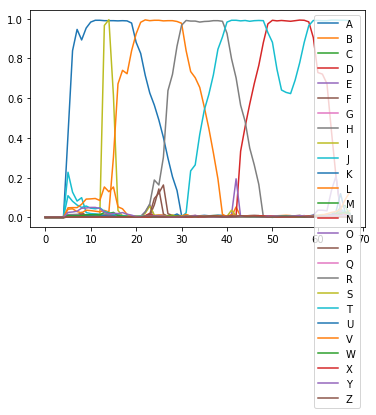

correct: 629 total: 656 accuracy: 0.959 avgEditDist 0.049
('A', 'A'): 277
('S', 'S'): 141
('E', 'E'): 321
('T', 'T'): 165
('H', 'H'): 94
('D', 'D'): 137
('K', 'K'): 51
('N', 'N'): 196
('L', 'L'): 148
('R', 'R'): 228
('O', 'O'): 178
('V', 'V'): 132
('B', 'B'): 42
('C', 'C'): 87
('G', 'G'): 64
('P', 'P'): 61
('I', 'I'): 128
('F', 'F'): 41
('W', 'W'): 54
-------('H', 'R'): 2
('U', 'U'): 44
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 32
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.00177846 0.00127474 0.00119123 ... 0.00121368 0.05108391 0.00093227]
 [0.0016887  0.00108151 0.0010869  ... 0.0017043  0.06960462 0.00081502]
 [0.00198952 0.0011728  0.00141883 ... 0.00214558 0.06580761 0.0008172 ]
 ...
 [0.0012361  0.00077909 0.00140916 ... 0.00101616 0.01896559 0.00090673]
 [0.00131986 0.00089525 0

SM SM
edit distance: 0
correct: 631 total: 658 accuracy: 0.959 avgEditDist 0.049
('A', 'A'): 277
('S', 'S'): 143
('E', 'E'): 321
('T', 'T'): 166
('H', 'H'): 94
('D', 'D'): 137
('K', 'K'): 51
('N', 'N'): 197
('L', 'L'): 148
('R', 'R'): 228
('O', 'O'): 178
('V', 'V'): 133
('B', 'B'): 42
('C', 'C'): 87
('G', 'G'): 64
('P', 'P'): 61
('I', 'I'): 129
('F', 'F'): 41
('W', 'W'): 54
-------('H', 'R'): 2
('U', 'U'): 44
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 33
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.00327466 0.00113792 0.00293146 ... 0.00263294 0.05491072 0.00106911]
 [0.00401523 0.00126975 0.00333273 ... 0.00326138 0.0400962  0.00135837]
 [0.0043007  0.00130369 0.00336762 ... 0.00298359 0.04694238 0.00147143]
 ...
 [0.00167078 0.00112743 0.00189507 ... 0.00135797 0.01892002 0.00137478]
 [

OWS OWS
edit distance: 0
correct: 633 total: 660 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 277
('S', 'S'): 145
('E', 'E'): 322
('T', 'T'): 166
('H', 'H'): 94
('D', 'D'): 137
('K', 'K'): 51
('N', 'N'): 197
('L', 'L'): 149
('R', 'R'): 228
('O', 'O'): 180
('V', 'V'): 133
('B', 'B'): 42
('C', 'C'): 87
('G', 'G'): 64
('P', 'P'): 61
('I', 'I'): 129
('F', 'F'): 41
('W', 'W'): 55
-------('H', 'R'): 2
('U', 'U'): 44
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 33
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.00155588 0.00101322 0.0017562  ... 0.00109169 0.03049616 0.00154264]
 [0.00159521 0.00104067 0.00186803 ... 0.0012371  0.029255   0.00163225]
 [0.00164726 0.00108807 0.00192531 ... 0.00133203 0.03111321 0.0016396 ]
 ...
 [0.00135495 0.00072789 0.00135369 ... 0.00189699 0.01938993 0.00062122]


EOA EOA
edit distance: 0
correct: 635 total: 662 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 278
('S', 'S'): 145
('E', 'E'): 323
('T', 'T'): 166
('H', 'H'): 94
('D', 'D'): 137
('K', 'K'): 51
('N', 'N'): 197
('L', 'L'): 150
('R', 'R'): 228
('O', 'O'): 182
('V', 'V'): 133
('B', 'B'): 42
('C', 'C'): 87
('G', 'G'): 64
('P', 'P'): 61
('I', 'I'): 129
('F', 'F'): 42
('W', 'W'): 55
-------('H', 'R'): 2
('U', 'U'): 44
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 33
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.00299075 0.00100878 0.00242027 ... 0.00279846 0.04264134 0.00092352]
 [0.00399139 0.00123287 0.0032099  ... 0.00290718 0.04111286 0.00137466]
 [0.00453886 0.00132938 0.00348848 ... 0.00312277 0.04354124 0.00157413]
 ...
 [0.00190222 0.00116068 0.00241782 ... 0.00235685 0.02247495 0.0018317 ]


[[0.00313242 0.00118545 0.00293953 ... 0.00446777 0.03793464 0.00103205]
 [0.00374097 0.00133164 0.00335534 ... 0.0039858  0.03710592 0.00120675]
 [0.00419197 0.00131073 0.00325236 ... 0.00336881 0.04068214 0.00143865]
 ...
 [0.00349191 0.00124993 0.00319846 ... 0.0031266  0.03406661 0.00117001]
 [0.00264251 0.00106816 0.0024893  ... 0.00250662 0.02844064 0.00088457]
 [0.00236213 0.00101464 0.00233074 ... 0.00301032 0.02735718 0.00078932]]
--pred for 0 20 ['S 0.85 ', 'J 0.19 ', 'V 0.13 ', 'T 0.07 ', 'A 0.05 ']
--pred for 0 24 ['S 0.94 ', 'J 0.16 ', 'V 0.13 ', 'T 0.08 ', 'L 0.04 ']
--pred for 0 28 ['S 0.95 ', 'V 0.14 ', 'T 0.09 ', 'L 0.05 ', 'J 0.05 ']
--pred for 0 32 ['S 0.96 ', 'V 0.13 ', 'T 0.09 ', 'J 0.05 ', 'L 0.05 ']
--pred for 0 36 ['S 0.98 ', 'V 0.15 ', 'T 0.07 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 40 ['S 0.99 ', 'V 0.16 ', 'T 0.07 ', 'L 0.05 ', 'J 0.04 ']
--pred for 0 44 ['S 0.99 ', 'V 0.15 ', 'T 0.07 ', 'J 0.04 ', 'L 0.04 ']
--pred for 0 48 ['S 0.99 ', 'V 0.17 ', 'U 0.10 ', 'W

[[2.60260352e-03 1.93524815e-03 2.74649472e-03 2.42650416e-02
  1.87796410e-02 1.20480557e-03 2.94146431e-03 9.20732141e-01
  5.97425876e-03 2.50094011e-03 1.41446320e-02 5.74379740e-03
  6.02314323e-02 2.15536985e-03 4.68918420e-02 5.33665810e-03
  1.62949658e-03 2.27584783e-03 3.20102694e-03 3.47489887e-03
  2.23665009e-03 2.01948383e-03 7.66596496e-02 6.46907743e-03
  1.19961001e-01 1.19603593e-02 1.68068241e-03 3.68688591e-02
  1.48892601e-03]
 [3.20252613e-03 2.22726422e-03 3.32099921e-03 3.38211544e-02
  1.17359534e-02 1.71112805e-03 4.27401206e-03 9.78313625e-01
  6.66088704e-03 3.90974712e-03 1.32158305e-02 5.50434599e-03
  3.87590192e-02 2.57715071e-03 5.02183065e-02 4.64184349e-03
  1.85348908e-03 2.92876572e-03 3.49180331e-03 4.15085768e-03
  2.59634270e-03 2.69572879e-03 9.27603021e-02 9.67855379e-03
  1.07899316e-01 1.43380817e-02 2.20366358e-03 3.84751186e-02
  1.90594222e-03]
 [3.28116096e-03 2.36125290e-03 3.53089441e-03 3.61355767e-02
  1.14066331e-02 1.95825426e-03 5.

[[2.71638529e-03 1.97367393e-03 2.77794339e-03 2.18967590e-02
  1.32839456e-02 1.16467651e-03 2.30750721e-03 9.64237750e-01
  9.44539998e-03 2.83330702e-03 1.49383536e-02 5.72976051e-03
  7.26866052e-02 2.26571760e-03 3.85342725e-02 4.61175386e-03
  1.76456466e-03 1.94969354e-03 3.01456964e-03 3.36246169e-03
  2.38848175e-03 2.83788843e-03 7.10444450e-02 7.38936849e-03
  1.36719391e-01 1.18059693e-02 1.87842560e-03 4.22751792e-02
  1.40449987e-03]
 [2.91076652e-03 2.04344722e-03 2.96556274e-03 3.13490666e-02
  1.22660985e-02 1.44586840e-03 2.64044944e-03 9.83682334e-01
  9.24366247e-03 3.57931596e-03 1.38228592e-02 5.54829370e-03
  4.93925028e-02 2.36015581e-03 3.79523598e-02 4.42723650e-03
  2.19580042e-03 2.22739764e-03 2.85320682e-03 3.53247416e-03
  2.09824182e-03 2.67678290e-03 8.99164304e-02 1.00318911e-02
  1.15519598e-01 1.29125705e-02 2.04251311e-03 3.72126512e-02
  1.45902706e-03]
 [3.27048660e-03 2.21083732e-03 3.13512352e-03 3.20006460e-02
  1.08383773e-02 1.62875804e-03 2.

VAGBA VAGBA
edit distance: 0
correct: 643 total: 670 accuracy: 0.960 avgEditDist 0.048
('A', 'A'): 283
('S', 'S'): 150
('E', 'E'): 327
('T', 'T'): 167
('H', 'H'): 94
('D', 'D'): 139
('K', 'K'): 53
('N', 'N'): 197
('L', 'L'): 151
('R', 'R'): 229
('O', 'O'): 183
('V', 'V'): 134
('B', 'B'): 43
('C', 'C'): 88
('G', 'G'): 65
('P', 'P'): 61
('I', 'I'): 130
('F', 'F'): 44
('W', 'W'): 55
-------('H', 'R'): 2
('U', 'U'): 44
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 33
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.00124462 0.00089738 0.00130379 ... 0.00181621 0.04537568 0.00048765]
 [0.00128012 0.00082188 0.00126666 ... 0.00274568 0.03858043 0.00053414]
 [0.00134044 0.00081819 0.0012632  ... 0.00291348 0.03466503 0.00055158]
 ...
 [0.00362247 0.00189055 0.00255587 ... 0.0023671  0.0196039  0.001341

SCPR SCPR
edit distance: 0
correct: 645 total: 672 accuracy: 0.960 avgEditDist 0.048
('A', 'A'): 283
('S', 'S'): 151
('E', 'E'): 328
('T', 'T'): 168
('H', 'H'): 95
('D', 'D'): 139
('K', 'K'): 53
('N', 'N'): 197
('L', 'L'): 151
('R', 'R'): 230
('O', 'O'): 183
('V', 'V'): 134
('B', 'B'): 43
('C', 'C'): 89
('G', 'G'): 65
('P', 'P'): 63
('I', 'I'): 130
('F', 'F'): 44
('W', 'W'): 56
-------('H', 'R'): 2
('U', 'U'): 44
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 33
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[1.48209918e-03 1.14918896e-03 2.04877346e-03 1.52416993e-02
  4.67870152e-03 1.86604308e-03 4.66736034e-02 1.40496101e-02
  3.41147184e-03 1.34850980e-03 7.85269402e-03 9.76958871e-03
  2.62571536e-02 1.29942561e-03 2.72847205e-01 2.84633855e-03
  1.16656907e-03 2.06367834e-03 2.72911810e-03 

NDSWPE NDSWPE
edit distance: 0
correct: 647 total: 674 accuracy: 0.960 avgEditDist 0.047
('A', 'A'): 283
('S', 'S'): 152
('E', 'E'): 329
('T', 'T'): 168
('H', 'H'): 95
('D', 'D'): 141
('K', 'K'): 53
('N', 'N'): 198
('L', 'L'): 151
('R', 'R'): 230
('O', 'O'): 183
('V', 'V'): 134
('B', 'B'): 43
('C', 'C'): 89
('G', 'G'): 65
('P', 'P'): 64
('I', 'I'): 131
('F', 'F'): 44
('W', 'W'): 57
-------('H', 'R'): 2
('U', 'U'): 44
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 33
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.00172859 0.00110348 0.00168804 ... 0.00097875 0.03198265 0.00063589]
 [0.00107239 0.00098073 0.00152602 ... 0.00088358 0.02538682 0.00038546]
 [0.00098628 0.00093815 0.00151542 ... 0.00100554 0.02271731 0.00041233]
 ...
 [0.00154518 0.00104284 0.00179377 ... 0.00112002 0.01587051 0.0014

[[1.65611180e-03 1.21051981e-03 1.83600502e-03 1.06848761e-01
  3.73239047e-03 2.22676387e-03 3.03990673e-03 1.50560006e-03
  4.18988662e-03 2.03437638e-03 1.42192505e-02 3.16369254e-03
  7.77563334e-01 1.27071736e-03 1.72630548e-02 2.11554859e-03
  1.62969122e-03 4.14924510e-03 3.41155799e-03 1.70169014e-03
  1.62651204e-03 2.12077145e-03 1.25189185e-01 7.19316537e-03
  3.58694978e-02 9.06306319e-03 1.45205378e-03 2.06753872e-02
  8.06029188e-04]
 [1.92199880e-03 1.06548273e-03 1.62383728e-03 6.43423021e-01
  3.49530415e-03 1.33500784e-03 2.38901563e-03 1.34349824e-03
  4.83967643e-03 1.83558208e-03 1.38685117e-02 3.15656210e-03
  1.43888071e-01 1.26282417e-03 3.99133451e-02 1.38654979e-03
  1.76895189e-03 2.19835620e-03 2.13352428e-03 2.03326740e-03
  9.79973236e-04 1.45659631e-03 9.87230390e-02 9.71195195e-03
  3.39080207e-02 9.20585543e-03 1.04896084e-03 2.35380027e-02
  7.78444170e-04]
 [1.88317883e-03 1.10266218e-03 1.47391623e-03 6.23776138e-01
  4.67842631e-03 1.08938746e-03 2.

EIGPLD EIGPLD
edit distance: 0
correct: 650 total: 677 accuracy: 0.960 avgEditDist 0.047
('A', 'A'): 284
('S', 'S'): 152
('E', 'E'): 330
('T', 'T'): 168
('H', 'H'): 95
('D', 'D'): 142
('K', 'K'): 53
('N', 'N'): 200
('L', 'L'): 153
('R', 'R'): 230
('O', 'O'): 184
('V', 'V'): 135
('B', 'B'): 43
('C', 'C'): 89
('G', 'G'): 66
('P', 'P'): 65
('I', 'I'): 132
('F', 'F'): 44
('W', 'W'): 58
-------('H', 'R'): 2
('U', 'U'): 44
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 33
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.001552   0.00152892 0.00109164 ... 0.0011596  0.04562481 0.00088583]
 [0.00151641 0.00169717 0.00126121 ... 0.00075929 0.05448698 0.00122723]
 [0.00223236 0.00364416 0.00229772 ... 0.00086735 0.02923038 0.00209322]
 ...
 [0.00311835 0.00229738 0.00145604 ... 0.00220877 0.02721956 0.0024

LA LA
edit distance: 0
correct: 652 total: 679 accuracy: 0.960 avgEditDist 0.047
('A', 'A'): 285
('S', 'S'): 153
('E', 'E'): 331
('T', 'T'): 168
('H', 'H'): 95
('D', 'D'): 142
('K', 'K'): 53
('N', 'N'): 200
('L', 'L'): 154
('R', 'R'): 232
('O', 'O'): 184
('V', 'V'): 135
('B', 'B'): 43
('C', 'C'): 89
('G', 'G'): 66
('P', 'P'): 65
('I', 'I'): 133
('F', 'F'): 44
('W', 'W'): 58
-------('H', 'R'): 2
('U', 'U'): 44
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 33
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.00132432 0.00089596 0.00132024 ... 0.0025878  0.04230975 0.0006037 ]
 [0.00137328 0.00089788 0.00133273 ... 0.00301866 0.03917938 0.00059831]
 [0.00137183 0.00091104 0.00132089 ... 0.0030703  0.03582278 0.00061107]
 ...
 [0.00141777 0.00240007 0.00375932 ... 0.00270026 0.03069322 0.00242395]
 [

BENL BENL
edit distance: 0
correct: 654 total: 681 accuracy: 0.960 avgEditDist 0.047
('A', 'A'): 286
('S', 'S'): 153
('E', 'E'): 332
('T', 'T'): 168
('H', 'H'): 95
('D', 'D'): 142
('K', 'K'): 53
('N', 'N'): 201
('L', 'L'): 155
('R', 'R'): 232
('O', 'O'): 184
('V', 'V'): 135
('B', 'B'): 44
('C', 'C'): 89
('G', 'G'): 66
('P', 'P'): 67
('I', 'I'): 133
('F', 'F'): 44
('W', 'W'): 58
-------('H', 'R'): 2
('U', 'U'): 44
-------('I', '%'): 6
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 33
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.00132011 0.00062596 0.00123486 ... 0.00111793 0.04531494 0.00070497]
 [0.00137016 0.00058187 0.00115776 ... 0.00134964 0.04276671 0.00074767]
 [0.00160238 0.00062797 0.00122401 ... 0.00158766 0.04446893 0.00081826]
 ...
 [0.00147602 0.00103012 0.00138424 ... 0.00128623 0.03464099 0.00069546

['A 1', 'T -2']
T
['A 0.778', 'B 0.002', 'C 0.003', 'D 0.006', 'E 0.001', 'F 0.005', 'G 0.005', 'H 0.007', 'I 0.005', 'J 0.003', 'K 0.003', 'L 0.024', 'M 0.012', 'N 0.006', 'O 0.005', 'P 0.008', 'Q 0.002', 'R 0.001', 'S 0.001', 'T 0.987', 'U 0.003', 'V 0.023', 'W 0.008', 'X 0.002', 'Y 0.004', 'Z 0.001']
['A 2', 'T -1']
T
['A 0.773', 'B 0.002', 'C 0.003', 'D 0.004', 'E 0.002', 'F 0.004', 'G 0.004', 'H 0.004', 'I 0.003', 'J 0.002', 'K 0.002', 'L 0.008', 'M 0.006', 'N 0.006', 'O 0.004', 'P 0.003', 'Q 0.002', 'R 0.001', 'S 0.002', 'T 0.99', 'U 0.002', 'V 0.01', 'W 0.004', 'X 0.003', 'Y 0.003', 'Z 0.001']
['A 3', 'T 0']
T
['A 0.867', 'B 0.001', 'C 0.002', 'D 0.003', 'E 0.003', 'F 0.003', 'G 0.003', 'H 0.002', 'I 0.003', 'J 0.001', 'K 0.003', 'L 0.002', 'M 0.003', 'N 0.006', 'O 0.002', 'P 0.002', 'Q 0.001', 'R 0.001', 'S 0.003', 'T 0.985', 'U 0.001', 'V 0.003', 'W 0.002', 'X 0.002', 'Y 0.002', 'Z 0.001']
['A 4', 'T 1']
A
['A 0.965', 'B 0.001', 'C 0.003', 'D 0.003', 'E 0.003', 'F 0.003', 'G 0

[[0.00151683 0.00091516 0.00149994 ... 0.00093124 0.0310332  0.00059652]
 [0.00104339 0.00083144 0.00154834 ... 0.00097434 0.02779592 0.00045762]
 [0.00108802 0.00087669 0.00158255 ... 0.00104016 0.02308173 0.00046736]
 ...
 [0.00252994 0.00188245 0.00140034 ... 0.00333857 0.03493488 0.00293564]
 [0.00244466 0.0016381  0.0015173  ... 0.00348548 0.02898002 0.00306649]
 [0.00188399 0.00129917 0.0015017  ... 0.00344962 0.02635746 0.00146019]]
--pred for 0 20 ['T 0.53 ', 'V 0.14 ', 'J 0.08 ', 'L 0.05 ', 'I 0.03 ']
--pred for 0 24 ['V 0.16 ', 'M 0.14 ', 'N 0.12 ', 'T 0.11 ', 'J 0.05 ']
--pred for 0 28 ['V 0.19 ', 'M 0.14 ', 'N 0.14 ', 'T 0.10 ', 'J 0.04 ']
--pred for 0 32 ['N 0.66 ', 'V 0.21 ', 'M 0.05 ', 'T 0.05 ', 'J 0.05 ']
--pred for 0 36 ['N 0.99 ', 'V 0.15 ', 'T 0.07 ', 'J 0.05 ', 'L 0.03 ']
--pred for 0 40 ['N 0.99 ', 'V 0.20 ', 'T 0.07 ', 'L 0.05 ', 'U 0.02 ']
--pred for 0 44 ['N 0.99 ', 'V 0.20 ', 'T 0.07 ', 'L 0.04 ', 'U 0.03 ']
--pred for 0 48 ['N 0.99 ', 'V 0.24 ', 'U 0.13 ', 'W

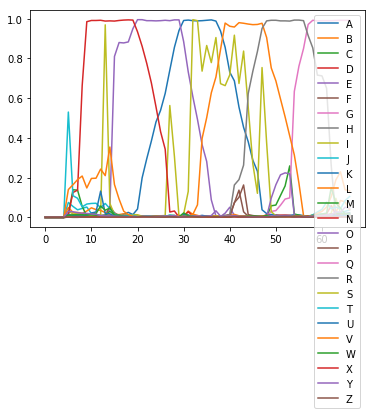

correct: 657 total: 685 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 288
('S', 'S'): 156
('E', 'E'): 333
('T', 'T'): 169
('H', 'H'): 97
('D', 'D'): 142
('K', 'K'): 53
('N', 'N'): 203
('L', 'L'): 157
('R', 'R'): 234
('O', 'O'): 185
('V', 'V'): 136
('B', 'B'): 44
('C', 'C'): 89
('G', 'G'): 67
('P', 'P'): 67
('I', 'I'): 133
('F', 'F'): 44
('W', 'W'): 59
-------('H', 'R'): 2
('U', 'U'): 45
-------('I', '%'): 7
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 33
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.00162154 0.00084053 0.0015012  ... 0.00187054 0.03535769 0.00069976]
 [0.00171856 0.00096865 0.00192499 ... 0.00254312 0.04447994 0.00095414]
 [0.00188424 0.001101   0.00226905 ... 0.00247239 0.04853333 0.00118277]
 ...
 [0.00134792 0.00203561 0.00321299 ... 0.00275755 0.02699032 0.00209312]
 [0.00125379 0.00177313 0

IS IS
edit distance: 0
correct: 659 total: 687 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 288
('S', 'S'): 157
('E', 'E'): 333
('T', 'T'): 169
('H', 'H'): 97
('D', 'D'): 142
('K', 'K'): 53
('N', 'N'): 203
('L', 'L'): 157
('R', 'R'): 234
('O', 'O'): 186
('V', 'V'): 136
('B', 'B'): 44
('C', 'C'): 90
('G', 'G'): 67
('P', 'P'): 68
('I', 'I'): 134
('F', 'F'): 44
('W', 'W'): 59
-------('H', 'R'): 2
('U', 'U'): 45
-------('I', '%'): 7
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 33
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.00124364 0.0008734  0.00124897 ... 0.00184686 0.05372585 0.0005498 ]
 [0.00137233 0.00097751 0.00128002 ... 0.00236952 0.04397434 0.00061433]
 [0.00156927 0.00105214 0.00134609 ... 0.00260514 0.03995798 0.00067307]
 ...
 [0.00159066 0.00115631 0.00157317 ... 0.00149589 0.04495287 0.00078489]
 [

[[0.00140442 0.00110884 0.00099562 ... 0.00097748 0.02593489 0.00051215]
 [0.00117913 0.00092028 0.00078516 ... 0.001028   0.0245578  0.00049739]
 [0.00114197 0.00095877 0.00087092 ... 0.00127676 0.02355351 0.00055359]
 ...
 [0.00219497 0.00127813 0.00212687 ... 0.00188615 0.01605309 0.00179383]
 [0.0018253  0.00103744 0.00181748 ... 0.00145863 0.01478194 0.0011917 ]
 [0.00181811 0.00108323 0.00196137 ... 0.00154735 0.01730119 0.00110747]]
--pred for 0 20 ['I 0.92 ', 'V 0.22 ', 'T 0.14 ', 'J 0.10 ', 'U 0.05 ']
--pred for 0 24 ['I 0.98 ', 'V 0.32 ', 'U 0.12 ', 'T 0.12 ', 'J 0.04 ']
--pred for 0 28 ['I 0.96 ', 'V 0.32 ', 'U 0.13 ', 'T 0.10 ', 'H 0.03 ']
--pred for 0 32 ['I 0.97 ', 'C 0.49 ', 'V 0.30 ', 'T 0.09 ', 'L 0.04 ']
--pred for 0 36 ['I 0.99 ', 'C 0.93 ', 'V 0.25 ', 'T 0.07 ', 'L 0.05 ']
--pred for 0 40 ['I 0.98 ', 'C 0.96 ', 'V 0.19 ', 'T 0.07 ', 'M 0.05 ']
--pred for 0 44 ['C 0.99 ', 'I 0.98 ', 'V 0.17 ', 'T 0.07 ', 'Y 0.05 ']
--pred for 0 48 ['O 0.99 ', 'I 0.99 ', 'V 0.15 ', 'T

[[0.00152409 0.00084989 0.00152821 ... 0.00174432 0.03652407 0.0007684 ]
 [0.0017307  0.00098746 0.00188751 ... 0.00208254 0.04317629 0.0009604 ]
 [0.00186726 0.00112658 0.00225058 ... 0.00263337 0.04694907 0.00126442]
 ...
 [0.00153756 0.00120901 0.00159443 ... 0.00166951 0.03482364 0.00087832]
 [0.00149007 0.00112932 0.00144608 ... 0.00146721 0.04080947 0.0008154 ]
 [0.00143493 0.00102422 0.00140857 ... 0.00125574 0.05204716 0.00073392]]
--pred for 0 20 ['V 0.09 ', 'T 0.09 ', 'C 0.07 ', 'J 0.05 ', 'Y 0.04 ']
--pred for 0 24 ['C 0.28 ', 'T 0.10 ', 'V 0.09 ', 'J 0.05 ', 'Y 0.04 ']
--pred for 0 28 ['C 0.87 ', 'T 0.11 ', 'V 0.09 ', 'Y 0.05 ', 'J 0.04 ']
--pred for 0 32 ['C 0.98 ', 'T 0.11 ', 'V 0.11 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 36 ['C 0.99 ', 'V 0.11 ', 'T 0.09 ', 'Y 0.06 ', 'L 0.06 ']
--pred for 0 40 ['O 0.99 ', 'V 0.15 ', 'T 0.09 ', 'Y 0.05 ', 'J 0.03 ']
--pred for 0 44 ['O 0.99 ', 'V 0.17 ', 'T 0.09 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 48 ['O 1.00 ', 'V 0.16 ', 'T 0.08 ', 'I

[[0.00140042 0.00072092 0.00123975 ... 0.00108491 0.03706145 0.00052354]
 [0.00142873 0.00072243 0.00130583 ... 0.0011668  0.03749257 0.00057353]
 [0.00144356 0.0007327  0.00131151 ... 0.00117872 0.04070362 0.00069574]
 ...
 [0.0012437  0.00091804 0.00131544 ... 0.00134049 0.036741   0.00057419]
 [0.0013731  0.00097015 0.00139935 ... 0.0013278  0.0622832  0.00063334]
 [0.00124335 0.00095306 0.00130961 ... 0.00125745 0.03722494 0.00061708]]
--pred for 0 20 ['J 0.20 ', 'V 0.12 ', 'T 0.07 ', 'L 0.05 ', 'U 0.05 ']
--pred for 0 24 ['J 0.13 ', 'L 0.11 ', 'V 0.10 ', 'U 0.06 ', 'T 0.06 ']
--pred for 0 28 ['L 0.30 ', 'V 0.10 ', 'T 0.08 ', 'J 0.07 ', 'U 0.05 ']
--pred for 0 32 ['L 0.63 ', 'V 0.11 ', 'J 0.07 ', 'T 0.07 ', 'Y 0.04 ']
--pred for 0 36 ['L 0.46 ', 'J 0.21 ', 'U 0.12 ', 'V 0.10 ', 'C 0.08 ']
--pred for 0 40 ['U 0.99 ', 'V 0.15 ', 'T 0.06 ', 'Y 0.04 ', 'J 0.03 ']
--pred for 0 44 ['U 0.99 ', 'V 0.12 ', 'T 0.05 ', 'Y 0.04 ', 'J 0.03 ']
--pred for 0 48 ['U 0.99 ', 'J 0.09 ', 'V 0.06 ', 'Y

[[2.87228636e-03 2.14193831e-03 2.43977597e-03 1.84060708e-02
  1.38802687e-02 1.02760084e-03 1.94551609e-03 9.02668357e-01
  9.43570584e-03 2.03807326e-03 1.56426802e-02 9.88026243e-03
  5.44025339e-02 2.04196596e-03 2.98477449e-02 6.36110781e-03
  2.08984804e-03 1.56732521e-03 5.00517618e-03 3.42087774e-03
  1.66447200e-02 1.92999456e-03 7.04834387e-02 6.65904209e-03
  1.41519234e-01 1.14601282e-02 1.66722515e-03 4.25386317e-02
  1.41224149e-03]
 [3.05138109e-03 2.08306592e-03 2.99303816e-03 3.45439836e-02
  1.78781524e-02 1.43817090e-03 2.60573067e-03 9.83572066e-01
  7.31998170e-03 3.39713367e-03 1.44418115e-02 5.42177493e-03
  2.94343103e-02 2.07788241e-03 3.27054299e-02 3.99034470e-03
  2.29569478e-03 2.22919253e-03 3.25698522e-03 3.64895188e-03
  4.07786900e-03 2.65327399e-03 8.24222043e-02 9.21488088e-03
  1.19205631e-01 1.39553687e-02 1.98336365e-03 3.53732258e-02
  1.68942101e-03]
 [3.18722660e-03 2.13580346e-03 3.07044107e-03 3.73141505e-02
  1.68776158e-02 1.47693348e-03 2.

RDR RDR
edit distance: 0
correct: 669 total: 697 accuracy: 0.960 avgEditDist 0.047
('A', 'A'): 291
('S', 'S'): 158
('E', 'E'): 336
('T', 'T'): 169
('H', 'H'): 103
('D', 'D'): 146
('K', 'K'): 53
('N', 'N'): 204
('L', 'L'): 160
('R', 'R'): 239
('O', 'O'): 190
('V', 'V'): 136
('B', 'B'): 46
('C', 'C'): 91
('G', 'G'): 68
('P', 'P'): 69
('I', 'I'): 135
('F', 'F'): 44
('W', 'W'): 60
-------('H', 'R'): 2
('U', 'U'): 46
-------('I', '%'): 7
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 33
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.00099066 0.00086631 0.00148764 ... 0.0009274  0.02610324 0.00042175]
 [0.00091047 0.00085178 0.00151734 ... 0.00096303 0.02227852 0.00045273]
 [0.00143729 0.00103439 0.00169031 ... 0.00147619 0.02181208 0.00074491]
 ...
 [0.00302917 0.00205367 0.00312381 ... 0.00209707 0.02753332 0.00163864]

VB VB
edit distance: 0
correct: 671 total: 699 accuracy: 0.960 avgEditDist 0.047
('A', 'A'): 291
('S', 'S'): 158
('E', 'E'): 337
('T', 'T'): 170
('H', 'H'): 103
('D', 'D'): 146
('K', 'K'): 53
('N', 'N'): 205
('L', 'L'): 161
('R', 'R'): 240
('O', 'O'): 190
('V', 'V'): 137
('B', 'B'): 47
('C', 'C'): 91
('G', 'G'): 68
('P', 'P'): 69
('I', 'I'): 135
('F', 'F'): 44
('W', 'W'): 61
-------('H', 'R'): 2
('U', 'U'): 46
-------('I', '%'): 7
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 33
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.00100216 0.00087063 0.00143009 ... 0.00091047 0.02538629 0.00037958]
 [0.0009039  0.00088243 0.00140858 ... 0.00108041 0.01908616 0.00039974]
 [0.00094026 0.00097073 0.00145345 ... 0.0013141  0.01808544 0.00047074]
 ...
 [0.00219838 0.00114791 0.00159519 ... 0.00139571 0.01588606 0.0013013 ]
 

DAPRF DAPRF
edit distance: 0
correct: 673 total: 701 accuracy: 0.960 avgEditDist 0.047
('A', 'A'): 293
('S', 'S'): 158
('E', 'E'): 337
('T', 'T'): 171
('H', 'H'): 103
('D', 'D'): 148
('K', 'K'): 53
('N', 'N'): 205
('L', 'L'): 161
('R', 'R'): 241
('O', 'O'): 190
('V', 'V'): 137
('B', 'B'): 47
('C', 'C'): 91
('G', 'G'): 68
('P', 'P'): 70
('I', 'I'): 135
('F', 'F'): 45
('W', 'W'): 61
-------('H', 'R'): 2
('U', 'U'): 46
-------('I', '%'): 7
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 34
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[0.0027427  0.00097758 0.00232093 ... 0.00296999 0.04208073 0.00089435]
 [0.00361653 0.00115744 0.00292542 ... 0.00288154 0.04408088 0.00122857]
 [0.00408053 0.00122563 0.00305852 ... 0.0027161  0.04180212 0.00140145]
 ...
 [0.00086243 0.00105906 0.00146769 ... 0.00105153 0.01817893 0.00043

VS VS
edit distance: 0
correct: 675 total: 703 accuracy: 0.960 avgEditDist 0.047
('A', 'A'): 293
('S', 'S'): 160
('E', 'E'): 338
('T', 'T'): 172
('H', 'H'): 103
('D', 'D'): 149
('K', 'K'): 53
('N', 'N'): 205
('L', 'L'): 161
('R', 'R'): 242
('O', 'O'): 190
('V', 'V'): 138
('B', 'B'): 47
('C', 'C'): 91
('G', 'G'): 68
('P', 'P'): 70
('I', 'I'): 135
('F', 'F'): 45
('W', 'W'): 61
-------('H', 'R'): 2
('U', 'U'): 46
-------('I', '%'): 7
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 35
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 1
[[1.62538246e-03 1.08536833e-03 1.73417653e-03 8.50935932e-03
  3.17891734e-03 1.25653169e-03 2.21222010e-03 2.47356785e-03
  5.75213600e-03 1.37901260e-03 1.47974286e-02 5.74000850e-02
  7.95770362e-02 1.25852483e-03 4.64037135e-02 1.99825242e-02
  4.04907390e-02 4.76432545e-03 3.99049092e-03 2.3

ARVAR ARVASR
edit distance: 1


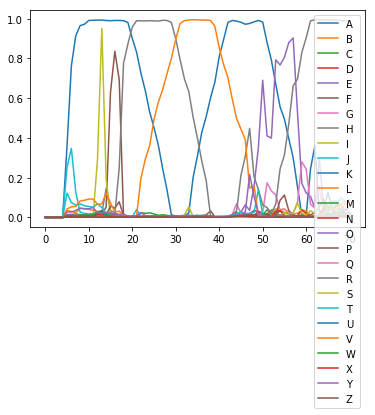

correct: 676 total: 705 accuracy: 0.959 avgEditDist 0.048
('A', 'A'): 296
('S', 'S'): 160
('E', 'E'): 338
('T', 'T'): 172
('H', 'H'): 103
('D', 'D'): 149
('K', 'K'): 53
('N', 'N'): 206
('L', 'L'): 161
('R', 'R'): 244
('O', 'O'): 190
('V', 'V'): 139
('B', 'B'): 47
('C', 'C'): 91
('G', 'G'): 68
('P', 'P'): 70
('I', 'I'): 135
('F', 'F'): 45
('W', 'W'): 61
-------('H', 'R'): 2
('U', 'U'): 46
-------('I', '%'): 7
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 35
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00141415 0.00069649 0.00115621 ... 0.00099571 0.03359039 0.00051313]
 [0.00139045 0.00072584 0.00121974 ... 0.00095969 0.03658906 0.00068184]
 [0.00138321 0.00070597 0.00124121 ... 0.00104504 0.03537516 0.00077974]
 ...
 [0.00150468 0.00065542 0.00127983 ... 0.00117794 0.02239185 0.00076205]
 [0.00145362 0.00077176 

KDIWIIE KDIWIE
edit distance: 1


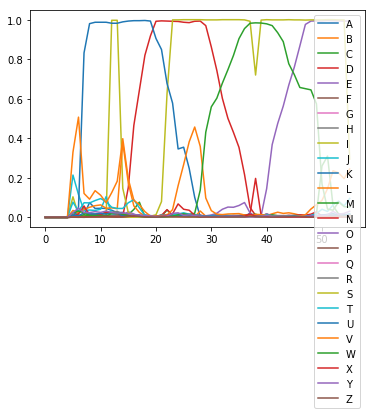

correct: 677 total: 707 accuracy: 0.958 avgEditDist 0.050
('A', 'A'): 296
('S', 'S'): 160
('E', 'E'): 341
('T', 'T'): 172
('H', 'H'): 103
('D', 'D'): 150
('K', 'K'): 54
('N', 'N'): 207
('L', 'L'): 161
('R', 'R'): 244
('O', 'O'): 190
('V', 'V'): 139
('B', 'B'): 47
('C', 'C'): 91
('G', 'G'): 68
('P', 'P'): 70
('I', 'I'): 138
('F', 'F'): 45
('W', 'W'): 62
-------('H', 'R'): 2
('U', 'U'): 47
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 36
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00193042 0.00122189 0.00148289 ... 0.0022018  0.04106582 0.00079643]
 [0.00192164 0.00123225 0.00137693 ... 0.00250969 0.03437721 0.00072352]
 [0.00305693 0.00177544 0.0015036  ... 0.002556   0.03181298 0.0012591 ]
 ...
 [0.00098799 0.00066237 0.00121418 ... 0.00077674 0.01751857 0.00089193]
 [0.0013339  0.00090391 

INPEM INPEM
edit distance: 0
correct: 679 total: 709 accuracy: 0.958 avgEditDist 0.049
('A', 'A'): 296
('S', 'S'): 161
('E', 'E'): 342
('T', 'T'): 172
('H', 'H'): 103
('D', 'D'): 150
('K', 'K'): 54
('N', 'N'): 209
('L', 'L'): 161
('R', 'R'): 246
('O', 'O'): 190
('V', 'V'): 140
('B', 'B'): 47
('C', 'C'): 91
('G', 'G'): 68
('P', 'P'): 71
('I', 'I'): 139
('F', 'F'): 45
('W', 'W'): 63
-------('H', 'R'): 2
('U', 'U'): 47
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 37
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 2
[[3.26824305e-03 2.34241365e-03 3.03904573e-03 2.38021892e-02
  1.17558530e-02 1.74798805e-03 2.24924320e-03 9.67502236e-01
  9.40574054e-03 3.66592151e-03 1.63265206e-02 5.33766113e-03
  1.19798608e-01 2.63600401e-03 3.57719027e-02 4.67485515e-03
  1.90260459e-03 3.08996532e-03 3.49870534e-

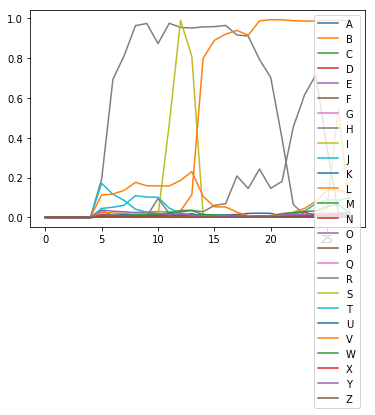

correct: 680 total: 711 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 296
('S', 'S'): 161
('E', 'E'): 343
('T', 'T'): 172
('H', 'H'): 103
('D', 'D'): 150
('K', 'K'): 54
('N', 'N'): 209
('L', 'L'): 163
('R', 'R'): 246
('O', 'O'): 190
('V', 'V'): 140
('B', 'B'): 47
('C', 'C'): 91
('G', 'G'): 68
('P', 'P'): 71
('I', 'I'): 139
('F', 'F'): 45
('W', 'W'): 63
-------('H', 'R'): 3
('U', 'U'): 47
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 37
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 1
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00280424 0.00091198 0.00200445 ... 0.00245306 0.04432387 0.00086253]
 [0.00358076 0.0011215  0.00263598 ... 0.00300974 0.0399465  0.00111738]
 [0.00406249 0.0011768  0.00295766 ... 0.00278382 0.04165677 0.00131124]
 ...
 [0.00152154 0.00113283 0.00187098 ... 0.00112972 0.01954051 0.00191918]
 [0.0016021  0.00101532 

[[2.28004321e-03 1.29518320e-03 1.64492952e-03 6.25798805e-03
  3.84782394e-03 8.72702629e-04 2.45269900e-03 1.28249144e-02
  5.30521292e-03 1.22169568e-03 1.30876862e-02 6.41050609e-03
  8.49207118e-02 1.42033596e-03 8.26239139e-02 3.86352860e-03
  1.75033942e-01 1.08874997e-03 2.43567443e-03 2.31646164e-03
  3.86622772e-02 9.32119030e-04 8.66867378e-02 9.35449824e-03
  9.69800502e-02 2.42255144e-02 1.27628550e-03 2.71943621e-02
  1.79471006e-03]
 [2.11744779e-03 1.67900475e-03 1.53422984e-03 6.41519716e-03
  3.80317681e-03 1.06677937e-03 5.36568509e-03 1.44904172e-02
  5.83470007e-03 1.36439898e-03 1.33546079e-02 5.26903570e-03
  3.19524705e-02 1.28248008e-03 1.57712951e-01 2.14869389e-03
  1.43728359e-02 9.34962591e-04 3.44414590e-03 2.50250241e-03
  5.43010116e-01 1.01072830e-03 7.60258064e-02 9.12558101e-03
  1.24229558e-01 2.50744428e-02 1.53589470e-03 3.46304253e-02
  6.03422010e-03]
 [1.89405854e-03 1.76919613e-03 1.83257565e-03 6.82986807e-03
  5.70161548e-03 2.13563279e-03 1.

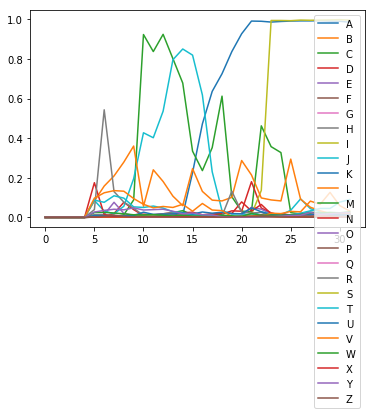

correct: 682 total: 714 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 298
('S', 'S'): 162
('E', 'E'): 343
('T', 'T'): 172
('H', 'H'): 103
('D', 'D'): 151
('K', 'K'): 54
('N', 'N'): 209
('L', 'L'): 165
('R', 'R'): 246
('O', 'O'): 190
('V', 'V'): 140
('B', 'B'): 47
('C', 'C'): 91
('G', 'G'): 68
('P', 'P'): 71
('I', 'I'): 140
('F', 'F'): 45
('W', 'W'): 63
-------('H', 'R'): 3
('U', 'U'): 47
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 37
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00198214 0.0012748  0.0014556  ... 0.00220183 0.04810733 0.00094951]
 [0.0017674  0.00126508 0.00143417 ... 0.0020332  0.03986982 0.0009217 ]
 [0.00224527 0.00147728 0.00151686 ... 0.00218816 0.03588212 0.00116203]
 ...
 [0.0015767  0.00088997 0.00117804 ... 0.00108125 0.01552961 0.00083582]
 [0.00176031 0.00083176 

LNFDFA LNFDFA
edit distance: 0
correct: 684 total: 716 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 299
('S', 'S'): 162
('E', 'E'): 343
('T', 'T'): 173
('H', 'H'): 103
('D', 'D'): 152
('K', 'K'): 54
('N', 'N'): 210
('L', 'L'): 167
('R', 'R'): 247
('O', 'O'): 190
('V', 'V'): 140
('B', 'B'): 47
('C', 'C'): 92
('G', 'G'): 68
('P', 'P'): 71
('I', 'I'): 140
('F', 'F'): 47
('W', 'W'): 63
-------('H', 'R'): 3
('U', 'U'): 47
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 37
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00117821 0.00082457 0.00127677 ... 0.00243212 0.0394323  0.00051674]
 [0.00134142 0.00088094 0.00131734 ... 0.00334536 0.03109272 0.00056955]
 [0.00138142 0.00086249 0.00128377 ... 0.00349055 0.02897325 0.00058691]
 ...
 [0.00128632 0.00087397 0.00165078 ... 0.0022392  0.01959656 0.000

--pred for 76 148 ['R 0.98 ', 'E 0.98 ', 'A 0.18 ', 'Y 0.01 ', 'N 0.01 ']
--pred for 80 152 ['R 0.99 ', 'E 0.93 ', 'A 0.23 ', 'P 0.01 ', 'N 0.01 ']
--pred for 84 156 ['R 0.99 ', 'E 0.82 ', 'A 0.32 ', 'N 0.01 ', 'P 0.01 ']
--pred for 88 160 ['R 0.98 ', 'E 0.62 ', 'A 0.41 ', 'P 0.01 ', 'N 0.01 ']
--pred for 92 164 ['R 0.98 ', 'E 0.51 ', 'A 0.50 ', 'P 0.01 ', 'N 0.01 ']
--pred for 96 168 ['R 0.99 ', 'A 0.61 ', 'E 0.39 ', 'P 0.01 ', 'N 0.01 ']
--pred for 100 172 ['R 0.99 ', 'A 0.76 ', 'E 0.27 ', 'N 0.01 ', 'P 0.01 ']
--pred for 104 176 ['R 0.98 ', 'A 0.87 ', 'E 0.17 ', 'C 0.01 ', 'L 0.01 ']
--pred for 108 180 ['R 0.97 ', 'A 0.95 ', 'T 0.01 ', 'G 0.00 ', 'I 0.00 ']
--pred for 112 184 ['A 0.99 ', 'R 0.87 ', 'I 0.01 ', 'F 0.01 ', 'T 0.01 ']
--pred for 116 187 ['A 0.99 ', 'R 0.72 ', 'F 0.01 ', 'V 0.01 ', 'T 0.01 ']
--pred for 120 187 ['A 0.99 ', 'R 0.69 ', 'V 0.02 ', 'T 0.02 ', 'F 0.01 ']
--pred for 124 187 ['A 0.99 ', 'R 0.63 ', 'V 0.02 ', 'T 0.02 ', 'F 0.02 ']
--pred for 128 187 ['A 0.99 ', 

KA KA
edit distance: 0
correct: 688 total: 720 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 303
('S', 'S'): 162
('E', 'E'): 344
('T', 'T'): 173
('H', 'H'): 103
('D', 'D'): 153
('K', 'K'): 55
('N', 'N'): 210
('L', 'L'): 167
('R', 'R'): 252
('O', 'O'): 191
('V', 'V'): 141
('B', 'B'): 48
('C', 'C'): 93
('G', 'G'): 68
('P', 'P'): 71
('I', 'I'): 140
('F', 'F'): 48
('W', 'W'): 63
-------('H', 'R'): 3
('U', 'U'): 47
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 37
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 1
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.0014788  0.00162877 0.00112924 ... 0.00114334 0.05617487 0.00096172]
 [0.0012486  0.0012908  0.00093665 ... 0.00107031 0.06654602 0.00077257]
 [0.00122363 0.00136696 0.00096737 ... 0.00250019 0.02807295 0.00052769]
 ...
 [0.00099618 0.00063361 0.00121173 ... 0.00180848 0.02390741 0.00078736]
 

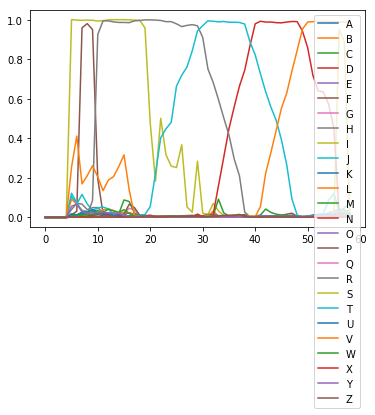

correct: 688 total: 721 accuracy: 0.954 avgEditDist 0.053
('A', 'A'): 303
('S', 'S'): 162
('E', 'E'): 344
('T', 'T'): 174
('H', 'H'): 103
('D', 'D'): 153
('K', 'K'): 55
('N', 'N'): 211
('L', 'L'): 167
('R', 'R'): 253
('O', 'O'): 191
('V', 'V'): 142
('B', 'B'): 48
('C', 'C'): 93
('G', 'G'): 68
('P', 'P'): 71
('I', 'I'): 141
('F', 'F'): 48
('W', 'W'): 63
-------('H', 'R'): 3
('U', 'U'): 47
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 37
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.50196941e-03 9.40638711e-04 1.62293157e-03 1.26878601e-02
  4.56417678e-03 1.23780710e-03 4.25672252e-03 2.03743693e-03
  3.46966810e-03 1.59994420e-03 9.04013868e-03 1.00918021e-02
  2.99644750e-02 1.49455038e-03 8.50206316e-01 4.57369909e-03
  2.14019115e-03 2.13567843e-03 2.14426429e-03 2.85720080e-03
  2.3636310

[[0.00165412 0.00133949 0.00234925 ... 0.00127508 0.0336307  0.00272257]
 [0.00171023 0.00170783 0.00307636 ... 0.00171686 0.04048819 0.00336518]
 [0.00179861 0.00182757 0.00371969 ... 0.00221232 0.04554785 0.00366489]
 ...
 [0.00171207 0.00130919 0.00274175 ... 0.00340412 0.02631362 0.0012342 ]
 [0.00157587 0.00102955 0.00217157 ... 0.00529078 0.02371417 0.00093656]
 [0.00162686 0.00107057 0.00231802 ... 0.00513499 0.02409041 0.00087386]]
--pred for 0 20 ['L 0.18 ', 'T 0.16 ', 'V 0.12 ', 'D 0.11 ', 'Y 0.03 ']
--pred for 0 24 ['D 0.46 ', 'T 0.16 ', 'V 0.13 ', 'L 0.10 ', 'Y 0.04 ']
--pred for 0 28 ['D 0.80 ', 'T 0.16 ', 'V 0.13 ', 'L 0.09 ', 'Y 0.05 ']
--pred for 0 32 ['D 0.85 ', 'C 0.23 ', 'T 0.14 ', 'V 0.12 ', 'J 0.08 ']
--pred for 0 36 ['D 0.99 ', 'V 0.15 ', 'T 0.13 ', 'L 0.04 ', 'J 0.03 ']
--pred for 0 40 ['D 0.99 ', 'V 0.16 ', 'T 0.12 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 44 ['D 0.99 ', 'I 0.98 ', 'V 0.19 ', 'T 0.05 ', 'L 0.05 ']
--pred for 0 48 ['I 0.99 ', 'D 0.99 ', 'V 0.17 ', 'L

AESAM AESAM
edit distance: 0
correct: 692 total: 725 accuracy: 0.954 avgEditDist 0.052
('A', 'A'): 305
('S', 'S'): 164
('E', 'E'): 347
('T', 'T'): 174
('H', 'H'): 103
('D', 'D'): 156
('K', 'K'): 55
('N', 'N'): 212
('L', 'L'): 168
('R', 'R'): 254
('O', 'O'): 191
('V', 'V'): 142
('B', 'B'): 48
('C', 'C'): 93
('G', 'G'): 68
('P', 'P'): 71
('I', 'I'): 141
('F', 'F'): 48
('W', 'W'): 63
-------('H', 'R'): 3
('U', 'U'): 47
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 38
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00274401 0.00212553 0.00287413 ... 0.00213664 0.04077116 0.00156648]
 [0.00312214 0.00220386 0.00321556 ... 0.00233763 0.03485822 0.00181809]
 [0.0031559  0.00222432 0.00296377 ... 0.0020239  0.03352734 0.00192041]
 ...
 [0.00107992 0.00199016 0.00223165 ... 0.0021041  0.03003458 0.00059

NNFEN NNFEN
edit distance: 0
correct: 694 total: 727 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 306
('S', 'S'): 164
('E', 'E'): 348
('T', 'T'): 174
('H', 'H'): 103
('D', 'D'): 156
('K', 'K'): 55
('N', 'N'): 215
('L', 'L'): 168
('R', 'R'): 254
('O', 'O'): 191
('V', 'V'): 143
('B', 'B'): 49
('C', 'C'): 94
('G', 'G'): 68
('P', 'P'): 71
('I', 'I'): 142
('F', 'F'): 49
('W', 'W'): 63
-------('H', 'R'): 3
('U', 'U'): 47
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 38
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00098896 0.00087751 0.00154835 ... 0.00096075 0.02613464 0.0004784 ]
 [0.00099833 0.00090447 0.00153759 ... 0.00108375 0.02017253 0.0004662 ]
 [0.00126847 0.00101542 0.0016188  ... 0.00125982 0.02133495 0.00060884]
 ...
 [0.00276643 0.0017874  0.00213818 ... 0.00218211 0.04760601 0.00110

--pred for 56 128 ['S 0.98 ', 'O 0.74 ', 'W 0.23 ', 'D 0.02 ', 'V 0.02 ']
--pred for 60 132 ['S 0.98 ', 'D 0.44 ', 'V 0.20 ', 'O 0.19 ', 'W 0.16 ']
--pred for 64 136 ['S 0.97 ', 'O 0.44 ', 'W 0.38 ', 'D 0.13 ', 'V 0.02 ']
--pred for 68 140 ['S 0.97 ', 'W 0.47 ', 'O 0.36 ', 'D 0.12 ', 'V 0.01 ']
--pred for 72 144 ['S 0.98 ', 'W 0.54 ', 'O 0.25 ', 'D 0.14 ', 'X 0.01 ']
--pred for 76 148 ['S 0.98 ', 'W 0.65 ', 'O 0.19 ', 'D 0.10 ', 'U 0.01 ']
--pred for 80 152 ['S 0.98 ', 'W 0.72 ', 'O 0.11 ', 'D 0.09 ', 'M 0.01 ']
--pred for 84 156 ['S 0.97 ', 'W 0.80 ', 'A 0.01 ', 'M 0.01 ', 'D 0.00 ']
--pred for 88 160 ['S 0.88 ', 'W 0.87 ', 'K 0.01 ', 'A 0.01 ', 'D 0.00 ']
--pred for 92 164 ['W 0.94 ', 'S 0.74 ', 'D 0.01 ', 'E 0.01 ', 'K 0.01 ']
--pred for 96 168 ['W 0.96 ', 'S 0.64 ', 'E 0.01 ', 'R 0.01 ', 'D 0.01 ']
--pred for 100 172 ['W 0.98 ', 'S 0.47 ', 'E 0.02 ', 'V 0.01 ', 'L 0.01 ']
--pred for 104 175 ['W 0.99 ', 'S 0.35 ', 'J 0.01 ', 'L 0.01 ', 'U 0.01 ']
--pred for 108 175 ['W 0.99 ', 'S 0.

AVHEMF AVHEMF
edit distance: 0
correct: 697 total: 730 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 308
('S', 'S'): 166
('E', 'E'): 349
('T', 'T'): 174
('H', 'H'): 105
('D', 'D'): 156
('K', 'K'): 55
('N', 'N'): 216
('L', 'L'): 168
('R', 'R'): 254
('O', 'O'): 192
('V', 'V'): 144
('B', 'B'): 49
('C', 'C'): 94
('G', 'G'): 69
('P', 'P'): 71
('I', 'I'): 143
('F', 'F'): 50
('W', 'W'): 64
-------('H', 'R'): 3
('U', 'U'): 48
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 39
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00130688 0.00082157 0.00137743 ... 0.00091624 0.03808741 0.00094187]
 [0.00151378 0.00102615 0.00178583 ... 0.0011352  0.03333481 0.00159121]
 [0.00161588 0.00107109 0.00186796 ... 0.00121521 0.03171558 0.00168173]
 ...
 [0.00163867 0.00082937 0.00152001 ... 0.00132133 0.02244908 0.000

TB TB
edit distance: 0
correct: 699 total: 732 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 308
('S', 'S'): 166
('E', 'E'): 349
('T', 'T'): 175
('H', 'H'): 105
('D', 'D'): 156
('K', 'K'): 55
('N', 'N'): 217
('L', 'L'): 169
('R', 'R'): 254
('O', 'O'): 193
('V', 'V'): 144
('B', 'B'): 50
('C', 'C'): 94
('G', 'G'): 69
('P', 'P'): 71
('I', 'I'): 143
('F', 'F'): 50
('W', 'W'): 64
-------('H', 'R'): 3
('U', 'U'): 48
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 39
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.0018029  0.00100406 0.0016106  ... 0.00107762 0.02946156 0.00066194]
 [0.00191247 0.00100769 0.00147348 ... 0.00114168 0.02905285 0.00081202]
 [0.00231511 0.00127034 0.00185616 ... 0.00141318 0.03586559 0.00105532]
 ...
 [0.00172202 0.00077418 0.00146171 ... 0.00129898 0.02484355 0.00092839]
 

['A 0.014', 'B 0.005', 'C 0.002', 'D 0.003', 'E 0.002', 'F 0.004', 'G 0.002', 'H 0.005', 'I 0.003', 'J 0.004', 'K 0.002', 'L 0.987', 'M 0.005', 'N 0.004', 'O 0.002', 'P 0.002', 'Q 0.003', 'R 0.003', 'S 0.002', 'T 0.596', 'U 0.003', 'V 0.041', 'W 0.011', 'X 0.001', 'Y 0.028', 'Z 0.003']
['L 9']
L
['A 0.014', 'B 0.004', 'C 0.003', 'D 0.004', 'E 0.002', 'F 0.005', 'G 0.003', 'H 0.006', 'I 0.003', 'J 0.006', 'K 0.002', 'L 0.989', 'M 0.006', 'N 0.004', 'O 0.002', 'P 0.002', 'Q 0.003', 'R 0.003', 'S 0.002', 'T 0.441', 'U 0.004', 'V 0.072', 'W 0.013', 'X 0.001', 'Y 0.031', 'Z 0.002']
['L -5']
L
['A 0.017', 'B 0.005', 'C 0.002', 'D 0.003', 'E 0.003', 'F 0.007', 'G 0.004', 'H 0.008', 'I 0.003', 'J 0.009', 'K 0.002', 'L 0.99', 'M 0.006', 'N 0.005', 'O 0.002', 'P 0.003', 'Q 0.004', 'R 0.003', 'S 0.002', 'T 0.278', 'U 0.004', 'V 0.116', 'W 0.015', 'X 0.001', 'Y 0.033', 'Z 0.002']
['L -4']
L
['A 0.021', 'B 0.005', 'C 0.002', 'D 0.004', 'E 0.003', 'F 0.008', 'G 0.004', 'H 0.009', 'I 0.005', 'J 0.013

RDNT RDNT
edit distance: 0
correct: 703 total: 736 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 310
('S', 'S'): 167
('E', 'E'): 351
('T', 'T'): 178
('H', 'H'): 105
('D', 'D'): 157
('K', 'K'): 55
('N', 'N'): 219
('L', 'L'): 171
('R', 'R'): 255
('O', 'O'): 193
('V', 'V'): 144
('B', 'B'): 51
('C', 'C'): 95
('G', 'G'): 69
('P', 'P'): 71
('I', 'I'): 143
('F', 'F'): 50
('W', 'W'): 64
-------('H', 'R'): 3
('U', 'U'): 48
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 39
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.80028146e-03 9.80918645e-04 1.47585513e-03 1.70055274e-02
  2.93636578e-03 1.87317515e-03 3.20801651e-03 1.26155047e-03
  6.02627173e-03 1.79471681e-03 1.47233829e-02 4.55218600e-03
  1.55824378e-01 1.30969286e-03 3.21917236e-02 4.59778169e-03
  1.76163996e-03 3.37266084e-03 3.37285316e-03

CVANO CVANO
edit distance: 0
correct: 705 total: 738 accuracy: 0.955 avgEditDist 0.051
('A', 'A'): 311
('S', 'S'): 167
('E', 'E'): 351
('T', 'T'): 179
('H', 'H'): 105
('D', 'D'): 157
('K', 'K'): 55
('N', 'N'): 220
('L', 'L'): 172
('R', 'R'): 255
('O', 'O'): 194
('V', 'V'): 145
('B', 'B'): 51
('C', 'C'): 96
('G', 'G'): 69
('P', 'P'): 71
('I', 'I'): 143
('F', 'F'): 50
('W', 'W'): 64
-------('H', 'R'): 3
('U', 'U'): 48
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 39
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.28922390e-03 9.16059245e-04 1.32011366e-03 4.01404919e-03
  2.71770963e-03 2.63584498e-03 1.04686432e-03 2.22253124e-03
  2.07660750e-01 1.84113393e-03 3.07925940e-02 5.70313493e-03
  3.19889873e-01 5.49568469e-03 2.07754541e-02 5.24609582e-03
  2.74850405e-03 3.41518456e-03 1.74200423e-

[[0.00222872 0.00174959 0.00222119 ... 0.00153061 0.04098103 0.00103687]
 [0.00292728 0.00210998 0.00305005 ... 0.00211704 0.03744646 0.00159367]
 [0.00320929 0.00223773 0.00320781 ... 0.00222062 0.03500209 0.00178194]
 ...
 [0.00262381 0.00154656 0.00244958 ... 0.00152798 0.03525677 0.00121882]
 [0.00241007 0.00097232 0.00170946 ... 0.00181814 0.04741136 0.0009418 ]
 [0.00212351 0.00093642 0.00154882 ... 0.00167895 0.0238078  0.00077388]]
--pred for 0 20 ['E 0.82 ', 'V 0.14 ', 'J 0.12 ', 'T 0.06 ', 'Y 0.04 ']
--pred for 0 24 ['E 0.99 ', 'V 0.12 ', 'T 0.08 ', 'J 0.05 ', 'L 0.04 ']
--pred for 0 28 ['E 0.98 ', 'V 0.12 ', 'T 0.09 ', 'L 0.04 ', 'J 0.04 ']
--pred for 0 32 ['E 0.98 ', 'V 0.11 ', 'T 0.10 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 36 ['E 0.99 ', 'V 0.11 ', 'T 0.08 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 40 ['E 0.99 ', 'V 0.13 ', 'T 0.09 ', 'L 0.04 ', 'Y 0.04 ']
--pred for 0 44 ['E 0.99 ', 'V 0.12 ', 'T 0.09 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 48 ['E 0.99 ', 'V 0.23 ', 'W 0.06 ', 'T

[[1.45175634e-03 7.82807125e-04 1.38195220e-03 6.89517939e-03
  2.67269695e-03 3.65902819e-02 1.48998271e-03 2.07568356e-03
  5.09638898e-03 3.68593307e-03 1.10929916e-02 3.82527756e-03
  5.17717749e-02 1.56680460e-03 2.73972694e-02 4.06207005e-03
  4.01328644e-03 4.41277539e-03 2.44358904e-03 2.26235483e-03
  2.53204093e-03 7.73365027e-04 7.45237172e-02 2.87259854e-02
  1.34089082e-01 1.29529396e-02 1.26932457e-03 3.13208587e-02
  6.37948338e-04]
 [1.88054913e-03 1.11577613e-03 2.12234608e-03 1.12249199e-02
  3.40807252e-03 5.83234847e-01 2.14811205e-03 7.47053651e-03
  6.35947753e-03 4.49940702e-03 1.12812333e-02 2.98071071e-03
  5.17702736e-02 2.96387426e-03 3.28357741e-02 4.09856066e-03
  3.61284683e-03 9.16703604e-03 3.17347306e-03 2.77422741e-03
  2.99976184e-03 1.17289915e-03 8.87035355e-02 1.87084954e-02
  8.46048594e-02 9.48720518e-03 2.05203821e-03 4.73546423e-02
  1.07351295e-03]
 [2.10682070e-03 1.31541153e-03 2.61366297e-03 1.62941832e-02
  4.05681692e-03 9.49651718e-01 3.

SEEOIR SEEOIR
edit distance: 0
correct: 711 total: 744 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 312
('S', 'S'): 168
('E', 'E'): 354
('T', 'T'): 180
('H', 'H'): 108
('D', 'D'): 157
('K', 'K'): 55
('N', 'N'): 221
('L', 'L'): 173
('R', 'R'): 258
('O', 'O'): 198
('V', 'V'): 146
('B', 'B'): 51
('C', 'C'): 96
('G', 'G'): 69
('P', 'P'): 72
('I', 'I'): 146
('F', 'F'): 50
('W', 'W'): 64
-------('H', 'R'): 3
('U', 'U'): 48
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 39
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00131172 0.00087915 0.00130273 ... 0.0026676  0.0415191  0.00057592]
 [0.00142226 0.00090067 0.00134935 ... 0.00330278 0.03450946 0.00061309]
 [0.00228714 0.00139165 0.00137241 ... 0.00266336 0.02632833 0.00090927]
 ...
 [0.00071489 0.00099909 0.00112966 ... 0.00103809 0.01887357 0.000

EI EI
edit distance: 0
correct: 713 total: 746 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 312
('S', 'S'): 168
('E', 'E'): 355
('T', 'T'): 181
('H', 'H'): 108
('D', 'D'): 157
('K', 'K'): 55
('N', 'N'): 221
('L', 'L'): 173
('R', 'R'): 259
('O', 'O'): 198
('V', 'V'): 146
('B', 'B'): 51
('C', 'C'): 96
('G', 'G'): 69
('P', 'P'): 72
('I', 'I'): 147
('F', 'F'): 50
('W', 'W'): 64
-------('H', 'R'): 3
('U', 'U'): 48
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 40
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00306295 0.0011144  0.00285425 ... 0.00335353 0.05305958 0.00102697]
 [0.00383286 0.00128814 0.00328579 ... 0.00337882 0.04051899 0.00134163]
 [0.00404273 0.00125695 0.00322868 ... 0.00313747 0.04313996 0.00145001]
 ...
 [0.00183227 0.00093942 0.00150606 ... 0.00143639 0.01734561 0.00092261]
 

[[0.00157583 0.00074031 0.00147066 ... 0.00106791 0.03854295 0.00092662]
 [0.00172953 0.00078231 0.0014822  ... 0.00111845 0.04076364 0.00122627]
 [0.00202359 0.00108575 0.00145416 ... 0.00121881 0.03152239 0.00106924]
 ...
 [0.0023627  0.00160362 0.00239444 ... 0.00140137 0.02908202 0.00110729]
 [0.00210666 0.00100126 0.00171957 ... 0.00158349 0.03189021 0.00086291]
 [0.0018734  0.00092611 0.00148392 ... 0.00154976 0.02161332 0.00072375]]
--pred for 0 20 ['T 0.45 ', 'V 0.06 ', 'Y 0.04 ', 'J 0.04 ', 'A 0.03 ']
--pred for 0 24 ['T 0.67 ', 'V 0.08 ', 'Y 0.04 ', 'A 0.03 ', 'L 0.03 ']
--pred for 0 28 ['T 0.90 ', 'V 0.09 ', 'J 0.05 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 32 ['T 0.92 ', 'V 0.09 ', 'J 0.06 ', 'L 0.03 ', 'Y 0.03 ']
--pred for 0 36 ['T 0.96 ', 'V 0.09 ', 'J 0.05 ', 'L 0.03 ', 'Y 0.03 ']
--pred for 0 40 ['T 0.98 ', 'V 0.12 ', 'Y 0.03 ', 'L 0.03 ', 'A 0.03 ']
--pred for 0 44 ['T 0.99 ', 'V 0.14 ', 'Y 0.04 ', 'L 0.03 ', 'A 0.03 ']
--pred for 0 48 ['T 0.99 ', 'V 0.16 ', 'Y 0.04 ', 'L

KEAOGL KEAOGL
edit distance: 0
correct: 716 total: 749 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 314
('S', 'S'): 169
('E', 'E'): 356
('T', 'T'): 182
('H', 'H'): 108
('D', 'D'): 157
('K', 'K'): 56
('N', 'N'): 222
('L', 'L'): 175
('R', 'R'): 262
('O', 'O'): 199
('V', 'V'): 146
('B', 'B'): 51
('C', 'C'): 97
('G', 'G'): 70
('P', 'P'): 72
('I', 'I'): 147
('F', 'F'): 50
('W', 'W'): 64
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 40
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00164234 0.00097219 0.0014989  ... 0.00097512 0.02753336 0.0006349 ]
 [0.00168389 0.00091557 0.00134379 ... 0.00109508 0.03020312 0.00067307]
 [0.00208312 0.00120534 0.00172251 ... 0.00108531 0.03469027 0.0007461 ]
 ...
 [0.00151216 0.00089626 0.00129567 ... 0.00097829 0.01175915 0.000

LV LV
edit distance: 0
correct: 718 total: 751 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 315
('S', 'S'): 170
('E', 'E'): 357
('T', 'T'): 183
('H', 'H'): 109
('D', 'D'): 157
('K', 'K'): 56
('N', 'N'): 222
('L', 'L'): 176
('R', 'R'): 262
('O', 'O'): 199
('V', 'V'): 147
('B', 'B'): 51
('C', 'C'): 97
('G', 'G'): 70
('P', 'P'): 72
('I', 'I'): 148
('F', 'F'): 50
('W', 'W'): 64
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 40
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00171788 0.00120345 0.00178912 ... 0.00107029 0.02285041 0.00072867]
 [0.00172123 0.00110646 0.00169089 ... 0.00148071 0.02786557 0.00080389]
 [0.0019538  0.00134588 0.00195765 ... 0.00148126 0.02772682 0.000948  ]
 ...
 [0.0022947  0.00121884 0.0022793  ... 0.00412582 0.02581979 0.00148359]
 

[[0.0015537  0.00105406 0.00174267 ... 0.00119388 0.02395678 0.00071943]
 [0.00165437 0.00090991 0.00139516 ... 0.00119127 0.02447687 0.00063686]
 [0.00161477 0.00090097 0.00146669 ... 0.00118244 0.02424267 0.00065581]
 ...
 [0.00394588 0.00132815 0.00342702 ... 0.00353274 0.03272171 0.00132141]
 [0.00305949 0.00117727 0.00286648 ... 0.00294908 0.02662706 0.00102633]
 [0.0026358  0.00118042 0.00253358 ... 0.00250399 0.02842898 0.00090547]]
--pred for 0 20 ['J 0.77 ', 'T 0.13 ', 'A 0.05 ', 'V 0.05 ', 'Y 0.02 ']
--pred for 0 24 ['J 0.36 ', 'A 0.26 ', 'T 0.10 ', 'V 0.05 ', 'L 0.04 ']
--pred for 0 28 ['A 0.49 ', 'J 0.18 ', 'T 0.08 ', 'V 0.05 ', 'L 0.03 ']
--pred for 0 32 ['A 0.84 ', 'J 0.06 ', 'T 0.06 ', 'V 0.05 ', 'L 0.05 ']
--pred for 0 36 ['A 0.92 ', 'V 0.06 ', 'T 0.06 ', 'L 0.05 ', 'J 0.04 ']
--pred for 0 40 ['A 0.99 ', 'V 0.10 ', 'Y 0.05 ', 'L 0.05 ', 'T 0.05 ']
--pred for 0 44 ['A 0.99 ', 'V 0.07 ', 'T 0.04 ', 'Y 0.04 ', 'L 0.04 ']
--pred for 0 48 ['A 0.99 ', 'V 0.08 ', 'L 0.05 ', 'T

EPERO EPERO
edit distance: 0
correct: 721 total: 754 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 318
('S', 'S'): 171
('E', 'E'): 359
('T', 'T'): 183
('H', 'H'): 109
('D', 'D'): 158
('K', 'K'): 57
('N', 'N'): 222
('L', 'L'): 178
('R', 'R'): 263
('O', 'O'): 201
('V', 'V'): 148
('B', 'B'): 51
('C', 'C'): 98
('G', 'G'): 70
('P', 'P'): 73
('I', 'I'): 148
('F', 'F'): 50
('W', 'W'): 64
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 40
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[2.87849712e-03 2.04101088e-03 2.89454870e-03 2.29707025e-02
  1.30823357e-02 1.33608584e-03 2.15806672e-03 9.74451900e-01
  8.67249630e-03 2.92439945e-03 1.47367669e-02 4.90043871e-03
  6.07199781e-02 2.34045764e-03 4.24876511e-02 4.97569563e-03
  2.08668387e-03 2.39851465e-03 2.70830817e-

RTLFRL RTLFRL
edit distance: 0
correct: 723 total: 756 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 318
('S', 'S'): 171
('E', 'E'): 360
('T', 'T'): 184
('H', 'H'): 109
('D', 'D'): 158
('K', 'K'): 57
('N', 'N'): 223
('L', 'L'): 180
('R', 'R'): 265
('O', 'O'): 201
('V', 'V'): 148
('B', 'B'): 51
('C', 'C'): 98
('G', 'G'): 70
('P', 'P'): 73
('I', 'I'): 148
('F', 'F'): 51
('W', 'W'): 64
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 40
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00091728 0.00086687 0.00141905 ... 0.00098056 0.0202801  0.00039284]
 [0.00091269 0.00091306 0.00142542 ... 0.00115685 0.01708517 0.00042496]
 [0.00098894 0.00098355 0.00147228 ... 0.00125837 0.01863112 0.00045509]
 ...
 [0.00147732 0.00099833 0.00206008 ... 0.00378449 0.02147659 0.000

VANIN VANIN
edit distance: 0
correct: 725 total: 758 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 319
('S', 'S'): 172
('E', 'E'): 360
('T', 'T'): 185
('H', 'H'): 109
('D', 'D'): 159
('K', 'K'): 57
('N', 'N'): 225
('L', 'L'): 180
('R', 'R'): 265
('O', 'O'): 201
('V', 'V'): 149
('B', 'B'): 51
('C', 'C'): 98
('G', 'G'): 70
('P', 'P'): 73
('I', 'I'): 149
('F', 'F'): 51
('W', 'W'): 64
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 41
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.47391623e-03 1.21250004e-03 1.88371830e-03 4.25467417e-02
  3.70608177e-03 2.76021333e-03 2.91671907e-03 1.45156425e-03
  4.92933346e-03 2.02164915e-03 1.52682466e-02 3.59750423e-03
  9.33612704e-01 1.28336356e-03 1.41046317e-02 2.88757426e-03
  2.09873705e-03 5.38946548e-03 4.35023988e-

AL AL
edit distance: 0
correct: 727 total: 760 accuracy: 0.957 avgEditDist 0.050
('A', 'A'): 321
('S', 'S'): 172
('E', 'E'): 360
('T', 'T'): 185
('H', 'H'): 110
('D', 'D'): 159
('K', 'K'): 57
('N', 'N'): 225
('L', 'L'): 181
('R', 'R'): 265
('O', 'O'): 201
('V', 'V'): 149
('B', 'B'): 51
('C', 'C'): 98
('G', 'G'): 70
('P', 'P'): 73
('I', 'I'): 149
('F', 'F'): 51
('W', 'W'): 64
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 41
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 2
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00169018 0.00149716 0.00111711 ... 0.0012868  0.03603695 0.0009831 ]
 [0.001438   0.00119952 0.00100229 ... 0.00105288 0.03369502 0.00106211]
 [0.00159209 0.00164527 0.00143306 ... 0.00091322 0.0339051  0.00166496]
 ...
 [0.00130368 0.00153574 0.00278565 ... 0.00248588 0.01676062 0.0012811 ]
 

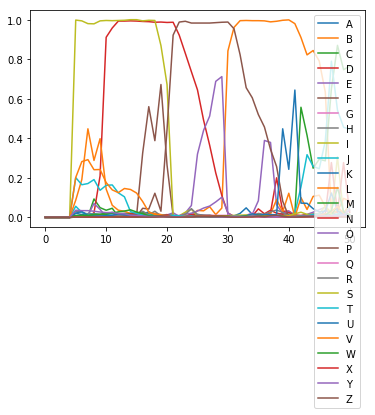

correct: 727 total: 761 accuracy: 0.955 avgEditDist 0.051
('A', 'A'): 321
('S', 'S'): 172
('E', 'E'): 360
('T', 'T'): 185
('H', 'H'): 110
('D', 'D'): 160
('K', 'K'): 57
('N', 'N'): 225
('L', 'L'): 181
('R', 'R'): 265
('O', 'O'): 201
('V', 'V'): 149
('B', 'B'): 52
('C', 'C'): 98
('G', 'G'): 70
('P', 'P'): 74
('I', 'I'): 150
('F', 'F'): 51
('W', 'W'): 64
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 41
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00151972 0.00081251 0.00142582 ... 0.00155828 0.03281882 0.00065688]
 [0.00167536 0.00100371 0.00183305 ... 0.00197085 0.03749775 0.00086399]
 [0.0018477  0.0011751  0.00230545 ... 0.00253131 0.04748416 0.0012449 ]
 ...
 [0.00219801 0.00132328 0.00223726 ... 0.00206596 0.01625334 0.00157924]
 [0.00206363 0.00123415 

MA MA
edit distance: 0
correct: 729 total: 763 accuracy: 0.955 avgEditDist 0.051
('A', 'A'): 322
('S', 'S'): 172
('E', 'E'): 361
('T', 'T'): 186
('H', 'H'): 110
('D', 'D'): 160
('K', 'K'): 57
('N', 'N'): 225
('L', 'L'): 181
('R', 'R'): 265
('O', 'O'): 201
('V', 'V'): 150
('B', 'B'): 53
('C', 'C'): 98
('G', 'G'): 71
('P', 'P'): 74
('I', 'I'): 150
('F', 'F'): 51
('W', 'W'): 64
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 42
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00158039 0.00103457 0.00167031 ... 0.00103408 0.02489751 0.00070913]
 [0.00183234 0.00101275 0.00146132 ... 0.00132443 0.02289721 0.00078921]
 [0.00189399 0.00115974 0.00172525 ... 0.0014982  0.02511565 0.00083163]
 ...
 [0.00147938 0.00084152 0.00125238 ... 0.00097696 0.01884904 0.00074412]
 

[[0.00209002 0.00112455 0.00162386 ... 0.00165154 0.0338123  0.00088335]
 [0.00261214 0.00151199 0.0021003  ... 0.00169113 0.03770055 0.00139755]
 [0.00254755 0.00168286 0.00266096 ... 0.00200222 0.04125188 0.00229496]
 ...
 [0.00158139 0.00089617 0.0013118  ... 0.00106075 0.0140092  0.00082782]
 [0.00150759 0.0009077  0.00124307 ... 0.00102866 0.01368899 0.00071806]
 [0.00167556 0.00083364 0.00148892 ... 0.00118266 0.02172685 0.00086821]]
--pred for 0 20 ['T 0.14 ', 'V 0.09 ', 'J 0.08 ', 'A 0.05 ', 'L 0.04 ']
--pred for 0 24 ['T 0.26 ', 'V 0.11 ', 'E 0.04 ', 'J 0.04 ', 'R 0.04 ']
--pred for 0 28 ['T 0.23 ', 'C 0.18 ', 'V 0.13 ', 'E 0.12 ', 'L 0.05 ']
--pred for 0 32 ['C 0.59 ', 'V 0.14 ', 'T 0.13 ', 'L 0.07 ', 'D 0.07 ']
--pred for 0 36 ['D 0.92 ', 'V 0.12 ', 'L 0.10 ', 'T 0.08 ', 'Y 0.05 ']
--pred for 0 40 ['D 0.96 ', 'V 0.16 ', 'T 0.09 ', 'L 0.04 ', 'A 0.04 ']
--pred for 0 44 ['D 0.97 ', 'V 0.17 ', 'T 0.08 ', 'A 0.07 ', 'L 0.03 ']
--pred for 0 48 ['D 0.99 ', 'V 0.17 ', 'T 0.10 ', 'L

[[0.00201797 0.00129693 0.00142369 ... 0.00214057 0.04082149 0.00088087]
 [0.00188393 0.00127672 0.00131574 ... 0.00232697 0.03324021 0.00091537]
 [0.0016371  0.00120906 0.00135135 ... 0.00225147 0.0353924  0.00072527]
 ...
 [0.00255333 0.00126158 0.00215149 ... 0.00168138 0.03857102 0.00105642]
 [0.00224246 0.00093791 0.00162671 ... 0.00260273 0.03604162 0.00091358]
 [0.00205354 0.00104913 0.00163092 ... 0.00164849 0.02373762 0.00074098]]
--pred for 0 20 ['R 0.34 ', 'J 0.22 ', 'V 0.16 ', 'F 0.05 ', 'T 0.05 ']
--pred for 0 24 ['R 0.56 ', 'J 0.21 ', 'F 0.20 ', 'V 0.19 ', 'T 0.04 ']
--pred for 0 28 ['F 0.61 ', 'R 0.22 ', 'V 0.17 ', 'J 0.15 ', 'Y 0.04 ']
--pred for 0 32 ['F 0.34 ', 'V 0.23 ', 'P 0.15 ', 'J 0.13 ', 'R 0.05 ']
--pred for 0 36 ['P 0.98 ', 'V 0.14 ', 'T 0.07 ', 'Y 0.03 ', 'J 0.03 ']
--pred for 0 40 ['P 0.99 ', 'V 0.14 ', 'T 0.09 ', 'Y 0.03 ', 'J 0.02 ']
--pred for 0 44 ['P 0.99 ', 'V 0.09 ', 'J 0.08 ', 'T 0.06 ', 'Y 0.05 ']
--pred for 0 48 ['P 0.99 ', 'J 0.31 ', 'T 0.05 ', 'V

LERTND LERTND
edit distance: 0
correct: 734 total: 768 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 325
('S', 'S'): 173
('E', 'E'): 362
('T', 'T'): 189
('H', 'H'): 110
('D', 'D'): 163
('K', 'K'): 57
('N', 'N'): 226
('L', 'L'): 183
('R', 'R'): 271
('O', 'O'): 202
('V', 'V'): 150
('B', 'B'): 53
('C', 'C'): 98
('G', 'G'): 71
('P', 'P'): 76
('I', 'I'): 150
('F', 'F'): 51
('W', 'W'): 65
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 42
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.0027417  0.00101437 0.00243074 ... 0.00211023 0.06455673 0.00093506]
 [0.00366348 0.00125054 0.00318126 ... 0.0028201  0.04359811 0.00134388]
 [0.00405474 0.00127879 0.00331406 ... 0.0030411  0.04475338 0.00140783]
 ...
 [0.00180905 0.00101551 0.001397   ... 0.00126364 0.01219883 0.001

ER ER
edit distance: 0
correct: 736 total: 770 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 325
('S', 'S'): 174
('E', 'E'): 363
('T', 'T'): 190
('H', 'H'): 110
('D', 'D'): 163
('K', 'K'): 57
('N', 'N'): 226
('L', 'L'): 183
('R', 'R'): 273
('O', 'O'): 202
('V', 'V'): 150
('B', 'B'): 53
('C', 'C'): 98
('G', 'G'): 71
('P', 'P'): 76
('I', 'I'): 150
('F', 'F'): 51
('W', 'W'): 65
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 42
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.54513901e-03 7.72407919e-04 1.47173821e-03 2.40027141e-02
  2.80942488e-03 2.30428530e-03 3.73222213e-03 1.75506144e-03
  4.08612518e-03 1.64105999e-03 9.33373440e-03 2.62202066e-03
  4.39870544e-02 1.12783723e-03 2.59784628e-02 2.49972800e-03
  6.61425991e-04 2.35893577e-03 1.98960747e-03 2.2

[[0.00144695 0.00068544 0.00130033 ... 0.00149304 0.0375398  0.00059662]
 [0.00162847 0.00086906 0.00177363 ... 0.00217191 0.05022711 0.00089494]
 [0.0018941  0.0011519  0.00232923 ... 0.00287551 0.05050276 0.00143104]
 ...
 [0.00381124 0.00132087 0.00332996 ... 0.00325481 0.02448504 0.00128989]
 [0.00358619 0.0013016  0.00322891 ... 0.00294552 0.02818148 0.00115811]
 [0.00255646 0.00113636 0.00228671 ... 0.00218501 0.02122538 0.00080847]]
--pred for 0 20 ['V 0.11 ', 'T 0.06 ', 'L 0.06 ', 'J 0.06 ', 'U 0.05 ']
--pred for 0 24 ['C 0.36 ', 'T 0.08 ', 'V 0.08 ', 'J 0.06 ', 'Y 0.05 ']
--pred for 0 28 ['C 0.95 ', 'T 0.09 ', 'V 0.07 ', 'Y 0.05 ', 'J 0.05 ']
--pred for 0 32 ['O 0.82 ', 'J 0.18 ', 'V 0.12 ', 'T 0.08 ', 'C 0.07 ']
--pred for 0 36 ['O 0.99 ', 'V 0.14 ', 'T 0.09 ', 'Y 0.06 ', 'L 0.04 ']
--pred for 0 40 ['O 0.99 ', 'V 0.14 ', 'T 0.09 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 44 ['O 0.99 ', 'V 0.12 ', 'U 0.10 ', 'T 0.07 ', 'L 0.03 ']
--pred for 0 48 ['O 0.99 ', 'U 0.41 ', 'V 0.09 ', 'W

[[0.0008871  0.00083369 0.00141447 ... 0.00102275 0.02108339 0.0004316 ]
 [0.00094217 0.00089616 0.00151523 ... 0.00112441 0.01793654 0.00044601]
 [0.00093922 0.00094319 0.0014928  ... 0.00114937 0.01563037 0.00044826]
 ...
 [0.00145469 0.00085242 0.00119272 ... 0.00090809 0.01490245 0.00090407]
 [0.00119509 0.00080183 0.00135379 ... 0.00115987 0.01834645 0.00071772]
 [0.00127299 0.0008219  0.00121996 ... 0.0011527  0.02137118 0.00059579]]
--pred for 0 20 ['M 0.44 ', 'V 0.09 ', 'J 0.08 ', 'T 0.07 ', 'L 0.02 ']
--pred for 0 24 ['M 0.56 ', 'V 0.10 ', 'J 0.08 ', 'T 0.07 ', 'N 0.02 ']
--pred for 0 28 ['M 0.68 ', 'V 0.11 ', 'J 0.08 ', 'T 0.06 ', 'L 0.02 ']
--pred for 0 32 ['N 0.99 ', 'V 0.15 ', 'T 0.07 ', 'J 0.05 ', 'L 0.04 ']
--pred for 0 36 ['N 0.99 ', 'V 0.16 ', 'T 0.07 ', 'J 0.04 ', 'L 0.04 ']
--pred for 0 40 ['N 0.99 ', 'V 0.23 ', 'T 0.08 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 44 ['N 0.99 ', 'V 0.34 ', 'T 0.05 ', 'L 0.04 ', 'W 0.03 ']
--pred for 0 48 ['N 0.99 ', 'I 0.79 ', 'V 0.29 ', 'T

[[0.00155795 0.00101476 0.00151942 ... 0.00086496 0.02224935 0.00116649]
 [0.00148948 0.00104469 0.00176789 ... 0.00114439 0.02662211 0.00174164]
 [0.00164177 0.00108308 0.00188731 ... 0.00126723 0.02951491 0.00174176]
 ...
 [0.00173678 0.0008728  0.00141794 ... 0.0011214  0.01865671 0.00096834]
 [0.00153233 0.00084399 0.00139431 ... 0.00106641 0.01805301 0.00079985]
 [0.00168437 0.00096474 0.00137559 ... 0.00113238 0.01534872 0.0007922 ]]
--pred for 0 20 ['L 0.62 ', 'T 0.12 ', 'V 0.11 ', 'J 0.03 ', 'I 0.03 ']
--pred for 0 24 ['L 0.94 ', 'V 0.14 ', 'T 0.11 ', 'Y 0.03 ', 'J 0.02 ']
--pred for 0 28 ['L 0.97 ', 'V 0.12 ', 'T 0.11 ', 'Y 0.03 ', 'A 0.02 ']
--pred for 0 32 ['L 0.98 ', 'T 0.12 ', 'V 0.12 ', 'Y 0.03 ', 'A 0.03 ']
--pred for 0 36 ['L 0.98 ', 'V 0.17 ', 'T 0.17 ', 'Y 0.02 ', 'W 0.01 ']
--pred for 0 40 ['I 0.99 ', 'L 0.98 ', 'V 0.25 ', 'T 0.09 ', 'Y 0.03 ']
--pred for 0 44 ['L 0.98 ', 'I 0.98 ', 'V 0.26 ', 'T 0.08 ', 'Y 0.02 ']
--pred for 0 48 ['L 0.98 ', 'F 0.65 ', 'V 0.13 ', 'H

IR IR
edit distance: 0
correct: 745 total: 779 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 325
('S', 'S'): 176
('E', 'E'): 364
('T', 'T'): 194
('H', 'H'): 110
('D', 'D'): 165
('K', 'K'): 58
('N', 'N'): 228
('L', 'L'): 185
('R', 'R'): 275
('O', 'O'): 206
('V', 'V'): 153
('B', 'B'): 53
('C', 'C'): 98
('G', 'G'): 71
('P', 'P'): 76
('I', 'I'): 152
('F', 'F'): 52
('W', 'W'): 66
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 42
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00122291 0.00082099 0.00127435 ... 0.00260823 0.0410309  0.00055055]
 [0.00137198 0.0008658  0.00127322 ... 0.00326975 0.03037987 0.00058377]
 [0.00141199 0.00083001 0.00128268 ... 0.00327285 0.02876453 0.00059164]
 ...
 [0.00317029 0.00173982 0.00285435 ... 0.00188123 0.02690091 0.00219013]
 

WT WT
edit distance: 0
correct: 747 total: 781 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 325
('S', 'S'): 176
('E', 'E'): 366
('T', 'T'): 195
('H', 'H'): 111
('D', 'D'): 165
('K', 'K'): 58
('N', 'N'): 228
('L', 'L'): 185
('R', 'R'): 275
('O', 'O'): 206
('V', 'V'): 153
('B', 'B'): 53
('C', 'C'): 98
('G', 'G'): 71
('P', 'P'): 77
('I', 'I'): 153
('F', 'F'): 52
('W', 'W'): 67
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 42
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00152479 0.00075113 0.0013466  ... 0.00160301 0.03539857 0.00066809]
 [0.00176631 0.00094752 0.00170222 ... 0.0016174  0.04470777 0.00089557]
 [0.00200202 0.00121598 0.00236745 ... 0.00247013 0.04412229 0.00139139]
 ...
 [0.00293742 0.00210559 0.00143803 ... 0.00250058 0.03274886 0.00332952]
 

[[0.00179758 0.00097027 0.00146212 ... 0.00104326 0.02127858 0.00072145]
 [0.00210836 0.00105545 0.00140541 ... 0.00232673 0.02943148 0.00082218]
 [0.00247099 0.00119394 0.0015425  ... 0.00237382 0.04113218 0.00090122]
 ...
 [0.00167083 0.00081021 0.00152753 ... 0.00143861 0.01761925 0.00094018]
 [0.00192596 0.00094191 0.00171194 ... 0.0014463  0.022766   0.00113672]
 [0.00183953 0.00097672 0.0016245  ... 0.00151836 0.02469303 0.00092859]]
--pred for 0 20 ['A 0.61 ', 'T 0.12 ', 'J 0.11 ', 'L 0.05 ', 'V 0.04 ']
--pred for 0 24 ['A 0.86 ', 'J 0.14 ', 'T 0.06 ', 'V 0.05 ', 'L 0.04 ']
--pred for 0 28 ['A 0.91 ', 'V 0.06 ', 'J 0.06 ', 'T 0.05 ', 'Y 0.04 ']
--pred for 0 32 ['A 0.95 ', 'V 0.09 ', 'T 0.06 ', 'Y 0.05 ', 'L 0.05 ']
--pred for 0 36 ['A 0.98 ', 'V 0.12 ', 'T 0.05 ', 'L 0.05 ', 'Y 0.05 ']
--pred for 0 40 ['A 0.99 ', 'V 0.12 ', 'T 0.05 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 44 ['A 0.99 ', 'V 0.13 ', 'T 0.05 ', 'Y 0.04 ', 'L 0.04 ']
--pred for 0 48 ['A 0.99 ', 'V 0.15 ', 'T 0.06 ', 'W

NTES NTES
edit distance: 0
correct: 750 total: 784 accuracy: 0.957 avgEditDist 0.050
('A', 'A'): 327
('S', 'S'): 178
('E', 'E'): 367
('T', 'T'): 196
('H', 'H'): 111
('D', 'D'): 165
('K', 'K'): 58
('N', 'N'): 232
('L', 'L'): 185
('R', 'R'): 277
('O', 'O'): 208
('V', 'V'): 153
('B', 'B'): 53
('C', 'C'): 98
('G', 'G'): 71
('P', 'P'): 77
('I', 'I'): 153
('F', 'F'): 52
('W', 'W'): 67
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 1
-------('%', 'I'): 3
('M', 'M'): 42
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00157816 0.00076759 0.00146168 ... 0.00124199 0.02922503 0.00100736]
 [0.00179313 0.00091116 0.00130274 ... 0.0012258  0.02862455 0.0010207 ]
 [0.00203913 0.00104921 0.00149151 ... 0.00137799 0.02914091 0.00116265]
 ...
 [0.00147725 0.00070654 0.0014278  ... 0.00191873 0.02122248 0.0006045

O DO
edit distance: 1


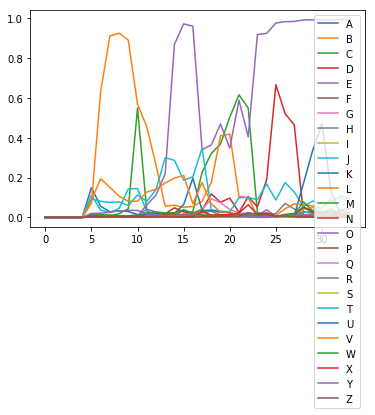

correct: 751 total: 786 accuracy: 0.955 avgEditDist 0.051
('A', 'A'): 328
('S', 'S'): 178
('E', 'E'): 367
('T', 'T'): 197
('H', 'H'): 111
('D', 'D'): 165
('K', 'K'): 58
('N', 'N'): 232
('L', 'L'): 185
('R', 'R'): 277
('O', 'O'): 209
('V', 'V'): 153
('B', 'B'): 53
('C', 'C'): 98
('G', 'G'): 71
('P', 'P'): 77
('I', 'I'): 153
('F', 'F'): 53
('W', 'W'): 67
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 42
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00157971 0.00139831 0.00105939 ... 0.00116422 0.07197352 0.00090419]
 [0.00156721 0.00149858 0.00109883 ... 0.00131293 0.06831106 0.00102473]
 [0.00133381 0.00117771 0.00099359 ... 0.0009481  0.05878085 0.00116327]
 ...
 [0.00279484 0.00151209 0.00318454 ... 0.00326414 0.04381491 0.00124184]
 [0.00170666 0.00102506 

OEL OEL
edit distance: 0
correct: 753 total: 788 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 328
('S', 'S'): 179
('E', 'E'): 368
('T', 'T'): 197
('H', 'H'): 111
('D', 'D'): 165
('K', 'K'): 58
('N', 'N'): 232
('L', 'L'): 187
('R', 'R'): 278
('O', 'O'): 211
('V', 'V'): 153
('B', 'B'): 53
('C', 'C'): 98
('G', 'G'): 71
('P', 'P'): 77
('I', 'I'): 154
('F', 'F'): 53
('W', 'W'): 67
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 42
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00172458 0.00105157 0.00162812 ... 0.0010103  0.01974374 0.00074874]
 [0.00197012 0.00104579 0.00151049 ... 0.00211067 0.02341919 0.00085924]
 [0.00233548 0.00122359 0.00190761 ... 0.00150847 0.03252865 0.00103708]
 ...
 [0.00262785 0.00115411 0.00190598 ... 0.00188939 0.05204161 0.00099674]

[]
C
['A 0.01', 'B 0.004', 'C 0.885', 'D 0.002', 'E 0.005', 'F 0.008', 'G 0.006', 'H 0.014', 'I 0.003', 'J 0.058', 'K 0.006', 'L 0.036', 'M 0.006', 'N 0.007', 'O 0.01', 'P 0.003', 'Q 0.003', 'R 0.001', 'S 0.001', 'T 0.094', 'U 0.021', 'V 0.087', 'W 0.01', 'X 0.003', 'Y 0.059', 'Z 0.001']
['C 1']
C
['A 0.022', 'B 0.005', 'C 0.983', 'D 0.003', 'E 0.006', 'F 0.009', 'G 0.005', 'H 0.012', 'I 0.002', 'J 0.048', 'K 0.003', 'L 0.045', 'M 0.007', 'N 0.006', 'O 0.008', 'P 0.004', 'Q 0.003', 'R 0.002', 'S 0.002', 'T 0.097', 'U 0.018', 'V 0.084', 'W 0.013', 'X 0.003', 'Y 0.058', 'Z 0.002']
['C 2']
C
['A 0.027', 'B 0.005', 'C 0.991', 'D 0.003', 'E 0.005', 'F 0.011', 'G 0.004', 'H 0.011', 'I 0.002', 'J 0.067', 'K 0.002', 'L 0.051', 'M 0.008', 'N 0.006', 'O 0.008', 'P 0.005', 'Q 0.003', 'R 0.004', 'S 0.003', 'T 0.08', 'U 0.018', 'V 0.1', 'W 0.015', 'X 0.004', 'Y 0.072', 'Z 0.003']
['C 3']
C
['A 0.028', 'B 0.005', 'C 0.99', 'D 0.003', 'E 0.004', 'F 0.012', 'G 0.005', 'H 0.012', 'I 0.003', 'J 0.059', 

COERHV COERHV
edit distance: 0
correct: 755 total: 790 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 330
('S', 'S'): 179
('E', 'E'): 370
('T', 'T'): 197
('H', 'H'): 112
('D', 'D'): 165
('K', 'K'): 58
('N', 'N'): 232
('L', 'L'): 187
('R', 'R'): 279
('O', 'O'): 212
('V', 'V'): 154
('B', 'B'): 53
('C', 'C'): 99
('G', 'G'): 71
('P', 'P'): 77
('I', 'I'): 154
('F', 'F'): 53
('W', 'W'): 67
-------('H', 'R'): 3
('U', 'U'): 49
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 42
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00133148 0.00083632 0.00127913 ... 0.00145495 0.04864461 0.00045573]
 [0.00137667 0.00083008 0.00128467 ... 0.00275138 0.03634131 0.00050694]
 [0.00143941 0.00081932 0.00131998 ... 0.00282271 0.03481473 0.00051993]
 ...
 [0.00160004 0.00113762 0.00248419 ... 0.00421122 0.03431219 0.000

[[0.00127424 0.00061742 0.00118133 ... 0.00102153 0.03557977 0.00069963]
 [0.00140421 0.00058491 0.00111201 ... 0.00132529 0.0333355  0.00083776]
 [0.00157976 0.0006255  0.00117982 ... 0.00171376 0.03361628 0.00088885]
 ...
 [0.00167929 0.0009749  0.00169727 ... 0.00144473 0.02761377 0.00053733]
 [0.00160561 0.00091406 0.00155179 ... 0.00146356 0.0265834  0.00052592]
 [0.00179987 0.00105898 0.00172484 ... 0.001593   0.025274   0.00058915]]
--pred for 0 20 ['T 0.26 ', 'V 0.18 ', 'J 0.04 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 24 ['V 0.51 ', 'T 0.13 ', 'Y 0.03 ', 'J 0.03 ', 'L 0.02 ']
--pred for 0 28 ['V 0.54 ', 'T 0.11 ', 'J 0.05 ', 'Y 0.03 ', 'A 0.03 ']
--pred for 0 32 ['V 0.69 ', 'J 0.09 ', 'T 0.09 ', 'W 0.04 ', 'Y 0.02 ']
--pred for 0 36 ['V 0.92 ', 'T 0.08 ', 'J 0.04 ', 'L 0.02 ', 'W 0.02 ']
--pred for 0 40 ['V 0.97 ', 'T 0.05 ', 'L 0.05 ', 'J 0.02 ', 'A 0.02 ']
--pred for 0 44 ['V 0.98 ', 'L 0.05 ', 'T 0.05 ', 'J 0.02 ', 'A 0.02 ']
--pred for 0 48 ['V 0.97 ', 'I 0.92 ', 'T 0.06 ', 'J

VEEIU VEEIU
edit distance: 0
correct: 757 total: 792 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 330
('S', 'S'): 179
('E', 'E'): 372
('T', 'T'): 197
('H', 'H'): 112
('D', 'D'): 165
('K', 'K'): 58
('N', 'N'): 232
('L', 'L'): 187
('R', 'R'): 279
('O', 'O'): 213
('V', 'V'): 155
('B', 'B'): 53
('C', 'C'): 99
('G', 'G'): 72
('P', 'P'): 78
('I', 'I'): 155
('F', 'F'): 53
('W', 'W'): 67
-------('H', 'R'): 3
('U', 'U'): 50
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 42
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00123398 0.00061161 0.00114738 ... 0.0011028  0.04261639 0.00075639]
 [0.00118478 0.00068103 0.00130656 ... 0.0013998  0.03356243 0.00081812]
 [0.00155848 0.00084591 0.00143767 ... 0.00104813 0.0259237  0.00109091]
 ...
 [0.00139363 0.00104271 0.00218602 ... 0.00436093 0.03437217 0.00090

[[0.00209002 0.00112455 0.00162386 ... 0.00165154 0.0338123  0.00088335]
 [0.00261214 0.00151199 0.0021003  ... 0.00169113 0.03770055 0.00139755]
 [0.00254755 0.00168286 0.00266096 ... 0.00200222 0.04125188 0.00229496]
 ...
 [0.00156007 0.00125495 0.00249681 ... 0.00496185 0.02771898 0.00096089]
 [0.00145065 0.00104297 0.00199678 ... 0.00683408 0.01973508 0.00096624]
 [0.00158328 0.00097988 0.00171195 ... 0.01057219 0.01668504 0.00091404]]
--pred for 0 20 ['T 0.14 ', 'V 0.09 ', 'J 0.08 ', 'A 0.05 ', 'L 0.04 ']
--pred for 0 24 ['T 0.26 ', 'V 0.11 ', 'E 0.04 ', 'J 0.04 ', 'R 0.04 ']
--pred for 0 28 ['T 0.23 ', 'C 0.18 ', 'V 0.13 ', 'E 0.12 ', 'L 0.05 ']
--pred for 0 32 ['C 0.59 ', 'V 0.14 ', 'T 0.13 ', 'L 0.07 ', 'D 0.07 ']
--pred for 0 36 ['D 0.92 ', 'V 0.12 ', 'L 0.10 ', 'T 0.08 ', 'Y 0.05 ']
--pred for 0 40 ['D 0.96 ', 'V 0.16 ', 'T 0.09 ', 'L 0.04 ', 'A 0.04 ']
--pred for 0 44 ['D 0.97 ', 'V 0.17 ', 'T 0.08 ', 'A 0.07 ', 'L 0.03 ']
--pred for 0 48 ['D 0.99 ', 'V 0.15 ', 'T 0.11 ', 'A

DEO DEO
edit distance: 0
correct: 759 total: 794 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 330
('S', 'S'): 179
('E', 'E'): 374
('T', 'T'): 197
('H', 'H'): 112
('D', 'D'): 166
('K', 'K'): 58
('N', 'N'): 232
('L', 'L'): 187
('R', 'R'): 279
('O', 'O'): 215
('V', 'V'): 156
('B', 'B'): 53
('C', 'C'): 99
('G', 'G'): 72
('P', 'P'): 78
('I', 'I'): 155
('F', 'F'): 53
('W', 'W'): 67
-------('H', 'R'): 3
('U', 'U'): 50
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 42
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00152825 0.00076157 0.00129451 ... 0.00164263 0.03443458 0.00065071]
 [0.00182063 0.00097382 0.00167204 ... 0.00165448 0.04042862 0.00095151]
 [0.00217065 0.00134038 0.00251194 ... 0.00255196 0.04409302 0.00162734]
 ...
 [0.00132764 0.00273482 0.00411848 ... 0.00310022 0.03159204 0.00262954]

[[1.53281784e-03 1.17881584e-03 1.86041545e-03 4.53057103e-02
  3.57896718e-03 2.46477546e-03 3.03413183e-03 1.39074470e-03
  4.37841006e-03 1.79651333e-03 1.57169513e-02 3.82762239e-03
  9.03969169e-01 1.22510816e-03 1.60836671e-02 2.81658233e-03
  2.63140490e-03 4.85542184e-03 3.90730007e-03 1.49280939e-03
  1.49394292e-03 2.27095908e-03 1.22619689e-01 8.61627329e-03
  3.66785042e-02 9.62608028e-03 1.41335477e-03 2.50993650e-02
  7.38793809e-04]
 [1.66754110e-03 9.76204290e-04 1.51513761e-03 1.91490069e-01
  3.63586564e-03 1.38613244e-03 2.34837481e-03 1.34251337e-03
  5.02463151e-03 1.72434829e-03 1.53717995e-02 3.74775752e-03
  5.43430567e-01 1.24630076e-03 3.36891599e-02 2.17128708e-03
  2.62810057e-03 2.82493536e-03 2.70791934e-03 1.76629249e-03
  8.23142531e-04 1.08779303e-03 1.11624002e-01 1.23867644e-02
  5.22859804e-02 9.04385094e-03 1.28370267e-03 2.46003605e-02
  6.58379518e-04]
 [1.72650348e-03 1.11758185e-03 1.68290490e-03 4.65992570e-01
  3.74292140e-03 1.61351741e-03 2.

AH AH
edit distance: 0
correct: 761 total: 796 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 331
('S', 'S'): 179
('E', 'E'): 374
('T', 'T'): 197
('H', 'H'): 113
('D', 'D'): 166
('K', 'K'): 58
('N', 'N'): 232
('L', 'L'): 189
('R', 'R'): 279
('O', 'O'): 216
('V', 'V'): 156
('B', 'B'): 53
('C', 'C'): 99
('G', 'G'): 72
('P', 'P'): 79
('I', 'I'): 155
('F', 'F'): 53
('W', 'W'): 68
-------('H', 'R'): 3
('U', 'U'): 50
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 42
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00092079 0.0008806  0.00142286 ... 0.00099567 0.02105989 0.00040459]
 [0.0009332  0.00092593 0.00141449 ... 0.00108118 0.01859637 0.00040804]
 [0.00097378 0.0010352  0.00151075 ... 0.00150598 0.01858356 0.00051036]
 ...
 [0.00187318 0.00126857 0.0027564  ... 0.00326614 0.02618341 0.00095602]
 

[[0.00243851 0.00165327 0.00214301 ... 0.00159803 0.04227802 0.00094663]
 [0.00281951 0.00201867 0.00275325 ... 0.00189218 0.03450302 0.00134571]
 [0.00288382 0.00214496 0.00286448 ... 0.00193779 0.03144766 0.00156537]
 ...
 [0.00163976 0.00162292 0.00136974 ... 0.00107355 0.02071785 0.0009699 ]
 [0.00159136 0.00139816 0.00133273 ... 0.00103756 0.02333088 0.00088333]
 [0.00169658 0.00143296 0.00132974 ... 0.00117733 0.02489852 0.0008847 ]]
--pred for 0 20 ['E 0.74 ', 'J 0.14 ', 'V 0.12 ', 'T 0.06 ', 'Y 0.04 ']
--pred for 0 24 ['E 0.98 ', 'V 0.10 ', 'T 0.08 ', 'J 0.05 ', 'L 0.04 ']
--pred for 0 28 ['E 0.98 ', 'V 0.10 ', 'T 0.09 ', 'J 0.04 ', 'L 0.04 ']
--pred for 0 32 ['B 0.99 ', 'V 0.11 ', 'T 0.09 ', 'L 0.05 ', 'A 0.03 ']
--pred for 0 36 ['B 1.00 ', 'T 0.11 ', 'V 0.10 ', 'L 0.05 ', 'A 0.03 ']
--pred for 0 40 ['B 1.00 ', 'T 0.16 ', 'V 0.11 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 44 ['B 1.00 ', 'T 0.22 ', 'V 0.10 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 48 ['B 1.00 ', 'T 0.34 ', 'V 0.08 ', 'L

BTLI BTLI
edit distance: 0
correct: 763 total: 798 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 331
('S', 'S'): 179
('E', 'E'): 374
('T', 'T'): 198
('H', 'H'): 113
('D', 'D'): 166
('K', 'K'): 58
('N', 'N'): 232
('L', 'L'): 190
('R', 'R'): 279
('O', 'O'): 217
('V', 'V'): 156
('B', 'B'): 54
('C', 'C'): 99
('G', 'G'): 72
('P', 'P'): 80
('I', 'I'): 156
('F', 'F'): 53
('W', 'W'): 68
-------('H', 'R'): 3
('U', 'U'): 50
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 43
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00121777 0.000924   0.00157105 ... 0.00104253 0.03289784 0.00053896]
 [0.00107347 0.00087047 0.00149107 ... 0.00118326 0.02049281 0.00048496]
 [0.00141613 0.00102715 0.00168345 ... 0.00128212 0.02157238 0.00061446]
 ...
 [0.00151355 0.00149106 0.00268492 ... 0.00494286 0.03783961 0.0010783

[[0.0015667  0.00076893 0.00146522 ... 0.0012528  0.02694587 0.00103623]
 [0.00196531 0.00102071 0.00142323 ... 0.0014999  0.02280454 0.0012523 ]
 [0.00219366 0.00113281 0.00157601 ... 0.00161579 0.0235206  0.00134808]
 ...
 [0.00143445 0.00085852 0.00143161 ... 0.00265511 0.02216013 0.00065745]
 [0.0014994  0.00089299 0.001578   ... 0.0023705  0.0237202  0.00067331]
 [0.00142252 0.00079355 0.00145601 ... 0.00235662 0.02053239 0.00064231]]
--pred for 0 20 ['T 0.63 ', 'V 0.05 ', 'J 0.04 ', 'L 0.03 ', 'Y 0.03 ']
--pred for 0 24 ['T 0.95 ', 'V 0.07 ', 'J 0.07 ', 'L 0.04 ', 'Y 0.02 ']
--pred for 0 28 ['T 0.96 ', 'V 0.07 ', 'J 0.05 ', 'L 0.05 ', 'A 0.02 ']
--pred for 0 32 ['T 0.98 ', 'V 0.09 ', 'J 0.05 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 36 ['T 0.98 ', 'V 0.10 ', 'L 0.04 ', 'J 0.04 ', 'A 0.03 ']
--pred for 0 40 ['T 0.99 ', 'V 0.11 ', 'L 0.04 ', 'J 0.03 ', 'A 0.03 ']
--pred for 0 44 ['T 0.99 ', 'V 0.22 ', 'U 0.07 ', 'L 0.05 ', 'W 0.04 ']
--pred for 0 48 ['T 0.99 ', 'U 0.28 ', 'V 0.17 ', 'W

TCF TCF
edit distance: 0
correct: 765 total: 800 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 331
('S', 'S'): 179
('E', 'E'): 374
('T', 'T'): 199
('H', 'H'): 113
('D', 'D'): 168
('K', 'K'): 58
('N', 'N'): 233
('L', 'L'): 190
('R', 'R'): 279
('O', 'O'): 217
('V', 'V'): 156
('B', 'B'): 54
('C', 'C'): 100
('G', 'G'): 72
('P', 'P'): 80
('I', 'I'): 156
('F', 'F'): 54
('W', 'W'): 68
-------('H', 'R'): 3
('U', 'U'): 50
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 43
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00159232 0.00087957 0.00150262 ... 0.00150469 0.03285415 0.0007288 ]
 [0.00186851 0.00107114 0.00190122 ... 0.00204963 0.04018293 0.00098784]
 [0.00193721 0.00122219 0.00236725 ... 0.00257024 0.04950793 0.00128364]
 ...
 [0.00291531 0.00169215 0.00266322 ... 0.00189426 0.02657602 0.00208337

[[1.44987041e-03 7.10878638e-04 1.37286284e-03 7.54347071e-03
  2.99944961e-03 2.50074361e-02 1.52305153e-03 9.68947075e-04
  5.84057532e-03 3.24567663e-03 1.35719134e-02 2.59960606e-03
  9.93545204e-02 1.52910315e-02 2.89348681e-02 3.41132446e-03
  5.10217808e-03 4.83110640e-03 2.32062093e-03 2.25614198e-03
  1.53405452e-03 7.32899935e-04 6.34006634e-02 1.85433216e-02
  1.31753936e-01 8.91003199e-03 2.67692539e-03 4.02801894e-02
  7.11846049e-04]
 [1.77028542e-03 9.67796543e-04 1.63110613e-03 1.35145979e-02
  3.41071980e-03 4.32784744e-02 1.95714273e-03 1.46215723e-03
  6.81710336e-03 7.39443442e-03 1.19246868e-02 2.82459031e-03
  1.28749549e-01 2.10790765e-02 2.19832957e-02 3.58627480e-03
  5.11893071e-03 7.23456824e-03 3.16858641e-03 2.73132650e-03
  2.68850825e-03 1.09095161e-03 6.57773912e-02 1.17615145e-02
  1.06007643e-01 7.78798759e-03 3.71259684e-03 4.84402776e-02
  9.26338427e-04]
 [2.12451234e-03 1.43292686e-03 1.43752876e-03 2.03848984e-02
  3.74965766e-03 1.24476375e-02 1.

GK GK
edit distance: 0
correct: 767 total: 802 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 332
('S', 'S'): 179
('E', 'E'): 375
('T', 'T'): 199
('H', 'H'): 113
('D', 'D'): 168
('K', 'K'): 59
('N', 'N'): 234
('L', 'L'): 190
('R', 'R'): 280
('O', 'O'): 217
('V', 'V'): 156
('B', 'B'): 54
('C', 'C'): 100
('G', 'G'): 74
('P', 'P'): 80
('I', 'I'): 156
('F', 'F'): 54
('W', 'W'): 68
-------('H', 'R'): 3
('U', 'U'): 50
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 43
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00081287 0.00078729 0.001338   ... 0.00090457 0.02290504 0.00036162]
 [0.0008599  0.00085184 0.00140756 ... 0.00106106 0.0193538  0.00041741]
 [0.00095224 0.00094406 0.00144935 ... 0.00119786 0.02018894 0.00044689]
 ...
 [0.00301299 0.00205004 0.0014031  ... 0.00224689 0.0229032  0.00257112]


[[0.00141285 0.00096682 0.00160677 ... 0.00093039 0.03305222 0.00106599]
 [0.00152805 0.00103977 0.00182719 ... 0.00112388 0.03019483 0.00158767]
 [0.00163106 0.00112855 0.00200582 ... 0.00128515 0.03067305 0.00172315]
 ...
 [0.0028748  0.00220351 0.00147248 ... 0.0024369  0.02548198 0.00256366]
 [0.0027927  0.00210573 0.00146556 ... 0.00229046 0.02589445 0.00248419]
 [0.00234154 0.00170641 0.00148559 ... 0.0016628  0.03421608 0.00213792]]
--pred for 0 20 ['L 0.70 ', 'V 0.11 ', 'T 0.09 ', 'J 0.05 ', 'Y 0.03 ']
--pred for 0 24 ['L 0.95 ', 'V 0.12 ', 'T 0.11 ', 'Y 0.03 ', 'A 0.02 ']
--pred for 0 28 ['L 0.96 ', 'V 0.12 ', 'T 0.11 ', 'Y 0.03 ', 'A 0.02 ']
--pred for 0 32 ['L 0.98 ', 'V 0.13 ', 'T 0.11 ', 'Y 0.03 ', 'A 0.02 ']
--pred for 0 36 ['L 0.98 ', 'V 0.13 ', 'T 0.09 ', 'Y 0.03 ', 'A 0.02 ']
--pred for 0 40 ['L 0.99 ', 'I 0.56 ', 'V 0.19 ', 'T 0.11 ', 'Y 0.02 ']
--pred for 0 44 ['I 0.99 ', 'L 0.98 ', 'V 0.17 ', 'T 0.08 ', 'H 0.02 ']
--pred for 0 48 ['L 0.98 ', 'V 0.16 ', 'H 0.09 ', 'M

LPDR LPDR
edit distance: 0
correct: 769 total: 804 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 332
('S', 'S'): 180
('E', 'E'): 375
('T', 'T'): 199
('H', 'H'): 113
('D', 'D'): 169
('K', 'K'): 59
('N', 'N'): 234
('L', 'L'): 191
('R', 'R'): 282
('O', 'O'): 217
('V', 'V'): 156
('B', 'B'): 54
('C', 'C'): 100
('G', 'G'): 74
('P', 'P'): 81
('I', 'I'): 156
('F', 'F'): 54
('W', 'W'): 68
-------('H', 'R'): 3
('U', 'U'): 50
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 44
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.63685693e-03 1.26176921e-03 2.18269369e-03 8.91968794e-03
  6.56024832e-03 1.36925629e-03 3.92048992e-02 6.85215890e-02
  3.58907063e-03 1.35823665e-03 7.22828694e-03 9.84198134e-03
  1.14011755e-02 1.61821092e-03 4.66037452e-01 3.54518229e-03
  1.16138998e-03 2.11492646e-03 3.13957664e-0

HE HE
edit distance: 0
correct: 771 total: 806 accuracy: 0.957 avgEditDist 0.050
('A', 'A'): 333
('S', 'S'): 180
('E', 'E'): 376
('T', 'T'): 199
('H', 'H'): 114
('D', 'D'): 170
('K', 'K'): 59
('N', 'N'): 234
('L', 'L'): 191
('R', 'R'): 282
('O', 'O'): 217
('V', 'V'): 156
('B', 'B'): 54
('C', 'C'): 100
('G', 'G'): 74
('P', 'P'): 81
('I', 'I'): 156
('F', 'F'): 54
('W', 'W'): 68
-------('H', 'R'): 3
('U', 'U'): 50
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 44
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00153182 0.00097914 0.00171263 ... 0.00094862 0.0256368  0.00119316]
 [0.00152556 0.00137727 0.0028098  ... 0.00141223 0.03368987 0.0024962 ]
 [0.00162272 0.00141988 0.00312692 ... 0.00184927 0.03227048 0.00234587]
 ...
 [0.00227506 0.00168863 0.00235002 ... 0.00149817 0.02383822 0.00110497]


DGMEA DGMEA
edit distance: 0
correct: 773 total: 808 accuracy: 0.957 avgEditDist 0.050
('A', 'A'): 335
('S', 'S'): 180
('E', 'E'): 377
('T', 'T'): 200
('H', 'H'): 114
('D', 'D'): 172
('K', 'K'): 59
('N', 'N'): 234
('L', 'L'): 191
('R', 'R'): 283
('O', 'O'): 217
('V', 'V'): 156
('B', 'B'): 54
('C', 'C'): 100
('G', 'G'): 75
('P', 'P'): 81
('I', 'I'): 156
('F', 'F'): 54
('W', 'W'): 68
-------('H', 'R'): 3
('U', 'U'): 50
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 45
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00152975 0.00075141 0.00140703 ... 0.00126433 0.02620235 0.00103319]
 [0.00176134 0.00087794 0.00140428 ... 0.00135304 0.02708612 0.00123329]
 [0.00212109 0.0010641  0.00141298 ... 0.00146091 0.02508151 0.00129526]
 ...
 [0.00173106 0.00127934 0.00274473 ... 0.00351024 0.02928643 0.0009

VC VC
edit distance: 0
correct: 775 total: 810 accuracy: 0.957 avgEditDist 0.049
('A', 'A'): 335
('S', 'S'): 180
('E', 'E'): 377
('T', 'T'): 201
('H', 'H'): 115
('D', 'D'): 172
('K', 'K'): 59
('N', 'N'): 234
('L', 'L'): 191
('R', 'R'): 283
('O', 'O'): 218
('V', 'V'): 157
('B', 'B'): 54
('C', 'C'): 101
('G', 'G'): 75
('P', 'P'): 81
('I', 'I'): 156
('F', 'F'): 54
('W', 'W'): 68
-------('H', 'R'): 3
('U', 'U'): 50
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 45
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00129413 0.00101381 0.00180181 ... 0.00120029 0.02969119 0.00061518]
 [0.00107447 0.00093282 0.00161797 ... 0.0012271  0.01992666 0.00052716]
 [0.00147421 0.00111623 0.00181727 ... 0.00141491 0.02069228 0.00070003]
 ...
 [0.00146413 0.00120887 0.0019698  ... 0.00132313 0.01567495 0.00186377]


FL FL
edit distance: 0
correct: 777 total: 812 accuracy: 0.957 avgEditDist 0.049
('A', 'A'): 336
('S', 'S'): 180
('E', 'E'): 377
('T', 'T'): 201
('H', 'H'): 115
('D', 'D'): 172
('K', 'K'): 59
('N', 'N'): 235
('L', 'L'): 193
('R', 'R'): 283
('O', 'O'): 218
('V', 'V'): 157
('B', 'B'): 54
('C', 'C'): 101
('G', 'G'): 75
('P', 'P'): 81
('I', 'I'): 156
('F', 'F'): 55
('W', 'W'): 68
-------('H', 'R'): 3
('U', 'U'): 50
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 45
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00262577 0.00102718 0.00236786 ... 0.00266316 0.04908367 0.00076795]
 [0.00342084 0.00126841 0.00308065 ... 0.00312631 0.04531194 0.00101108]
 [0.00388085 0.00132802 0.00315398 ... 0.0027376  0.04076223 0.00119697]
 ...
 [0.00207242 0.00106846 0.00188742 ... 0.003178   0.02171724 0.00115468]


[[0.00180066 0.00107459 0.00166265 ... 0.00109936 0.02239484 0.00077077]
 [0.00202092 0.00107509 0.00148997 ... 0.00168799 0.02350963 0.00090733]
 [0.00235247 0.00127201 0.00185156 ... 0.00156813 0.02950877 0.00102419]
 ...
 [0.00162606 0.00148938 0.00287996 ... 0.00429361 0.02984002 0.00122028]
 [0.00154486 0.00127059 0.0025278  ... 0.00536753 0.02461118 0.00101246]
 [0.0015783  0.00115851 0.00230885 ... 0.00527236 0.02280566 0.00087469]]
--pred for 0 20 ['A 0.61 ', 'J 0.19 ', 'T 0.12 ', 'L 0.03 ', 'V 0.03 ']
--pred for 0 24 ['A 0.90 ', 'J 0.09 ', 'T 0.08 ', 'L 0.05 ', 'V 0.05 ']
--pred for 0 28 ['A 0.96 ', 'J 0.08 ', 'T 0.07 ', 'V 0.05 ', 'L 0.03 ']
--pred for 0 32 ['A 0.97 ', 'V 0.07 ', 'T 0.06 ', 'Y 0.04 ', 'L 0.04 ']
--pred for 0 36 ['A 0.99 ', 'V 0.09 ', 'T 0.06 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 40 ['A 0.99 ', 'V 0.09 ', 'T 0.05 ', 'Y 0.04 ', 'L 0.04 ']
--pred for 0 44 ['A 0.99 ', 'V 0.10 ', 'T 0.05 ', 'L 0.04 ', 'Y 0.04 ']
--pred for 0 48 ['A 0.99 ', 'V 0.09 ', 'L 0.05 ', 'T

AATAO AATAO
edit distance: 0
correct: 779 total: 814 accuracy: 0.957 avgEditDist 0.049
('A', 'A'): 339
('S', 'S'): 181
('E', 'E'): 377
('T', 'T'): 203
('H', 'H'): 115
('D', 'D'): 172
('K', 'K'): 60
('N', 'N'): 235
('L', 'L'): 193
('R', 'R'): 283
('O', 'O'): 220
('V', 'V'): 157
('B', 'B'): 55
('C', 'C'): 101
('G', 'G'): 75
('P', 'P'): 81
('I', 'I'): 156
('F', 'F'): 55
('W', 'W'): 68
-------('H', 'R'): 3
('U', 'U'): 50
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 45
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 3
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00277937 0.00209517 0.00265679 0.01048562 0.01253876 0.00130351
  0.00180627 0.93020034 0.00959935 0.00282785 0.02262828 0.00394779
  0.08962899 0.00366805 0.02852847 0.00418295 0.00160047 0.00245064
  0.00403343 0.00333294 0.00504301 0.00425751 0.0476561  0.00661907
  0.14868528 0.0125

[[0.00120488 0.00082443 0.00129882 ... 0.00189331 0.04969138 0.00049671]
 [0.00131777 0.00087122 0.00124041 ... 0.00295923 0.0336406  0.0005356 ]
 [0.00166108 0.0010136  0.00119031 ... 0.00267665 0.02877857 0.00061108]
 ...
 [0.00181258 0.00089785 0.00151207 ... 0.00134951 0.01833773 0.00094299]
 [0.00177234 0.00091324 0.00157503 ... 0.00132933 0.01808733 0.0010743 ]
 [0.00174643 0.00099601 0.0014152  ... 0.00117965 0.0221171  0.00100158]]
--pred for 0 20 ['F 0.34 ', 'J 0.22 ', 'V 0.17 ', 'Y 0.05 ', 'T 0.04 ']
--pred for 0 24 ['F 0.95 ', 'J 0.20 ', 'V 0.14 ', 'Y 0.03 ', 'T 0.03 ']
--pred for 0 28 ['F 0.93 ', 'V 0.16 ', 'J 0.10 ', 'R 0.09 ', 'T 0.04 ']
--pred for 0 32 ['R 0.98 ', 'V 0.17 ', 'T 0.07 ', 'J 0.04 ', 'L 0.04 ']
--pred for 0 36 ['R 0.99 ', 'V 0.18 ', 'T 0.07 ', 'L 0.05 ', 'A 0.03 ']
--pred for 0 40 ['R 0.99 ', 'V 0.18 ', 'T 0.07 ', 'L 0.05 ', 'A 0.03 ']
--pred for 0 44 ['R 0.99 ', 'V 0.18 ', 'T 0.16 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 48 ['R 0.99 ', 'V 0.26 ', 'T 0.08 ', 'Y

[[0.0011692  0.0007642  0.00127721 ... 0.00113939 0.04149851 0.00050281]
 [0.00177835 0.00083619 0.00152767 ... 0.00148055 0.0359771  0.0008965 ]
 [0.00312706 0.00109782 0.00258043 ... 0.00297272 0.02619825 0.00174238]
 ...
 [0.00476519 0.00143551 0.00388401 ... 0.00424879 0.02694998 0.00162691]
 [0.00356945 0.00122681 0.00305424 ... 0.00295423 0.02765337 0.00118413]
 [0.00332896 0.00123412 0.00306218 ... 0.00280323 0.02643571 0.00107572]]
--pred for 0 20 ['J 0.18 ', 'V 0.09 ', 'H 0.05 ', 'Y 0.04 ', 'T 0.04 ']
--pred for 0 24 ['K 0.50 ', 'V 0.09 ', 'T 0.05 ', 'J 0.05 ', 'Y 0.04 ']
--pred for 0 28 ['K 0.97 ', 'V 0.10 ', 'T 0.08 ', 'A 0.06 ', 'L 0.05 ']
--pred for 0 32 ['K 0.99 ', 'V 0.12 ', 'T 0.10 ', 'L 0.06 ', 'A 0.05 ']
--pred for 0 36 ['K 0.99 ', 'V 0.12 ', 'T 0.11 ', 'L 0.06 ', 'A 0.05 ']
--pred for 0 40 ['K 0.99 ', 'V 0.13 ', 'T 0.12 ', 'L 0.05 ', 'A 0.04 ']
--pred for 0 44 ['K 0.98 ', 'I 0.97 ', 'V 0.21 ', 'T 0.06 ', 'L 0.05 ']
--pred for 0 48 ['I 1.00 ', 'K 0.98 ', 'V 0.22 ', 'T

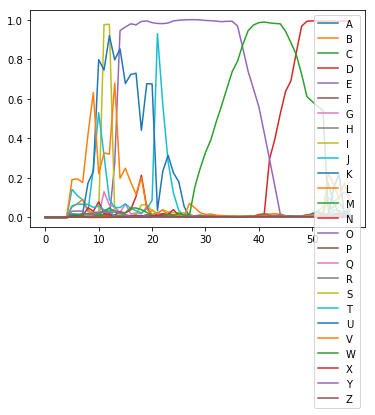

correct: 783 total: 819 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 341
('S', 'S'): 182
('E', 'E'): 382
('T', 'T'): 203
('H', 'H'): 115
('D', 'D'): 173
('K', 'K'): 61
('N', 'N'): 236
('L', 'L'): 194
('R', 'R'): 286
('O', 'O'): 220
('V', 'V'): 158
('B', 'B'): 55
('C', 'C'): 103
('G', 'G'): 75
('P', 'P'): 81
('I', 'I'): 156
('F', 'F'): 55
('W', 'W'): 69
-------('H', 'R'): 3
('U', 'U'): 51
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 45
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 4
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.27685571e-03 5.85055153e-04 1.17960549e-03 9.63660516e-03
  2.83011585e-03 9.24645865e-04 2.61097937e-03 1.16278266e-03
  3.40485270e-03 1.43149123e-03 1.12759629e-02 1.73341483e-03
  4.44526933e-02 1.07731379e-03 2.40920894e-02 2.36680382e-03
  4.45871236e-04 1.98584073e-03 3.05514620e-03 2.05139467e-03
  8.634860

DNNIE DNNIE
edit distance: 0
correct: 785 total: 821 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 341
('S', 'S'): 182
('E', 'E'): 383
('T', 'T'): 203
('H', 'H'): 115
('D', 'D'): 174
('K', 'K'): 61
('N', 'N'): 238
('L', 'L'): 194
('R', 'R'): 287
('O', 'O'): 220
('V', 'V'): 159
('B', 'B'): 55
('C', 'C'): 103
('G', 'G'): 75
('P', 'P'): 81
('I', 'I'): 157
('F', 'F'): 55
('W', 'W'): 69
-------('H', 'R'): 3
('U', 'U'): 51
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 45
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 4
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00192562 0.00101671 0.00144829 ... 0.00139573 0.02719824 0.0011909 ]
 [0.00191099 0.00095533 0.00147176 ... 0.00136811 0.03193224 0.00121706]
 [0.00205771 0.00099216 0.00152945 ... 0.00137664 0.02874864 0.00131233]
 ...
 [0.00175513 0.00117776 0.00258758 ... 0.00517175 0.02447203 0.0010

ILI ILI
edit distance: 0
correct: 787 total: 823 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 342
('S', 'S'): 182
('E', 'E'): 383
('T', 'T'): 204
('H', 'H'): 115
('D', 'D'): 174
('K', 'K'): 61
('N', 'N'): 238
('L', 'L'): 195
('R', 'R'): 288
('O', 'O'): 221
('V', 'V'): 159
('B', 'B'): 55
('C', 'C'): 103
('G', 'G'): 75
('P', 'P'): 81
('I', 'I'): 159
('F', 'F'): 55
('W', 'W'): 69
-------('H', 'R'): 3
('U', 'U'): 51
-------('I', '%'): 8
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 46
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 4
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00157142 0.0007584  0.00139587 ... 0.00194832 0.03663488 0.00067638]
 [0.0017194  0.00095647 0.00189018 ... 0.00218303 0.04686072 0.00092583]
 [0.0018808  0.00107376 0.00234378 ... 0.00253509 0.05161558 0.0012262 ]
 ...
 [0.00121725 0.00084474 0.00150094 ... 0.00111114 0.02682072 0.00075319

F
['A 0.013', 'B 0.007', 'C 0.016', 'D 0.018', 'E 0.389', 'F 0.995', 'G 0.006', 'H 0.005', 'I 0.01', 'J 0.015', 'K 0.005', 'L 0.141', 'M 0.007', 'N 0.006', 'O 0.005', 'P 0.005', 'Q 0.002', 'R 0.002', 'S 0.004', 'T 0.034', 'U 0.006', 'V 0.038', 'W 0.011', 'X 0.003', 'Y 0.008', 'Z 0.004']
['F 8']
F
['A 0.007', 'B 0.006', 'C 0.054', 'D 0.005', 'E 0.03', 'F 0.993', 'G 0.008', 'H 0.004', 'I 0.012', 'J 0.027', 'K 0.004', 'L 0.344', 'M 0.009', 'N 0.011', 'O 0.005', 'P 0.004', 'Q 0.003', 'R 0.003', 'S 0.005', 'T 0.041', 'U 0.008', 'V 0.045', 'W 0.008', 'X 0.005', 'Y 0.017', 'Z 0.003']
['F 9']
F
['A 0.008', 'B 0.006', 'C 0.012', 'D 0.003', 'E 0.02', 'F 0.993', 'G 0.006', 'H 0.005', 'I 0.015', 'J 0.028', 'K 0.003', 'L 0.342', 'M 0.011', 'N 0.012', 'O 0.002', 'P 0.004', 'Q 0.003', 'R 0.003', 'S 0.005', 'T 0.04', 'U 0.007', 'V 0.096', 'W 0.01', 'X 0.003', 'Y 0.022', 'Z 0.001']
['F -5']
F
['A 0.012', 'B 0.005', 'C 0.005', 'D 0.002', 'E 0.01', 'F 0.993', 'G 0.004', 'H 0.009', 'I 0.012', 'J 0.046', '

--pred for 84 156 ['A 0.98 ', 'I 0.01 ', 'O 0.01 ', 'R 0.01 ', 'H 0.00 ']
--pred for 88 158 ['A 0.99 ', 'I 0.01 ', 'L 0.01 ', 'T 0.01 ', 'O 0.01 ']
--pred for 92 158 ['A 0.99 ', 'I 0.02 ', 'L 0.01 ', 'Y 0.01 ', 'F 0.01 ']
--pred for 96 158 ['A 0.99 ', 'L 0.02 ', 'V 0.02 ', 'N 0.02 ', 'R 0.02 ']
--pred for 100 158 ['A 0.99 ', 'I 0.10 ', 'L 0.04 ', 'J 0.02 ', 'T 0.02 ']
--pred for 104 158 ['A 0.99 ', 'J 0.28 ', 'I 0.07 ', 'T 0.03 ', 'H 0.02 ']
--pred for 108 158 ['A 0.99 ', 'J 0.10 ', 'Y 0.06 ', 'V 0.05 ', 'L 0.04 ']
--pred for 112 158 ['A 0.99 ', 'J 0.05 ', 'V 0.05 ', 'T 0.04 ', 'Y 0.04 ']
--pred for 116 158 ['A 0.99 ', 'J 0.06 ', 'T 0.05 ', 'Y 0.04 ', 'V 0.03 ']
--pred for 120 158 ['A 0.99 ', 'T 0.07 ', 'J 0.05 ', 'Y 0.04 ', 'V 0.03 ']
--pred for 124 158 ['A 0.99 ', 'J 0.09 ', 'T 0.07 ', 'Y 0.03 ', 'V 0.03 ']
--pred for 128 158 ['A 0.98 ', 'J 0.09 ', 'T 0.06 ', 'V 0.04 ', 'Y 0.04 ']
--pred for 132 158 ['A 0.95 ', 'J 0.10 ', 'V 0.06 ', 'T 0.05 ', 'Y 0.04 ']
--pred for 136 158 ['A 0.70 '

[[0.00149181 0.00153281 0.00108937 ... 0.00108711 0.07096671 0.00109095]
 [0.00132413 0.0014326  0.00109498 ... 0.00203043 0.03665837 0.00062319]
 [0.00124473 0.00132067 0.00101038 ... 0.00245891 0.03081417 0.00051452]
 ...
 [0.0034261  0.00190615 0.00302381 ... 0.00218784 0.02617359 0.00211746]
 [0.00335347 0.00187076 0.002964   ... 0.00218211 0.02535113 0.00206469]
 [0.00319444 0.00186179 0.00285594 ... 0.00200247 0.02649657 0.00185768]]
--pred for 0 20 ['I 1.00 ', 'V 0.30 ', 'T 0.13 ', 'L 0.10 ', 'J 0.08 ']
--pred for 0 24 ['I 0.99 ', 'F 0.47 ', 'J 0.23 ', 'V 0.21 ', 'T 0.06 ']
--pred for 0 28 ['I 0.99 ', 'F 0.97 ', 'V 0.19 ', 'J 0.16 ', 'H 0.05 ']
--pred for 0 32 ['I 1.00 ', 'F 0.99 ', 'V 0.14 ', 'J 0.12 ', 'H 0.05 ']
--pred for 0 36 ['I 1.00 ', 'F 0.99 ', 'V 0.17 ', 'J 0.05 ', 'H 0.03 ']
--pred for 0 40 ['I 1.00 ', 'F 0.69 ', 'R 0.66 ', 'V 0.17 ', 'T 0.05 ']
--pred for 0 44 ['I 1.00 ', 'R 0.97 ', 'V 0.15 ', 'F 0.08 ', 'T 0.08 ']
--pred for 0 48 ['I 1.00 ', 'R 0.99 ', 'V 0.13 ', 'T

[[0.00130481 0.0008972  0.00135637 ... 0.00163937 0.04715499 0.00058382]
 [0.00116122 0.00084405 0.00121026 ... 0.00196888 0.03548365 0.00057467]
 [0.0012295  0.00099075 0.00133493 ... 0.00230895 0.03778511 0.00077023]
 ...
 [0.00173655 0.00112138 0.00199238 ... 0.00139711 0.02121809 0.00171125]
 [0.00164759 0.00109501 0.00189454 ... 0.00139444 0.02020942 0.00122991]
 [0.00162619 0.0010684  0.00189205 ... 0.00134454 0.02099911 0.00112815]]
--pred for 0 20 ['J 0.24 ', 'H 0.18 ', 'V 0.12 ', 'Y 0.05 ', 'T 0.04 ']
--pred for 0 24 ['H 0.47 ', 'J 0.22 ', 'V 0.10 ', 'T 0.04 ', 'Y 0.04 ']
--pred for 0 28 ['H 0.78 ', 'J 0.16 ', 'V 0.11 ', 'T 0.05 ', 'Y 0.04 ']
--pred for 0 32 ['H 0.98 ', 'V 0.17 ', 'T 0.09 ', 'J 0.04 ', 'L 0.04 ']
--pred for 0 36 ['H 0.99 ', 'V 0.16 ', 'T 0.06 ', 'J 0.05 ', 'Y 0.04 ']
--pred for 0 40 ['H 0.99 ', 'V 0.15 ', 'T 0.07 ', 'J 0.04 ', 'L 0.03 ']
--pred for 0 44 ['H 0.99 ', 'V 0.12 ', 'J 0.08 ', 'I 0.07 ', 'T 0.07 ']
--pred for 0 48 ['H 0.99 ', 'I 0.49 ', 'V 0.24 ', 'W

[[0.00143672 0.00095401 0.00158334 ... 0.00103209 0.02969735 0.00148779]
 [0.00162945 0.00109546 0.00188414 ... 0.00135172 0.03100441 0.00186321]
 [0.00177032 0.00119763 0.00202658 ... 0.00154844 0.03083869 0.00192931]
 ...
 [0.00425162 0.0013959  0.00344836 ... 0.00320559 0.02692012 0.00143622]
 [0.00363804 0.00133644 0.00315607 ... 0.00248924 0.03239591 0.00117521]
 [0.00311484 0.00128862 0.00296553 ... 0.00223429 0.02751119 0.00101398]]
--pred for 0 20 ['L 0.92 ', 'V 0.14 ', 'T 0.12 ', 'Y 0.03 ', 'J 0.02 ']
--pred for 0 24 ['L 0.96 ', 'V 0.14 ', 'T 0.11 ', 'Y 0.03 ', 'A 0.02 ']
--pred for 0 28 ['L 0.98 ', 'V 0.14 ', 'T 0.12 ', 'Y 0.03 ', 'J 0.02 ']
--pred for 0 32 ['L 0.98 ', 'V 0.15 ', 'T 0.12 ', 'Y 0.03 ', 'A 0.03 ']
--pred for 0 36 ['L 0.99 ', 'V 0.14 ', 'T 0.12 ', 'Y 0.03 ', 'J 0.02 ']
--pred for 0 40 ['L 0.99 ', 'V 0.15 ', 'T 0.12 ', 'Y 0.02 ', 'A 0.02 ']
--pred for 0 44 ['L 0.99 ', 'V 0.28 ', 'T 0.09 ', 'I 0.04 ', 'W 0.04 ']
--pred for 0 48 ['I 0.99 ', 'L 0.99 ', 'V 0.27 ', 'T

[[0.00239068 0.00160304 0.0017341  ... 0.00141519 0.0330049  0.00115436]
 [0.00311569 0.00204955 0.00208354 ... 0.0015455  0.03763899 0.00168328]
 [0.00333435 0.00224111 0.00220778 ... 0.00182055 0.03131561 0.00178477]
 ...
 [0.00331809 0.00231001 0.00334788 ... 0.00217452 0.02867384 0.00162123]
 [0.00335016 0.00206292 0.00306709 ... 0.00232959 0.0273558  0.00184297]
 [0.00322371 0.00193991 0.00289345 ... 0.00220968 0.02644843 0.00186085]]
--pred for 0 20 ['V 0.16 ', 'R 0.12 ', 'T 0.07 ', 'W 0.06 ', 'J 0.05 ']
--pred for 0 24 ['E 0.77 ', 'T 0.18 ', 'V 0.14 ', 'R 0.06 ', 'L 0.05 ']
--pred for 0 28 ['E 0.91 ', 'V 0.16 ', 'T 0.16 ', 'R 0.09 ', 'L 0.05 ']
--pred for 0 32 ['E 0.85 ', 'T 0.17 ', 'V 0.15 ', 'L 0.05 ', 'W 0.04 ']
--pred for 0 36 ['I 0.98 ', 'E 0.91 ', 'V 0.23 ', 'T 0.10 ', 'L 0.08 ']
--pred for 0 40 ['E 0.95 ', 'I 0.90 ', 'V 0.20 ', 'T 0.08 ', 'L 0.05 ']
--pred for 0 44 ['I 1.00 ', 'E 0.88 ', 'V 0.32 ', 'C 0.07 ', 'W 0.06 ']
--pred for 0 48 ['I 1.00 ', 'E 0.74 ', 'C 0.29 ', 'V

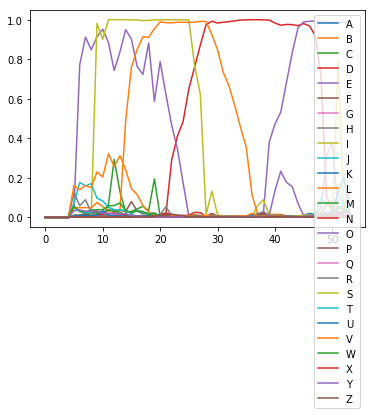

correct: 798 total: 835 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 348
('S', 'S'): 187
('E', 'E'): 395
('T', 'T'): 204
('H', 'H'): 116
('D', 'D'): 178
('K', 'K'): 62
('N', 'N'): 241
('L', 'L'): 199
('R', 'R'): 292
('O', 'O'): 221
('V', 'V'): 160
('B', 'B'): 55
('C', 'C'): 104
('G', 'G'): 75
('P', 'P'): 81
('I', 'I'): 163
('F', 'F'): 58
('W', 'W'): 69
-------('H', 'R'): 3
('U', 'U'): 52
-------('I', '%'): 9
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 46
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 4
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00153334 0.00103932 0.00159504 ... 0.00086603 0.02903133 0.00094518]
 [0.00151967 0.00104578 0.00187167 ... 0.00117776 0.03024915 0.00155998]
 [0.00162286 0.00115795 0.00205629 ... 0.00132321 0.03096359 0.00170098]
 ...
 [0.00293973 0.00177054 0.00269122 ... 0.00171135 0.03686213 0.00129808]
 [0.00276853 0.00167666

RLPB RLPB
edit distance: 0
correct: 800 total: 837 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 349
('S', 'S'): 187
('E', 'E'): 396
('T', 'T'): 204
('H', 'H'): 116
('D', 'D'): 179
('K', 'K'): 62
('N', 'N'): 241
('L', 'L'): 201
('R', 'R'): 294
('O', 'O'): 221
('V', 'V'): 161
('B', 'B'): 56
('C', 'C'): 104
('G', 'G'): 75
('P', 'P'): 82
('I', 'I'): 163
('F', 'F'): 58
('W', 'W'): 69
-------('H', 'R'): 3
('U', 'U'): 52
-------('I', '%'): 9
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 46
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 4
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.0014205  0.00074514 0.00141976 ... 0.00163868 0.03679777 0.00066596]
 [0.00159331 0.00089795 0.00171697 ... 0.0018858  0.04417519 0.00086987]
 [0.00186472 0.00115826 0.00230932 ... 0.00249872 0.0468916  0.00128623]
 ...
 [0.00308105 0.00171983 0.00275269 ... 0.00180462 0.03186364 0.002579

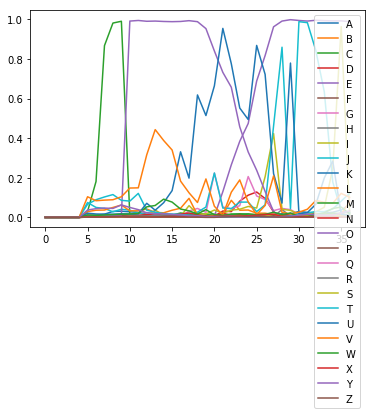

correct: 800 total: 838 accuracy: 0.955 avgEditDist 0.051
('A', 'A'): 349
('S', 'S'): 187
('E', 'E'): 397
('T', 'T'): 204
('H', 'H'): 116
('D', 'D'): 179
('K', 'K'): 62
('N', 'N'): 241
('L', 'L'): 201
('R', 'R'): 294
('O', 'O'): 222
('V', 'V'): 161
('B', 'B'): 56
('C', 'C'): 104
('G', 'G'): 75
('P', 'P'): 82
('I', 'I'): 163
('F', 'F'): 58
('W', 'W'): 69
-------('H', 'R'): 3
('U', 'U'): 52
-------('I', '%'): 9
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 46
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.0015797  0.00130284 0.00239205 ... 0.00130577 0.03691624 0.00209559]
 [0.00162813 0.00152587 0.00303603 ... 0.00188898 0.03872862 0.00317754]
 [0.001935   0.00179621 0.00341381 ... 0.00265453 0.04360157 0.00287301]
 ...
 [0.00319057 0.00209046 0.00331005 ... 0.00200396 0.03486551 0.00151599]
 [0.00317244 0.00190393

[[0.00164386 0.00130765 0.002391   ... 0.00126493 0.034433   0.00186428]
 [0.00186135 0.00174848 0.00353898 ... 0.00247004 0.0494328  0.00195807]
 [0.00202804 0.00205259 0.00402658 ... 0.0031029  0.06283474 0.0024089 ]
 ...
 [0.00103578 0.00064157 0.00105703 ... 0.0009886  0.01421115 0.00121132]
 [0.00124468 0.00070521 0.00121168 ... 0.00115481 0.02235666 0.00074258]
 [0.00141467 0.00079774 0.00133288 ... 0.00106025 0.03863738 0.00077276]]
--pred for 0 20 ['T 0.16 ', 'L 0.14 ', 'V 0.09 ', 'D 0.07 ', 'J 0.04 ']
--pred for 0 24 ['D 0.46 ', 'C 0.33 ', 'T 0.17 ', 'V 0.10 ', 'J 0.10 ']
--pred for 0 28 ['D 0.63 ', 'C 0.47 ', 'T 0.15 ', 'V 0.12 ', 'J 0.10 ']
--pred for 0 32 ['D 0.99 ', 'V 0.16 ', 'T 0.14 ', 'L 0.04 ', 'Y 0.04 ']
--pred for 0 36 ['D 0.99 ', 'V 0.14 ', 'T 0.12 ', 'J 0.04 ', 'L 0.04 ']
--pred for 0 40 ['D 0.99 ', 'I 0.65 ', 'V 0.16 ', 'T 0.11 ', 'Y 0.05 ']
--pred for 0 44 ['I 0.99 ', 'D 0.99 ', 'V 0.17 ', 'T 0.06 ', 'L 0.05 ']
--pred for 0 48 ['D 0.99 ', 'I 0.98 ', 'V 0.17 ', 'T

WLTOAN WLTOAN
edit distance: 0
correct: 804 total: 842 accuracy: 0.955 avgEditDist 0.051
('A', 'A'): 351
('S', 'S'): 188
('E', 'E'): 398
('T', 'T'): 205
('H', 'H'): 117
('D', 'D'): 181
('K', 'K'): 63
('N', 'N'): 242
('L', 'L'): 202
('R', 'R'): 294
('O', 'O'): 223
('V', 'V'): 162
('B', 'B'): 56
('C', 'C'): 104
('G', 'G'): 75
('P', 'P'): 83
('I', 'I'): 163
('F', 'F'): 58
('W', 'W'): 70
-------('H', 'R'): 3
('U', 'U'): 52
-------('I', '%'): 9
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 46
-------('T', '%'): 7
-------('%', 'T'): 4
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[8.73403042e-04 8.71548778e-04 1.38411019e-03 4.48479177e-03
  2.55178474e-03 2.70158728e-03 1.43135153e-03 4.56137379e-04
  5.54908300e-03 1.99558330e-03 1.23952609e-02 7.32600223e-03
  7.69921765e-02 1.34440628e-03 2.53559053e-02 6.57021880e-01
  6.42385567e-03 2.56466260e-03 2.9503859

[[0.00299843 0.00109411 0.00263246 ... 0.00228796 0.05326359 0.00097971]
 [0.00383844 0.00121073 0.00312261 ... 0.00291788 0.04372296 0.00134636]
 [0.00408373 0.00122487 0.00325439 ... 0.00283088 0.04709124 0.00145655]
 ...
 [0.00169762 0.00119739 0.00196317 ... 0.00145639 0.01937982 0.00119449]
 [0.00169201 0.00121498 0.00199094 ... 0.00147666 0.01855747 0.00117466]
 [0.00165843 0.00116116 0.00199289 ... 0.00148187 0.02110807 0.0010524 ]]
--pred for 0 20 ['S 0.78 ', 'V 0.17 ', 'T 0.07 ', 'J 0.07 ', 'Y 0.05 ']
--pred for 0 24 ['S 0.96 ', 'V 0.16 ', 'T 0.08 ', 'L 0.06 ', 'J 0.05 ']
--pred for 0 28 ['S 0.96 ', 'V 0.17 ', 'T 0.08 ', 'L 0.05 ', 'Y 0.05 ']
--pred for 0 32 ['S 0.98 ', 'V 0.17 ', 'T 0.07 ', 'L 0.06 ', 'Y 0.05 ']
--pred for 0 36 ['S 0.99 ', 'V 0.17 ', 'T 0.07 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 40 ['S 0.99 ', 'V 0.21 ', 'T 0.12 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 44 ['S 0.99 ', 'V 0.38 ', 'L 0.07 ', 'Y 0.04 ', 'T 0.04 ']
--pred for 0 48 ['S 0.99 ', 'V 0.50 ', 'L 0.03 ', 'W

[[0.00155144 0.00074496 0.00143614 ... 0.00122532 0.03258516 0.00098585]
 [0.00172447 0.00091758 0.00125093 ... 0.00118006 0.03148571 0.00102785]
 [0.00195531 0.00110689 0.00139414 ... 0.00129282 0.03080937 0.00113676]
 ...
 [0.00168325 0.00085493 0.00155631 ... 0.00141756 0.01807735 0.00106451]
 [0.00177861 0.00090736 0.00153282 ... 0.00131401 0.02842159 0.00110244]
 [0.00195576 0.00102501 0.00163455 ... 0.00160496 0.0248057  0.00096116]]
--pred for 0 20 ['T 0.52 ', 'V 0.06 ', 'J 0.04 ', 'Y 0.03 ', 'L 0.03 ']
--pred for 0 24 ['T 0.89 ', 'V 0.08 ', 'J 0.06 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 28 ['T 0.89 ', 'V 0.09 ', 'J 0.05 ', 'L 0.05 ', 'I 0.03 ']
--pred for 0 32 ['T 0.95 ', 'V 0.10 ', 'L 0.04 ', 'J 0.04 ', 'Y 0.03 ']
--pred for 0 36 ['T 0.97 ', 'V 0.11 ', 'L 0.04 ', 'Y 0.03 ', 'J 0.03 ']
--pred for 0 40 ['T 0.99 ', 'V 0.12 ', 'L 0.04 ', 'Y 0.03 ', 'A 0.03 ']
--pred for 0 44 ['T 0.99 ', 'V 0.14 ', 'L 0.04 ', 'Y 0.03 ', 'A 0.03 ']
--pred for 0 48 ['T 0.99 ', 'I 0.73 ', 'V 0.19 ', 'L

[[3.28108156e-03 2.20392575e-03 2.91990768e-03 2.32852008e-02
  9.11669526e-03 1.98570173e-03 2.10228027e-03 9.51446414e-01
  7.33634410e-03 3.95402126e-03 1.71378553e-02 4.78183944e-03
  5.72021790e-02 2.25167489e-03 3.93784195e-02 5.70651051e-03
  1.73311122e-03 8.07598326e-03 2.73686391e-03 4.04165778e-03
  2.53024208e-03 4.21608426e-03 5.86916171e-02 6.84424443e-03
  1.29737243e-01 1.44549683e-02 1.99638796e-03 4.76254448e-02
  1.40188483e-03]
 [3.46501172e-03 2.14829808e-03 3.08576995e-03 3.93128619e-02
  1.08740879e-02 1.98422256e-03 2.31498200e-03 9.84853864e-01
  7.01531209e-03 5.69258630e-03 1.40185142e-02 4.60153678e-03
  3.35652269e-02 2.18809745e-03 4.27366532e-02 4.67965892e-03
  1.97235541e-03 4.58461046e-03 2.68316153e-03 4.07858752e-03
  2.18179659e-03 4.05241689e-03 8.39033201e-02 9.12537426e-03
  1.14245422e-01 1.56341791e-02 2.26979470e-03 3.71219330e-02
  1.64473453e-03]
 [3.58930230e-03 2.13942956e-03 3.07996501e-03 4.02423851e-02
  1.00050224e-02 1.84230588e-03 2.

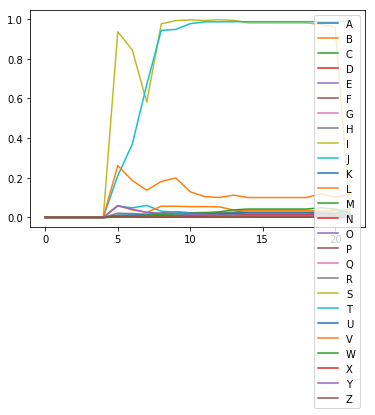

correct: 811 total: 850 accuracy: 0.954 avgEditDist 0.053
('A', 'A'): 353
('S', 'S'): 192
('E', 'E'): 400
('T', 'T'): 208
('H', 'H'): 117
('D', 'D'): 181
('K', 'K'): 63
('N', 'N'): 243
('L', 'L'): 203
('R', 'R'): 295
('O', 'O'): 223
('V', 'V'): 163
('B', 'B'): 57
('C', 'C'): 104
('G', 'G'): 75
('P', 'P'): 83
('I', 'I'): 164
('F', 'F'): 58
('W', 'W'): 72
-------('H', 'R'): 3
('U', 'U'): 52
-------('I', '%'): 9
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 47
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00162823 0.00116947 0.00178317 ... 0.00119765 0.01975331 0.00075387]
 [0.00177339 0.00118416 0.00177571 ... 0.0013692  0.02661605 0.00085099]
 [0.00250245 0.00142852 0.00206624 ... 0.0011286  0.0323533  0.00103396]
 ...
 [0.00180358 0.00087571 0.00149865 ... 0.00148535 0.02045285 0.00092464]
 [0.0014679  0.00077628

[[3.01357638e-03 2.02704663e-03 2.93865753e-03 2.66984012e-02
  1.41069721e-02 1.52645714e-03 2.03842414e-03 9.70134556e-01
  7.44991330e-03 3.15169687e-03 1.62978824e-02 4.25176602e-03
  5.78598380e-02 3.09179001e-03 4.47107702e-02 4.89138998e-03
  1.94172922e-03 3.50209884e-03 2.28376780e-03 3.66932247e-03
  1.92000950e-03 3.73311201e-03 6.93347678e-02 8.02220218e-03
  1.10205323e-01 1.22134294e-02 2.19254429e-03 4.00348343e-02
  1.36672996e-03]
 [3.35377827e-03 2.10903026e-03 3.13441129e-03 3.85125317e-02
  1.23692323e-02 1.74754870e-03 2.38704821e-03 9.82826531e-01
  7.73369381e-03 4.04894259e-03 1.32305017e-02 4.96780267e-03
  4.10058722e-02 2.75375927e-03 4.41735685e-02 4.68281610e-03
  2.13583908e-03 3.42602679e-03 2.33030855e-03 3.96637153e-03
  2.20097695e-03 3.61336349e-03 9.62247699e-02 1.05369985e-02
  1.09564699e-01 1.36973029e-02 2.25886912e-03 3.55328768e-02
  1.52736285e-03]
 [3.51298018e-03 2.20321491e-03 3.21881962e-03 3.72455418e-02
  1.11929411e-02 1.81068410e-03 2.

OE OE
edit distance: 0
correct: 816 total: 855 accuracy: 0.954 avgEditDist 0.053
('A', 'A'): 354
('S', 'S'): 193
('E', 'E'): 404
('T', 'T'): 208
('H', 'H'): 117
('D', 'D'): 183
('K', 'K'): 63
('N', 'N'): 244
('L', 'L'): 203
('R', 'R'): 295
('O', 'O'): 225
('V', 'V'): 163
('B', 'B'): 57
('C', 'C'): 105
('G', 'G'): 75
('P', 'P'): 83
('I', 'I'): 165
('F', 'F'): 58
('W', 'W'): 72
-------('H', 'R'): 3
('U', 'U'): 52
-------('I', '%'): 9
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 47
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00159272 0.00096294 0.00146439 ... 0.00109416 0.03297066 0.00077371]
 [0.00144234 0.00089078 0.00142524 ... 0.00086866 0.0365449  0.00103649]
 [0.00148873 0.00101548 0.00166422 ... 0.00096962 0.03017346 0.00128118]
 ...
 [0.00286636 0.00160781 0.00263243 ... 0.00161468 0.04125937 0.00125568]


OF OF
edit distance: 0
correct: 818 total: 857 accuracy: 0.954 avgEditDist 0.053
('A', 'A'): 355
('S', 'S'): 194
('E', 'E'): 404
('T', 'T'): 208
('H', 'H'): 117
('D', 'D'): 184
('K', 'K'): 63
('N', 'N'): 244
('L', 'L'): 206
('R', 'R'): 295
('O', 'O'): 226
('V', 'V'): 163
('B', 'B'): 57
('C', 'C'): 105
('G', 'G'): 75
('P', 'P'): 83
('I', 'I'): 165
('F', 'F'): 59
('W', 'W'): 72
-------('H', 'R'): 3
('U', 'U'): 52
-------('I', '%'): 9
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 47
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.75496028e-03 9.94076720e-04 1.50653953e-03 2.06741288e-01
  3.26635479e-03 1.17205188e-03 2.00464460e-03 1.54393003e-03
  4.21788450e-03 1.54157670e-03 1.58196911e-02 3.65723716e-03
  3.85129839e-01 1.27376872e-03 3.82380635e-02 2.23188801e-03
  2.18616193e-03 1.78421987e-03 2.21077842e-03 1.

RMARAK RMARAK
edit distance: 0
correct: 820 total: 859 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 358
('S', 'S'): 194
('E', 'E'): 404
('T', 'T'): 208
('H', 'H'): 117
('D', 'D'): 184
('K', 'K'): 64
('N', 'N'): 244
('L', 'L'): 206
('R', 'R'): 297
('O', 'O'): 226
('V', 'V'): 163
('B', 'B'): 57
('C', 'C'): 106
('G', 'G'): 75
('P', 'P'): 83
('I', 'I'): 165
('F', 'F'): 59
('W', 'W'): 72
-------('H', 'R'): 3
('U', 'U'): 52
-------('I', '%'): 9
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 48
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.65311026e-03 9.27462708e-04 1.51034596e-03 1.92282528e-01
  3.17382463e-03 1.18599529e-03 1.83811923e-03 1.20434840e-03
  4.50369995e-03 1.36745919e-03 1.63755603e-02 3.92591022e-03
  3.29700857e-01 1.13656407e-03 3.92750688e-02 2.56438833e-03
  3.94145679e-03 2.01218855e-03 2.2656130

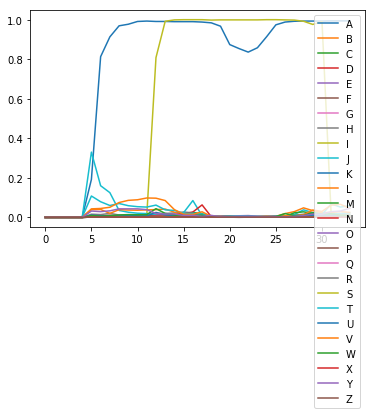

correct: 820 total: 860 accuracy: 0.953 avgEditDist 0.053
('A', 'A'): 360
('S', 'S'): 194
('E', 'E'): 404
('T', 'T'): 208
('H', 'H'): 117
('D', 'D'): 184
('K', 'K'): 64
('N', 'N'): 244
('L', 'L'): 206
('R', 'R'): 297
('O', 'O'): 226
('V', 'V'): 163
('B', 'B'): 57
('C', 'C'): 106
('G', 'G'): 75
('P', 'P'): 83
('I', 'I'): 166
('F', 'F'): 59
('W', 'W'): 72
-------('H', 'R'): 3
('U', 'U'): 52
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 48
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00154464 0.00086206 0.00149075 ... 0.00156137 0.0352416  0.00078632]
 [0.00175494 0.00102719 0.00188273 ... 0.00214347 0.04085874 0.00102134]
 [0.00185383 0.00129623 0.00236475 ... 0.00242725 0.04530639 0.00127659]
 ...
 [0.00447738 0.00134287 0.00370036 ... 0.00418845 0.02577863 0.00156448]
 [0.00356589 0.001242 

OLLEA OLLEA
edit distance: 0
correct: 822 total: 862 accuracy: 0.954 avgEditDist 0.053
('A', 'A'): 361
('S', 'S'): 196
('E', 'E'): 405
('T', 'T'): 209
('H', 'H'): 117
('D', 'D'): 184
('K', 'K'): 64
('N', 'N'): 244
('L', 'L'): 209
('R', 'R'): 298
('O', 'O'): 228
('V', 'V'): 163
('B', 'B'): 57
('C', 'C'): 106
('G', 'G'): 75
('P', 'P'): 83
('I', 'I'): 166
('F', 'F'): 59
('W', 'W'): 72
-------('H', 'R'): 3
('U', 'U'): 52
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 48
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00132268 0.00099392 0.00159741 ... 0.00096898 0.02822835 0.00054773]
 [0.00123663 0.00098165 0.00178526 ... 0.00122637 0.02611362 0.00062788]
 [0.0011196  0.00093424 0.00166331 ... 0.00118423 0.02066077 0.00054934]
 ...
 [0.00163451 0.00172208 0.00303272 ... 0.00370094 0.02536031 0.001

HDSN HDSN
edit distance: 0
correct: 824 total: 864 accuracy: 0.954 avgEditDist 0.053
('A', 'A'): 361
('S', 'S'): 198
('E', 'E'): 405
('T', 'T'): 209
('H', 'H'): 118
('D', 'D'): 186
('K', 'K'): 64
('N', 'N'): 246
('L', 'L'): 209
('R', 'R'): 298
('O', 'O'): 228
('V', 'V'): 163
('B', 'B'): 57
('C', 'C'): 106
('G', 'G'): 75
('P', 'P'): 83
('I', 'I'): 166
('F', 'F'): 59
('W', 'W'): 72
-------('H', 'R'): 3
('U', 'U'): 52
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 48
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00177376 0.00094877 0.00144601 ... 0.00104539 0.02305711 0.00069992]
 [0.00218185 0.00114226 0.0016688  ... 0.00134687 0.0268648  0.00092297]
 [0.00266007 0.00134056 0.00208807 ... 0.00127633 0.03740977 0.00119684]
 ...
 [0.00158665 0.00151501 0.00289413 ... 0.00349979 0.03024168 0.00119

[[0.00144346 0.00105331 0.00139512 ... 0.00248783 0.04620381 0.00066475]
 [0.00146487 0.00117075 0.00142113 ... 0.00257982 0.04135133 0.00071907]
 [0.00156817 0.00122775 0.00146616 ... 0.00247839 0.03738804 0.0007568 ]
 ...
 [0.003344   0.00211737 0.00305473 ... 0.00226088 0.02469382 0.0020884 ]
 [0.00292941 0.00168718 0.0023705  ... 0.00214415 0.02441467 0.00301799]
 [0.00274533 0.00170718 0.00233892 ... 0.00186489 0.02477996 0.00255748]]
--pred for 0 20 ['F 0.60 ', 'J 0.27 ', 'V 0.13 ', 'T 0.05 ', 'Y 0.05 ']
--pred for 0 24 ['F 0.71 ', 'J 0.19 ', 'V 0.16 ', 'R 0.08 ', 'P 0.07 ']
--pred for 0 28 ['F 0.69 ', 'J 0.16 ', 'V 0.15 ', 'R 0.11 ', 'P 0.08 ']
--pred for 0 32 ['P 0.62 ', 'F 0.30 ', 'V 0.16 ', 'J 0.10 ', 'T 0.05 ']
--pred for 0 36 ['P 0.98 ', 'V 0.14 ', 'T 0.07 ', 'J 0.04 ', 'Y 0.03 ']
--pred for 0 40 ['P 0.97 ', 'V 0.20 ', 'T 0.06 ', 'W 0.04 ', 'U 0.03 ']
--pred for 0 44 ['P 0.98 ', 'U 0.34 ', 'V 0.17 ', 'T 0.04 ', 'W 0.04 ']
--pred for 0 48 ['P 0.98 ', 'U 0.33 ', 'V 0.12 ', 'W

[[0.00157585 0.00110909 0.0014768  ... 0.00214149 0.0367826  0.00068749]
 [0.00152042 0.00097972 0.00134932 ... 0.00285073 0.03437513 0.00061829]
 [0.00182615 0.00115786 0.00142579 ... 0.00261007 0.03228179 0.00070679]
 ...
 [0.00303663 0.00221754 0.00146779 ... 0.00245577 0.02745193 0.00271834]
 [0.00265803 0.00184768 0.00136814 ... 0.00247728 0.02945026 0.00280046]
 [0.00240533 0.00166423 0.00134466 ... 0.00250854 0.03285241 0.0024985 ]]
--pred for 0 20 ['F 0.30 ', 'J 0.19 ', 'V 0.15 ', 'R 0.06 ', 'Y 0.04 ']
--pred for 0 24 ['F 0.91 ', 'J 0.16 ', 'V 0.13 ', 'T 0.04 ', 'Y 0.03 ']
--pred for 0 28 ['F 0.78 ', 'V 0.13 ', 'J 0.13 ', 'R 0.11 ', 'T 0.04 ']
--pred for 0 32 ['R 0.93 ', 'V 0.14 ', 'T 0.06 ', 'J 0.04 ', 'F 0.04 ']
--pred for 0 36 ['R 0.98 ', 'V 0.16 ', 'T 0.08 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 40 ['R 0.99 ', 'V 0.18 ', 'T 0.08 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 44 ['R 0.99 ', 'V 0.14 ', 'T 0.06 ', 'L 0.05 ', 'A 0.04 ']
--pred for 0 48 ['R 0.99 ', 'J 0.09 ', 'A 0.07 ', 'V

NSTLBV NSTLBV
edit distance: 0
correct: 829 total: 869 accuracy: 0.954 avgEditDist 0.053
('A', 'A'): 363
('S', 'S'): 199
('E', 'E'): 406
('T', 'T'): 212
('H', 'H'): 119
('D', 'D'): 187
('K', 'K'): 64
('N', 'N'): 248
('L', 'L'): 211
('R', 'R'): 301
('O', 'O'): 232
('V', 'V'): 165
('B', 'B'): 58
('C', 'C'): 106
('G', 'G'): 75
('P', 'P'): 84
('I', 'I'): 166
('F', 'F'): 59
('W', 'W'): 72
-------('H', 'R'): 3
('U', 'U'): 52
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 48
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00326766 0.00231831 0.00318729 ... 0.00237999 0.03861067 0.00169362]
 [0.00336567 0.00220794 0.00318229 ... 0.00231364 0.03372712 0.00189573]
 [0.00360978 0.00223516 0.00331878 ... 0.00229057 0.03333985 0.00180887]
 ...
 [0.0028247  0.00150854 0.00243797 ... 0.00166965 0.05025905 0.0

[[0.00242171 0.00188759 0.00254468 ... 0.0017382  0.03841873 0.00123185]
 [0.00284872 0.00208556 0.00292169 ... 0.00194285 0.035056   0.00152359]
 [0.0028999  0.0021345  0.00293862 ... 0.00190981 0.03321574 0.00162229]
 ...
 [0.00179218 0.00218574 0.00326538 ... 0.00295033 0.03135604 0.00127058]
 [0.00169511 0.0018602  0.00308728 ... 0.00329624 0.02590599 0.0012214 ]
 [0.0016386  0.00140314 0.0027212  ... 0.00431566 0.02063334 0.00107543]]
--pred for 0 20 ['E 0.94 ', 'V 0.13 ', 'J 0.08 ', 'T 0.05 ', 'Y 0.04 ']
--pred for 0 24 ['E 0.98 ', 'V 0.12 ', 'T 0.08 ', 'J 0.04 ', 'Y 0.04 ']
--pred for 0 28 ['E 0.96 ', 'V 0.12 ', 'T 0.08 ', 'B 0.04 ', 'L 0.04 ']
--pred for 0 32 ['B 0.98 ', 'V 0.13 ', 'T 0.09 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 36 ['B 1.00 ', 'V 0.14 ', 'T 0.12 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 40 ['B 1.00 ', 'V 0.13 ', 'T 0.12 ', 'L 0.05 ', 'A 0.03 ']
--pred for 0 44 ['B 0.99 ', 'I 0.94 ', 'V 0.14 ', 'L 0.06 ', 'T 0.06 ']
--pred for 0 48 ['B 0.99 ', 'I 0.98 ', 'V 0.18 ', 'L

USNW USNW
edit distance: 0
correct: 832 total: 872 accuracy: 0.954 avgEditDist 0.053
('A', 'A'): 364
('S', 'S'): 200
('E', 'E'): 407
('T', 'T'): 212
('H', 'H'): 119
('D', 'D'): 188
('K', 'K'): 64
('N', 'N'): 250
('L', 'L'): 211
('R', 'R'): 301
('O', 'O'): 232
('V', 'V'): 165
('B', 'B'): 59
('C', 'C'): 107
('G', 'G'): 76
('P', 'P'): 84
('I', 'I'): 166
('F', 'F'): 59
('W', 'W'): 73
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 48
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[2.43549375e-03 8.75538273e-04 1.99606107e-03 3.13871391e-02
  2.68605584e-03 1.22601108e-03 2.52561807e-03 2.81518325e-03
  3.83240753e-03 1.67549239e-03 2.32924465e-02 2.40690052e-03
  1.04578063e-01 3.38934339e-03 5.46880402e-02 2.87021929e-03
  7.34232657e-04 1.72215980e-03 2.03130906e-

[[0.00168026 0.0010464  0.00161911 ... 0.0019303  0.0492596  0.00069872]
 [0.00184133 0.00124535 0.00150139 ... 0.00257399 0.03706128 0.00078387]
 [0.00211002 0.00131968 0.00139781 ... 0.00246114 0.03281461 0.0009104 ]
 ...
 [0.0045758  0.00143276 0.0037911  ... 0.00438897 0.03199219 0.00164132]
 [0.00390159 0.0012764  0.00330021 ... 0.00350974 0.0342484  0.0013455 ]
 [0.00263022 0.00112107 0.00262165 ... 0.00242816 0.02504496 0.00086788]]
--pred for 0 20 ['V 0.22 ', 'J 0.20 ', 'F 0.05 ', 'Y 0.05 ', 'T 0.04 ']
--pred for 0 24 ['F 0.42 ', 'R 0.26 ', 'V 0.20 ', 'J 0.14 ', 'Y 0.04 ']
--pred for 0 28 ['R 0.64 ', 'F 0.26 ', 'V 0.17 ', 'J 0.12 ', 'L 0.03 ']
--pred for 0 32 ['R 0.98 ', 'V 0.15 ', 'T 0.06 ', 'J 0.05 ', 'L 0.05 ']
--pred for 0 36 ['R 0.99 ', 'V 0.16 ', 'T 0.08 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 40 ['R 0.99 ', 'V 0.19 ', 'T 0.08 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 44 ['R 0.99 ', 'V 0.12 ', 'T 0.09 ', 'L 0.06 ', 'J 0.03 ']
--pred for 0 48 ['R 0.99 ', 'I 0.93 ', 'V 0.12 ', 'W

OCMRHL OCMRHL
edit distance: 0
correct: 836 total: 876 accuracy: 0.954 avgEditDist 0.053
('A', 'A'): 364
('S', 'S'): 202
('E', 'E'): 408
('T', 'T'): 212
('H', 'H'): 120
('D', 'D'): 189
('K', 'K'): 64
('N', 'N'): 250
('L', 'L'): 213
('R', 'R'): 304
('O', 'O'): 234
('V', 'V'): 166
('B', 'B'): 59
('C', 'C'): 108
('G', 'G'): 76
('P', 'P'): 84
('I', 'I'): 166
('F', 'F'): 59
('W', 'W'): 73
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 49
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00183711 0.00105902 0.00141611 ... 0.00135477 0.02049593 0.00101637]
 [0.00199269 0.00103399 0.00146616 ... 0.00132487 0.02527612 0.00134059]
 [0.00227792 0.00111188 0.00161741 ... 0.00139444 0.02295256 0.00139586]
 ...
 [0.00145229 0.00123782 0.0024322  ... 0.00423725 0.02790687 0.0

SF SF
edit distance: 0
correct: 838 total: 878 accuracy: 0.954 avgEditDist 0.052
('A', 'A'): 364
('S', 'S'): 204
('E', 'E'): 408
('T', 'T'): 213
('H', 'H'): 120
('D', 'D'): 190
('K', 'K'): 64
('N', 'N'): 250
('L', 'L'): 213
('R', 'R'): 304
('O', 'O'): 234
('V', 'V'): 166
('B', 'B'): 59
('C', 'C'): 109
('G', 'G'): 76
('P', 'P'): 84
('I', 'I'): 166
('F', 'F'): 60
('W', 'W'): 73
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 50
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00181936 0.00100768 0.00155579 ... 0.00097662 0.02476069 0.00072676]
 [0.00201032 0.00105605 0.00158417 ... 0.00146482 0.02965301 0.00082374]
 [0.0026382  0.00129693 0.00193719 ... 0.00108453 0.03741439 0.00108657]
 ...
 [0.00133247 0.00072818 0.00117368 ... 0.0009322  0.01811522 0.00075423]

VLKAN VLKAN
edit distance: 0
correct: 840 total: 880 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 367
('S', 'S'): 204
('E', 'E'): 408
('T', 'T'): 214
('H', 'H'): 120
('D', 'D'): 190
('K', 'K'): 65
('N', 'N'): 251
('L', 'L'): 214
('R', 'R'): 305
('O', 'O'): 234
('V', 'V'): 167
('B', 'B'): 59
('C', 'C'): 109
('G', 'G'): 76
('P', 'P'): 84
('I', 'I'): 166
('F', 'F'): 60
('W', 'W'): 73
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 50
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00296356 0.00206091 0.00300506 ... 0.00211367 0.03901345 0.00150416]
 [0.00349285 0.00235284 0.00339277 ... 0.00255348 0.03582186 0.0016475 ]
 [0.00360233 0.00239798 0.00346522 ... 0.00261145 0.03215531 0.00173714]
 ...
 [0.00206451 0.00090628 0.00150301 ... 0.00214999 0.02076451 0.000

CDL CDL
edit distance: 0
correct: 842 total: 882 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 368
('S', 'S'): 204
('E', 'E'): 409
('T', 'T'): 215
('H', 'H'): 120
('D', 'D'): 192
('K', 'K'): 65
('N', 'N'): 252
('L', 'L'): 215
('R', 'R'): 305
('O', 'O'): 234
('V', 'V'): 167
('B', 'B'): 59
('C', 'C'): 110
('G', 'G'): 76
('P', 'P'): 84
('I', 'I'): 167
('F', 'F'): 60
('W', 'W'): 73
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 50
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.3636694e-03 9.2495739e-04 1.0329925e-03 5.8314404e-03 2.9568372e-03
  6.2746217e-04 1.1198631e-03 2.8521924e-03 6.1678723e-03 1.9914233e-03
  2.2742894e-02 9.1517872e-01 5.4359321e-02 1.2706569e-03 7.2052084e-02
  4.2699152e-03 1.8600401e-03 9.9455891e-04 3.0120884e-03 2.0832969e-03
  7.50

[[0.00130847 0.00093086 0.00118715 ... 0.00226554 0.03932285 0.00054225]
 [0.00140713 0.0009728  0.00124457 ... 0.00300404 0.03605133 0.00061197]
 [0.00300478 0.00175288 0.0014147  ... 0.00236108 0.03436041 0.00124448]
 ...
 [0.00152769 0.00103038 0.00218977 ... 0.00526482 0.02773304 0.00093097]
 [0.00146331 0.00094931 0.00192223 ... 0.00663029 0.02419915 0.00087012]
 [0.00149491 0.00088111 0.00178846 ... 0.00716619 0.02446449 0.0007372 ]]
--pred for 0 20 ['F 0.57 ', 'J 0.21 ', 'V 0.15 ', 'T 0.06 ', 'Y 0.04 ']
--pred for 0 24 ['F 0.92 ', 'J 0.18 ', 'V 0.13 ', 'T 0.04 ', 'Y 0.04 ']
--pred for 0 28 ['R 0.93 ', 'V 0.16 ', 'F 0.12 ', 'J 0.08 ', 'T 0.06 ']
--pred for 0 32 ['R 0.99 ', 'V 0.17 ', 'T 0.08 ', 'L 0.05 ', 'J 0.04 ']
--pred for 0 36 ['R 0.99 ', 'V 0.18 ', 'T 0.09 ', 'L 0.05 ', 'J 0.03 ']
--pred for 0 40 ['R 0.99 ', 'J 0.17 ', 'V 0.13 ', 'T 0.06 ', 'L 0.05 ']
--pred for 0 44 ['R 0.99 ', 'J 0.18 ', 'V 0.14 ', 'L 0.05 ', 'H 0.03 ']
--pred for 0 48 ['R 0.99 ', 'V 0.31 ', 'S 0.16 ', 'L

RESAE RESAE
edit distance: 0
correct: 846 total: 886 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 369
('S', 'S'): 206
('E', 'E'): 411
('T', 'T'): 215
('H', 'H'): 121
('D', 'D'): 192
('K', 'K'): 65
('N', 'N'): 253
('L', 'L'): 215
('R', 'R'): 308
('O', 'O'): 235
('V', 'V'): 168
('B', 'B'): 59
('C', 'C'): 110
('G', 'G'): 76
('P', 'P'): 85
('I', 'I'): 169
('F', 'F'): 60
('W', 'W'): 73
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 50
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00199335 0.00123936 0.00148539 ... 0.00232093 0.04036508 0.00076757]
 [0.00185569 0.00120177 0.00145747 ... 0.00275166 0.03552553 0.000681  ]
 [0.00238593 0.00140606 0.00143072 ... 0.00260706 0.03275477 0.00085023]
 ...
 [0.00158516 0.00131416 0.00270412 ... 0.00321096 0.02269053 0.001

[[0.00273097 0.00198948 0.00261115 ... 0.00187305 0.04202044 0.00132423]
 [0.0030124  0.00211815 0.00300127 ... 0.00227507 0.03693681 0.00164314]
 [0.00238675 0.00217444 0.00182776 ... 0.00146204 0.03622443 0.00221891]
 ...
 [0.00217394 0.00158101 0.00166345 ... 0.00277122 0.05820403 0.00052215]
 [0.00151083 0.00118709 0.00121967 ... 0.00175903 0.04667925 0.00046822]
 [0.00143717 0.00133783 0.00108657 ... 0.00126312 0.06066515 0.0007161 ]]
--pred for 0 20 ['E 0.97 ', 'V 0.13 ', 'T 0.07 ', 'J 0.06 ', 'Y 0.04 ']
--pred for 0 24 ['E 0.99 ', 'V 0.14 ', 'T 0.09 ', 'J 0.05 ', 'L 0.04 ']
--pred for 0 28 ['E 0.75 ', 'R 0.22 ', 'V 0.16 ', 'B 0.13 ', 'T 0.11 ']
--pred for 0 32 ['B 0.99 ', 'V 0.13 ', 'T 0.10 ', 'L 0.04 ', 'J 0.03 ']
--pred for 0 36 ['B 1.00 ', 'V 0.13 ', 'T 0.11 ', 'L 0.04 ', 'J 0.03 ']
--pred for 0 40 ['B 0.99 ', 'I 0.82 ', 'V 0.17 ', 'T 0.08 ', 'L 0.05 ']
--pred for 0 44 ['B 0.99 ', 'I 0.83 ', 'V 0.22 ', 'T 0.06 ', 'L 0.04 ']
--pred for 0 48 ['B 0.99 ', 'F 0.75 ', 'V 0.06 ', 'H

VRVWS VRVWS
edit distance: 0
correct: 849 total: 889 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 369
('S', 'S'): 209
('E', 'E'): 411
('T', 'T'): 215
('H', 'H'): 121
('D', 'D'): 193
('K', 'K'): 65
('N', 'N'): 254
('L', 'L'): 216
('R', 'R'): 313
('O', 'O'): 235
('V', 'V'): 170
('B', 'B'): 60
('C', 'C'): 110
('G', 'G'): 76
('P', 'P'): 85
('I', 'I'): 170
('F', 'F'): 60
('W', 'W'): 74
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 51
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00268017 0.00095862 0.00216161 ... 0.00214454 0.04416613 0.00086647]
 [0.0038645  0.0011638  0.00303588 ... 0.00277562 0.04567821 0.00150223]
 [0.00448577 0.00126467 0.00337973 ... 0.00315198 0.0488463  0.00161725]
 ...
 [0.00180685 0.00104745 0.00229316 ... 0.00445007 0.02579378 0.000

VNL VNL
edit distance: 0
correct: 851 total: 891 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 370
('S', 'S'): 210
('E', 'E'): 411
('T', 'T'): 215
('H', 'H'): 121
('D', 'D'): 193
('K', 'K'): 65
('N', 'N'): 255
('L', 'L'): 217
('R', 'R'): 313
('O', 'O'): 236
('V', 'V'): 171
('B', 'B'): 60
('C', 'C'): 110
('G', 'G'): 76
('P', 'P'): 85
('I', 'I'): 170
('F', 'F'): 60
('W', 'W'): 74
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 51
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[2.92671379e-03 2.09671585e-03 2.79559148e-03 2.33876575e-02
  1.59495771e-02 1.27898948e-03 1.74871692e-03 9.52984154e-01
  7.67463306e-03 2.89390632e-03 2.02841293e-02 5.05114533e-03
  6.65194467e-02 2.44743726e-03 3.78468409e-02 5.56116598e-03
  2.10070144e-03 3.08966404e-03 2.64246063e-03

[[0.00157024 0.00072186 0.00142369 ... 0.00105968 0.03878686 0.00091547]
 [0.00162425 0.00074035 0.00145147 ... 0.00102977 0.03494292 0.00105482]
 [0.00180835 0.00090092 0.00136989 ... 0.00135431 0.03934959 0.0010282 ]
 ...
 [0.00207949 0.00114455 0.00164632 ... 0.00129973 0.01637507 0.00121177]
 [0.00174618 0.00096259 0.001448   ... 0.00110648 0.0152671  0.0009363 ]
 [0.00165277 0.00095403 0.00136637 ... 0.00110713 0.01474006 0.00081284]]
--pred for 0 20 ['T 0.45 ', 'V 0.07 ', 'Y 0.04 ', 'J 0.03 ', 'L 0.03 ']
--pred for 0 24 ['T 0.59 ', 'V 0.07 ', 'Y 0.04 ', 'J 0.03 ', 'A 0.02 ']
--pred for 0 28 ['T 0.85 ', 'J 0.11 ', 'V 0.09 ', 'Y 0.04 ', 'L 0.02 ']
--pred for 0 32 ['T 0.91 ', 'V 0.08 ', 'J 0.06 ', 'L 0.04 ', 'Y 0.03 ']
--pred for 0 36 ['T 0.94 ', 'V 0.09 ', 'J 0.05 ', 'L 0.03 ', 'Y 0.03 ']
--pred for 0 40 ['T 0.98 ', 'V 0.11 ', 'Y 0.04 ', 'L 0.03 ', 'A 0.03 ']
--pred for 0 44 ['T 0.98 ', 'V 0.14 ', 'Y 0.04 ', 'L 0.03 ', 'A 0.02 ']
--pred for 0 48 ['T 0.98 ', 'V 0.13 ', 'Y 0.04 ', 'L

[[0.00147378 0.00119315 0.00201586 ... 0.00124487 0.03121297 0.00187828]
 [0.00147347 0.00145613 0.00285889 ... 0.0017353  0.03471283 0.0028339 ]
 [0.00170948 0.00166846 0.00333156 ... 0.00210968 0.03795048 0.00310956]
 ...
 [0.00137106 0.00108891 0.00221527 ... 0.00404208 0.02567239 0.00089457]
 [0.00140739 0.00096175 0.00197481 ... 0.00422688 0.02110921 0.00075793]
 [0.00155383 0.00085311 0.00170789 ... 0.00576004 0.02255106 0.00065849]]
--pred for 0 20 ['L 0.23 ', 'T 0.15 ', 'V 0.13 ', 'D 0.04 ', 'J 0.04 ']
--pred for 0 24 ['D 0.37 ', 'T 0.18 ', 'V 0.12 ', 'L 0.09 ', 'C 0.04 ']
--pred for 0 28 ['D 0.49 ', 'T 0.19 ', 'C 0.15 ', 'V 0.11 ', 'L 0.07 ']
--pred for 0 32 ['D 0.67 ', 'C 0.35 ', 'T 0.19 ', 'V 0.12 ', 'L 0.05 ']
--pred for 0 36 ['D 0.96 ', 'T 0.14 ', 'V 0.13 ', 'C 0.06 ', 'J 0.06 ']
--pred for 0 40 ['D 0.99 ', 'T 0.13 ', 'V 0.13 ', 'L 0.04 ', 'J 0.03 ']
--pred for 0 44 ['D 0.99 ', 'T 0.17 ', 'V 0.13 ', 'L 0.05 ', 'Y 0.03 ']
--pred for 0 48 ['I 1.00 ', 'D 0.99 ', 'V 0.19 ', 'T

RL RL
edit distance: 0
correct: 858 total: 898 accuracy: 0.955 avgEditDist 0.051
('A', 'A'): 372
('S', 'S'): 211
('E', 'E'): 412
('T', 'T'): 218
('H', 'H'): 121
('D', 'D'): 194
('K', 'K'): 66
('N', 'N'): 255
('L', 'L'): 218
('R', 'R'): 317
('O', 'O'): 237
('V', 'V'): 171
('B', 'B'): 61
('C', 'C'): 111
('G', 'G'): 76
('P', 'P'): 85
('I', 'I'): 172
('F', 'F'): 61
('W', 'W'): 74
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 51
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.17654237e-03 1.01089827e-03 8.34565260e-04 1.03911282e-02
  3.31321452e-03 2.32558092e-03 1.25488010e-03 1.65954814e-03
  6.56730076e-03 3.66607821e-03 3.30001824e-02 9.88836646e-01
  5.80586940e-02 9.74293973e-04 3.74149233e-02 1.18548190e-02
  3.21881659e-03 1.70059782e-03 2.44572386e-03 2

TOT TOT
edit distance: 0
correct: 860 total: 900 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 372
('S', 'S'): 211
('E', 'E'): 412
('T', 'T'): 220
('H', 'H'): 121
('D', 'D'): 194
('K', 'K'): 66
('N', 'N'): 255
('L', 'L'): 219
('R', 'R'): 317
('O', 'O'): 238
('V', 'V'): 171
('B', 'B'): 61
('C', 'C'): 111
('G', 'G'): 77
('P', 'P'): 85
('I', 'I'): 174
('F', 'F'): 61
('W', 'W'): 74
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 51
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00118393 0.00087886 0.00122416 ... 0.00191509 0.03539332 0.00055986]
 [0.00118609 0.00088491 0.00118402 ... 0.00238428 0.03379961 0.00064078]
 [0.00122616 0.00098275 0.00127848 ... 0.0025985  0.03423717 0.00078029]
 ...
 [0.00235427 0.00161102 0.00253404 ... 0.00235111 0.02015756 0.0020326

LMHAEA LMHAEA
edit distance: 0
correct: 862 total: 902 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 374
('S', 'S'): 211
('E', 'E'): 413
('T', 'T'): 220
('H', 'H'): 123
('D', 'D'): 194
('K', 'K'): 66
('N', 'N'): 256
('L', 'L'): 220
('R', 'R'): 317
('O', 'O'): 238
('V', 'V'): 171
('B', 'B'): 62
('C', 'C'): 111
('G', 'G'): 77
('P', 'P'): 85
('I', 'I'): 174
('F', 'F'): 61
('W', 'W'): 74
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 52
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00317555 0.00215325 0.00306062 ... 0.00231968 0.03880279 0.00148999]
 [0.00323488 0.0021525  0.00312958 ... 0.00240744 0.03315797 0.00150782]
 [0.00213467 0.00161108 0.00222951 ... 0.00177231 0.02846982 0.00217324]
 ...
 [0.00218536 0.00151569 0.0022334  ... 0.00171825 0.02272879 0.0

[[0.0014835  0.00072914 0.00144224 ... 0.00131794 0.03825308 0.00062519]
 [0.00177416 0.0009864  0.00188553 ... 0.0015151  0.04495852 0.00097034]
 [0.00203451 0.00124511 0.00239492 ... 0.00256219 0.0462705  0.00156074]
 ...
 [0.001701   0.00118348 0.00187175 ... 0.00131813 0.0213368  0.0012533 ]
 [0.00166677 0.00106645 0.00180408 ... 0.00130069 0.02046429 0.0011376 ]
 [0.00166806 0.00106033 0.00181579 ... 0.00126271 0.02246001 0.00105563]]
--pred for 0 20 ['V 0.09 ', 'T 0.07 ', 'J 0.07 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 24 ['C 0.21 ', 'T 0.08 ', 'V 0.07 ', 'J 0.06 ', 'Y 0.05 ']
--pred for 0 28 ['C 0.93 ', 'T 0.11 ', 'V 0.09 ', 'L 0.05 ', 'Y 0.05 ']
--pred for 0 32 ['C 0.98 ', 'V 0.11 ', 'T 0.11 ', 'L 0.05 ', 'Y 0.05 ']
--pred for 0 36 ['C 0.99 ', 'V 0.12 ', 'T 0.10 ', 'L 0.07 ', 'Y 0.06 ']
--pred for 0 40 ['C 0.99 ', 'V 0.14 ', 'T 0.08 ', 'Y 0.07 ', 'L 0.07 ']
--pred for 0 44 ['C 0.99 ', 'V 0.14 ', 'T 0.09 ', 'Y 0.07 ', 'L 0.07 ']
--pred for 0 48 ['C 0.99 ', 'I 0.52 ', 'V 0.22 ', 'W

THALC THALC
edit distance: 0
correct: 865 total: 905 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 376
('S', 'S'): 212
('E', 'E'): 415
('T', 'T'): 223
('H', 'H'): 124
('D', 'D'): 194
('K', 'K'): 66
('N', 'N'): 256
('L', 'L'): 223
('R', 'R'): 318
('O', 'O'): 238
('V', 'V'): 171
('B', 'B'): 63
('C', 'C'): 113
('G', 'G'): 77
('P', 'P'): 85
('I', 'I'): 174
('F', 'F'): 61
('W', 'W'): 74
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 52
-------('T', '%'): 8
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00298521 0.00104095 0.0025489  ... 0.00339794 0.04031548 0.00100893]
 [0.00369742 0.00118879 0.00307846 ... 0.00343498 0.03951678 0.00132528]
 [0.00442878 0.00125991 0.00332907 ... 0.00380697 0.03610349 0.00161437]
 ...
 [0.0028247  0.00150854 0.00243797 ... 0.00166966 0.05025902 0.001

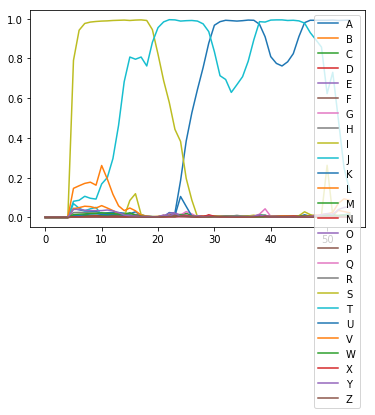

correct: 865 total: 906 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 378
('S', 'S'): 213
('E', 'E'): 415
('T', 'T'): 225
('H', 'H'): 124
('D', 'D'): 194
('K', 'K'): 66
('N', 'N'): 256
('L', 'L'): 223
('R', 'R'): 318
('O', 'O'): 238
('V', 'V'): 171
('B', 'B'): 63
('C', 'C'): 113
('G', 'G'): 77
('P', 'P'): 85
('I', 'I'): 174
('F', 'F'): 61
('W', 'W'): 74
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 52
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.0015279  0.00104896 0.00178576 ... 0.00101206 0.03692179 0.00061558]
 [0.00139723 0.00098949 0.0017637  ... 0.00126782 0.03287521 0.00064269]
 [0.00133746 0.00095064 0.00168736 ... 0.001275   0.02526045 0.00058454]
 ...
 [0.0018407  0.00093462 0.00155309 ... 0.00163515 0.01906828 0.00081753]
 [0.00188883 0.0009359

TOMRK TOMRK
edit distance: 0
correct: 867 total: 908 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 378
('S', 'S'): 213
('E', 'E'): 415
('T', 'T'): 226
('H', 'H'): 124
('D', 'D'): 194
('K', 'K'): 67
('N', 'N'): 258
('L', 'L'): 223
('R', 'R'): 319
('O', 'O'): 239
('V', 'V'): 172
('B', 'B'): 63
('C', 'C'): 113
('G', 'G'): 77
('P', 'P'): 85
('I', 'I'): 174
('F', 'F'): 61
('W', 'W'): 74
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 53
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.53334474e-03 1.03931851e-03 1.59503869e-03 3.17833610e-02
  5.61218103e-03 1.13328395e-03 2.09990377e-03 1.61071855e-03
  4.17444855e-03 1.59191468e-03 1.03129959e-02 3.19287665e-02
  4.54249382e-02 1.01668807e-03 6.12936556e-01 7.01039843e-03
  2.26606918e-03 2.22333195e-03 2.26064306

RROE RROE
edit distance: 0
correct: 869 total: 910 accuracy: 0.955 avgEditDist 0.052
('A', 'A'): 378
('S', 'S'): 213
('E', 'E'): 416
('T', 'T'): 226
('H', 'H'): 124
('D', 'D'): 195
('K', 'K'): 67
('N', 'N'): 258
('L', 'L'): 224
('R', 'R'): 321
('O', 'O'): 240
('V', 'V'): 172
('B', 'B'): 63
('C', 'C'): 113
('G', 'G'): 77
('P', 'P'): 85
('I', 'I'): 174
('F', 'F'): 61
('W', 'W'): 74
-------('H', 'R'): 3
('U', 'U'): 53
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 53
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[2.22615572e-03 1.81521103e-03 2.20816280e-03 9.81271267e-03
  7.54989218e-03 9.22796782e-04 2.29785731e-03 7.10570931e-01
  8.82145576e-03 1.88736001e-03 1.72746927e-02 1.37930103e-02
  5.42300753e-02 1.99948065e-03 3.90055850e-02 7.92620424e-03
  1.74823927e-03 2.57967692e-03 4.53464175e-

[[0.00143981 0.00073203 0.00127686 ... 0.00137975 0.04476994 0.00070726]
 [0.00131423 0.0008487  0.00138476 ... 0.00127946 0.0260321  0.0006792 ]
 [0.00153728 0.00082791 0.0014661  ... 0.00093588 0.02477082 0.00093605]
 ...
 [0.00184392 0.00087857 0.00157649 ... 0.00157784 0.02098316 0.00098606]
 [0.00201696 0.00094393 0.00169492 ... 0.00158132 0.02507602 0.0010867 ]
 [0.00194566 0.00096362 0.00159686 ... 0.00169825 0.03013191 0.0009647 ]]
--pred for 0 20 ['V 0.25 ', 'J 0.16 ', 'T 0.13 ', 'Y 0.05 ', 'L 0.03 ']
--pred for 0 24 ['J 0.28 ', 'V 0.25 ', 'T 0.10 ', 'L 0.03 ', 'Y 0.03 ']
--pred for 0 28 ['W 0.30 ', 'V 0.17 ', 'T 0.07 ', 'J 0.04 ', 'L 0.03 ']
--pred for 0 32 ['V 0.93 ', 'T 0.07 ', 'L 0.04 ', 'W 0.03 ', 'J 0.02 ']
--pred for 0 36 ['V 0.98 ', 'T 0.05 ', 'L 0.04 ', 'J 0.03 ', 'Y 0.02 ']
--pred for 0 40 ['W 0.72 ', 'V 0.16 ', 'T 0.04 ', 'L 0.02 ', 'Y 0.02 ']
--pred for 0 44 ['W 0.90 ', 'V 0.06 ', 'T 0.05 ', 'L 0.03 ', 'Y 0.02 ']
--pred for 0 48 ['W 0.93 ', 'V 0.05 ', 'T 0.03 ', 'J

EARS EARS
edit distance: 0
correct: 873 total: 914 accuracy: 0.955 avgEditDist 0.051
('A', 'A'): 379
('S', 'S'): 214
('E', 'E'): 419
('T', 'T'): 226
('H', 'H'): 124
('D', 'D'): 196
('K', 'K'): 67
('N', 'N'): 260
('L', 'L'): 224
('R', 'R'): 322
('O', 'O'): 240
('V', 'V'): 174
('B', 'B'): 63
('C', 'C'): 113
('G', 'G'): 77
('P', 'P'): 85
('I', 'I'): 175
('F', 'F'): 61
('W', 'W'): 75
-------('H', 'R'): 3
('U', 'U'): 54
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 53
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.71920203e-03 8.92598939e-04 1.63110776e-03 1.13740461e-02
  3.50051816e-03 3.43410783e-02 1.84073078e-03 2.53322860e-03
  5.50412480e-03 4.60900320e-03 1.11534921e-02 3.03403498e-03
  4.63457219e-02 3.30945812e-02 2.59676185e-02 4.03397949e-03
  4.45549516e-03 5.14000375e-03 2.23261747e-

EMOA EMOA
edit distance: 0
correct: 875 total: 916 accuracy: 0.955 avgEditDist 0.051
('A', 'A'): 380
('S', 'S'): 214
('E', 'E'): 420
('T', 'T'): 226
('H', 'H'): 125
('D', 'D'): 196
('K', 'K'): 67
('N', 'N'): 260
('L', 'L'): 224
('R', 'R'): 322
('O', 'O'): 242
('V', 'V'): 174
('B', 'B'): 63
('C', 'C'): 113
('G', 'G'): 77
('P', 'P'): 85
('I', 'I'): 175
('F', 'F'): 61
('W', 'W'): 75
-------('H', 'R'): 3
('U', 'U'): 54
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 54
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00287359 0.00215116 0.0024172  ... 0.00154841 0.03537684 0.00122989]
 [0.00337471 0.00228433 0.00314591 ... 0.00214903 0.03846706 0.00163286]
 [0.00348563 0.00223752 0.0032583  ... 0.0022072  0.03902436 0.00158926]
 ...
 [0.00251311 0.00152463 0.00242987 ... 0.00149955 0.03214809 0.00112

PLIE PLIE
edit distance: 0
correct: 877 total: 918 accuracy: 0.955 avgEditDist 0.051
('A', 'A'): 381
('S', 'S'): 214
('E', 'E'): 422
('T', 'T'): 226
('H', 'H'): 125
('D', 'D'): 196
('K', 'K'): 67
('N', 'N'): 260
('L', 'L'): 226
('R', 'R'): 323
('O', 'O'): 243
('V', 'V'): 174
('B', 'B'): 63
('C', 'C'): 113
('G', 'G'): 77
('P', 'P'): 86
('I', 'I'): 176
('F', 'F'): 61
('W', 'W'): 75
-------('H', 'R'): 3
('U', 'U'): 54
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 54
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00163561 0.0011901  0.00216973 ... 0.00116046 0.02806127 0.00205631]
 [0.00161801 0.00143238 0.00294403 ... 0.00149326 0.02835306 0.00283407]
 [0.00170019 0.00149569 0.0033303  ... 0.00177363 0.02892276 0.00241117]
 ...
 [0.0013081  0.00060202 0.00129223 ... 0.00128085 0.03016911 0.00066

ACFE ACFE
edit distance: 0
correct: 879 total: 920 accuracy: 0.955 avgEditDist 0.051
('A', 'A'): 382
('S', 'S'): 214
('E', 'E'): 424
('T', 'T'): 227
('H', 'H'): 126
('D', 'D'): 197
('K', 'K'): 67
('N', 'N'): 261
('L', 'L'): 226
('R', 'R'): 323
('O', 'O'): 243
('V', 'V'): 174
('B', 'B'): 63
('C', 'C'): 114
('G', 'G'): 77
('P', 'P'): 86
('I', 'I'): 176
('F', 'F'): 62
('W', 'W'): 75
-------('H', 'R'): 3
('U', 'U'): 54
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 54
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.53118395e-03 1.55043730e-03 1.05443527e-03 1.54054388e-02
  4.57795849e-03 1.22672005e-03 1.33779016e-03 2.67697615e-03
  9.44157224e-03 3.07075377e-03 4.04775590e-02 9.99377549e-01
  1.29839703e-01 1.06665574e-03 8.65693986e-02 7.73674948e-03
  2.51572696e-03 1.72066432e-03 3.16799921e-

CCVEO CCVEO
edit distance: 0
correct: 881 total: 922 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 382
('S', 'S'): 214
('E', 'E'): 425
('T', 'T'): 227
('H', 'H'): 126
('D', 'D'): 197
('K', 'K'): 67
('N', 'N'): 262
('L', 'L'): 226
('R', 'R'): 323
('O', 'O'): 244
('V', 'V'): 175
('B', 'B'): 63
('C', 'C'): 116
('G', 'G'): 77
('P', 'P'): 86
('I', 'I'): 177
('F', 'F'): 62
('W', 'W'): 75
-------('H', 'R'): 3
('U', 'U'): 54
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 54
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00138351 0.00086519 0.00130007 ... 0.00263541 0.03759782 0.00053327]
 [0.0017199  0.0010142  0.00129754 ... 0.00275119 0.02868069 0.00061471]
 [0.00297653 0.00180161 0.00138857 ... 0.00202424 0.02612143 0.00136139]
 ...
 [0.00226462 0.0014097  0.00287049 ... 0.00393531 0.03348319 0.000

RO RO
edit distance: 0
correct: 883 total: 924 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 382
('S', 'S'): 214
('E', 'E'): 425
('T', 'T'): 228
('H', 'H'): 126
('D', 'D'): 197
('K', 'K'): 67
('N', 'N'): 262
('L', 'L'): 227
('R', 'R'): 325
('O', 'O'): 246
('V', 'V'): 176
('B', 'B'): 63
('C', 'C'): 116
('G', 'G'): 77
('P', 'P'): 86
('I', 'I'): 177
('F', 'F'): 62
('W', 'W'): 76
-------('H', 'R'): 3
('U', 'U'): 54
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 54
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00156841 0.00101173 0.00176819 ... 0.00112909 0.0286567  0.0014997 ]
 [0.00168714 0.00106443 0.00186766 ... 0.001226   0.02927353 0.00157599]
 [0.00172204 0.00110679 0.001925   ... 0.00136418 0.02909723 0.00162996]
 ...
 [0.00165025 0.00115771 0.00187603 ... 0.00144331 0.0178559  0.00117672]

SL SL
edit distance: 0
correct: 885 total: 926 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 382
('S', 'S'): 216
('E', 'E'): 425
('T', 'T'): 228
('H', 'H'): 126
('D', 'D'): 197
('K', 'K'): 67
('N', 'N'): 262
('L', 'L'): 230
('R', 'R'): 325
('O', 'O'): 247
('V', 'V'): 176
('B', 'B'): 63
('C', 'C'): 116
('G', 'G'): 77
('P', 'P'): 86
('I', 'I'): 177
('F', 'F'): 62
('W', 'W'): 76
-------('H', 'R'): 3
('U', 'U'): 54
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 54
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00156488 0.00075068 0.00147292 ... 0.00118931 0.03201096 0.00100378]
 [0.0018732  0.00094713 0.00135116 ... 0.0013226  0.03048902 0.00116573]
 [0.00207489 0.0010689  0.00154239 ... 0.00146041 0.02822402 0.00124403]
 ...
 [0.0015541  0.00091755 0.00162651 ... 0.00111255 0.02013486 0.00094963]

GRAVS GRAVS
edit distance: 0
correct: 887 total: 928 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 383
('S', 'S'): 217
('E', 'E'): 426
('T', 'T'): 230
('H', 'H'): 126
('D', 'D'): 197
('K', 'K'): 67
('N', 'N'): 262
('L', 'L'): 231
('R', 'R'): 326
('O', 'O'): 247
('V', 'V'): 177
('B', 'B'): 63
('C', 'C'): 116
('G', 'G'): 78
('P', 'P'): 86
('I', 'I'): 177
('F', 'F'): 62
('W', 'W'): 76
-------('H', 'R'): 3
('U', 'U'): 54
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 54
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00135487 0.0006141  0.00116611 ... 0.00127199 0.05248148 0.00073299]
 [0.00138582 0.00059535 0.00120734 ... 0.00137322 0.04215244 0.00084594]
 [0.00141875 0.00073308 0.0013846  ... 0.00148649 0.02692798 0.00094246]
 ...
 [0.0014467  0.00143099 0.0026738  ... 0.00441656 0.02575387 0.001

TRNMP TRNMP
edit distance: 0
correct: 889 total: 930 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 383
('S', 'S'): 217
('E', 'E'): 426
('T', 'T'): 232
('H', 'H'): 126
('D', 'D'): 198
('K', 'K'): 67
('N', 'N'): 263
('L', 'L'): 231
('R', 'R'): 328
('O', 'O'): 247
('V', 'V'): 178
('B', 'B'): 63
('C', 'C'): 116
('G', 'G'): 78
('P', 'P'): 87
('I', 'I'): 177
('F', 'F'): 62
('W', 'W'): 76
-------('H', 'R'): 3
('U', 'U'): 54
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 55
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.0013524  0.00057598 0.00108759 ... 0.0012515  0.0503258  0.00078917]
 [0.00136142 0.00060355 0.00122984 ... 0.00168139 0.02901178 0.00096476]
 [0.00143414 0.0006694  0.00134428 ... 0.0015156  0.02207225 0.00115296]
 ...
 [0.00164336 0.00118247 0.00244469 ... 0.00560902 0.02220904 0.001

LEE LEE
edit distance: 0
correct: 891 total: 932 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 383
('S', 'S'): 217
('E', 'E'): 428
('T', 'T'): 233
('H', 'H'): 126
('D', 'D'): 199
('K', 'K'): 67
('N', 'N'): 263
('L', 'L'): 232
('R', 'R'): 328
('O', 'O'): 247
('V', 'V'): 179
('B', 'B'): 63
('C', 'C'): 116
('G', 'G'): 78
('P', 'P'): 87
('I', 'I'): 178
('F', 'F'): 62
('W', 'W'): 76
-------('H', 'R'): 3
('U', 'U'): 54
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 55
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00165824 0.00097422 0.00149724 ... 0.00091434 0.02593397 0.00063497]
 [0.00192329 0.00106116 0.00150384 ... 0.00126439 0.02819718 0.00083016]
 [0.0023131  0.00123609 0.00189141 ... 0.00128164 0.03407506 0.00107168]
 ...
 [0.00272324 0.00122263 0.0021315  ... 0.00174249 0.04537329 0.0010836

HEAL HEAL
edit distance: 0
correct: 893 total: 934 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 386
('S', 'S'): 217
('E', 'E'): 429
('T', 'T'): 233
('H', 'H'): 127
('D', 'D'): 199
('K', 'K'): 67
('N', 'N'): 263
('L', 'L'): 233
('R', 'R'): 328
('O', 'O'): 248
('V', 'V'): 179
('B', 'B'): 63
('C', 'C'): 117
('G', 'G'): 78
('P', 'P'): 87
('I', 'I'): 178
('F', 'F'): 62
('W', 'W'): 76
-------('H', 'R'): 3
('U', 'U'): 55
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 55
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00140555 0.00093962 0.00156054 ... 0.00100158 0.02257954 0.0013476 ]
 [0.00150118 0.00103478 0.00181881 ... 0.00116482 0.02309502 0.00150757]
 [0.00162993 0.00110892 0.00193196 ... 0.00126547 0.02369844 0.00153985]
 ...
 [0.00253399 0.00146459 0.00222655 ... 0.00147916 0.03533107 0.00107

[[0.00160521 0.00106439 0.00141159 ... 0.0013503  0.03379207 0.00065286]
 [0.00159512 0.00107692 0.00127642 ... 0.00225486 0.0277173  0.00058377]
 [0.00255279 0.00149922 0.00135234 ... 0.00195457 0.02486066 0.00102588]
 ...
 [0.00172416 0.0011886  0.00196649 ... 0.00143451 0.01910829 0.00150426]
 [0.00165417 0.00111363 0.00188678 ... 0.00138234 0.0178559  0.00138132]
 [0.00165378 0.00111084 0.00191462 ... 0.00135562 0.01987384 0.0012444 ]]
--pred for 0 20 ['J 0.21 ', 'V 0.14 ', 'T 0.14 ', 'Y 0.03 ', 'F 0.02 ']
--pred for 0 24 ['F 0.66 ', 'J 0.18 ', 'V 0.14 ', 'T 0.07 ', 'R 0.07 ']
--pred for 0 28 ['R 0.81 ', 'V 0.14 ', 'F 0.13 ', 'J 0.07 ', 'T 0.07 ']
--pred for 0 32 ['R 0.98 ', 'V 0.14 ', 'T 0.07 ', 'L 0.06 ', 'J 0.04 ']
--pred for 0 36 ['R 0.99 ', 'V 0.14 ', 'T 0.07 ', 'L 0.05 ', 'J 0.05 ']
--pred for 0 40 ['R 0.99 ', 'V 0.14 ', 'T 0.06 ', 'L 0.05 ', 'J 0.04 ']
--pred for 0 44 ['R 0.99 ', 'V 0.13 ', 'T 0.06 ', 'L 0.06 ', 'J 0.04 ']
--pred for 0 48 ['R 0.99 ', 'I 0.41 ', 'V 0.13 ', 'T

LEPGH LEPGH
edit distance: 0
correct: 896 total: 937 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 387
('S', 'S'): 217
('E', 'E'): 430
('T', 'T'): 236
('H', 'H'): 129
('D', 'D'): 200
('K', 'K'): 67
('N', 'N'): 264
('L', 'L'): 236
('R', 'R'): 329
('O', 'O'): 250
('V', 'V'): 179
('B', 'B'): 63
('C', 'C'): 117
('G', 'G'): 79
('P', 'P'): 88
('I', 'I'): 178
('F', 'F'): 62
('W', 'W'): 76
-------('H', 'R'): 3
('U', 'U'): 55
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 55
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.46214408e-03 1.30636117e-03 2.30506924e-03 1.38781080e-02
  3.55732488e-03 2.66881287e-03 1.34493113e-01 1.08586196e-02
  3.24568758e-03 1.42869737e-03 8.62797908e-03 9.98673309e-03
  2.06838548e-02 1.36392459e-03 3.92487973e-01 2.91051576e-03
  1.09651801e-03 2.93714600e-03 2.82406528

DEAO DEAO
edit distance: 0
correct: 898 total: 939 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 388
('S', 'S'): 217
('E', 'E'): 431
('T', 'T'): 236
('H', 'H'): 129
('D', 'D'): 202
('K', 'K'): 67
('N', 'N'): 264
('L', 'L'): 236
('R', 'R'): 329
('O', 'O'): 251
('V', 'V'): 179
('B', 'B'): 63
('C', 'C'): 117
('G', 'G'): 79
('P', 'P'): 88
('I', 'I'): 178
('F', 'F'): 63
('W', 'W'): 76
-------('H', 'R'): 3
('U', 'U'): 55
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 55
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00164246 0.00084001 0.00148576 ... 0.00166136 0.03309933 0.0007262 ]
 [0.0018278  0.00109422 0.00191472 ... 0.00186391 0.03628596 0.00103927]
 [0.00205713 0.00126251 0.00244604 ... 0.00252272 0.04270947 0.00144325]
 ...
 [0.00144586 0.00112261 0.00181258 ... 0.00111064 0.01464071 0.00188

NOS NOS
edit distance: 0
correct: 900 total: 941 accuracy: 0.956 avgEditDist 0.050
('A', 'A'): 388
('S', 'S'): 218
('E', 'E'): 432
('T', 'T'): 236
('H', 'H'): 130
('D', 'D'): 202
('K', 'K'): 67
('N', 'N'): 265
('L', 'L'): 237
('R', 'R'): 329
('O', 'O'): 253
('V', 'V'): 179
('B', 'B'): 63
('C', 'C'): 117
('G', 'G'): 79
('P', 'P'): 88
('I', 'I'): 178
('F', 'F'): 63
('W', 'W'): 76
-------('H', 'R'): 3
('U', 'U'): 55
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 55
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[2.99063697e-03 1.08759571e-03 2.64496892e-03 4.59894128e-02
  3.87346419e-03 1.75968057e-03 2.50355829e-03 2.50135884e-02
  4.33951523e-03 2.05416186e-03 2.06616726e-02 2.68545817e-03
  4.12061326e-02 7.85449240e-03 4.24707644e-02 4.06076200e-03
  6.88672706e-04 2.93854834e-03 1.65061257e-03

VTHANG VTHANG
edit distance: 0
correct: 902 total: 943 accuracy: 0.957 avgEditDist 0.050
('A', 'A'): 389
('S', 'S'): 219
('E', 'E'): 432
('T', 'T'): 237
('H', 'H'): 132
('D', 'D'): 202
('K', 'K'): 67
('N', 'N'): 266
('L', 'L'): 237
('R', 'R'): 329
('O', 'O'): 253
('V', 'V'): 180
('B', 'B'): 63
('C', 'C'): 117
('G', 'G'): 80
('P', 'P'): 88
('I', 'I'): 178
('F', 'F'): 63
('W', 'W'): 76
-------('H', 'R'): 3
('U', 'U'): 55
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 55
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00148159 0.00098399 0.00135949 ... 0.00162654 0.04956956 0.0006121 ]
 [0.00169492 0.00114782 0.00137324 ... 0.00223578 0.03789937 0.00069146]
 [0.00162176 0.00120282 0.00146416 ... 0.00201822 0.03948963 0.00066426]
 ...
 [0.00330653 0.00209075 0.00130613 ... 0.00267471 0.03444439 0.0

TNR TNR
edit distance: 0
correct: 904 total: 945 accuracy: 0.957 avgEditDist 0.050
('A', 'A'): 389
('S', 'S'): 220
('E', 'E'): 432
('T', 'T'): 238
('H', 'H'): 132
('D', 'D'): 202
('K', 'K'): 67
('N', 'N'): 268
('L', 'L'): 237
('R', 'R'): 331
('O', 'O'): 253
('V', 'V'): 180
('B', 'B'): 63
('C', 'C'): 117
('G', 'G'): 81
('P', 'P'): 89
('I', 'I'): 178
('F', 'F'): 63
('W', 'W'): 76
-------('H', 'R'): 3
('U', 'U'): 55
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 55
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.23446796e-03 6.83127902e-04 1.30690180e-03 2.60607270e-03
  2.75548687e-03 1.71005575e-03 1.16510375e-03 2.30637356e-03
  1.09951319e-02 8.34535866e-04 2.97478978e-02 6.27703080e-03
  1.93121314e-01 7.14088008e-02 2.42656786e-02 5.83537295e-03
  8.42534564e-03 4.81648371e-03 3.46336421e-03

ELKFIN ELKFIN
edit distance: 0
correct: 906 total: 947 accuracy: 0.957 avgEditDist 0.050
('A', 'A'): 389
('S', 'S'): 220
('E', 'E'): 433
('T', 'T'): 238
('H', 'H'): 132
('D', 'D'): 202
('K', 'K'): 69
('N', 'N'): 269
('L', 'L'): 238
('R', 'R'): 331
('O', 'O'): 253
('V', 'V'): 180
('B', 'B'): 63
('C', 'C'): 117
('G', 'G'): 81
('P', 'P'): 89
('I', 'I'): 180
('F', 'F'): 64
('W', 'W'): 76
-------('H', 'R'): 3
('U', 'U'): 55
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 55
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00153823 0.00078991 0.00146707 ... 0.0020232  0.03763395 0.00073927]
 [0.00167465 0.00090966 0.00180548 ... 0.00207703 0.04059235 0.00095628]
 [0.00188674 0.00110809 0.00229251 ... 0.00242759 0.04441811 0.0012445 ]
 ...
 [0.00147136 0.00277772 0.00420783 ... 0.00284356 0.03467284 0.0

[[0.00154105 0.0013521  0.00278709 ... 0.00154575 0.03277216 0.0023596 ]
 [0.00160733 0.00161259 0.00336273 ... 0.00202905 0.0350397  0.00326892]
 [0.00195708 0.00204786 0.00407242 ... 0.00286624 0.04697016 0.00251812]
 ...
 [0.00165424 0.00103403 0.00178386 ... 0.00128336 0.02012248 0.00169304]
 [0.00165508 0.00106788 0.0018265  ... 0.00125338 0.01905794 0.00133958]
 [0.00166571 0.00105683 0.00184916 ... 0.00126129 0.02026307 0.00125881]]
--pred for 0 20 ['D 0.29 ', 'T 0.18 ', 'L 0.12 ', 'V 0.11 ', 'Y 0.03 ']
--pred for 0 24 ['D 0.70 ', 'T 0.18 ', 'V 0.11 ', 'L 0.09 ', 'C 0.04 ']
--pred for 0 28 ['D 0.93 ', 'T 0.16 ', 'V 0.12 ', 'C 0.06 ', 'L 0.05 ']
--pred for 0 32 ['D 0.99 ', 'V 0.13 ', 'T 0.12 ', 'J 0.07 ', 'Y 0.04 ']
--pred for 0 36 ['D 0.99 ', 'V 0.14 ', 'T 0.12 ', 'J 0.05 ', 'L 0.05 ']
--pred for 0 40 ['D 0.99 ', 'V 0.18 ', 'I 0.14 ', 'T 0.11 ', 'L 0.06 ']
--pred for 0 44 ['I 1.00 ', 'D 0.99 ', 'V 0.17 ', 'T 0.06 ', 'L 0.05 ']
--pred for 0 48 ['D 0.99 ', 'I 0.98 ', 'V 0.23 ', 'T

[[1.46609882e-03 7.61266332e-04 1.44359434e-03 7.60824140e-03
  3.25057819e-03 3.21033299e-02 1.39184622e-03 2.76558148e-03
  4.62828344e-03 3.11602280e-03 1.08848028e-02 3.50867305e-03
  7.30500743e-02 6.38639322e-03 3.15646678e-02 3.25451721e-03
  3.05302627e-03 8.22434388e-03 2.06291326e-03 2.23340886e-03
  1.34996453e-03 9.00900632e-04 7.33173937e-02 2.89920792e-02
  8.66810158e-02 8.86486750e-03 1.55568100e-03 3.77706476e-02
  6.35850243e-04]
 [1.77413039e-03 9.69202374e-04 1.81110739e-03 1.22441296e-02
  3.58797587e-03 1.20897338e-01 1.94383156e-03 4.78958152e-03
  4.28521819e-03 4.11636150e-03 9.18878336e-03 3.08185164e-03
  5.27785644e-02 5.11348899e-03 2.85171643e-02 3.07927863e-03
  2.36737495e-03 1.35567663e-02 2.42655375e-03 2.66564451e-03
  2.28060083e-03 1.23245316e-03 8.96043405e-02 2.44726818e-02
  6.83977231e-02 9.13056266e-03 1.69266271e-03 3.70670930e-02
  8.90816853e-04]
 [1.92197692e-03 1.11089752e-03 2.16123788e-03 1.80998314e-02
  3.85147729e-03 7.35190749e-01 2.

ROS ROS
edit distance: 0
correct: 912 total: 953 accuracy: 0.957 avgEditDist 0.049
('A', 'A'): 391
('S', 'S'): 221
('E', 'E'): 433
('T', 'T'): 239
('H', 'H'): 134
('D', 'D'): 204
('K', 'K'): 69
('N', 'N'): 269
('L', 'L'): 241
('R', 'R'): 335
('O', 'O'): 256
('V', 'V'): 181
('B', 'B'): 63
('C', 'C'): 118
('G', 'G'): 81
('P', 'P'): 90
('I', 'I'): 181
('F', 'F'): 64
('W', 'W'): 76
-------('H', 'R'): 3
('U', 'U'): 55
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 55
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00324341 0.00211528 0.00311086 ... 0.00238932 0.03899217 0.00146659]
 [0.00332226 0.00218127 0.00317179 ... 0.0023761  0.03254633 0.00164625]
 [0.00348275 0.00228017 0.00328623 ... 0.00233982 0.0310158  0.00166158]
 ...
 [0.00165692 0.00114468 0.00246941 ... 0.00420798 0.02973454 0.0008756

[[0.00134143 0.00063484 0.00120906 ... 0.00118846 0.04208227 0.00077169]
 [0.00138065 0.00078529 0.00141234 ... 0.00129638 0.02951373 0.00093364]
 [0.00170192 0.00088332 0.00145092 ... 0.00093175 0.02154858 0.00115852]
 ...
 [0.00298431 0.00151229 0.00252504 ... 0.00156241 0.03801366 0.00126231]
 [0.00276118 0.00114426 0.00207324 ... 0.00187555 0.0441246  0.00112057]
 [0.00253403 0.00099636 0.00167786 ... 0.00270087 0.03232583 0.00093858]]
--pred for 0 20 ['V 0.48 ', 'J 0.10 ', 'T 0.07 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 24 ['V 0.31 ', 'W 0.17 ', 'J 0.16 ', 'T 0.04 ', 'L 0.03 ']
--pred for 0 28 ['W 0.61 ', 'V 0.15 ', 'T 0.06 ', 'L 0.04 ', 'J 0.03 ']
--pred for 0 32 ['V 0.60 ', 'W 0.42 ', 'L 0.07 ', 'T 0.07 ', 'U 0.02 ']
--pred for 0 36 ['V 0.98 ', 'L 0.07 ', 'T 0.06 ', 'J 0.02 ', 'U 0.02 ']
--pred for 0 40 ['W 0.87 ', 'V 0.06 ', 'T 0.05 ', 'L 0.03 ', 'Y 0.02 ']
--pred for 0 44 ['W 0.92 ', 'V 0.06 ', 'T 0.05 ', 'L 0.03 ', 'Y 0.02 ']
--pred for 0 48 ['W 0.95 ', 'V 0.04 ', 'T 0.04 ', 'J

[[0.0015159  0.00070182 0.00118345 ... 0.00182333 0.02600306 0.00063016]
 [0.00162607 0.00082551 0.0014902  ... 0.00185248 0.03243748 0.00075318]
 [0.00194876 0.00112993 0.00231601 ... 0.00256896 0.04737338 0.00116839]
 ...
 [0.00262411 0.00198295 0.0014148  ... 0.00237833 0.02664066 0.00265701]
 [0.00223189 0.00168501 0.00143109 ... 0.00220469 0.02648004 0.00234314]
 [0.00216184 0.00138136 0.00167719 ... 0.00210439 0.03304234 0.00129365]]
--pred for 0 20 ['V 0.13 ', 'T 0.09 ', 'J 0.05 ', 'L 0.03 ', 'Y 0.03 ']
--pred for 0 24 ['V 0.12 ', 'T 0.10 ', 'C 0.07 ', 'L 0.03 ', 'Y 0.03 ']
--pred for 0 28 ['C 0.84 ', 'T 0.10 ', 'V 0.08 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 32 ['C 0.96 ', 'T 0.10 ', 'V 0.08 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 36 ['C 0.98 ', 'T 0.09 ', 'V 0.09 ', 'L 0.05 ', 'Y 0.05 ']
--pred for 0 40 ['C 0.99 ', 'V 0.09 ', 'T 0.09 ', 'Y 0.05 ', 'L 0.04 ']
--pred for 0 44 ['O 0.99 ', 'V 0.16 ', 'T 0.08 ', 'Y 0.04 ', 'L 0.04 ']
--pred for 0 48 ['O 0.99 ', 'V 0.15 ', 'T 0.09 ', 'A

[[1.48567988e-03 9.26263456e-04 1.58028689e-03 1.91970449e-02
  4.39275336e-03 1.25089672e-03 3.58947646e-03 1.33321132e-03
  3.42320674e-03 1.86492072e-03 9.02377535e-03 1.35307796e-02
  3.59482132e-02 1.45033374e-03 7.63034225e-01 4.29035490e-03
  1.88315473e-03 2.32785102e-03 1.97424390e-03 2.78105075e-03
  1.89852424e-03 1.27575325e-03 1.12006158e-01 4.70541511e-03
  1.01194069e-01 1.15577513e-02 9.51683905e-04 2.43578125e-02
  1.06989464e-03]
 [1.62244402e-03 1.03311741e-03 1.83650840e-03 2.40229741e-02
  5.03412355e-03 1.36213598e-03 4.77156416e-03 1.58069469e-03
  3.67888273e-03 2.37959484e-03 8.32031760e-03 7.75134005e-03
  2.08022855e-02 1.61365187e-03 9.46045995e-01 5.52508701e-03
  2.38319719e-03 2.81032035e-03 2.37955060e-03 3.32922908e-03
  2.10900535e-03 1.51952065e-03 1.22744434e-01 5.15560107e-03
  1.08519107e-01 1.22931711e-02 1.12717936e-03 2.58422103e-02
  1.38717634e-03]
 [1.65517488e-03 1.07230165e-03 1.87970977e-03 2.93564871e-02
  4.63064574e-03 1.30368932e-03 5.

WEBDFP WEBDFP
edit distance: 0
correct: 919 total: 960 accuracy: 0.957 avgEditDist 0.049
('A', 'A'): 396
('S', 'S'): 221
('E', 'E'): 438
('T', 'T'): 242
('H', 'H'): 135
('D', 'D'): 206
('K', 'K'): 69
('N', 'N'): 270
('L', 'L'): 242
('R', 'R'): 337
('O', 'O'): 261
('V', 'V'): 181
('B', 'B'): 65
('C', 'C'): 119
('G', 'G'): 81
('P', 'P'): 91
('I', 'I'): 182
('F', 'F'): 65
('W', 'W'): 78
-------('H', 'R'): 3
('U', 'U'): 56
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 55
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00321442 0.00236574 0.00279659 ... 0.00207873 0.03702829 0.00142869]
 [0.0034084  0.00221673 0.00310343 ... 0.00232424 0.03340928 0.00154028]
 [0.00344881 0.0021506  0.00292484 ... 0.0023022  0.03404859 0.00149118]
 ...
 [0.00170244 0.00125457 0.00284152 ... 0.00299003 0.03339276 0.0

AWAI AWAI
edit distance: 0
correct: 921 total: 962 accuracy: 0.957 avgEditDist 0.049
('A', 'A'): 399
('S', 'S'): 221
('E', 'E'): 439
('T', 'T'): 242
('H', 'H'): 135
('D', 'D'): 206
('K', 'K'): 69
('N', 'N'): 270
('L', 'L'): 242
('R', 'R'): 337
('O', 'O'): 262
('V', 'V'): 181
('B', 'B'): 65
('C', 'C'): 119
('G', 'G'): 81
('P', 'P'): 91
('I', 'I'): 183
('F', 'F'): 65
('W', 'W'): 79
-------('H', 'R'): 3
('U', 'U'): 56
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 55
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[1.36605988e-03 7.50299660e-04 1.30538095e-03 8.04233924e-03
  2.56613782e-03 4.45861602e-03 1.69664214e-03 7.11732777e-04
  3.71708791e-03 2.21388671e-03 1.38739124e-02 5.14566107e-03
  2.14142293e-01 1.02436938e-03 5.81901297e-02 3.66345257e-03
  3.28068226e-03 6.23347424e-03 2.05680984e-

ELAR ELAR
edit distance: 0
correct: 923 total: 964 accuracy: 0.957 avgEditDist 0.049
('A', 'A'): 400
('S', 'S'): 221
('E', 'E'): 440
('T', 'T'): 242
('H', 'H'): 135
('D', 'D'): 206
('K', 'K'): 69
('N', 'N'): 270
('L', 'L'): 243
('R', 'R'): 338
('O', 'O'): 262
('V', 'V'): 181
('B', 'B'): 65
('C', 'C'): 119
('G', 'G'): 82
('P', 'P'): 91
('I', 'I'): 183
('F', 'F'): 65
('W', 'W'): 79
-------('H', 'R'): 3
('U', 'U'): 57
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 55
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.0015121  0.00087905 0.00150205 ... 0.00099783 0.02621415 0.00124437]
 [0.00162771 0.00102074 0.00176709 ... 0.00113758 0.03107189 0.00160269]
 [0.00174032 0.00111532 0.00191702 ... 0.00140066 0.03236941 0.00176382]
 ...
 [0.0015539  0.00102019 0.00215344 ... 0.00563803 0.0269175  0.00091

[[0.00298569 0.00113394 0.00287353 ... 0.00344203 0.04954007 0.001033  ]
 [0.00393891 0.00130821 0.00338061 ... 0.00360318 0.04243337 0.00136942]
 [0.00432909 0.00127926 0.00333463 ... 0.00328583 0.04089751 0.00151664]
 ...
 [0.0017304  0.00116546 0.00187164 ... 0.00137199 0.01911817 0.00164534]
 [0.00167688 0.0010783  0.00180151 ... 0.00126066 0.01813716 0.00137313]
 [0.00170128 0.00108974 0.00185725 ... 0.00130936 0.02026729 0.0011775 ]]
--pred for 0 20 ['S 0.86 ', 'J 0.12 ', 'V 0.12 ', 'T 0.07 ', 'Y 0.05 ']
--pred for 0 24 ['S 0.96 ', 'V 0.13 ', 'T 0.08 ', 'J 0.07 ', 'L 0.05 ']
--pred for 0 28 ['S 0.97 ', 'V 0.15 ', 'T 0.09 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 32 ['S 0.98 ', 'V 0.14 ', 'T 0.09 ', 'L 0.05 ', 'J 0.05 ']
--pred for 0 36 ['S 0.98 ', 'V 0.15 ', 'T 0.07 ', 'L 0.06 ', 'Y 0.04 ']
--pred for 0 40 ['S 0.99 ', 'V 0.15 ', 'T 0.07 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 44 ['S 0.99 ', 'V 0.12 ', 'T 0.09 ', 'L 0.04 ', 'J 0.04 ']
--pred for 0 48 ['I 1.00 ', 'S 0.99 ', 'V 0.15 ', 'L

  6.46601547e-04]]
--pred for 0 20 ['T 0.14 ', 'V 0.09 ', 'J 0.08 ', 'A 0.05 ', 'L 0.04 ']
--pred for 0 24 ['T 0.26 ', 'V 0.11 ', 'E 0.04 ', 'J 0.04 ', 'R 0.04 ']
--pred for 0 28 ['T 0.23 ', 'C 0.18 ', 'V 0.13 ', 'E 0.12 ', 'L 0.05 ']
--pred for 0 32 ['C 0.59 ', 'V 0.14 ', 'T 0.13 ', 'L 0.07 ', 'D 0.07 ']
--pred for 0 36 ['D 0.92 ', 'V 0.12 ', 'L 0.10 ', 'T 0.08 ', 'Y 0.05 ']
--pred for 0 40 ['D 0.96 ', 'V 0.16 ', 'T 0.09 ', 'L 0.04 ', 'A 0.04 ']
--pred for 0 44 ['D 0.97 ', 'V 0.17 ', 'T 0.08 ', 'A 0.07 ', 'L 0.03 ']
--pred for 0 48 ['D 0.99 ', 'V 0.19 ', 'T 0.08 ', 'L 0.04 ', 'A 0.04 ']
--pred for 0 52 ['I 0.99 ', 'D 0.99 ', 'V 0.14 ', 'A 0.05 ', 'L 0.04 ']
--pred for 0 56 ['I 0.98 ', 'D 0.97 ', 'V 0.13 ', 'L 0.05 ', 'A 0.02 ']
--pred for 0 60 ['D 0.98 ', 'I 0.97 ', 'V 0.18 ', 'A 0.04 ', 'L 0.04 ']
--pred for 0 61 ['D 0.99 ', 'I 0.97 ', 'V 0.22 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 61 ['D 0.99 ', 'I 0.97 ', 'V 0.22 ', 'L 0.04 ', 'A 0.03 ']
--pred for 0 61 ['D 0.99 ', 'I 0.97 ', 'V 0.2

VERNTA VERNTA
edit distance: 0
correct: 929 total: 970 accuracy: 0.958 avgEditDist 0.048
('A', 'A'): 403
('S', 'S'): 222
('E', 'E'): 444
('T', 'T'): 246
('H', 'H'): 135
('D', 'D'): 207
('K', 'K'): 70
('N', 'N'): 272
('L', 'L'): 245
('R', 'R'): 339
('O', 'O'): 265
('V', 'V'): 183
('B', 'B'): 65
('C', 'C'): 120
('G', 'G'): 82
('P', 'P'): 91
('I', 'I'): 185
('F', 'F'): 65
('W', 'W'): 79
-------('H', 'R'): 3
('U', 'U'): 57
-------('I', '%'): 10
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 55
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00137071 0.00099303 0.00143959 ... 0.00200401 0.05091216 0.00070654]
 [0.00153275 0.00116285 0.00147244 ... 0.0025129  0.04383335 0.00080169]
 [0.0023835  0.00147464 0.0014419  ... 0.00242476 0.03581389 0.00110357]
 ...
 [0.0020518  0.00100783 0.00163752 ... 0.00159883 0.02024059 0.0

--pred for 4 76 ['D 0.96 ', 'T 0.95 ', 'H 0.00 ', 'O 0.00 ', 'A 0.00 ']
--pred for 8 80 ['D 0.99 ', 'T 0.85 ', 'V 0.01 ', 'I 0.01 ', 'S 0.01 ']
--pred for 12 82 ['D 1.00 ', 'T 0.85 ', 'I 0.01 ', 'V 0.01 ', 'L 0.01 ']
--pred for 16 82 ['D 1.00 ', 'T 0.74 ', 'I 0.39 ', 'V 0.04 ', 'Y 0.02 ']
--pred for 20 82 ['D 1.00 ', 'T 0.69 ', 'I 0.08 ', 'V 0.03 ', 'A 0.02 ']
--pred for 24 82 ['D 1.00 ', 'T 0.69 ', 'I 0.04 ', 'V 0.03 ', 'A 0.03 ']
--pred for 28 82 ['D 1.00 ', 'T 0.30 ', 'Y 0.07 ', 'V 0.07 ', 'L 0.02 ']
--pred for 32 82 ['D 0.99 ', 'T 0.21 ', 'V 0.14 ', 'Y 0.06 ', 'J 0.03 ']
--pred for 36 82 ['D 0.99 ', 'T 0.16 ', 'V 0.15 ', 'J 0.04 ', 'Y 0.04 ']
--pred for 40 82 ['D 0.99 ', 'V 0.11 ', 'T 0.10 ', 'J 0.06 ', 'A 0.05 ']
--pred for 44 82 ['D 0.99 ', 'V 0.12 ', 'T 0.10 ', 'J 0.06 ', 'A 0.05 ']
--pred for 48 82 ['D 0.98 ', 'T 0.13 ', 'V 0.13 ', 'J 0.04 ', 'L 0.04 ']
--pred for 52 82 ['D 0.93 ', 'T 0.16 ', 'V 0.09 ', 'J 0.06 ', 'L 0.03 ']
--pred for 56 82 ['D 0.87 ', 'T 0.14 ', 'V 0.10 ', 'J

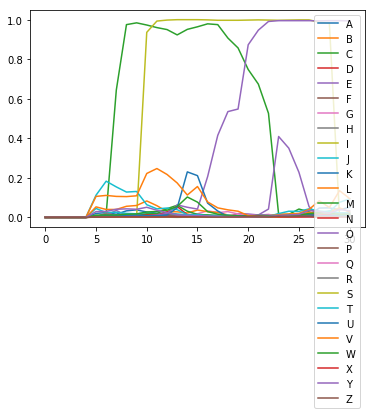

correct: 931 total: 973 accuracy: 0.957 avgEditDist 0.049
('A', 'A'): 403
('S', 'S'): 222
('E', 'E'): 444
('T', 'T'): 248
('H', 'H'): 135
('D', 'D'): 208
('K', 'K'): 70
('N', 'N'): 273
('L', 'L'): 245
('R', 'R'): 341
('O', 'O'): 266
('V', 'V'): 183
('B', 'B'): 66
('C', 'C'): 121
('G', 'G'): 82
('P', 'P'): 91
('I', 'I'): 186
('F', 'F'): 65
('W', 'W'): 79
-------('H', 'R'): 3
('U', 'U'): 57
-------('I', '%'): 11
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 56
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00131869 0.00086157 0.00127462 ... 0.00265835 0.04661877 0.00056743]
 [0.00139036 0.00089081 0.00123645 ... 0.00317923 0.03208671 0.00057814]
 [0.0018837  0.00112521 0.00115642 ... 0.00243747 0.02497548 0.00067997]
 ...
 [0.00144578 0.00094608 0.00134286 ... 0.00334883 0.02626181 0.00061994]
 [0.00146998 0.0008213

OEDONR OEDONR
edit distance: 0
correct: 933 total: 975 accuracy: 0.957 avgEditDist 0.049
('A', 'A'): 403
('S', 'S'): 222
('E', 'E'): 445
('T', 'T'): 249
('H', 'H'): 135
('D', 'D'): 209
('K', 'K'): 70
('N', 'N'): 274
('L', 'L'): 245
('R', 'R'): 343
('O', 'O'): 268
('V', 'V'): 184
('B', 'B'): 66
('C', 'C'): 121
('G', 'G'): 82
('P', 'P'): 91
('I', 'I'): 186
('F', 'F'): 66
('W', 'W'): 79
-------('H', 'R'): 3
('U', 'U'): 57
-------('I', '%'): 11
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 56
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00131923 0.00090167 0.0009606  ... 0.00075778 0.05203575 0.00074648]
 [0.00115692 0.00090392 0.00090506 ... 0.00080109 0.03336597 0.00081424]
 [0.00103686 0.0009189  0.00085845 ... 0.00080808 0.02649144 0.00075457]
 ...
 [0.00323976 0.00226238 0.00329554 ... 0.00244488 0.02815202 0.0

TEDN TEDN
edit distance: 0
correct: 935 total: 977 accuracy: 0.957 avgEditDist 0.049
('A', 'A'): 403
('S', 'S'): 222
('E', 'E'): 448
('T', 'T'): 250
('H', 'H'): 135
('D', 'D'): 210
('K', 'K'): 70
('N', 'N'): 275
('L', 'L'): 245
('R', 'R'): 343
('O', 'O'): 268
('V', 'V'): 184
('B', 'B'): 66
('C', 'C'): 121
('G', 'G'): 82
('P', 'P'): 91
('I', 'I'): 187
('F', 'F'): 66
('W', 'W'): 80
-------('H', 'R'): 3
('U', 'U'): 57
-------('I', '%'): 11
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 57
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 5
-------('%', 'C'): 1
-------('%', 'S'): 2
[[0.00146214 0.00130636 0.00230507 ... 0.00118246 0.03293937 0.00221275]
 [0.00157265 0.0016731  0.00304513 ... 0.0017071  0.03878688 0.00321973]
 [0.00174104 0.0018486  0.00365542 ... 0.00222327 0.04229003 0.00266162]
 ...
 [0.00136014 0.00191353 0.00296918 ... 0.00242149 0.029805   0.00195

[[0.00228004 0.00129518 0.00164493 ... 0.00127629 0.02719436 0.00179471]
 [0.00211745 0.001679   0.00153423 ... 0.00153589 0.03463043 0.00603422]
 [0.00189406 0.0017692  0.00183258 ... 0.00170856 0.0407328  0.01073464]
 ...
 [0.00326343 0.00223463 0.00145755 ... 0.0023118  0.02861338 0.0025696 ]
 [0.00302987 0.00217505 0.00148571 ... 0.00244203 0.03074922 0.00261341]
 [0.00282136 0.00207378 0.00146934 ... 0.00220576 0.02747145 0.00239696]]
--pred for 0 20 ['N 0.17 ', 'V 0.10 ', 'T 0.09 ', 'J 0.09 ', 'L 0.08 ']
--pred for 0 24 ['R 0.54 ', 'L 0.16 ', 'V 0.12 ', 'T 0.08 ', 'Y 0.04 ']
--pred for 0 28 ['L 0.21 ', 'V 0.14 ', 'R 0.13 ', 'T 0.11 ', 'E 0.08 ']
--pred for 0 32 ['L 0.28 ', 'V 0.13 ', 'T 0.10 ', 'R 0.08 ', 'D 0.08 ']
--pred for 0 36 ['L 0.36 ', 'J 0.19 ', 'V 0.09 ', 'C 0.09 ', 'T 0.05 ']
--pred for 0 40 ['C 0.92 ', 'J 0.43 ', 'V 0.07 ', 'L 0.06 ', 'T 0.05 ']
--pred for 0 44 ['C 0.90 ', 'J 0.52 ', 'L 0.15 ', 'T 0.05 ', 'V 0.04 ']
--pred for 0 48 ['I 0.88 ', 'C 0.63 ', 'J 0.26 ', 'U

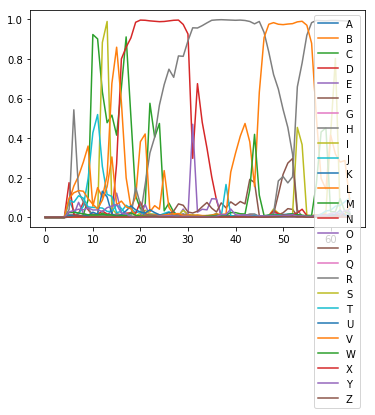

correct: 936 total: 979 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 403
('S', 'S'): 222
('E', 'E'): 448
('T', 'T'): 250
('H', 'H'): 136
('D', 'D'): 212
('K', 'K'): 70
('N', 'N'): 275
('L', 'L'): 245
('R', 'R'): 345
('O', 'O'): 268
('V', 'V'): 185
('B', 'B'): 66
('C', 'C'): 121
('G', 'G'): 82
('P', 'P'): 92
('I', 'I'): 187
('F', 'F'): 66
('W', 'W'): 80
-------('H', 'R'): 3
('U', 'U'): 57
-------('I', '%'): 11
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 58
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 6
-------('%', 'C'): 1
-------('%', 'S'): 2
-------('H', 'P'): 1
[[0.00150713 0.00071312 0.00119369 ... 0.00228603 0.03166099 0.00071246]
 [0.00178005 0.00089922 0.00153295 ... 0.00233465 0.03748875 0.00093147]
 [0.00193149 0.00114539 0.00223594 ... 0.00281353 0.04695462 0.00119412]
 ...
 [0.00220894 0.00265612 0.00224959 ... 0.00186535 0.02390346 0.00273557]
 

TROTR TROTR
edit distance: 0
correct: 938 total: 981 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 403
('S', 'S'): 222
('E', 'E'): 449
('T', 'T'): 253
('H', 'H'): 136
('D', 'D'): 212
('K', 'K'): 70
('N', 'N'): 275
('L', 'L'): 245
('R', 'R'): 347
('O', 'O'): 270
('V', 'V'): 185
('B', 'B'): 66
('C', 'C'): 121
('G', 'G'): 82
('P', 'P'): 92
('I', 'I'): 188
('F', 'F'): 66
('W', 'W'): 80
-------('H', 'R'): 3
('U', 'U'): 57
-------('I', '%'): 11
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 58
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 6
-------('%', 'C'): 1
-------('%', 'S'): 2
-------('H', 'P'): 1
[[0.00141432 0.00159665 0.00111656 ... 0.00115535 0.0389706  0.00089171]
 [0.00131262 0.001419   0.00115609 ... 0.00081916 0.03751851 0.00138285]
 [0.00110025 0.00159249 0.00137604 ... 0.0008778  0.03164826 0.00186445]
 ...
 [0.00095675 0.00061364 0.00119354 ... 0.0014

[[0.00186069 0.00167504 0.00125408 ... 0.00133354 0.03434262 0.00088848]
 [0.00178228 0.00146139 0.00110108 ... 0.00143349 0.02938919 0.00089361]
 [0.00145551 0.00125452 0.00103455 ... 0.00107913 0.02178686 0.00105553]
 ...
 [0.00095714 0.00116944 0.0015856  ... 0.00138391 0.01682064 0.00055228]
 [0.00096879 0.00123341 0.00165011 ... 0.00136408 0.01492056 0.00054224]
 [0.00103512 0.00117624 0.00162938 ... 0.001271   0.01748573 0.00056385]]
--pred for 0 20 ['I 0.99 ', 'T 0.20 ', 'J 0.16 ', 'V 0.12 ', 'L 0.07 ']
--pred for 0 24 ['I 1.00 ', 'T 0.21 ', 'V 0.17 ', 'L 0.07 ', 'J 0.07 ']
--pred for 0 28 ['I 0.99 ', 'V 0.26 ', 'L 0.24 ', 'T 0.17 ', 'H 0.02 ']
--pred for 0 32 ['I 0.98 ', 'L 0.89 ', 'V 0.28 ', 'T 0.10 ', 'Y 0.02 ']
--pred for 0 36 ['I 0.99 ', 'L 0.96 ', 'V 0.21 ', 'T 0.10 ', 'A 0.02 ']
--pred for 0 40 ['I 1.00 ', 'L 0.97 ', 'V 0.18 ', 'T 0.11 ', 'A 0.02 ']
--pred for 0 44 ['I 1.00 ', 'L 0.98 ', 'V 0.14 ', 'T 0.12 ', 'A 0.02 ']
--pred for 0 48 ['I 1.00 ', 'L 0.98 ', 'T 0.11 ', 'V

[[0.0017029  0.00094359 0.00148008 ... 0.00105167 0.02310397 0.00069858]
 [0.00193592 0.0010684  0.00157855 ... 0.00162368 0.02569754 0.00086804]
 [0.00214802 0.00122527 0.00196457 ... 0.00162701 0.02880376 0.0009369 ]
 ...
 [0.00348003 0.00230318 0.00146622 ... 0.00234752 0.02873284 0.00217991]
 [0.00317831 0.00220171 0.00148696 ... 0.00262168 0.02741438 0.00224679]
 [0.00295359 0.0020627  0.00141618 ... 0.00233055 0.02662602 0.00219157]]
--pred for 0 20 ['A 0.51 ', 'J 0.17 ', 'T 0.12 ', 'L 0.05 ', 'V 0.04 ']
--pred for 0 24 ['A 0.84 ', 'J 0.17 ', 'T 0.08 ', 'V 0.05 ', 'L 0.03 ']
--pred for 0 28 ['A 0.92 ', 'J 0.14 ', 'T 0.06 ', 'V 0.05 ', 'Y 0.03 ']
--pred for 0 32 ['A 0.94 ', 'V 0.07 ', 'J 0.06 ', 'T 0.06 ', 'Y 0.04 ']
--pred for 0 36 ['A 0.95 ', 'V 0.08 ', 'T 0.05 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 40 ['A 0.99 ', 'V 0.10 ', 'T 0.05 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 44 ['A 0.99 ', 'V 0.11 ', 'T 0.05 ', 'Y 0.04 ', 'L 0.03 ']
--pred for 0 48 ['A 0.99 ', 'V 0.16 ', 'T 0.14 ', 'Y

LIA LIA
edit distance: 0
correct: 944 total: 987 accuracy: 0.956 avgEditDist 0.051
('A', 'A'): 405
('S', 'S'): 222
('E', 'E'): 450
('T', 'T'): 254
('H', 'H'): 136
('D', 'D'): 212
('K', 'K'): 70
('N', 'N'): 276
('L', 'L'): 250
('R', 'R'): 352
('O', 'O'): 270
('V', 'V'): 186
('B', 'B'): 66
('C', 'C'): 124
('G', 'G'): 82
('P', 'P'): 92
('I', 'I'): 192
('F', 'F'): 66
('W', 'W'): 80
-------('H', 'R'): 3
('U', 'U'): 58
-------('I', '%'): 11
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 59
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 6
-------('%', 'C'): 1
-------('%', 'S'): 2
-------('H', 'P'): 1
[[0.00149211 0.00098636 0.00172782 ... 0.00105717 0.02929605 0.00146266]
 [0.00161621 0.00110252 0.00196748 ... 0.00130555 0.03222693 0.00169756]
 [0.00173214 0.0011797  0.00205469 ... 0.00150929 0.03270056 0.00178326]
 ...
 [0.00143502 0.00132893 0.00085834 ... 0.00117956

IDS IDS
edit distance: 0
correct: 946 total: 989 accuracy: 0.957 avgEditDist 0.051
('A', 'A'): 405
('S', 'S'): 223
('E', 'E'): 451
('T', 'T'): 255
('H', 'H'): 136
('D', 'D'): 213
('K', 'K'): 70
('N', 'N'): 276
('L', 'L'): 251
('R', 'R'): 352
('O', 'O'): 271
('V', 'V'): 186
('B', 'B'): 66
('C', 'C'): 124
('G', 'G'): 82
('P', 'P'): 92
('I', 'I'): 194
('F', 'F'): 66
('W', 'W'): 80
-------('H', 'R'): 3
('U', 'U'): 58
-------('I', '%'): 11
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 59
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 6
-------('%', 'C'): 1
-------('%', 'S'): 2
-------('H', 'P'): 1
[[0.00157822 0.00097657 0.00152046 ... 0.00095689 0.02970624 0.00123939]
 [0.00155334 0.00104404 0.00181179 ... 0.00109924 0.02878989 0.0015097 ]
 [0.00160195 0.00105188 0.00186924 ... 0.00119679 0.03204431 0.00160641]
 ...
 [0.00167029 0.00125714 0.00208398 ... 0.00178419

IRFKL IRFKL
edit distance: 0
correct: 948 total: 991 accuracy: 0.957 avgEditDist 0.050
('A', 'A'): 405
('S', 'S'): 223
('E', 'E'): 451
('T', 'T'): 255
('H', 'H'): 136
('D', 'D'): 213
('K', 'K'): 71
('N', 'N'): 276
('L', 'L'): 254
('R', 'R'): 353
('O', 'O'): 271
('V', 'V'): 187
('B', 'B'): 66
('C', 'C'): 124
('G', 'G'): 82
('P', 'P'): 92
('I', 'I'): 195
('F', 'F'): 67
('W', 'W'): 80
-------('H', 'R'): 3
('U', 'U'): 58
-------('I', '%'): 11
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 59
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 6
-------('%', 'C'): 1
-------('%', 'S'): 2
-------('H', 'P'): 1
[[0.0013411  0.0009541  0.00145475 ... 0.0018166  0.04677707 0.00055949]
 [0.0012414  0.0008451  0.0012363  ... 0.00287495 0.03381273 0.0005313 ]
 [0.00155886 0.00100706 0.00115255 ... 0.00255444 0.02989881 0.00057783]
 ...
 [0.00325831 0.00201661 0.00305847 ... 0.0023

EE EE
edit distance: 0
correct: 950 total: 993 accuracy: 0.957 avgEditDist 0.050
('A', 'A'): 405
('S', 'S'): 223
('E', 'E'): 455
('T', 'T'): 255
('H', 'H'): 136
('D', 'D'): 214
('K', 'K'): 71
('N', 'N'): 276
('L', 'L'): 254
('R', 'R'): 355
('O', 'O'): 271
('V', 'V'): 187
('B', 'B'): 66
('C', 'C'): 124
('G', 'G'): 82
('P', 'P'): 92
('I', 'I'): 195
('F', 'F'): 67
('W', 'W'): 80
-------('H', 'R'): 3
('U', 'U'): 58
-------('I', '%'): 11
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 59
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 6
-------('%', 'C'): 1
-------('%', 'S'): 2
-------('H', 'P'): 1
[[0.00159546 0.00110023 0.00180763 ... 0.00105297 0.03161677 0.00069787]
 [0.00131309 0.0009989  0.00182763 ... 0.0012988  0.03111684 0.00064564]
 [0.00133283 0.00100338 0.00176512 ... 0.00138447 0.02489176 0.00062158]
 ...
 [0.00135053 0.0009305  0.00135038 ... 0.00096088 0

NTEOF NTEOF
edit distance: 0
correct: 952 total: 995 accuracy: 0.957 avgEditDist 0.050
('A', 'A'): 405
('S', 'S'): 223
('E', 'E'): 456
('T', 'T'): 257
('H', 'H'): 136
('D', 'D'): 214
('K', 'K'): 71
('N', 'N'): 278
('L', 'L'): 254
('R', 'R'): 356
('O', 'O'): 272
('V', 'V'): 187
('B', 'B'): 66
('C', 'C'): 124
('G', 'G'): 82
('P', 'P'): 92
('I', 'I'): 195
('F', 'F'): 68
('W', 'W'): 80
-------('H', 'R'): 3
('U', 'U'): 58
-------('I', '%'): 11
-------('%', 'D'): 2
-------('%', 'I'): 3
('M', 'M'): 59
-------('T', '%'): 9
-------('%', 'T'): 5
-------('L', 'E'): 1
-------('%', 'W'): 1
-------('%', 'R'): 2
-------('%', 'F'): 2
-------('%', 'M'): 1
-------('%', 'U'): 6
-------('%', 'C'): 1
-------('%', 'S'): 2
-------('H', 'P'): 1
[[0.00156204 0.00069121 0.00140123 ... 0.00109661 0.04417247 0.0009208 ]
 [0.00196173 0.00098993 0.00138618 ... 0.00129322 0.0376053  0.00106313]
 [0.00207343 0.00104704 0.00151005 ... 0.00138166 0.03731705 0.00117167]
 ...
 [0.00284689 0.00209806 0.00127528 ... 0.0026

[[1.43737346e-03 1.02053152e-03 1.01874885e-03 9.08470247e-03
  2.41280510e-03 1.41217688e-03 1.56987854e-03 1.74515625e-03
  5.91665879e-03 2.17433693e-03 2.21598577e-02 8.99662912e-01
  3.99867259e-02 1.00829895e-03 5.11483885e-02 9.80390795e-03
  4.23349487e-03 2.26659956e-03 3.55224218e-03 2.19712965e-03
  1.35813770e-03 7.32557441e-04 1.99957415e-01 5.10497876e-02
  1.92220181e-01 1.03322146e-02 9.51555150e-04 3.50477509e-02
  6.26679801e-04]
 [1.26539718e-03 8.11935635e-04 8.06049851e-04 7.56605808e-03
  2.70114513e-03 1.78135338e-03 1.77045562e-03 2.03360012e-03
  5.08277304e-03 3.48796463e-03 1.94769315e-02 9.60012555e-01
  2.53393706e-02 9.14441538e-04 3.28415483e-02 6.18673861e-03
  2.35792040e-03 2.25585117e-03 2.47566635e-03 2.10726680e-03
  1.29368389e-03 7.82287330e-04 1.68307140e-01 2.28786871e-01
  3.35548878e-01 1.38888340e-02 1.09133811e-03 2.78772078e-02
  5.91915916e-04]
 [1.15347281e-03 7.06172665e-04 6.87516294e-04 5.41628338e-03
  3.20294313e-03 2.94057769e-03 1.

[[0.00161491 0.0008072  0.00143407 ... 0.00157415 0.03920368 0.00068666]
 [0.00190821 0.00100974 0.00179397 ... 0.00168437 0.0456328  0.00099937]
 [0.00210004 0.00126771 0.00255235 ... 0.00264585 0.05031714 0.00157785]
 ...
 [0.00107346 0.00065822 0.00114388 ... 0.0008986  0.01302886 0.00127814]
 [0.00110927 0.00067923 0.00119372 ... 0.00107761 0.022913   0.00071585]
 [0.00122998 0.00072357 0.00117899 ... 0.00119907 0.02886117 0.00063476]]
--pred for 0 20 ['V 0.12 ', 'J 0.07 ', 'T 0.06 ', 'L 0.05 ', 'Y 0.04 ']
--pred for 0 24 ['C 0.13 ', 'V 0.10 ', 'T 0.07 ', 'L 0.05 ', 'J 0.05 ']
--pred for 0 28 ['C 0.94 ', 'T 0.09 ', 'V 0.09 ', 'Y 0.05 ', 'L 0.05 ']
--pred for 0 32 ['C 0.99 ', 'V 0.10 ', 'T 0.10 ', 'Y 0.06 ', 'L 0.05 ']
--pred for 0 36 ['C 0.99 ', 'V 0.10 ', 'J 0.08 ', 'Y 0.07 ', 'T 0.06 ']
--pred for 0 40 ['O 0.99 ', 'V 0.16 ', 'T 0.08 ', 'Y 0.05 ', 'J 0.04 ']
--pred for 0 44 ['O 0.99 ', 'V 0.13 ', 'T 0.08 ', 'Y 0.04 ', 'A 0.04 ']
--pred for 0 48 ['O 0.99 ', 'V 0.16 ', 'T 0.09 ', 'L

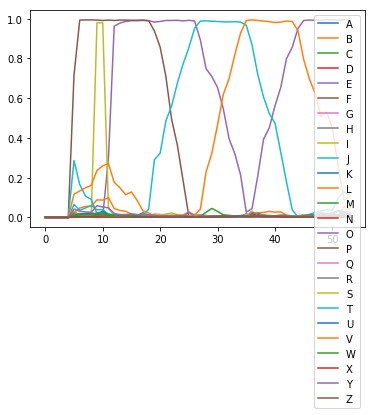

In [15]:

e = EditDistanceFinder()
cnt = Counter()
showImages = False
numCorrect = 0
runningCount = 0
sumED = 0
numPredictions = 1000

# test approaches
for i in range(numPredictions):
    img,char_list,char_starts,char_ends = generate_test_example(
                    training_images, letter_keys, character_set=character_set,
                    H=48, min_chars=2, max_chars=6)
    img = pad_image(img, img.shape[1]+8, H)
    true_word = ''.join(char_list)
    

    '''
    conf3, word3, pred_starts, pred_ends = dynamic(model3, img)
    
    print('New example, correct answers:')
    print(''.join(char_list))
    print([j+4 for j in char_starts])
    print([j+4 for j in char_ends])
    
    print("model 3: %s %.3f" % (word3, conf3))
    print(pred_starts)
    print(pred_ends)

    dist,alignment = e.align(word3, true_word)
    print("edit distance: %d" % dist)
    sumED += dist
    for a in alignment:
        cnt[a] += 1
    if dist == 0:
        numCorrect += 1
    else:
        print("-----------------------------------------------------------------------------")
    runningCount += 1
 
    print("Running tally::: correct: %d total: %d accuracy: %.3f avgEditDist %.3f" % (numCorrect,
    runningCount,float(numCorrect)/runningCount,
    float(sumED)/runningCount))
    '''
    word2 = slidingWindow(model2, img)
    print(word2,true_word)
    dist,alignment = e.align(word2, true_word)
    print("edit distance: %d" % dist)
    sumED += dist
    for a in alignment:
        cnt[a] += 1
    if dist == 0:
        numCorrect += 1
    else:
        plt.show()
    print("correct: %d total: %d accuracy: %.3f avgEditDist %.3f" % (numCorrect,i+1,float(numCorrect)/(i+1),float(sumED)/(i+1)))

    #slidingWindow(model2, img)
    if showImages:
        cv2.imshow('image',img)
        cv2.waitKey(0)
        cv2.destroyAllWindows()
    for a in cnt.keys():
        if a[0] != a[1]:
            print("-------", end="")
        print("%s: %d" % (a, cnt[a]))

print("(model, correct)")
for a in cnt.keys():
    if a[0] != a[1]:
        print("-------", end="")
    print("%s: %d" % (a, cnt[a]))

